### Methylation Dataset: Latent representation using Autoencoders
- Load Data
- Normalize Data
- Define Autoencoder Model
- Train Autoencoder with normalized dataset
- Use transformed dataset for classification
- Use transformed dataset for clustering
- Evaluation and Conclusions

In [1]:
import Models
import numpy as np
import random as rn
import pandas as pd 
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers

rn.seed(1)
np.random.seed(1)
tf.random.set_seed(1)
tf.config.threading.set_inter_op_parallelism_threads(1)
tf.config.threading.set_intra_op_parallelism_threads(1)
sns.set()

# Load Data
X_brca_methyl_data = pd.read_csv('./BRCA_methylation.txt', sep=',', index_col=0) # Dataset has Donor ID as first column
X_brca_mRNA_data = pd.read_csv('./BRCA_mRNA.txt', sep=',', index_col=0) # Dataset has Donor ID as first column
X_brca_CNA_data = pd.read_csv('./BRCA_CNA.txt', sep=',' ,index_col=0) # Dataset has Donor ID as first column
y_brca_data = pd.read_csv('./BRCA_Clinical.txt', sep=',', index_col=0, names=["Label"]) # Dataset has Donor ID on first column and Label on second column.

X_brca_methyl_filtered = X_brca_methyl_data.drop(["TCGA-AO-A12C-01","TCGA-AR-A1AT-01"], axis=1)
X_brca_mRNA_filtered = X_brca_mRNA_data.drop(["TCGA-AO-A12C-01","TCGA-AR-A1AT-01","TCGA-BH-A18V-06"], axis=1)
X_brca_CNA_filtered = X_brca_CNA_data.drop(["TCGA-AR-A0U1-01"], axis=1)
y_brca_filtered = y_brca_data.drop(["TCGA-AO-A12C-01","TCGA-AR-A1AT-01","TCGA-BH-A18V-06"], axis=0)


X_train_first_norm, X_train_second_norm, X_swapped_first_norm, X_swapped_second_norm, X_test_first_norm, X_test_second_norm, X_train_concat, X_swapped_concat, X_test_concat, y_train, y_test, y_train_oh, y_test_oh \
    = Models.prepare_datasets(X_brca_methyl_filtered.T,X_brca_mRNA_filtered.T, y_brca_filtered, test_size=0.2, swap_noise=0.15)



swapping: 20 rows.


In [124]:
# SELECT 25% OF FEATURES WITH HIGHER VARIANCE FIRST DATASET 
X_std = np.std(X_brca_methyl_filtered.T)
X_threshold = np.percentile(X_std, 75)
X_select = X_std > X_threshold
X_train_filt = X_brca_methyl_filtered.T.loc[:,X_select]
X_test_filt = X_brca_methyl_filtered.T.loc[:,X_select]

from sklearn.model_selection import train_test_split, GridSearchCV
X_train, X_test, y_train, y_test = train_test_split(X_train_filt, y_brca_filtered, test_size=0.2, random_state=2) 
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
X_train = pd.DataFrame(scaler.fit_transform(X_train))
X_test = pd.DataFrame(scaler.transform(X_test))

In [20]:
import importlib
importlib.reload(Models)

<module 'Models' from 'C:\\Desarrollo\\Data Science\\Jupyter Notebooks\\Stage\\oss-stage-2019\\Multiomic Dataset\\Models.py'>

Compression: 35.75

Epoch 00031: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00036: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00036: early stopping


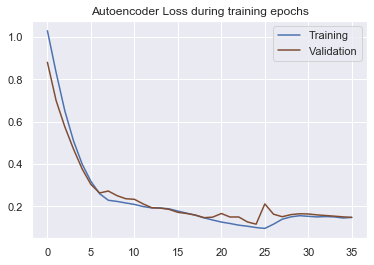

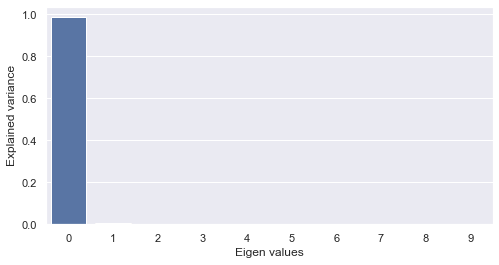

PCA on single-modal explained variance ratio: 0.9999486804008484


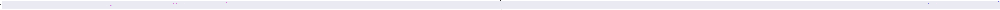

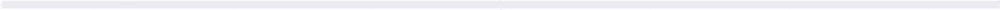

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



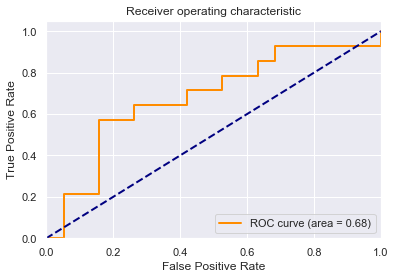

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for Logistic Regression: 0.684615
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6846153846153846 

Best C: 0.1 

Best Gamma: scale 



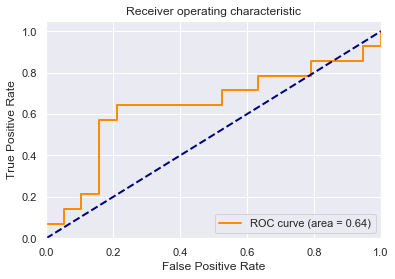

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for SVM: 0.684615
Testing  set score for SVM: 0.727273
Best score for training data: 0.6461538461538461 

Best #estimators: 100 

Best max depth: 12 



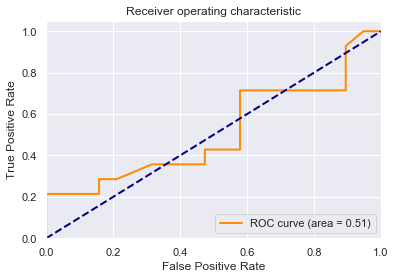

[[12  7]
 [ 9  5]]


              precision    recall  f1-score   support

           0       0.57      0.63      0.60        19
           1       0.42      0.36      0.38        14

    accuracy                           0.52        33
   macro avg       0.49      0.49      0.49        33
weighted avg       0.51      0.52      0.51        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.515152


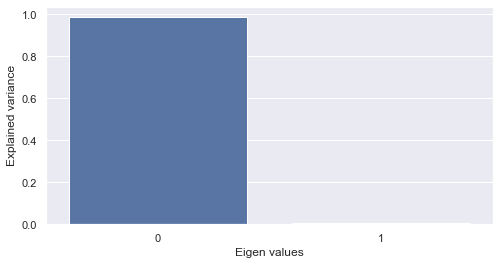

PCA on single-modal explained variance ratio: 0.9951277375221252


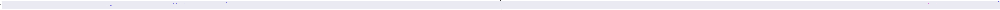

2 clusters -  silhoutte score: 0.9183090925216675 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5945785045623779 - mutual information: 0.06531568182415662
4 clusters -  silhoutte score: 0.41716375946998596 - mutual information: 0.07000983426571619


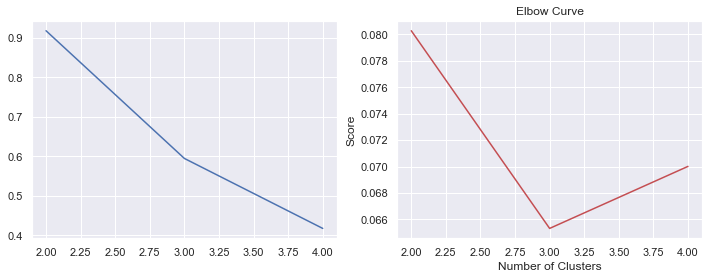

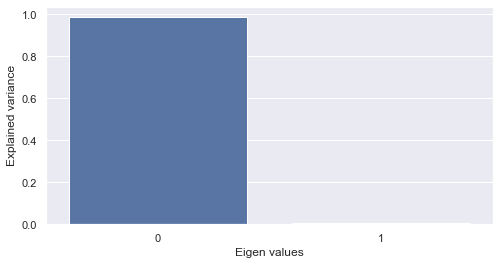

PCA on single-modal explained variance ratio: 0.9951277375221252


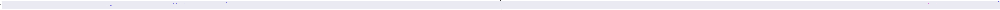

2 clusters -  silhoutte score: 0.9183090925216675 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.6038766503334045 - mutual information: 0.06281185760049893
4 clusters -  silhoutte score: 0.4265999495983124 - mutual information: 0.06784794651677811


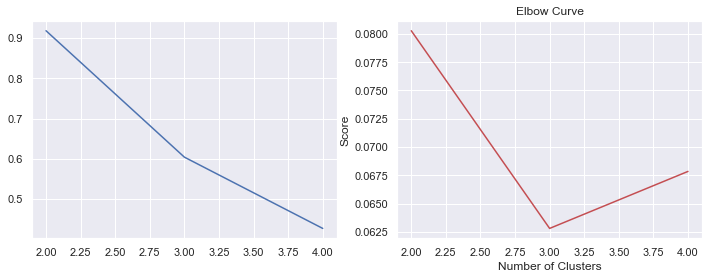

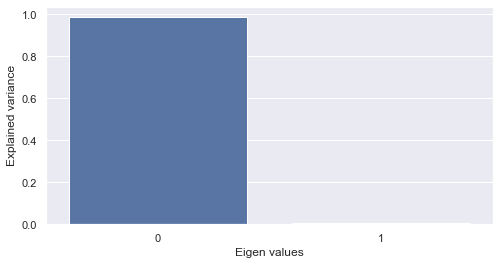

PCA on single-modal explained variance ratio: 0.9951277375221252


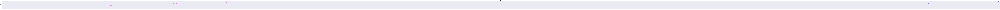

2 clusters -  silhoutte score: 0.9183090925216675 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.6182644367218018 - mutual information: 0.06507493622677396
4 clusters -  silhoutte score: 0.4822695553302765 - mutual information: 0.054064272290045234


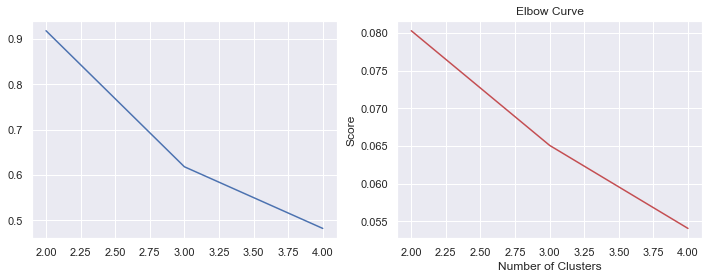

In [22]:
X_train = X_train_first_norm
X_test = X_test_first_norm
encoding_dims=[100]
mus=[0.5]
dropouts = [0.3]
l1s = [0.00003]
l2s = [0.0000001]
scores = []
for encoding_dim in encoding_dims:
    for mu in mus:
        for dropout in dropouts:
            for l1 in l1s:
                for l2 in l2s:
                    ## Build and Train Autoencoder
                    autoencoder, encoder, decoder, loss = Models.build_and_train_autoencoder(X_train,
                                                                                  X_train,
                                                                                  encoding_dim=encoding_dim, 
                                                                                  regularizer=tf.keras.regularizers.l1_l2(l1,l2),
                                                                                  dropout=dropout,
                                                                                  epochs=200,
                                                                                  validation_data=(X_test, X_test))
                    ## Encode datasets
                    X_latent_ae = Models.encode_dataset(X_train, encoder)
                    X_latent_test_ae = Models.encode_dataset(X_test, encoder)

                    ## PCA ON AUTOENCODER LATENT SPACE
                    X_latent_pca_ae, X_latent_test_pca_ae = Models.perform_PCA(X_latent_ae, y_train, X_latent_test_ae, y_test, n_components=10)

                    ### CLASSIFICATION ###
                    classify = Models.classify(X_latent_ae, X_latent_test_ae, np.ravel(y_train), np.ravel(y_test), model_type="AE")

                    ### CLUSTERING ###
                    clustering = Models.cluster(X_latent_ae,np.ravel(y_train), model_type="AE")

                    scores.append([mu,dropout,l1,l2,loss] + classify + clustering)


In [23]:
scores = pd.DataFrame(scores,
                      columns=["mu","dropout","l1","l2","loss","LR accuracy","SVM accuracy", "RF accuracy", "LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC","KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette","KMeans MI","Spectral MI","Hierarchical MI"])    
display(scores)
print(f"Random classifier: {y_test.iloc[:,0].value_counts()[0]/len(y_test)}")

,mu,dropout,l1,l2,loss,LR accuracy,SVM accuracy,RF accuracy,LR ROC-AUC,SVM ROC-AUC,RF ROC-AUC,KMeans Silhouette,Spectral Silhouette,Hierarchical Silhouette,KMeans MI,Spectral MI,Hierarchical MI
0,0.5,0.3,0.00003,1.000000e-07,0.147746,0.727273,0.727273,0.515152,0.680451,0.639098,0.513158,0.918309,0.918309,0.918309,0.07001,0.067848,0.054064


Random classifier: 0.5757575757575758


C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:376: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(new_indexer, value)
C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the docume

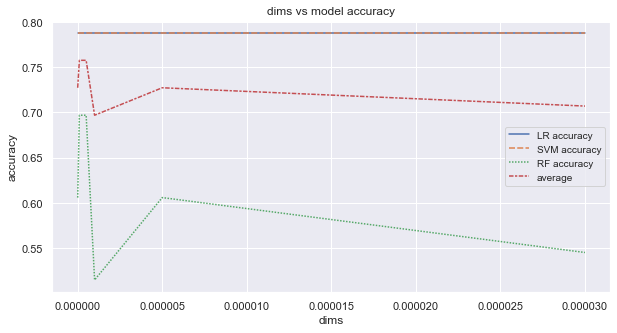

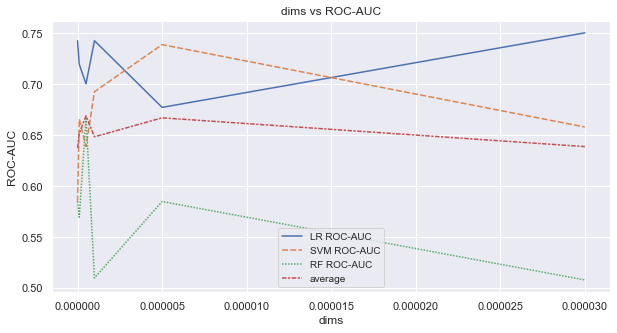

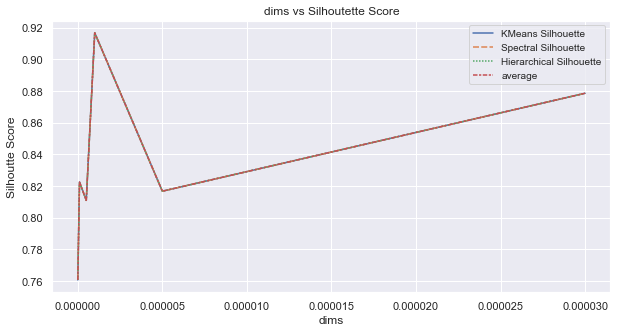

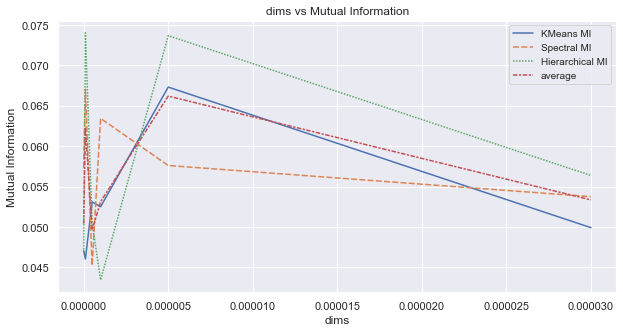

In [147]:
scores.index = l2s

data_acc = scores[["LR accuracy","SVM accuracy","RF accuracy"]]
data_acc.loc[:,"average"] = data_acc.mean(axis=1)

data_auc = scores[["LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC"]]
data_auc.loc[:,"average"] = data_auc.mean(axis=1)

data_ss = scores[["KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette"]]
data_ss.loc[:,"average"] = data_ss.mean(axis=1)

data_mi = scores[["KMeans MI","Spectral MI","Hierarchical MI"]]
data_mi.loc[:,"average"] = data_mi.mean(axis=1)

sns.set()
hyperparam = "dims"

ax = sns.lineplot(data=data_acc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"accuracy")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs model accuracy")
plt.show()

ax = sns.lineplot(data=data_auc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"ROC-AUC")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs ROC-AUC")
plt.show()

ax = sns.lineplot(data=data_ss)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Silhoutte Score")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Silhoutette Score")
plt.show()

ax = sns.lineplot(data=data_mi)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Mutual Information")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Mutual Information")
plt.show()

0.5757575757575758

In [104]:
# SELECT 25% OF FEATURES WITH HIGHER VARIANCE FIRST DATASET 
X_std = np.std(X_brca_methyl_filtered.T)
X_threshold = np.percentile(X_std, 75)
X_select = X_std > X_threshold
X_train_first = X_brca_methyl_filtered.T.loc[:,X_select]
X_test_first = X_brca_methyl_filtered.T.loc[:,X_select]

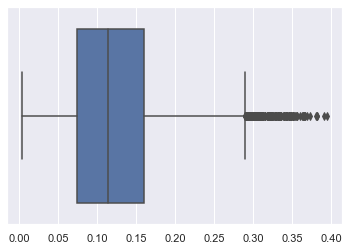

In [105]:
import seaborn as sns
ax = sns.boxplot(x=X_std)

Compression: 35.75

Epoch 00034: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00096: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00105: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00114: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00122: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.

Epoch 00127: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-09.
Epoch 00127: early stopping


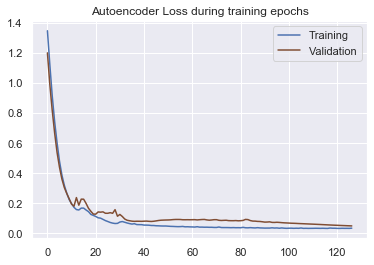

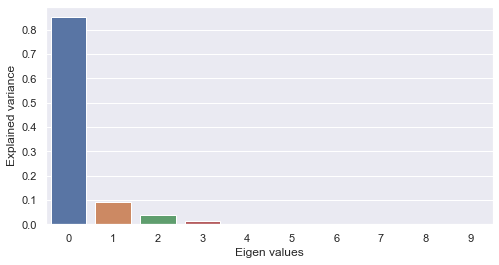

PCA on single-modal explained variance ratio: 0.9995317459106445


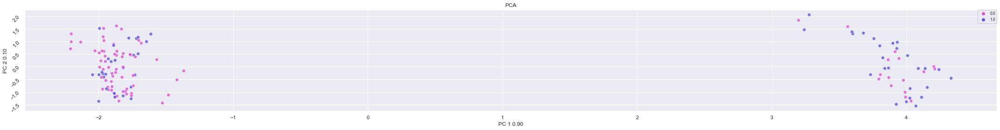

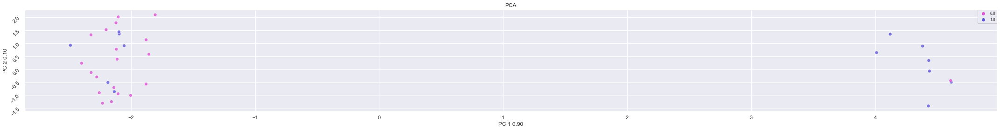

Results for AE: 

Best score for training data: 0.6692307692307693 

Best C: 0.08 



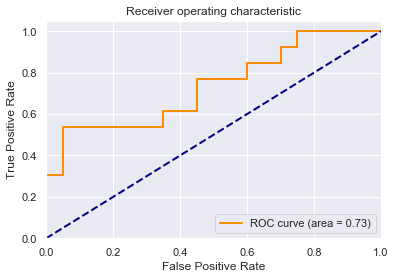

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.787879
Best score for training data: 0.6692307692307693 

Best C: 1.0 

Best Gamma: 0.1 



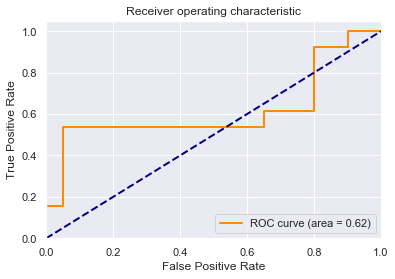

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.787879
Best score for training data: 0.6307692307692307 

Best #estimators: 100 

Best max depth: 12 



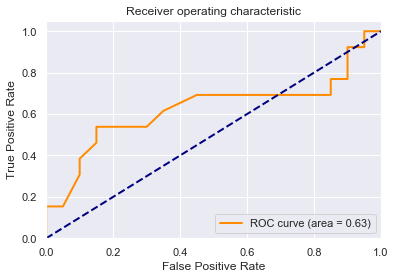

[[15  5]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.71      0.75      0.73        20
           1       0.58      0.54      0.56        13

    accuracy                           0.67        33
   macro avg       0.65      0.64      0.65        33
weighted avg       0.66      0.67      0.66        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.666667


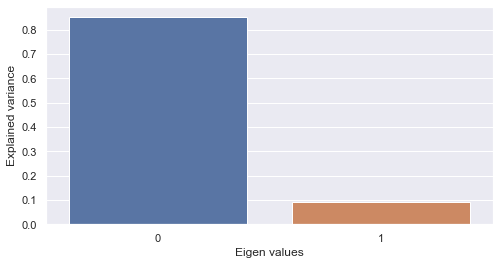

PCA on single-modal explained variance ratio: 0.9423483610153198


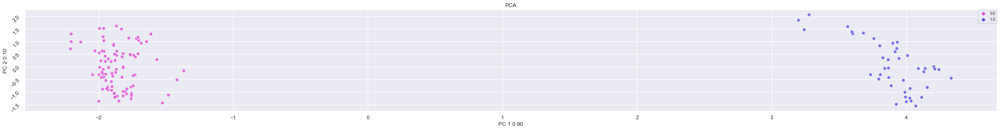

2 clusters -  silhoutte score: 0.7590128183364868 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.536141037940979 - mutual information: 0.049792214445956634
4 clusters -  silhoutte score: 0.4427596926689148 - mutual information: 0.047921257435827695


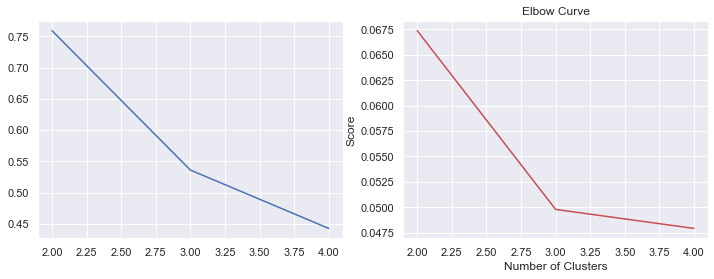

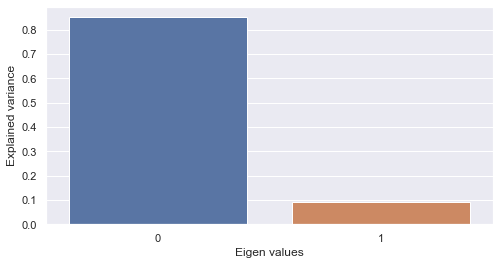

PCA on single-modal explained variance ratio: 0.9423483610153198


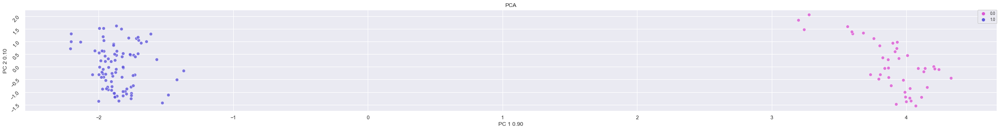

2 clusters -  silhoutte score: 0.7590128183364868 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.661824643611908 - mutual information: 0.06805495785455919
4 clusters -  silhoutte score: 0.4450531005859375 - mutual information: 0.05191667937657338


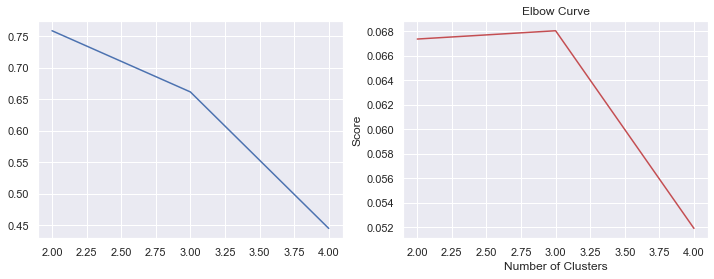

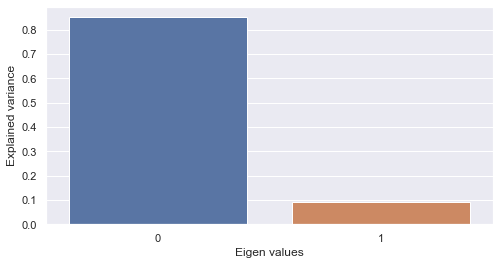

PCA on single-modal explained variance ratio: 0.9423483610153198


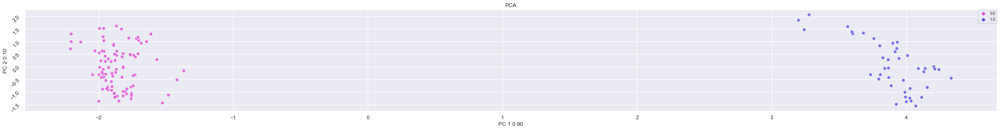

2 clusters -  silhoutte score: 0.7590128183364868 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.5338019728660583 - mutual information: 0.050311015090665025
4 clusters -  silhoutte score: 0.44043272733688354 - mutual information: 0.048382605531884


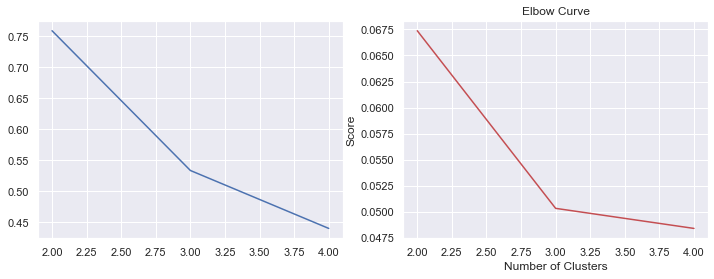

Compression: 35.75

Epoch 00041: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00057: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00080: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00085: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00090: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.
Epoch 00093: early stopping


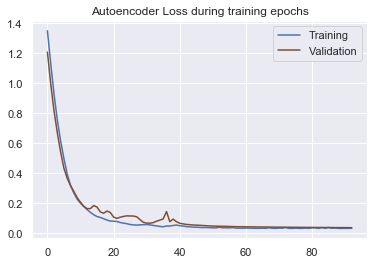

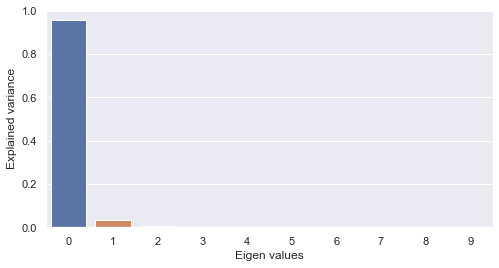

PCA on single-modal explained variance ratio: 0.9999339580535889


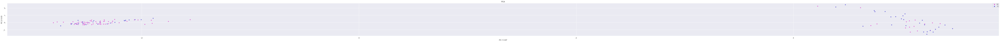

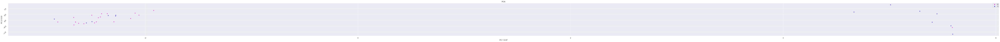

Results for AE: 

Best score for training data: 0.6692307692307693 

Best C: 0.08 



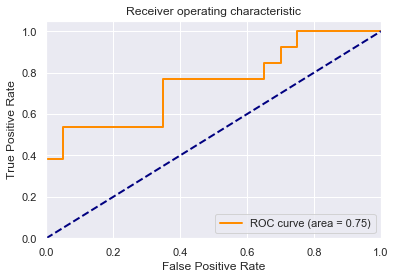

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.787879
Best score for training data: 0.6692307692307693 

Best C: 1.0 

Best Gamma: 0.1 



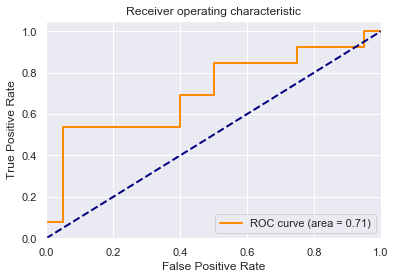

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.787879
Best score for training data: 0.6615384615384616 

Best #estimators: 100 

Best max depth: 12 



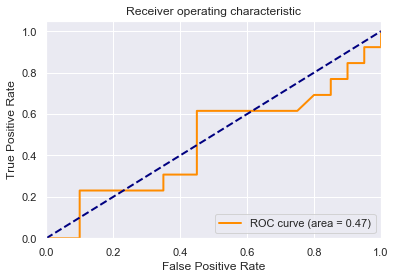

[[11  9]
 [ 7  6]]


              precision    recall  f1-score   support

           0       0.61      0.55      0.58        20
           1       0.40      0.46      0.43        13

    accuracy                           0.52        33
   macro avg       0.51      0.51      0.50        33
weighted avg       0.53      0.52      0.52        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.515152


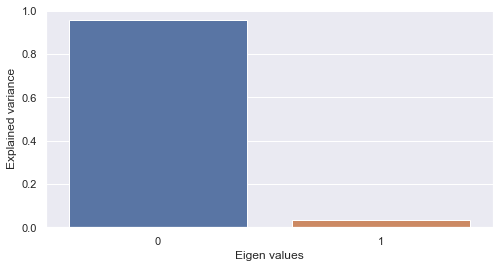

PCA on single-modal explained variance ratio: 0.9893873333930969


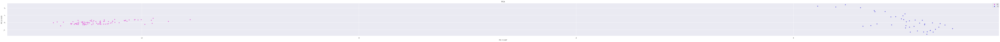

2 clusters -  silhoutte score: 0.8825769424438477 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.7962262034416199 - mutual information: 0.07293762388109243
4 clusters -  silhoutte score: 0.4484545588493347 - mutual information: 0.0569705357456545


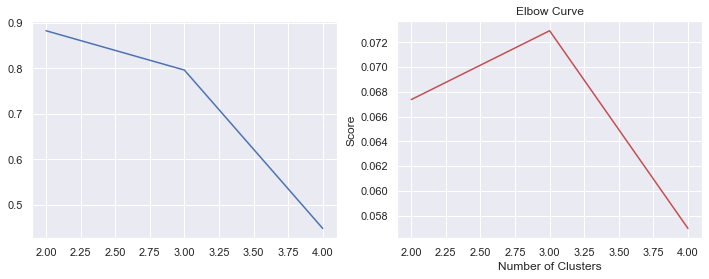

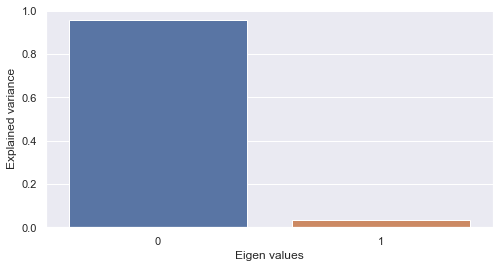

PCA on single-modal explained variance ratio: 0.9893873333930969


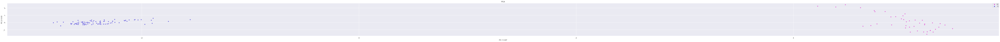

2 clusters -  silhoutte score: 0.8825769424438477 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.7942153811454773 - mutual information: 0.062386763519742594
4 clusters -  silhoutte score: 0.7598530650138855 - mutual information: 0.06447637074187396


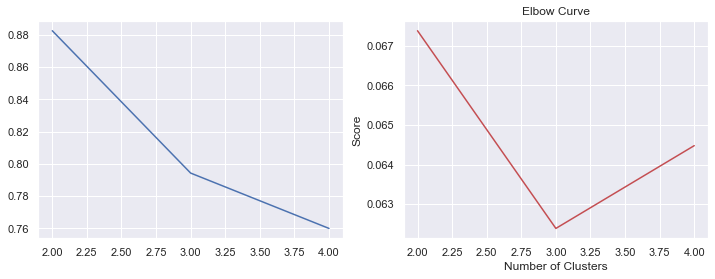

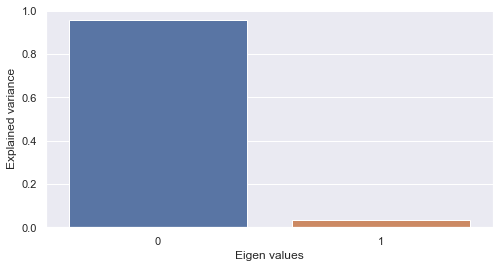

PCA on single-modal explained variance ratio: 0.9893873333930969


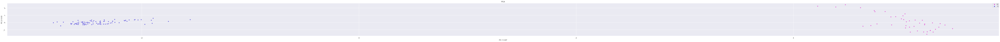

2 clusters -  silhoutte score: 0.8825769424438477 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.7769306302070618 - mutual information: 0.06241290219833183
4 clusters -  silhoutte score: 0.7455037236213684 - mutual information: 0.05959504698410714


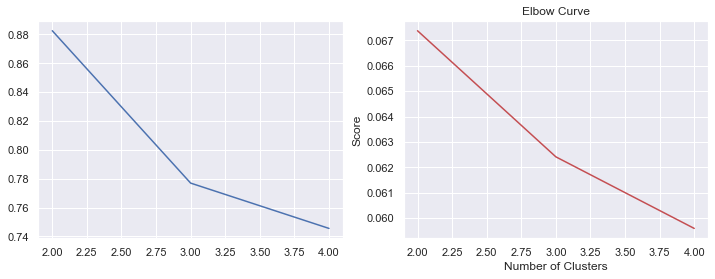

Compression: 35.75

Epoch 00042: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00086: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00097: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00102: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00111: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.

Epoch 00116: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-09.
Epoch 00116: early stopping


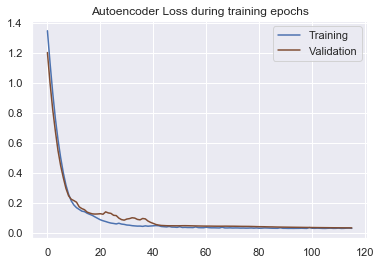

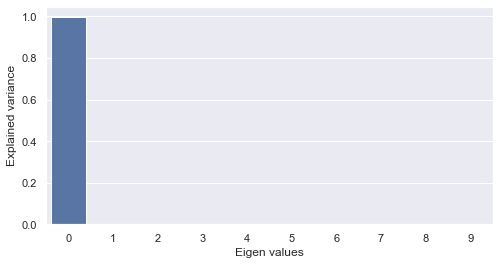

PCA on single-modal explained variance ratio: 0.9999986886978149


ValueError: Image size of 110844x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 110845x288 with 1 Axes>

ValueError: Image size of 110844x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 110845x288 with 1 Axes>

Results for AE: 

Best score for training data: 0.6692307692307693 

Best C: 0.08 



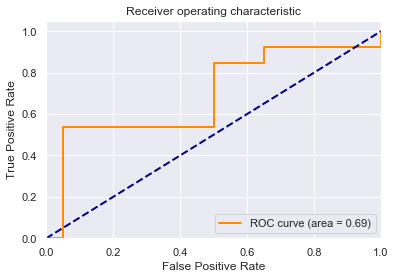

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.787879
Best score for training data: 0.6692307692307693 

Best C: 0.1 

Best Gamma: scale 



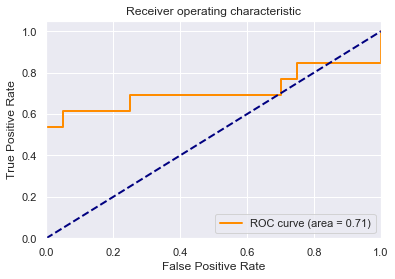

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.787879
Best score for training data: 0.7153846153846153 

Best #estimators: 140 

Best max depth: None 



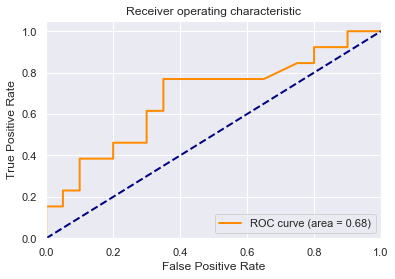

[[14  6]
 [ 7  6]]


              precision    recall  f1-score   support

           0       0.67      0.70      0.68        20
           1       0.50      0.46      0.48        13

    accuracy                           0.61        33
   macro avg       0.58      0.58      0.58        33
weighted avg       0.60      0.61      0.60        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.606061


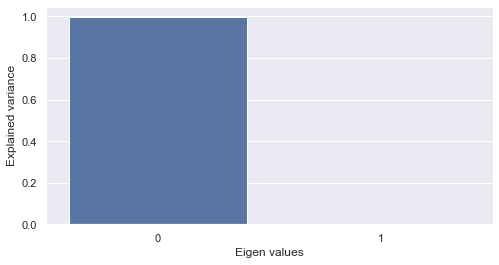

PCA on single-modal explained variance ratio: 0.998939037322998


ValueError: Image size of 110844x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 110845x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9550459384918213 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.6132944226264954 - mutual information: 0.054863958748231766
4 clusters -  silhoutte score: 0.4968993067741394 - mutual information: 0.05528033503192486


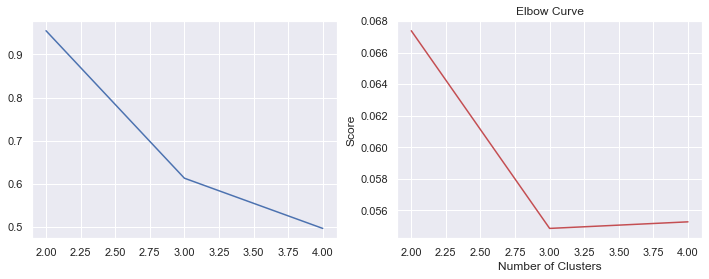

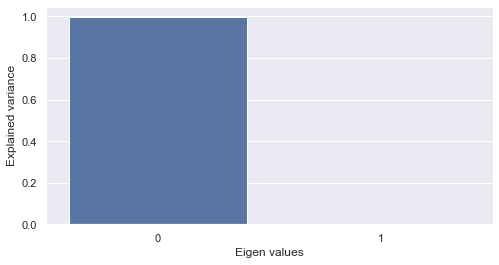

PCA on single-modal explained variance ratio: 0.998939037322998


ValueError: Image size of 110844x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 110845x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9550459384918213 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.8370940685272217 - mutual information: 0.06647992958353509
4 clusters -  silhoutte score: 0.5080784559249878 - mutual information: 0.06079131092022478


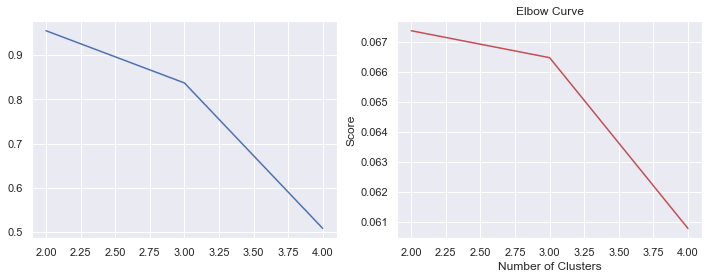

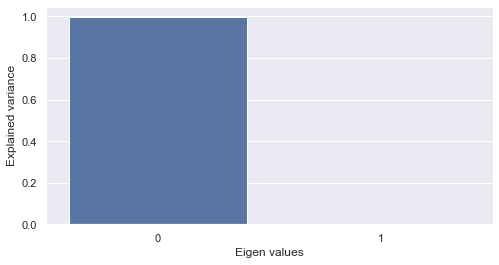

PCA on single-modal explained variance ratio: 0.998939037322998


ValueError: Image size of 110844x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 110845x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9550459384918213 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.5475437641143799 - mutual information: 0.05537660148039748
4 clusters -  silhoutte score: 0.43093976378440857 - mutual information: 0.055733115280238686


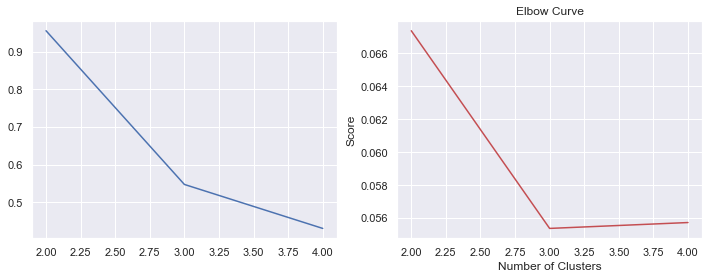

Compression: 35.75

Epoch 00042: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00079: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00084: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00095: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00100: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.
Epoch 00100: early stopping


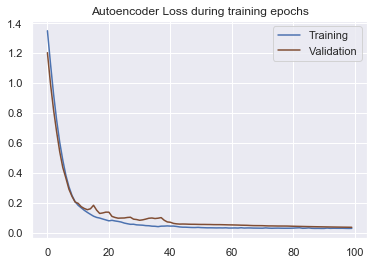

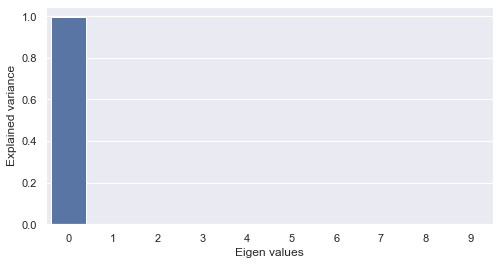

PCA on single-modal explained variance ratio: 0.9999973177909851


ValueError: Image size of 93548x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 93548.7x288 with 1 Axes>

ValueError: Image size of 93548x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 93548.7x288 with 1 Axes>

Results for AE: 

Best score for training data: 0.6692307692307693 

Best C: 0.08 



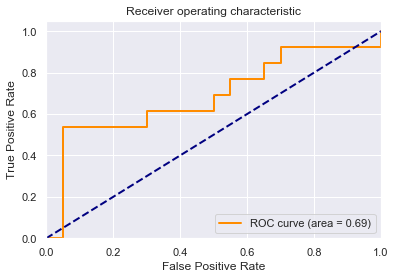

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.787879
Best score for training data: 0.6692307692307693 

Best C: 0.1 

Best Gamma: scale 



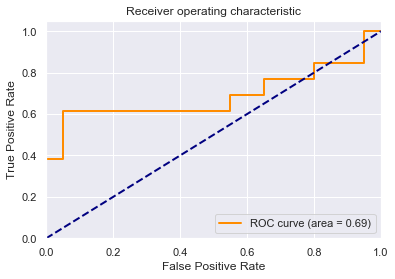

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.787879
Best score for training data: 0.6076923076923076 

Best #estimators: 140 

Best max depth: None 



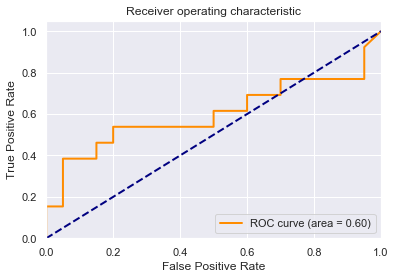

[[13  7]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.68      0.65      0.67        20
           1       0.50      0.54      0.52        13

    accuracy                           0.61        33
   macro avg       0.59      0.59      0.59        33
weighted avg       0.61      0.61      0.61        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.606061


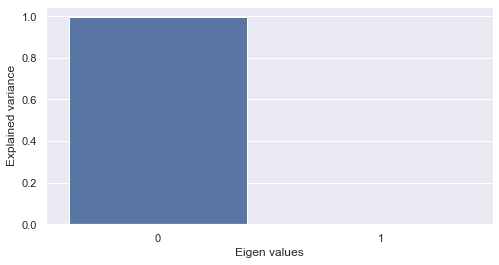

PCA on single-modal explained variance ratio: 0.9985981583595276


ValueError: Image size of 93548x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 93548.7x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9525511264801025 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.6403078436851501 - mutual information: 0.05150359660042356
4 clusters -  silhoutte score: 0.5536609888076782 - mutual information: 0.0500950829424948


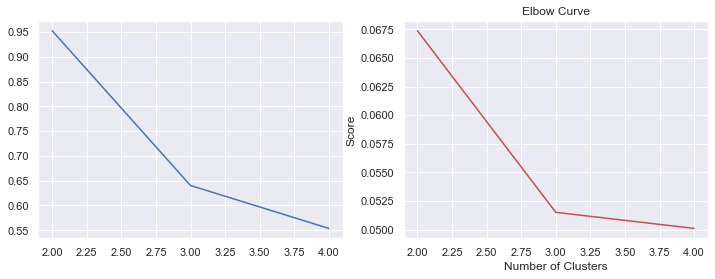

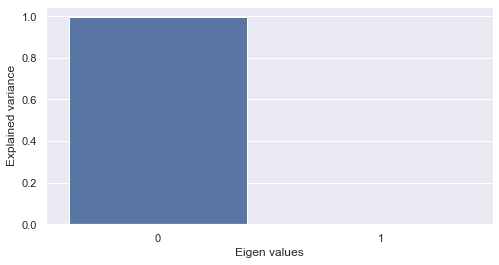

PCA on single-modal explained variance ratio: 0.9985981583595276


ValueError: Image size of 93548x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 93548.7x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9525511264801025 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.6403078436851501 - mutual information: 0.05150359660042356
4 clusters -  silhoutte score: 0.8265942931175232 - mutual information: 0.070064726664635


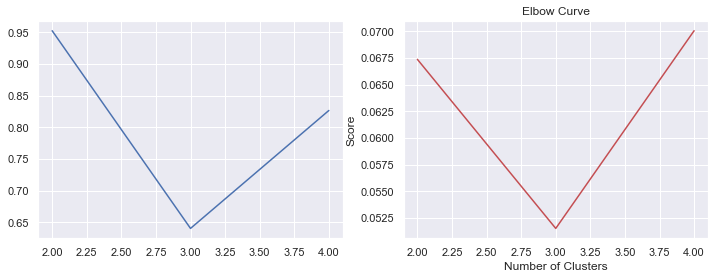

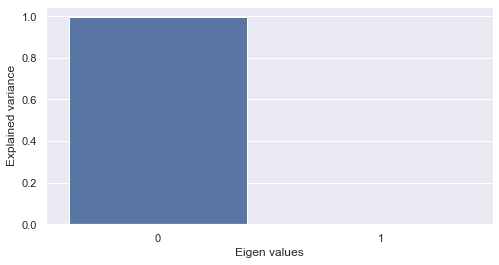

PCA on single-modal explained variance ratio: 0.9985981583595276


ValueError: Image size of 93548x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 93548.7x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9525511264801025 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.6155048608779907 - mutual information: 0.05002859637945268
4 clusters -  silhoutte score: 0.5013259649276733 - mutual information: 0.05085338314779812


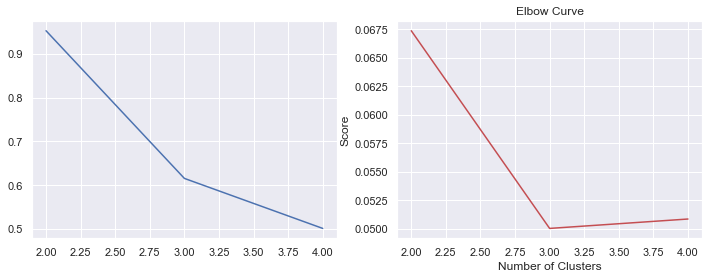

Compression: 35.75

Epoch 00045: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00050: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00050: early stopping


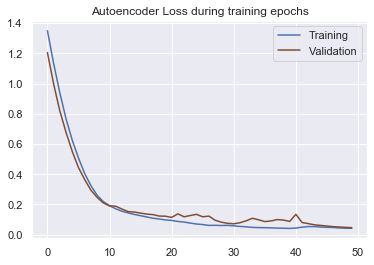

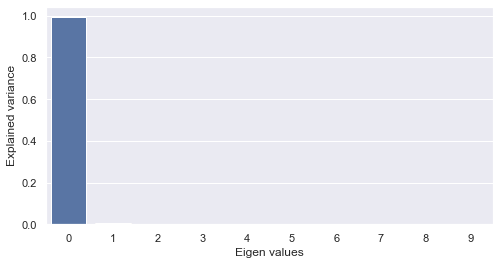

PCA on single-modal explained variance ratio: 0.9999822974205017


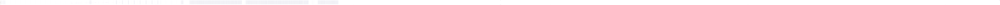

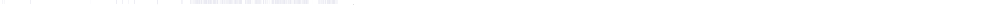

Results for AE: 

Best score for training data: 0.6692307692307693 

Best C: 0.08 



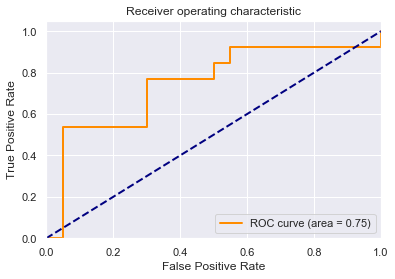

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.787879
Best score for training data: 0.6692307692307693 

Best C: 0.1 

Best Gamma: scale 



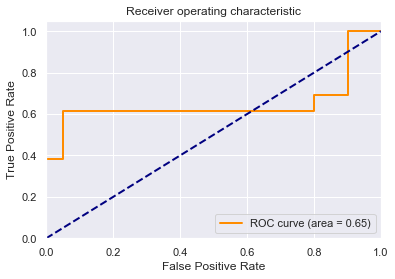

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.787879
Best score for training data: 0.6307692307692307 

Best #estimators: 140 

Best max depth: None 



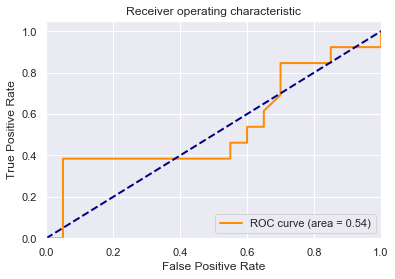

[[13  7]
 [ 8  5]]


              precision    recall  f1-score   support

           0       0.62      0.65      0.63        20
           1       0.42      0.38      0.40        13

    accuracy                           0.55        33
   macro avg       0.52      0.52      0.52        33
weighted avg       0.54      0.55      0.54        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.545455


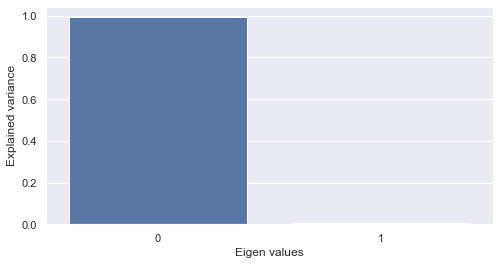

PCA on single-modal explained variance ratio: 0.9975724220275879


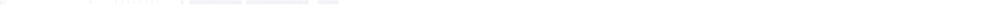

2 clusters -  silhoutte score: 0.943939208984375 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.7938071489334106 - mutual information: 0.05843426160604117
4 clusters -  silhoutte score: 0.47878798842430115 - mutual information: 0.04571799371456016


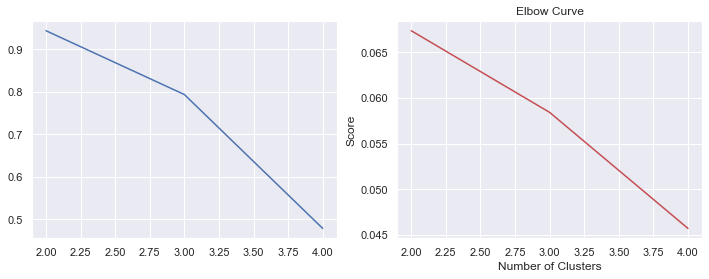

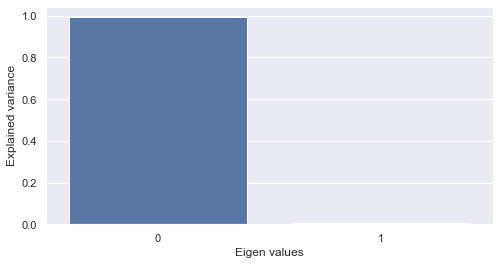

PCA on single-modal explained variance ratio: 0.9975724220275879


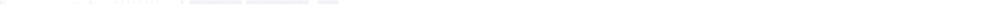

2 clusters -  silhoutte score: 0.943939208984375 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.7938071489334106 - mutual information: 0.05843426160604117
4 clusters -  silhoutte score: 0.5423946380615234 - mutual information: 0.05853174001120402


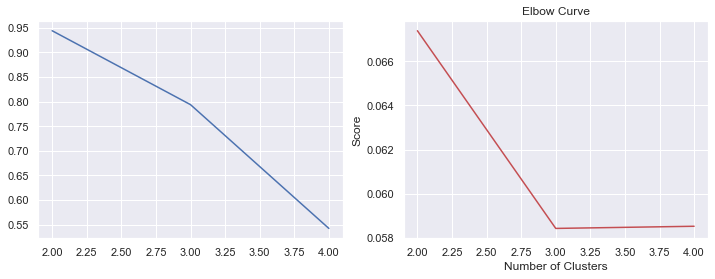

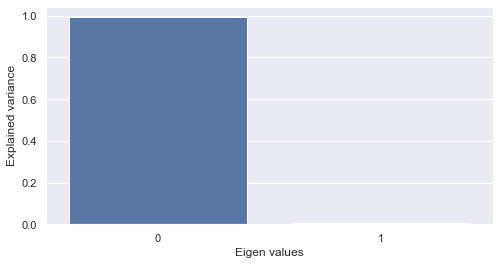

PCA on single-modal explained variance ratio: 0.9975724220275879


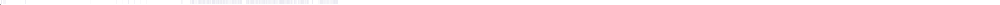

2 clusters -  silhoutte score: 0.943939208984375 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.764240562915802 - mutual information: 0.05768164871879105
4 clusters -  silhoutte score: 0.44135957956314087 - mutual information: 0.04463458413585228


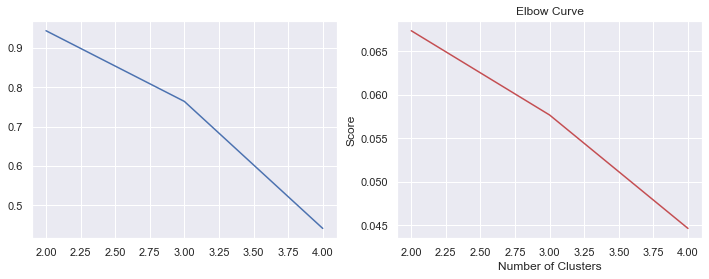

Compression: 35.75

Epoch 00056: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00079: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00090: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00095: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00102: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.

Epoch 00107: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-09.
Epoch 00107: early stopping


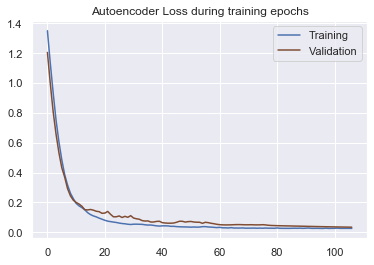

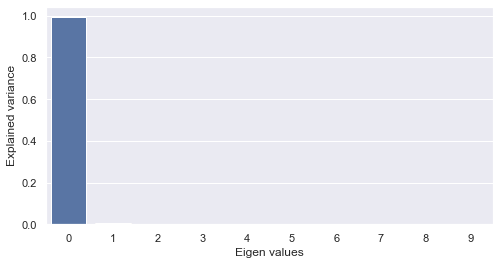

PCA on single-modal explained variance ratio: 0.9999945163726807


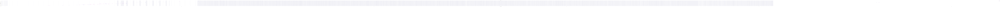

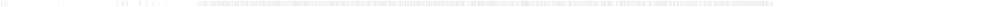

Results for AE: 

Best score for training data: 0.6692307692307693 

Best C: 0.08 



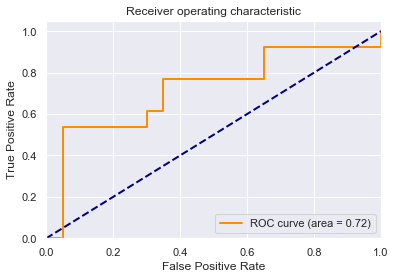

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.787879
Best score for training data: 0.6692307692307693 

Best C: 0.1 

Best Gamma: scale 



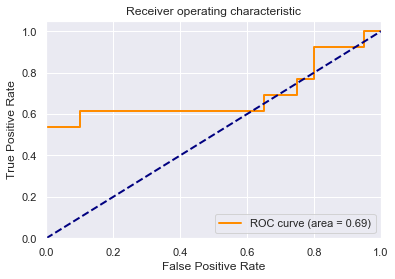

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.787879
Best score for training data: 0.6153846153846153 

Best #estimators: 100 

Best max depth: 12 



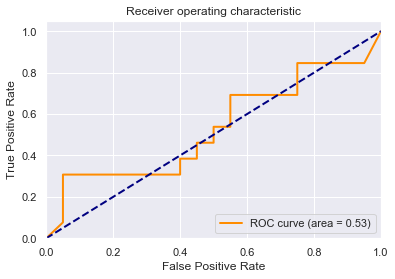

[[11  9]
 [ 7  6]]


              precision    recall  f1-score   support

           0       0.61      0.55      0.58        20
           1       0.40      0.46      0.43        13

    accuracy                           0.52        33
   macro avg       0.51      0.51      0.50        33
weighted avg       0.53      0.52      0.52        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.515152


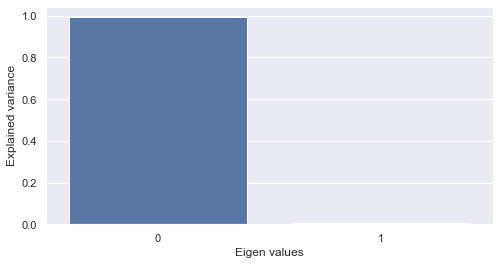

PCA on single-modal explained variance ratio: 0.9989044070243835


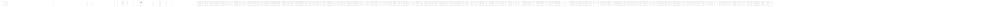

2 clusters -  silhoutte score: 0.9414854645729065 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.6573165655136108 - mutual information: 0.053895812066251235
4 clusters -  silhoutte score: 0.6349090933799744 - mutual information: 0.05972176139428222


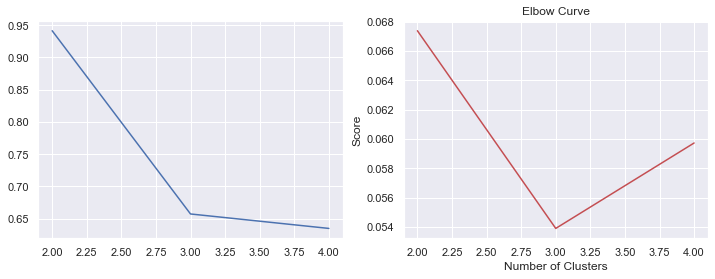

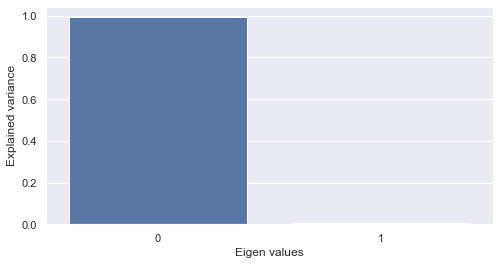

PCA on single-modal explained variance ratio: 0.9989044070243835


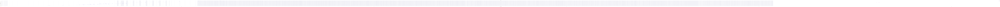

2 clusters -  silhoutte score: 0.9414854645729065 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.6964882612228394 - mutual information: 0.0680562563881684
4 clusters -  silhoutte score: 0.6100067496299744 - mutual information: 0.06385616206043065


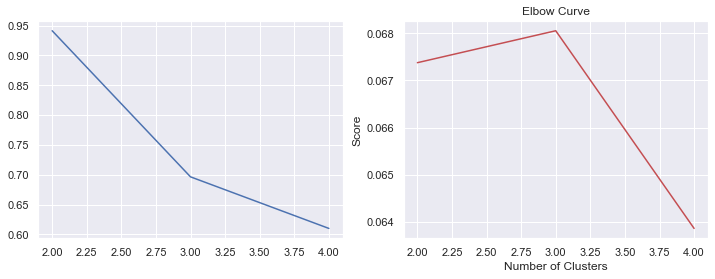

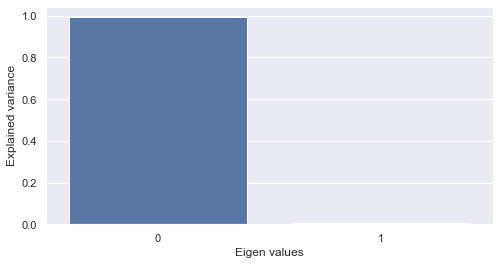

PCA on single-modal explained variance ratio: 0.9989044070243835


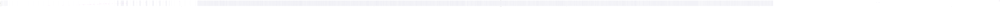

2 clusters -  silhoutte score: 0.9414854645729065 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.6981787085533142 - mutual information: 0.05912568584627096
4 clusters -  silhoutte score: 0.6286398768424988 - mutual information: 0.046826584667322244


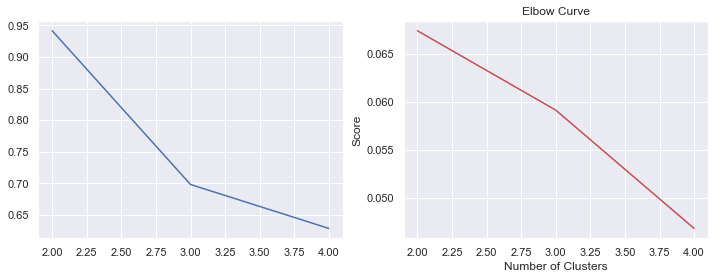

Compression: 35.75

Epoch 00054: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00059: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00059: early stopping


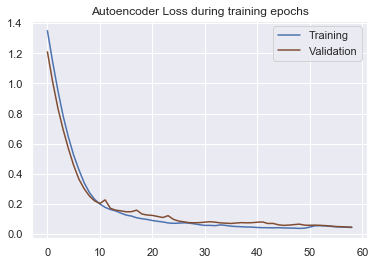

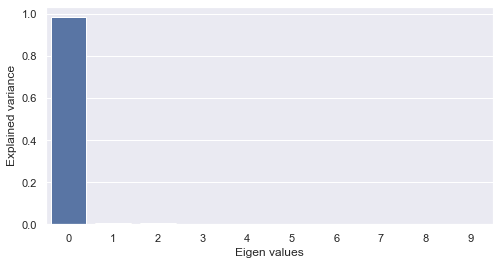

PCA on single-modal explained variance ratio: 0.9999765753746033


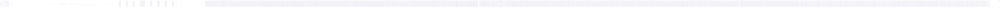

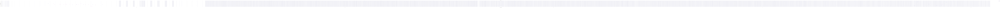

Results for AE: 

Best score for training data: 0.6692307692307693 

Best C: 0.08 



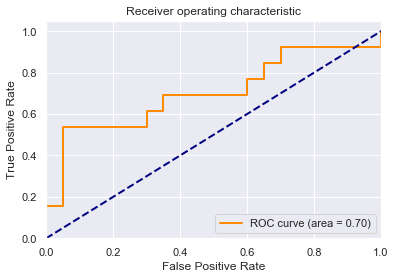

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.787879
Best score for training data: 0.6692307692307693 

Best C: 0.1 

Best Gamma: scale 



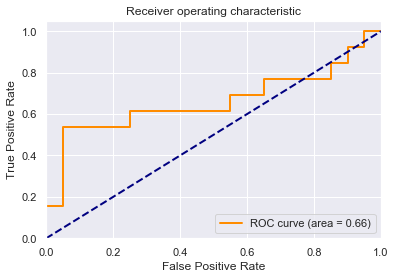

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.787879
Best score for training data: 0.5923076923076923 

Best #estimators: 140 

Best max depth: None 



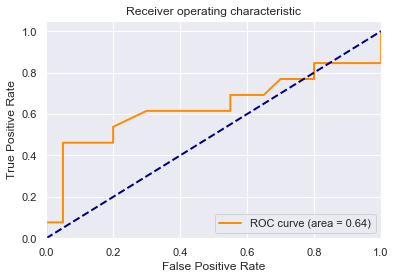

[[ 9 11]
 [ 5  8]]


              precision    recall  f1-score   support

           0       0.64      0.45      0.53        20
           1       0.42      0.62      0.50        13

    accuracy                           0.52        33
   macro avg       0.53      0.53      0.51        33
weighted avg       0.56      0.52      0.52        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.515152


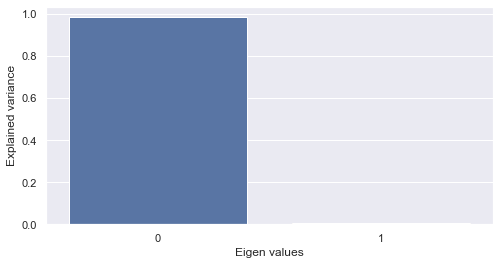

PCA on single-modal explained variance ratio: 0.9913150072097778


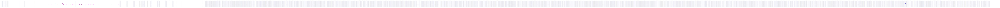

2 clusters -  silhoutte score: 0.9288012981414795 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.7733415961265564 - mutual information: 0.059165844795953014
4 clusters -  silhoutte score: 0.6048814654350281 - mutual information: 0.05496201092803028


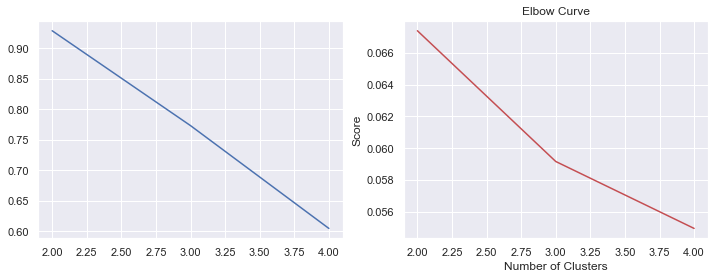

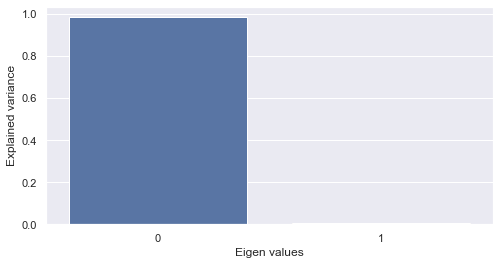

PCA on single-modal explained variance ratio: 0.9913150072097778


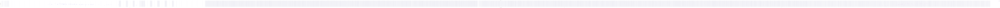

2 clusters -  silhoutte score: 0.9288012981414795 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.7759678959846497 - mutual information: 0.05846459914638315
4 clusters -  silhoutte score: 0.7573250532150269 - mutual information: 0.0567597823589192


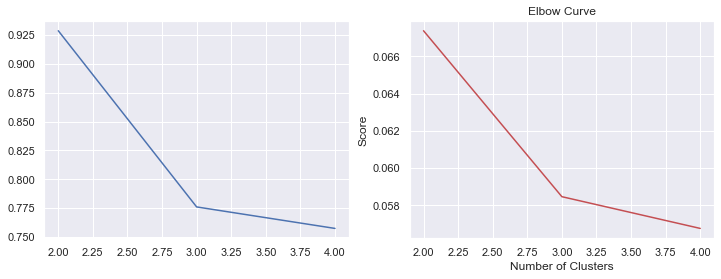

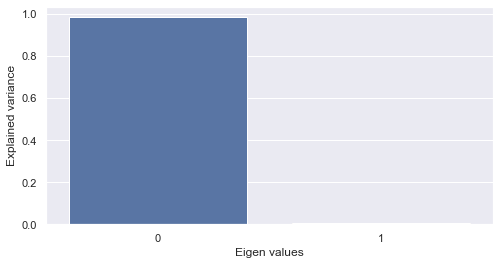

PCA on single-modal explained variance ratio: 0.9913150072097778


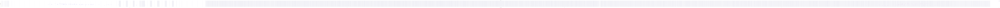

2 clusters -  silhoutte score: 0.9288012981414795 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.7499399185180664 - mutual information: 0.05875510479279426
4 clusters -  silhoutte score: 0.5953077077865601 - mutual information: 0.05517108064036177


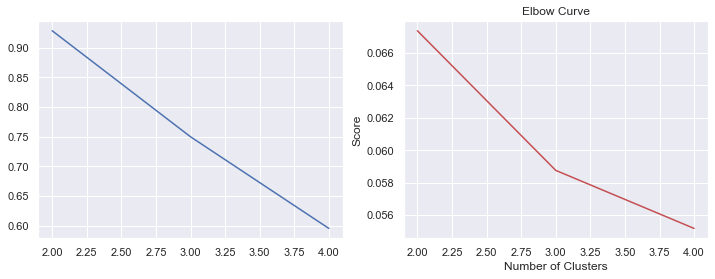

Compression: 35.75

Epoch 00049: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00068: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00081: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00086: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00092: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.

Epoch 00097: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-09.

Epoch 00102: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-10.
Epoch 00105: early stopping


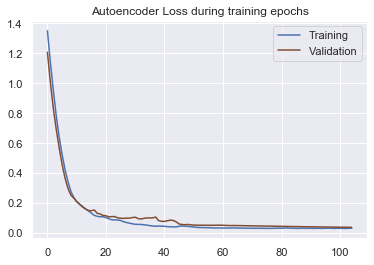

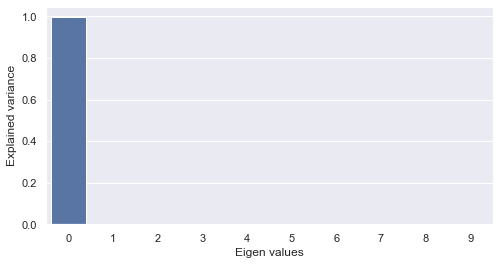

PCA on single-modal explained variance ratio: 0.999992847442627


ValueError: Image size of 86004x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 86004.1x288 with 1 Axes>

ValueError: Image size of 86004x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 86004.1x288 with 1 Axes>

Results for AE: 

Best score for training data: 0.6692307692307693 

Best C: 0.08 



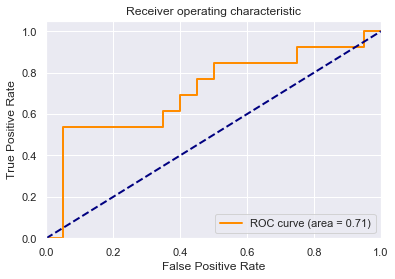

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.787879
Best score for training data: 0.6692307692307693 

Best C: 0.1 

Best Gamma: scale 



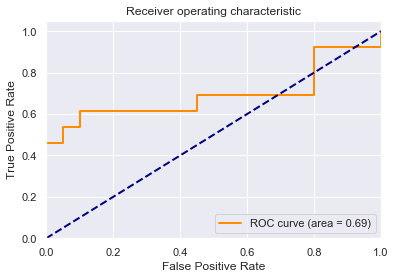

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.787879
Best score for training data: 0.6307692307692307 

Best #estimators: 140 

Best max depth: None 



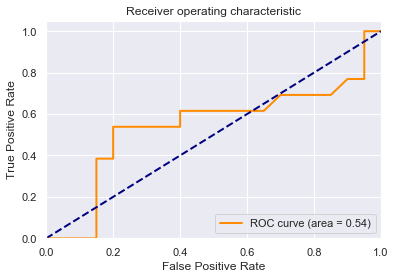

[[16  4]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.73      0.80      0.76        20
           1       0.64      0.54      0.58        13

    accuracy                           0.70        33
   macro avg       0.68      0.67      0.67        33
weighted avg       0.69      0.70      0.69        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.696970


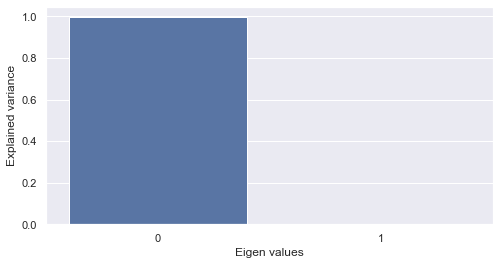

PCA on single-modal explained variance ratio: 0.9992945194244385


ValueError: Image size of 86004x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 86004.1x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9519435167312622 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.7290211915969849 - mutual information: 0.059522309913445946
4 clusters -  silhoutte score: 0.6198847889900208 - mutual information: 0.04670144470681774


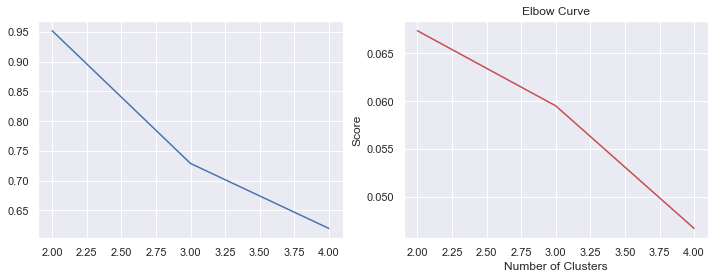

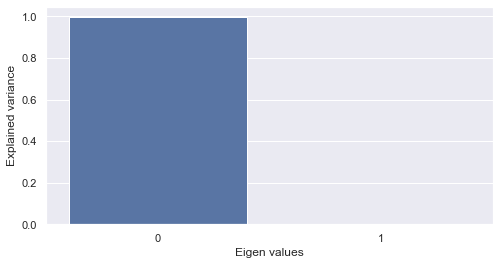

PCA on single-modal explained variance ratio: 0.9992945194244385


ValueError: Image size of 86004x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 86004.1x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9519435167312622 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.7365362048149109 - mutual information: 0.056936880070052424
4 clusters -  silhoutte score: 0.5849122405052185 - mutual information: 0.055407740342176034


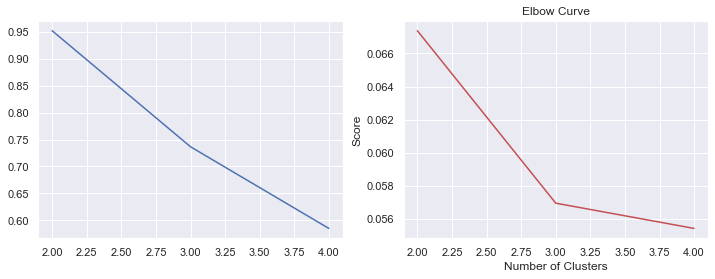

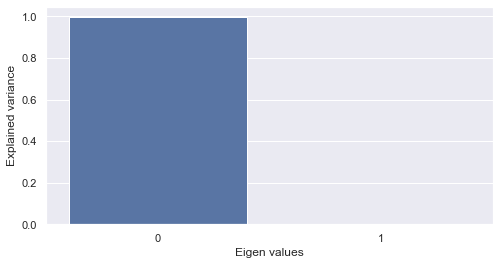

PCA on single-modal explained variance ratio: 0.9992945194244385


ValueError: Image size of 86004x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 86004.1x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9519435167312622 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.7290211915969849 - mutual information: 0.059522309913445946
4 clusters -  silhoutte score: 0.5834681391716003 - mutual information: 0.049144744468991856


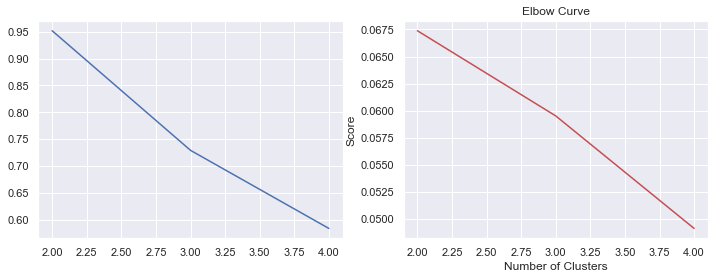

Compression: 35.75

Epoch 00065: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00070: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00070: early stopping


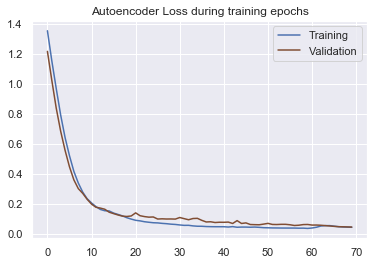

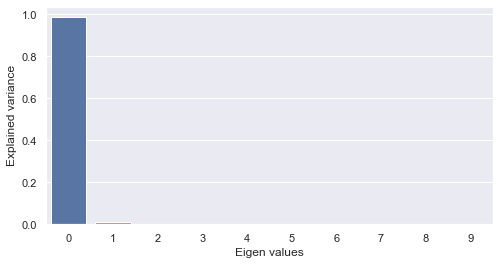

PCA on single-modal explained variance ratio: 0.9999780058860779


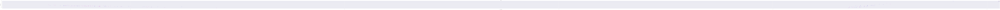

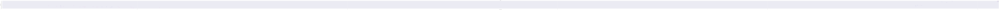

Results for AE: 

Best score for training data: 0.6692307692307693 

Best C: 0.08 



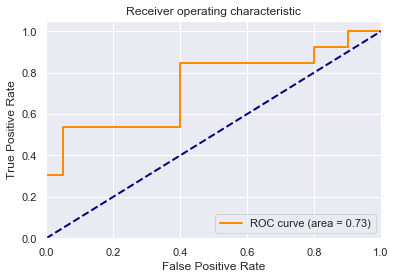

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.787879
Best score for training data: 0.6692307692307693 

Best C: 0.1 

Best Gamma: scale 



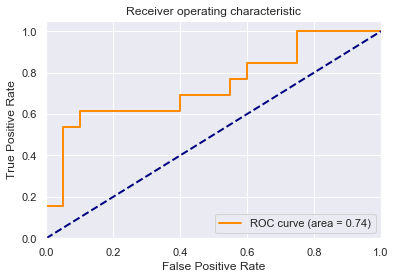

[[19  1]
 [ 6  7]]


              precision    recall  f1-score   support

           0       0.76      0.95      0.84        20
           1       0.88      0.54      0.67        13

    accuracy                           0.79        33
   macro avg       0.82      0.74      0.76        33
weighted avg       0.81      0.79      0.77        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.787879
Best score for training data: 0.6076923076923076 

Best #estimators: 100 

Best max depth: 12 



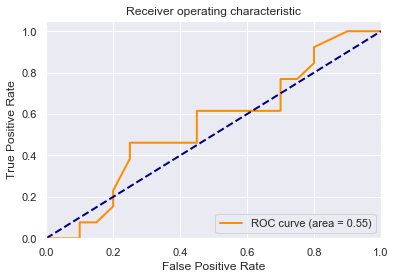

[[16  4]
 [11  2]]


              precision    recall  f1-score   support

           0       0.59      0.80      0.68        20
           1       0.33      0.15      0.21        13

    accuracy                           0.55        33
   macro avg       0.46      0.48      0.45        33
weighted avg       0.49      0.55      0.50        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.545455


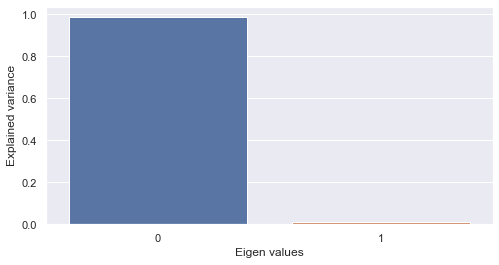

PCA on single-modal explained variance ratio: 0.9953497052192688


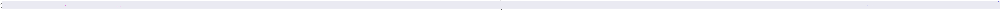

2 clusters -  silhoutte score: 0.9261731505393982 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.6288277506828308 - mutual information: 0.05659980156075864
4 clusters -  silhoutte score: 0.5179473161697388 - mutual information: 0.0526833105886081


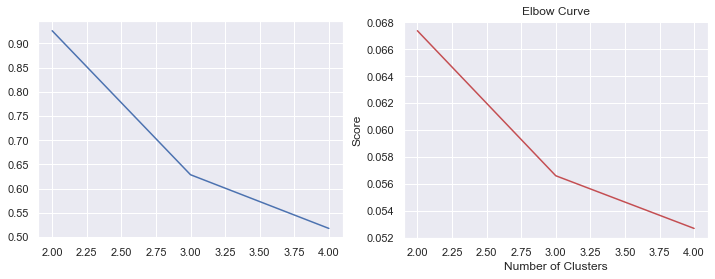

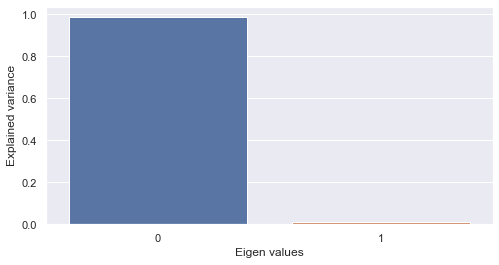

PCA on single-modal explained variance ratio: 0.9953497052192688


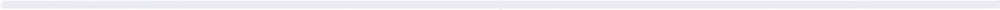

2 clusters -  silhoutte score: 0.9261731505393982 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.8216996788978577 - mutual information: 0.06184092852663484
4 clusters -  silhoutte score: 0.7981486320495605 - mutual information: 0.0678157401825999


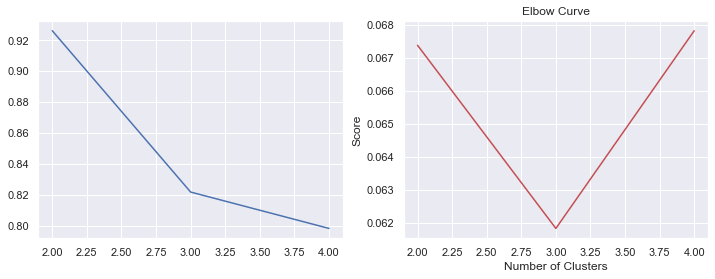

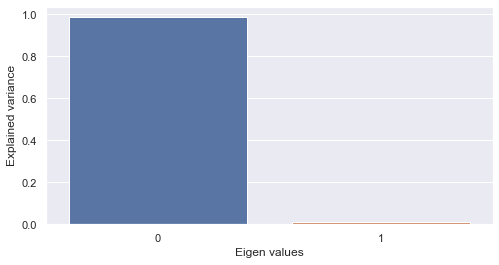

PCA on single-modal explained variance ratio: 0.9953497052192688


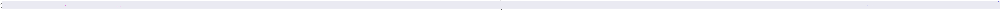

2 clusters -  silhoutte score: 0.9261731505393982 - mutual information: 0.06737744496537183
3 clusters -  silhoutte score: 0.654449462890625 - mutual information: 0.057388181910660974
4 clusters -  silhoutte score: 0.521494448184967 - mutual information: 0.05359024258954722


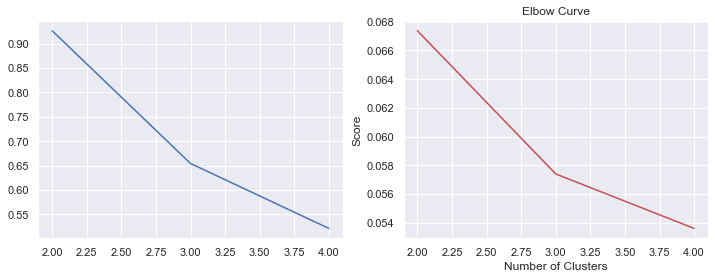

In [6]:
encoding_dims=[100]
mus=[0.5]
dropouts = [0.1]
l1s = [0.00004]
l2s = [0.000005]
scores = []
for encoding_dim in encoding_dims:
    for mu in mus:
        for dropout in dropouts:
            for l1 in l1s:
                for l2 in l2s:
                    ## Build and Train Autoencoder
                    autoencoder, encoder, decoder, loss = Models.build_and_train_autoencoder(X_swapped_first_norm,
                                                                                  X_train_first_norm,
                                                                                  encoding_dim=encoding_dim, 
                                                                                  regularizer=tf.keras.regularizers.l1_l2(l1,l2),
                                                                                  dropout=dropout,
                                                                                  epochs=200,
                                                                                  )
                    ## Encode datasets
                    X_latent_ae = Models.encode_dataset(X_train_first_norm, encoder)
                    X_latent_test_ae = Models.encode_dataset(X_test_first_norm, encoder)

                    ## PCA ON AUTOENCODER LATENT SPACE
                    X_latent_pca_ae, X_latent_test_pca_ae = Models.perform_PCA(X_latent_ae, y_train, X_latent_test_ae, y_test, n_components=10)

                    ### CLASSIFICATION ###
                    classify = Models.classify(X_latent_ae, X_latent_test_ae, np.ravel(y_train), np.ravel(y_test), model_type="AE")

                    ### CLUSTERING ###
                    clustering = Models.cluster(X_latent_ae,np.ravel(y_train), model_type="AE")

                    scores.append([mu,dropout,l1,l2,loss] + classify + clustering)


In [7]:
scores = pd.DataFrame(scores,
                      columns=["mu","dropout","l1","l2","loss","LR accuracy","SVM accuracy", "RF accuracy", "LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC","KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette","KMeans MI","Spectral MI","Hierarchical MI"])    
display(scores)
print(f"Random classifier: {y_test.iloc[:,0].value_counts()[0]/len(y_test)}")

,mu,dropout,l1,l2,loss,LR accuracy,SVM accuracy,RF accuracy,LR ROC-AUC,SVM ROC-AUC,RF ROC-AUC,KMeans Silhouette,Spectral Silhouette,Hierarchical Silhouette,KMeans MI,Spectral MI,Hierarchical MI
0,0.5,0.00,0.00004,0.000005,0.033953,0.787879,0.787879,0.666667,0.734615,0.615385,0.626923,0.759013,0.759013,0.759013,0.047921,0.051917,0.048383
1,0.5,0.05,0.00004,0.000005,0.034603,0.787879,0.787879,0.515152,0.750000,0.707692,0.467308,0.882577,0.882577,0.882577,0.056971,0.064476,0.059595
2,0.5,0.10,0.00004,0.000005,0.029683,0.787879,0.787879,0.606061,0.692308,0.711538,0.680769,0.955046,0.955046,0.955046,0.055280,0.060791,0.055733
3,0.5,0.15,0.00004,0.000005,0.028700,0.787879,0.787879,0.606061,0.688462,0.688462,0.601923,0.952551,0.952551,0.952551,0.050095,0.070065,0.050853
4,0.5,0.20,0.00004,0.000005,0.042117,0.787879,0.787879,0.545455,0.746154,0.650000,0.540385,0.943939,0.943939,0.943939,0.045718,0.058532,0.044635
5,0.5,0.25,0.00004,0.000005,0.026083,0.787879,0.787879,0.515152,0.719231,0.688462,0.532692,0.941485,0.941485,0.941485,0.059722,0.063856,0.046827
6,0.5,0.30,0.00004,0.000005,0.044047,0.787879,0.787879,0.515152,0.703846,0.661538,0.636538,0.928801,0.928801,0.928801,0.054962,0.056760,0.055171
7,0.5,0.35,0.00004,0.000005,0.031861,0.787879,0.787879,0.696970,0.711538,0.692308,0.542308,0.951944,0.951944,0.951944,0.046701,0.055408,0.049145
8,0.5,0.40,0.00004,0.000005,0.041924,0.787879,0.787879,0.545455,0.734615,0.738462,0.546154,0.926173,0.926173,0.926173,0.052683,0.067816,0.053590


Random classifier: 0.6060606060606061


C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:376: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(new_indexer, value)
C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the docume

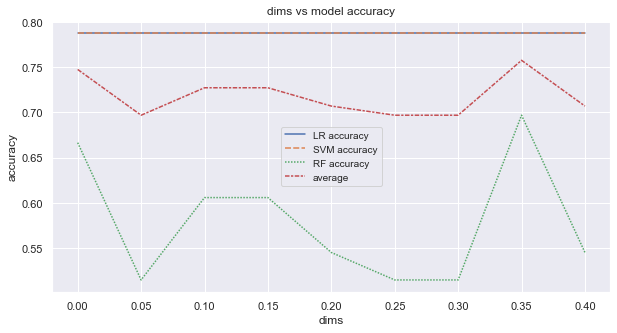

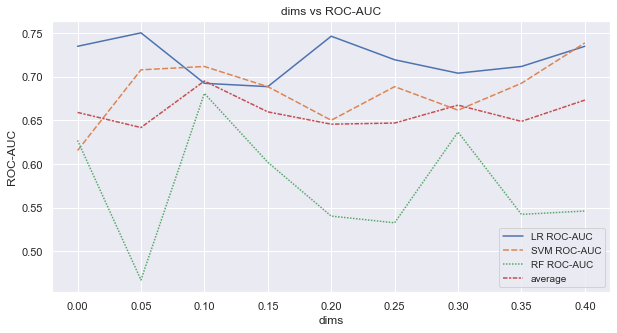

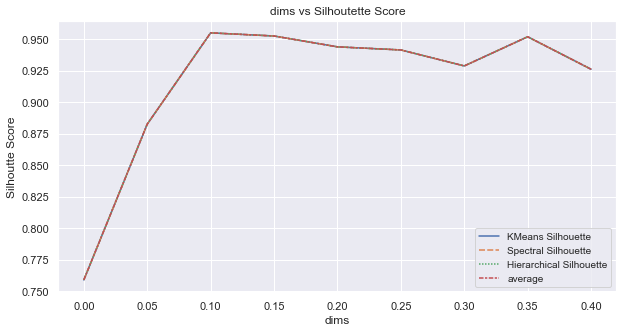

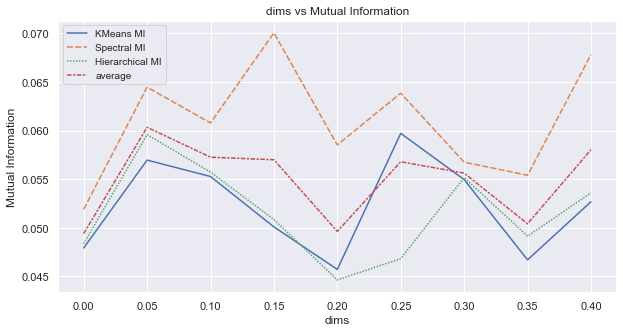

In [8]:
scores.index = dropouts

data_acc = scores[["LR accuracy","SVM accuracy","RF accuracy"]]
data_acc.loc[:,"average"] = data_acc.mean(axis=1)

data_auc = scores[["LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC"]]
data_auc.loc[:,"average"] = data_auc.mean(axis=1)

data_ss = scores[["KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette"]]
data_ss.loc[:,"average"] = data_ss.mean(axis=1)

data_mi = scores[["KMeans MI","Spectral MI","Hierarchical MI"]]
data_mi.loc[:,"average"] = data_mi.mean(axis=1)

sns.set()
hyperparam = "dims"

ax = sns.lineplot(data=data_acc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"accuracy")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs model accuracy")
plt.show()

ax = sns.lineplot(data=data_auc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"ROC-AUC")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs ROC-AUC")
plt.show()

ax = sns.lineplot(data=data_ss)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Silhoutte Score")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Silhoutette Score")
plt.show()

ax = sns.lineplot(data=data_mi)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Mutual Information")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Mutual Information")
plt.show()

Compression: 86.93

Epoch 00070: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00075: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00075: early stopping


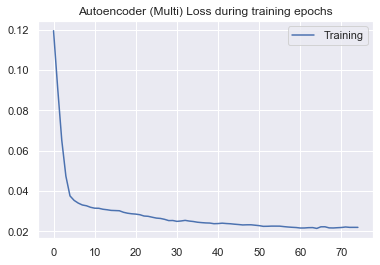

0.021921198356610078


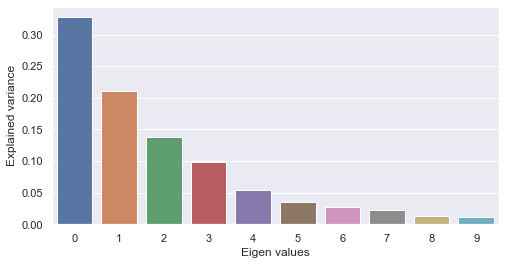

PCA on single-modal explained variance ratio: 0.938188910484314


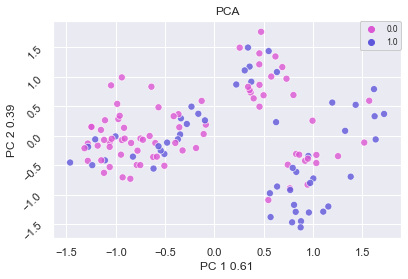

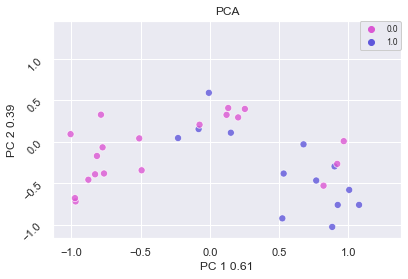

Results for AE: 

Best score for training data: 0.7230769230769232 

Best C: 0.08 



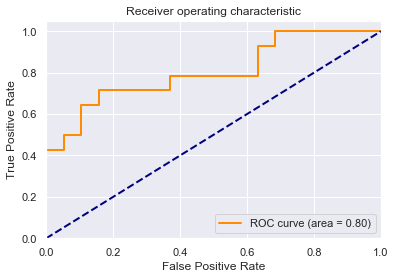

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for Logistic Regression: 0.730769
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6846153846153846 

Best C: 1.0 

Best Gamma: 0.1 



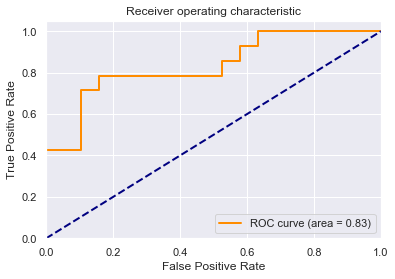

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for SVM: 0.730769
Testing  set score for SVM: 0.727273
Best score for training data: 0.6692307692307693 

Best #estimators: 140 

Best max depth: None 



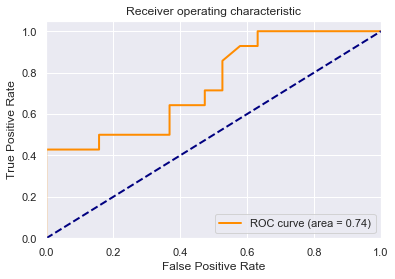

[[12  7]
 [ 5  9]]


              precision    recall  f1-score   support

           0       0.71      0.63      0.67        19
           1       0.56      0.64      0.60        14

    accuracy                           0.64        33
   macro avg       0.63      0.64      0.63        33
weighted avg       0.65      0.64      0.64        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.636364


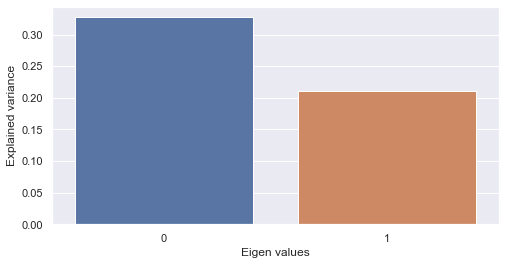

PCA on single-modal explained variance ratio: 0.5373327732086182


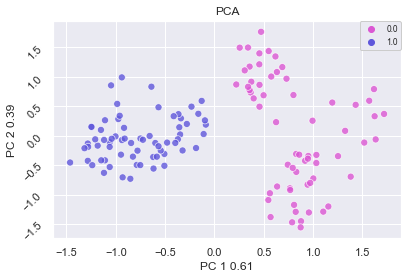

2 clusters -  silhoutte score: 0.2678810656070709 - mutual information: 0.04441031311684144
3 clusters -  silhoutte score: 0.3280709385871887 - mutual information: 0.044472651685965946
4 clusters -  silhoutte score: 0.23860406875610352 - mutual information: 0.04624508531366666


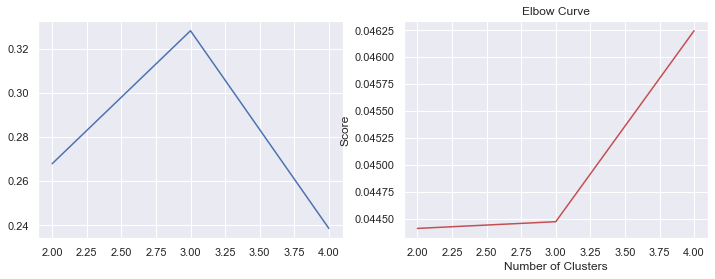

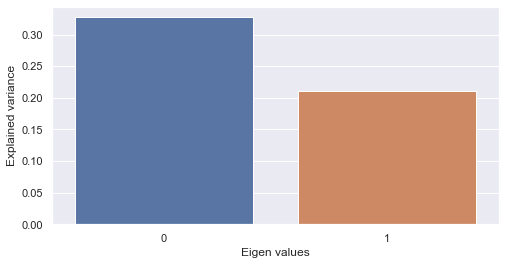

PCA on single-modal explained variance ratio: 0.5373327732086182


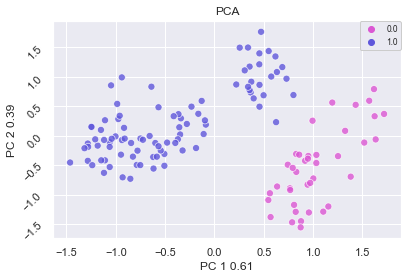

2 clusters -  silhoutte score: 0.2869889438152313 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.3280709385871887 - mutual information: 0.044472651685965946
4 clusters -  silhoutte score: 0.30402061343193054 - mutual information: 0.08807599039247924


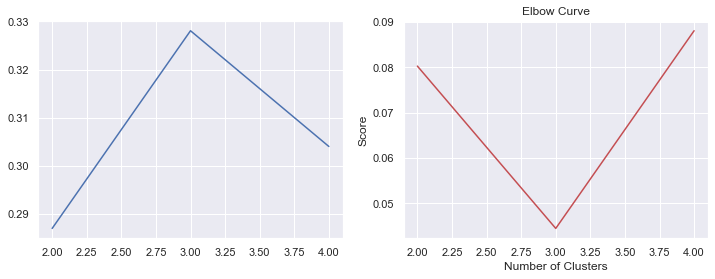

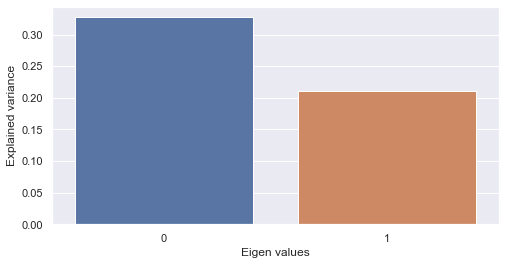

PCA on single-modal explained variance ratio: 0.5373327732086182


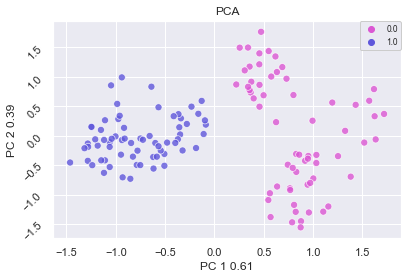

2 clusters -  silhoutte score: 0.2678810656070709 - mutual information: 0.04441031311684144
3 clusters -  silhoutte score: 0.3280709385871887 - mutual information: 0.044472651685965946
4 clusters -  silhoutte score: 0.23346546292304993 - mutual information: 0.04557019256240677


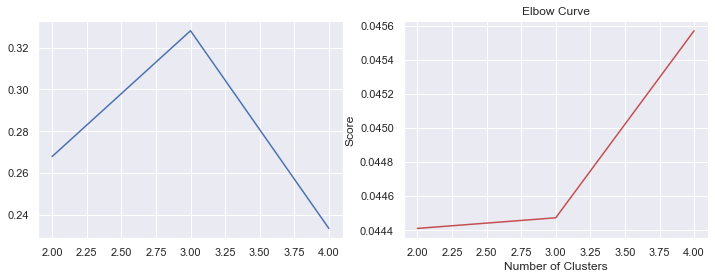

Compression: 86.93

Epoch 00058: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00063: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00063: early stopping


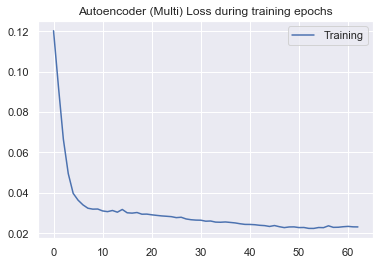

0.02309655762062623


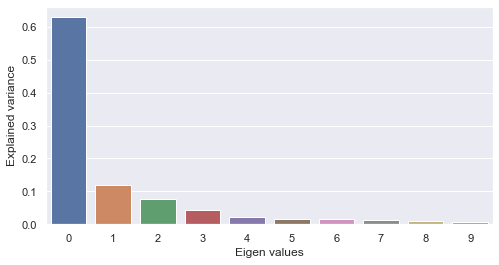

PCA on single-modal explained variance ratio: 0.9528006315231323


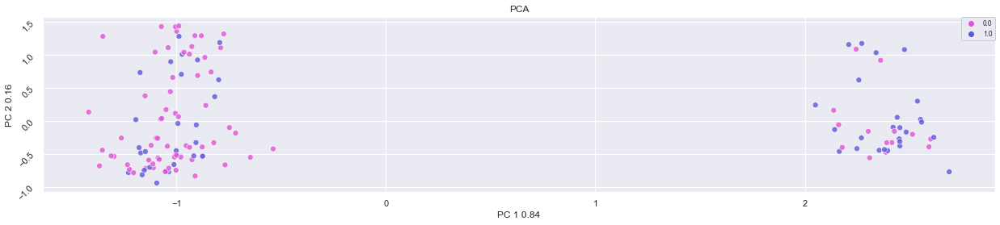

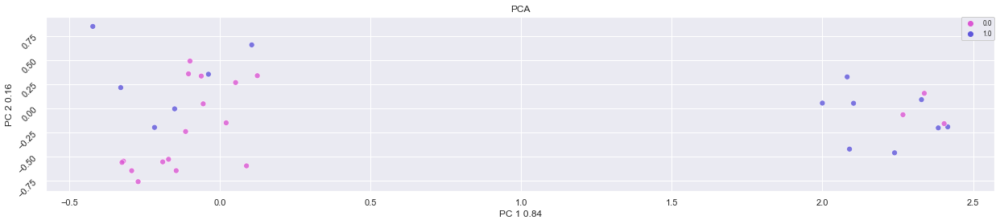

Results for AE: 

Best score for training data: 0.7153846153846155 

Best C: 0.08 



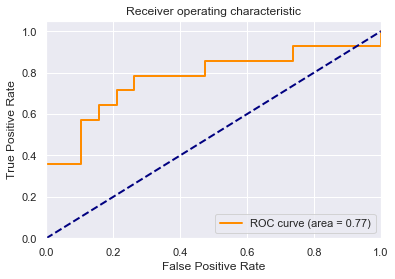

[[17  2]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.74      0.89      0.81        19
           1       0.80      0.57      0.67        14

    accuracy                           0.76        33
   macro avg       0.77      0.73      0.74        33
weighted avg       0.76      0.76      0.75        33

Training set score for Logistic Regression: 0.723077
Testing  set score for Logistic Regression: 0.757576
Best score for training data: 0.6923076923076923 

Best C: 1.0 

Best Gamma: 0.1 



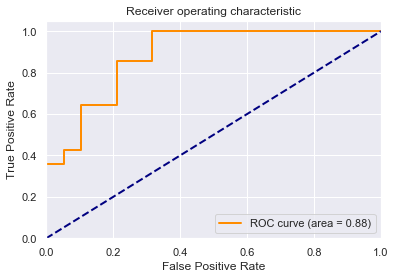

[[18  1]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.69      0.95      0.80        19
           1       0.86      0.43      0.57        14

    accuracy                           0.73        33
   macro avg       0.77      0.69      0.69        33
weighted avg       0.76      0.73      0.70        33

Training set score for SVM: 0.730769
Testing  set score for SVM: 0.727273
Best score for training data: 0.7384615384615385 

Best #estimators: 100 

Best max depth: 12 



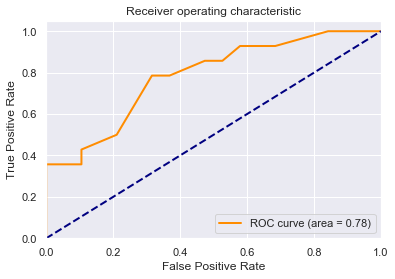

[[17  2]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.68      0.89      0.77        19
           1       0.75      0.43      0.55        14

    accuracy                           0.70        33
   macro avg       0.72      0.66      0.66        33
weighted avg       0.71      0.70      0.68        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.696970


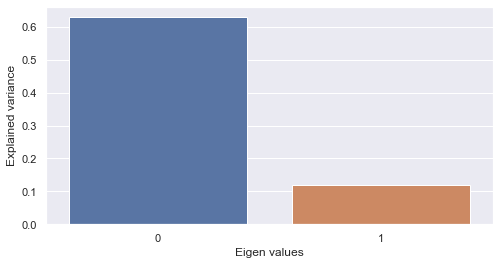

PCA on single-modal explained variance ratio: 0.7480710744857788


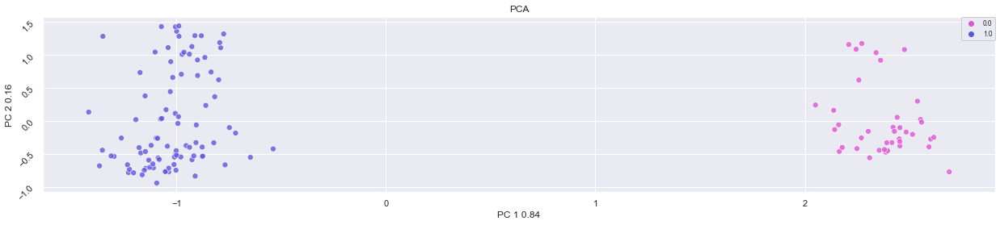

2 clusters -  silhoutte score: 0.5697084665298462 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.39492106437683105 - mutual information: 0.06002105443573342
4 clusters -  silhoutte score: 0.30782777070999146 - mutual information: 0.08564299825245332


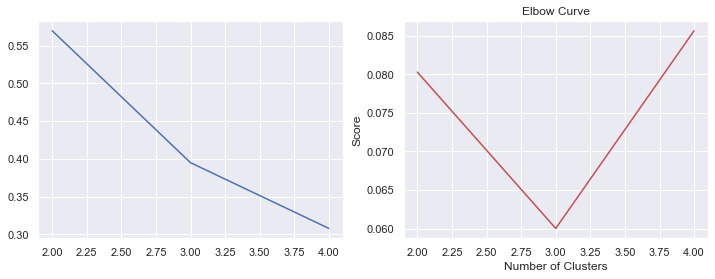

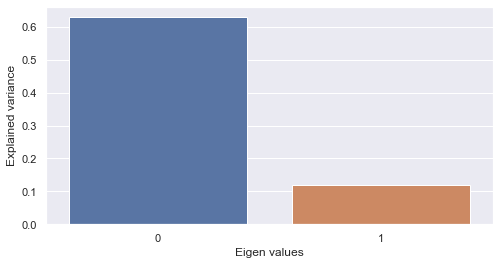

PCA on single-modal explained variance ratio: 0.7480710744857788


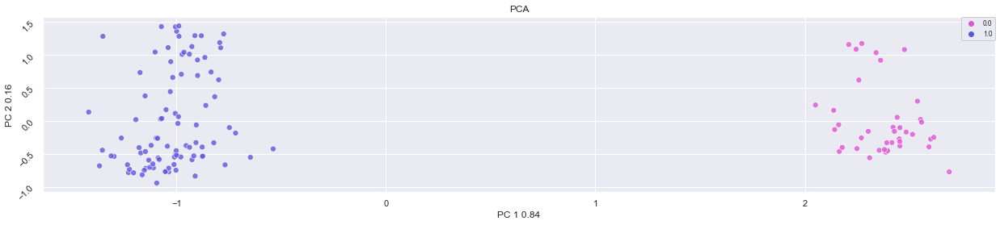

2 clusters -  silhoutte score: 0.5697084665298462 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.4849381744861603 - mutual information: 0.07342742256852253
4 clusters -  silhoutte score: 0.3231852054595947 - mutual information: 0.05683755605714828


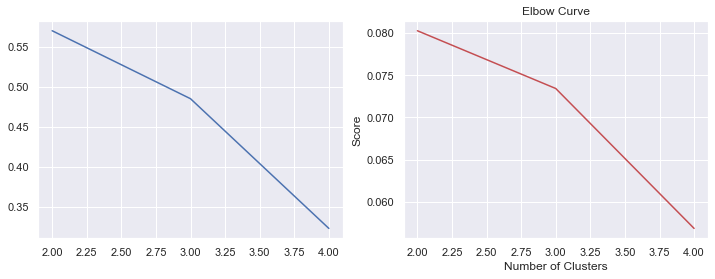

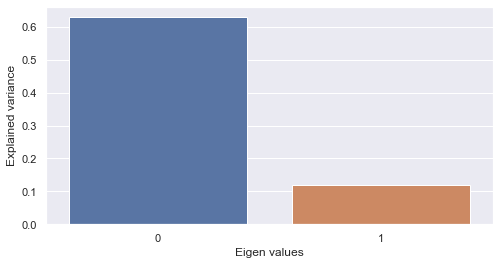

PCA on single-modal explained variance ratio: 0.7480710744857788


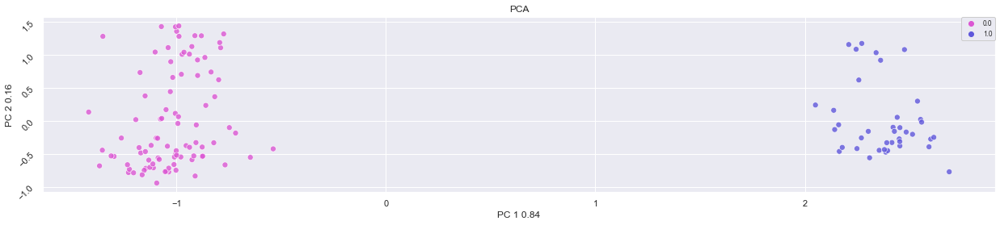

2 clusters -  silhoutte score: 0.5697084665298462 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.39008840918540955 - mutual information: 0.05955887799131616
4 clusters -  silhoutte score: 0.2964455187320709 - mutual information: 0.10200155910048678


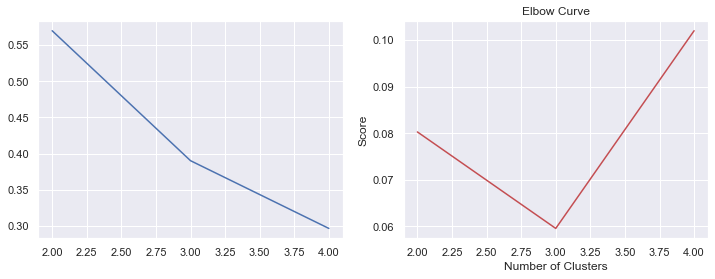

Compression: 86.93

Epoch 00045: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00060: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00065: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.
Epoch 00065: early stopping


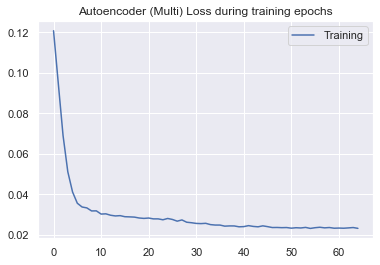

0.023186180396721913


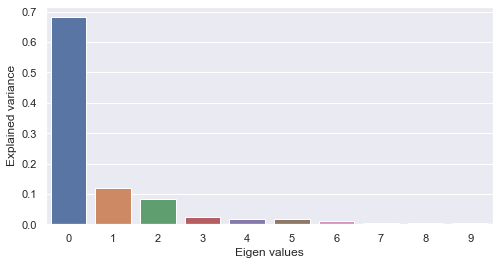

PCA on single-modal explained variance ratio: 0.9736719131469727


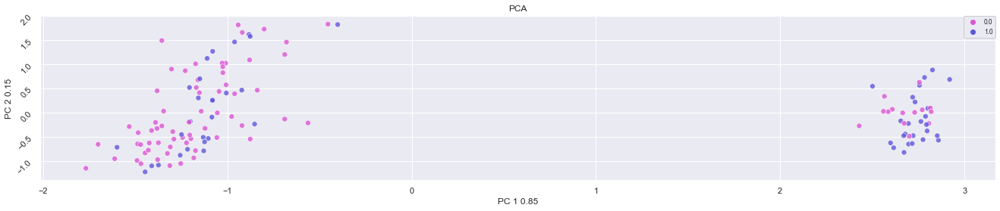

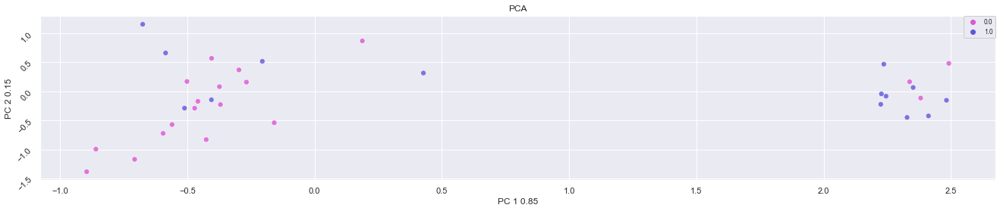

Results for AE: 

Best score for training data: 0.7000000000000001 

Best C: 0.08 



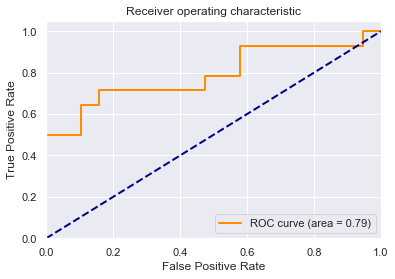

[[17  2]
 [ 5  9]]


              precision    recall  f1-score   support

           0       0.77      0.89      0.83        19
           1       0.82      0.64      0.72        14

    accuracy                           0.79        33
   macro avg       0.80      0.77      0.77        33
weighted avg       0.79      0.79      0.78        33

Training set score for Logistic Regression: 0.700000
Testing  set score for Logistic Regression: 0.787879
Best score for training data: 0.7 

Best C: 1.0 

Best Gamma: 0.1 



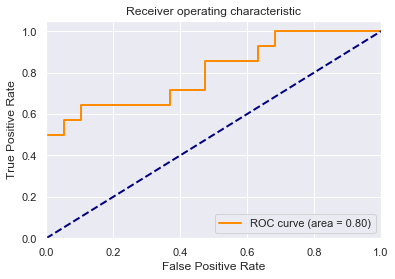

[[19  0]
 [ 9  5]]


              precision    recall  f1-score   support

           0       0.68      1.00      0.81        19
           1       1.00      0.36      0.53        14

    accuracy                           0.73        33
   macro avg       0.84      0.68      0.67        33
weighted avg       0.81      0.73      0.69        33

Training set score for SVM: 0.730769
Testing  set score for SVM: 0.727273
Best score for training data: 0.6692307692307693 

Best #estimators: 100 

Best max depth: 12 



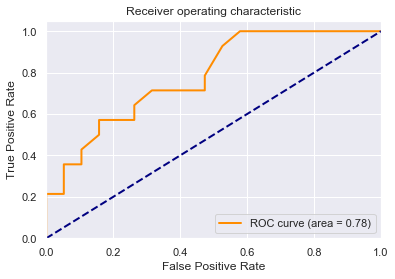

[[17  2]
 [ 9  5]]


              precision    recall  f1-score   support

           0       0.65      0.89      0.76        19
           1       0.71      0.36      0.48        14

    accuracy                           0.67        33
   macro avg       0.68      0.63      0.62        33
weighted avg       0.68      0.67      0.64        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.666667


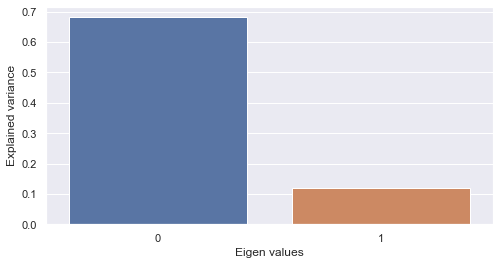

PCA on single-modal explained variance ratio: 0.8026883006095886


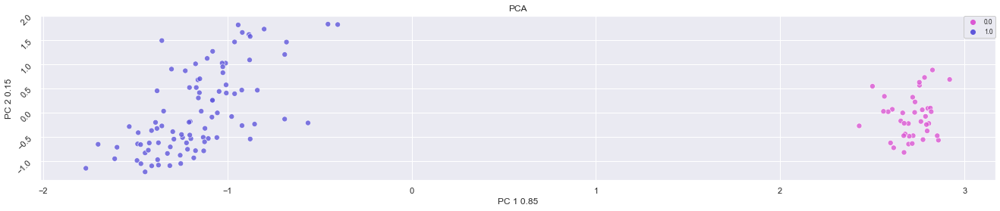

2 clusters -  silhoutte score: 0.6074649691581726 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.4172210097312927 - mutual information: 0.06391089692777463
4 clusters -  silhoutte score: 0.35913392901420593 - mutual information: 0.051371255971524914


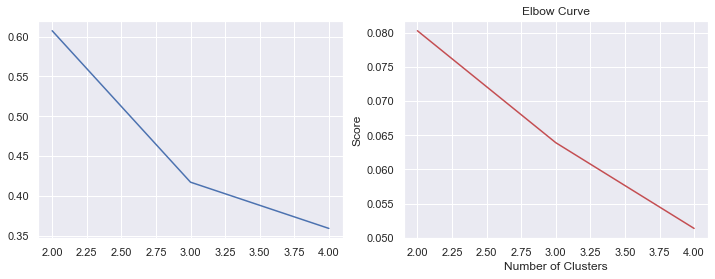

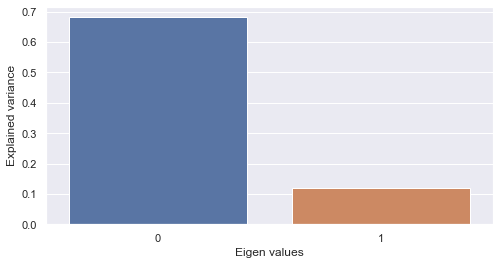

PCA on single-modal explained variance ratio: 0.8026883006095886


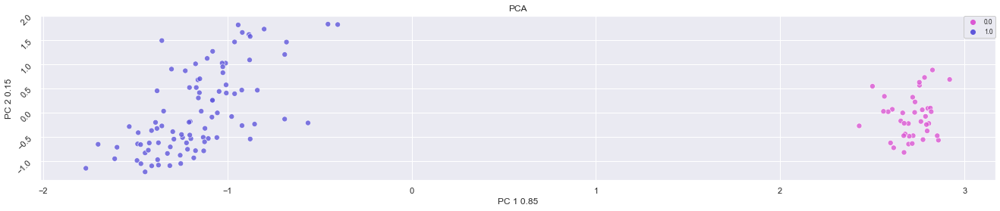

2 clusters -  silhoutte score: 0.6074649691581726 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.44133260846138 - mutual information: 0.06140168518413852
4 clusters -  silhoutte score: 0.3454234004020691 - mutual information: 0.09660977170486608


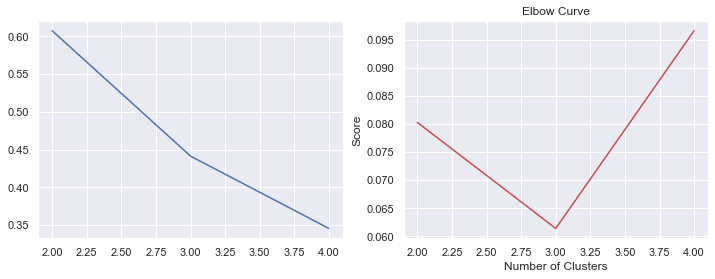

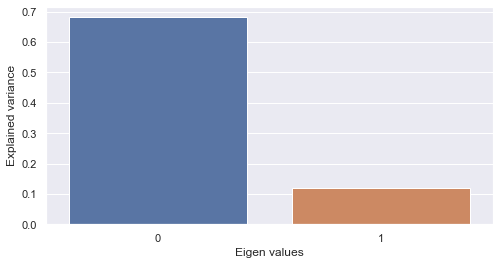

PCA on single-modal explained variance ratio: 0.8026883006095886


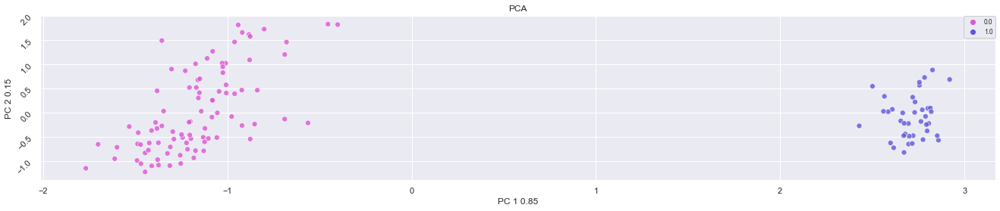

2 clusters -  silhoutte score: 0.6074649691581726 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.4388306140899658 - mutual information: 0.0619694529099769
4 clusters -  silhoutte score: 0.34378373622894287 - mutual information: 0.05195513431742707


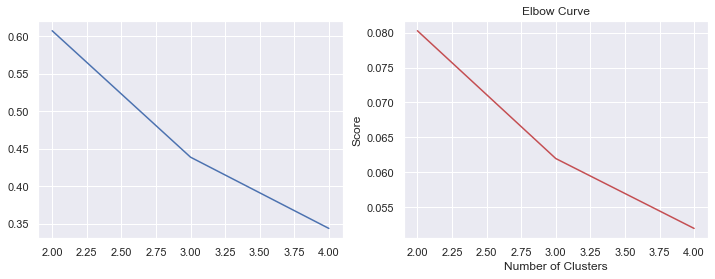

Compression: 86.93

Epoch 00061: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00078: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00084: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00089: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00093: early stopping


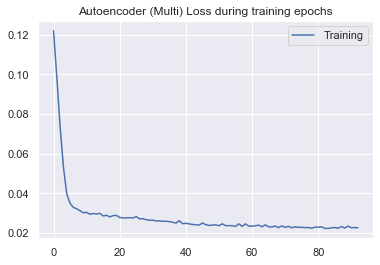

0.02258434352966455


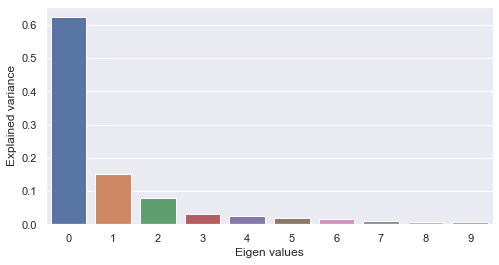

PCA on single-modal explained variance ratio: 0.9645490646362305


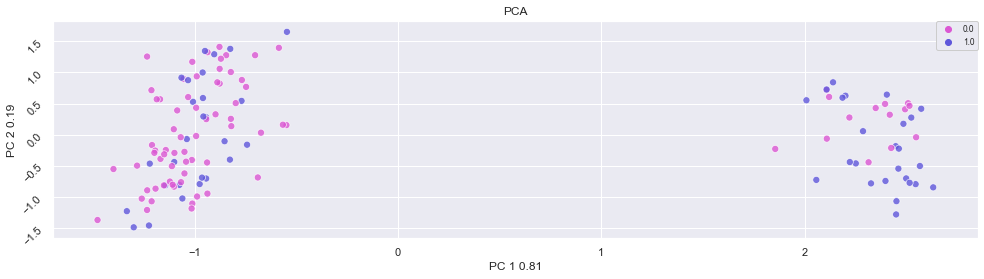

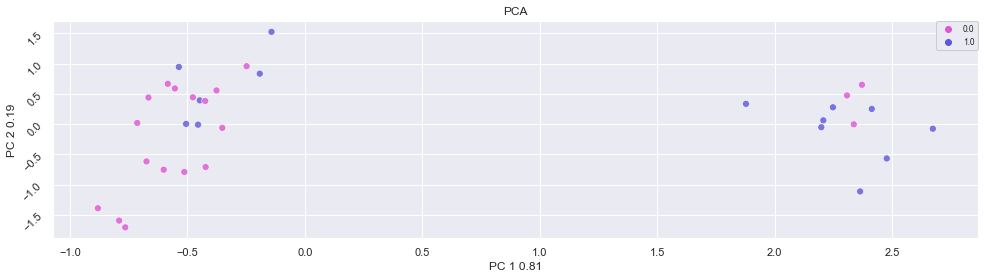

Results for AE: 

Best score for training data: 0.7000000000000001 

Best C: 0.08 



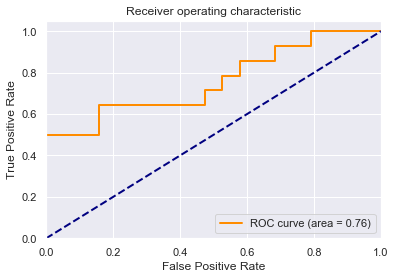

[[16  3]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.70      0.84      0.76        19
           1       0.70      0.50      0.58        14

    accuracy                           0.70        33
   macro avg       0.70      0.67      0.67        33
weighted avg       0.70      0.70      0.69        33

Training set score for Logistic Regression: 0.700000
Testing  set score for Logistic Regression: 0.696970
Best score for training data: 0.6846153846153846 

Best C: 1.0 

Best Gamma: 0.1 



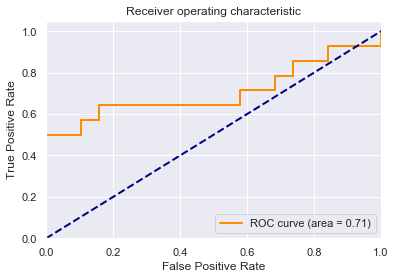

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for SVM: 0.715385
Testing  set score for SVM: 0.727273
Best score for training data: 0.6615384615384615 

Best #estimators: 100 

Best max depth: 12 



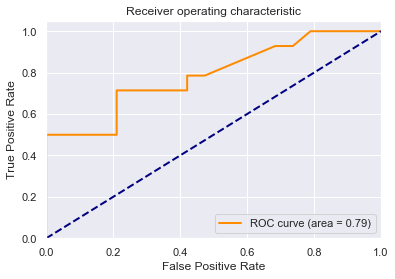

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.727273


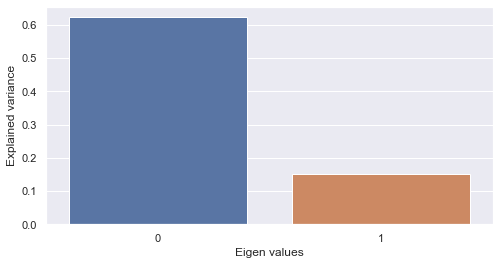

PCA on single-modal explained variance ratio: 0.7728535532951355


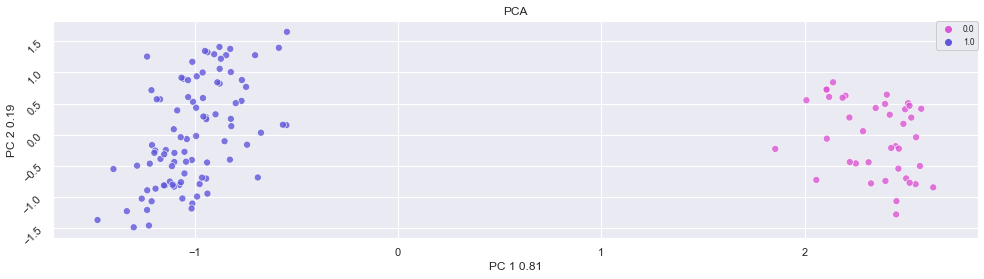

2 clusters -  silhoutte score: 0.5628634095191956 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.38518813252449036 - mutual information: 0.05852406659824762
4 clusters -  silhoutte score: 0.3151135742664337 - mutual information: 0.08410266949040562


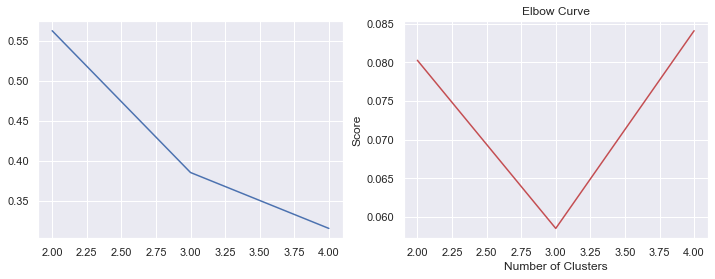

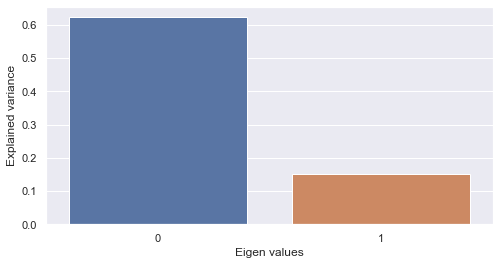

PCA on single-modal explained variance ratio: 0.7728535532951355


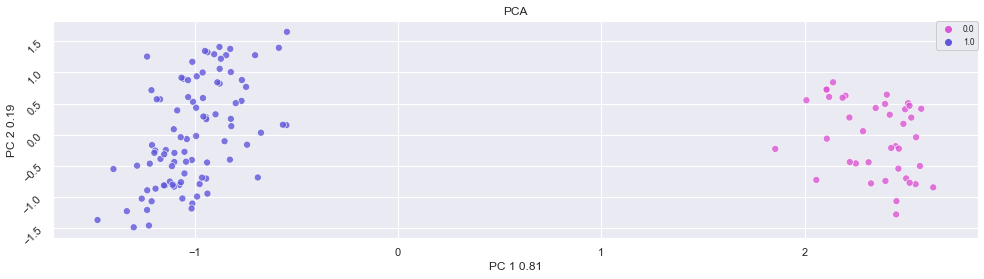

2 clusters -  silhoutte score: 0.5628634095191956 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.48286914825439453 - mutual information: 0.11885700806170878
4 clusters -  silhoutte score: 0.3229600787162781 - mutual information: 0.09201374376883692


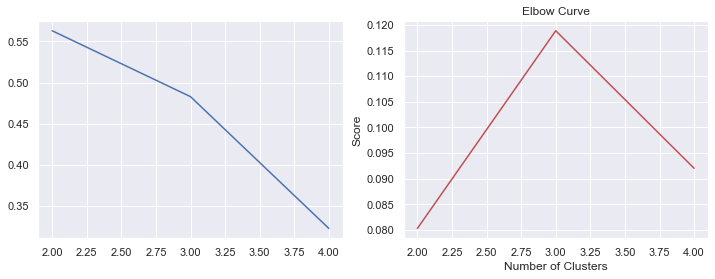

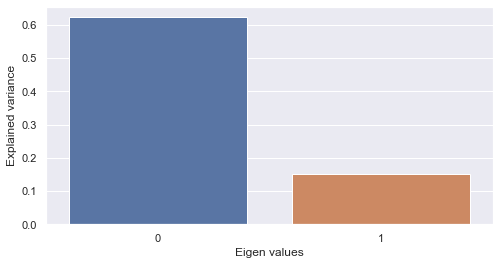

PCA on single-modal explained variance ratio: 0.7728535532951355


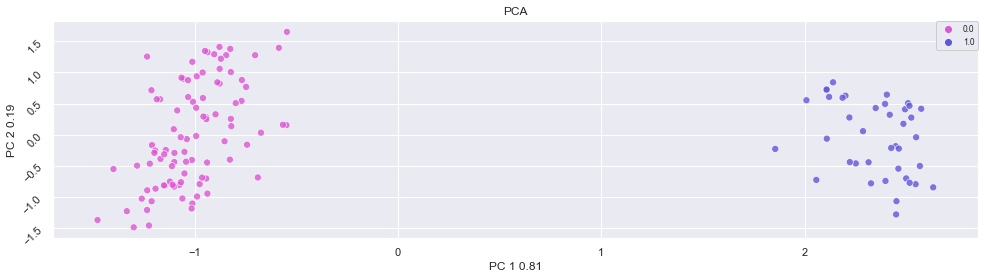

2 clusters -  silhoutte score: 0.5628634095191956 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.38896864652633667 - mutual information: 0.06200928089871952
4 clusters -  silhoutte score: 0.3321724236011505 - mutual information: 0.05449291289328811


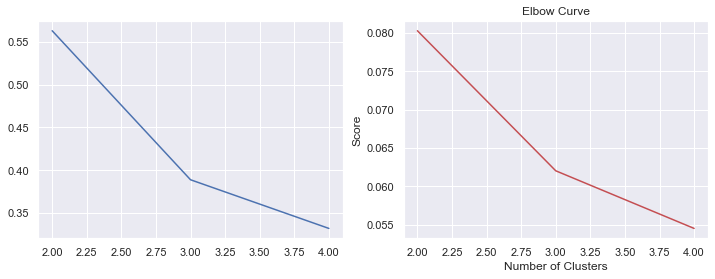

Compression: 86.93

Epoch 00035: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00045: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00053: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00060: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00065: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.
Epoch 00065: early stopping


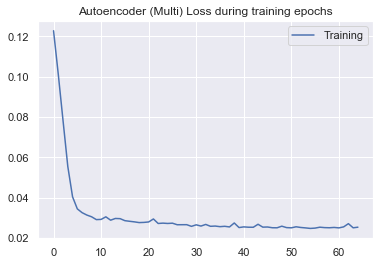

0.025258403099500216


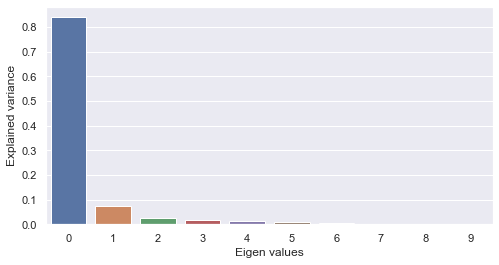

PCA on single-modal explained variance ratio: 0.9903264045715332


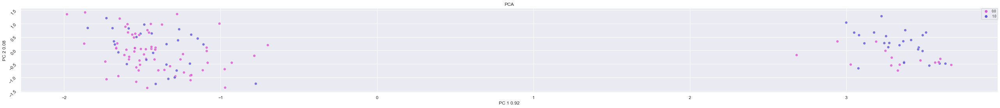

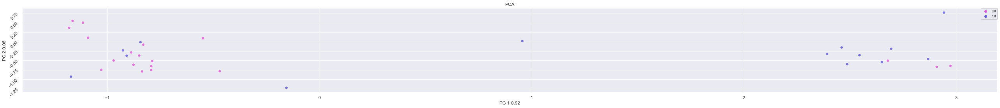

Results for AE: 

Best score for training data: 0.6923076923076923 

Best C: 0.08 



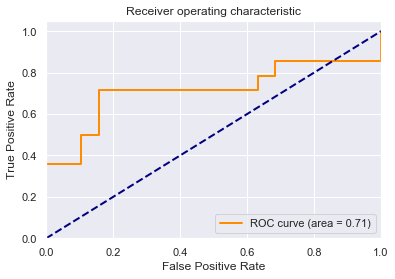

[[17  2]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.68      0.89      0.77        19
           1       0.75      0.43      0.55        14

    accuracy                           0.70        33
   macro avg       0.72      0.66      0.66        33
weighted avg       0.71      0.70      0.68        33

Training set score for Logistic Regression: 0.692308
Testing  set score for Logistic Regression: 0.696970
Best score for training data: 0.6846153846153845 

Best C: 1.0 

Best Gamma: 0.1 



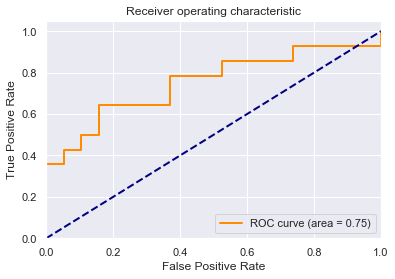

[[19  0]
 [14  0]]


              precision    recall  f1-score   support

           0       0.58      1.00      0.73        19
           1       0.00      0.00      0.00        14

    accuracy                           0.58        33
   macro avg       0.29      0.50      0.37        33
weighted avg       0.33      0.58      0.42        33

Training set score for SVM: 0.738462
Testing  set score for SVM: 0.575758


C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Best score for training data: 0.6692307692307692 

Best #estimators: 140 

Best max depth: None 



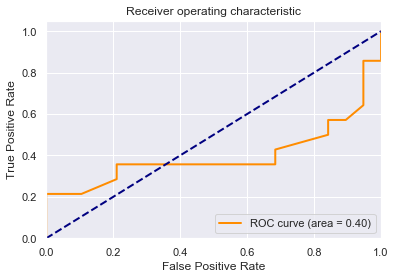

[[19  0]
 [12  2]]


              precision    recall  f1-score   support

           0       0.61      1.00      0.76        19
           1       1.00      0.14      0.25        14

    accuracy                           0.64        33
   macro avg       0.81      0.57      0.51        33
weighted avg       0.78      0.64      0.54        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.636364


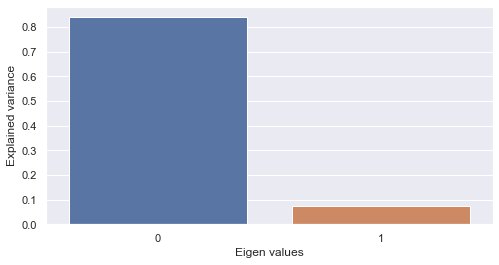

PCA on single-modal explained variance ratio: 0.9138075709342957


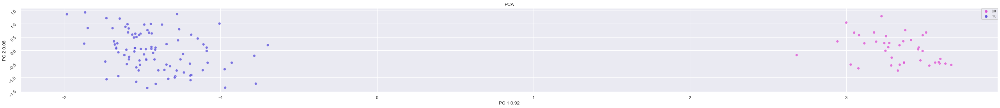

2 clusters -  silhoutte score: 0.7332940697669983 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.4426056146621704 - mutual information: 0.06691305653898612
4 clusters -  silhoutte score: 0.33952659368515015 - mutual information: 0.08731553019070233


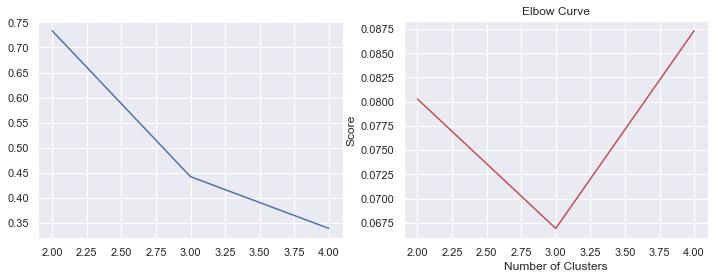

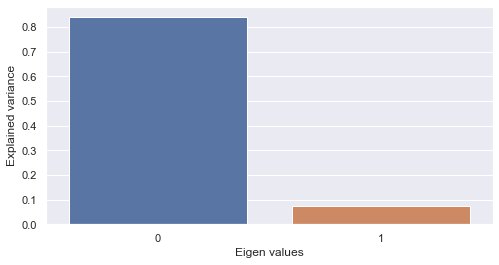

PCA on single-modal explained variance ratio: 0.9138075709342957


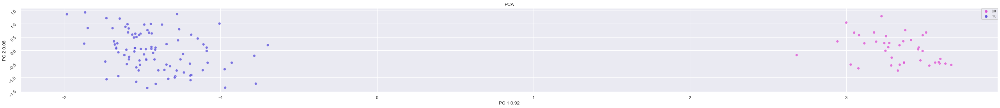

2 clusters -  silhoutte score: 0.7332940697669983 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.6260741949081421 - mutual information: 0.10547667281988403
4 clusters -  silhoutte score: 0.33952659368515015 - mutual information: 0.08731553019070233


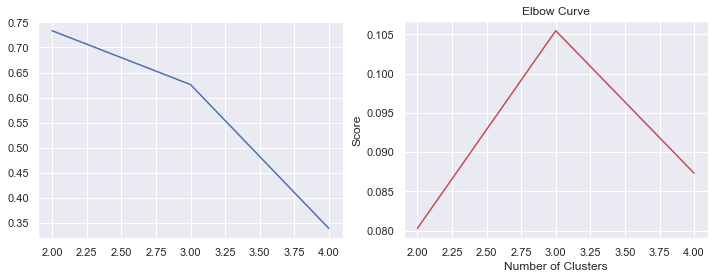

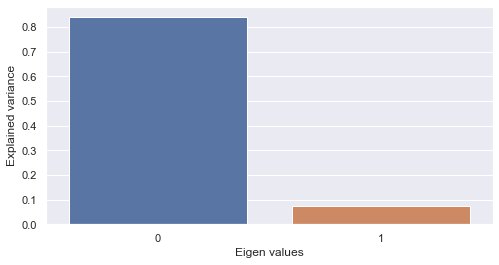

PCA on single-modal explained variance ratio: 0.9138075709342957


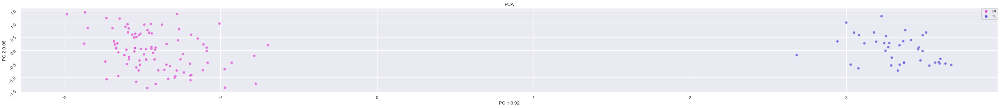

2 clusters -  silhoutte score: 0.7332940697669983 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.43049556016921997 - mutual information: 0.05852406659824762
4 clusters -  silhoutte score: 0.323434442281723 - mutual information: 0.09246015364875805


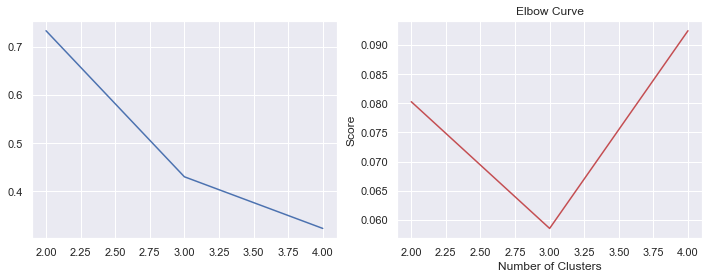

Compression: 86.93

Epoch 00024: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00037: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00047: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00052: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00052: early stopping


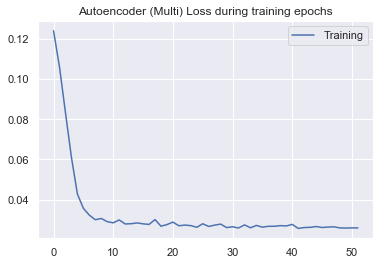

0.02588475618797999


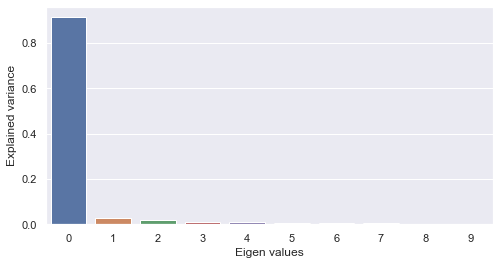

PCA on single-modal explained variance ratio: 0.9926785230636597


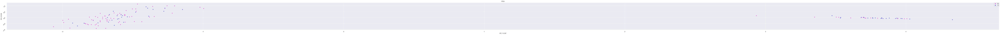

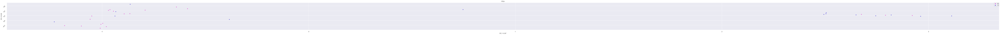

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



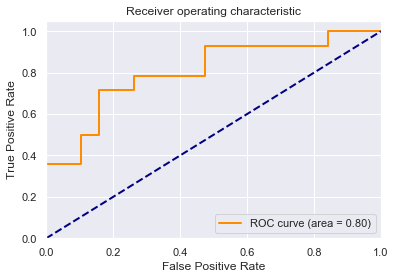

[[16  3]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.70      0.84      0.76        19
           1       0.70      0.50      0.58        14

    accuracy                           0.70        33
   macro avg       0.70      0.67      0.67        33
weighted avg       0.70      0.70      0.69        33

Training set score for Logistic Regression: 0.684615
Testing  set score for Logistic Regression: 0.696970
Best score for training data: 0.6846153846153846 

Best C: 0.1 

Best Gamma: scale 



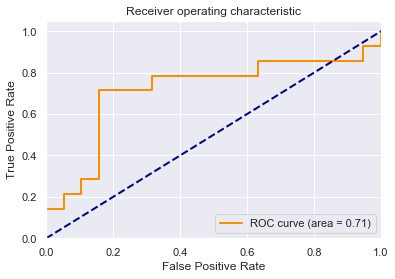

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for SVM: 0.684615
Testing  set score for SVM: 0.727273
Best score for training data: 0.6846153846153845 

Best #estimators: 100 

Best max depth: 12 



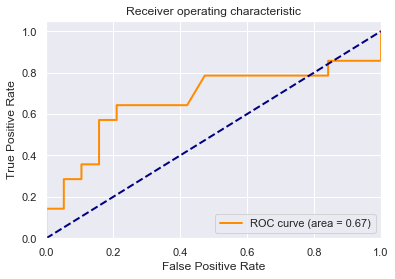

[[18  1]
 [11  3]]


              precision    recall  f1-score   support

           0       0.62      0.95      0.75        19
           1       0.75      0.21      0.33        14

    accuracy                           0.64        33
   macro avg       0.69      0.58      0.54        33
weighted avg       0.68      0.64      0.57        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.636364


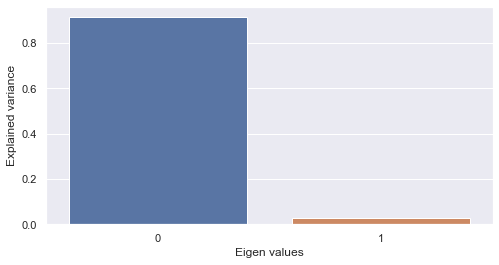

PCA on single-modal explained variance ratio: 0.9389022588729858


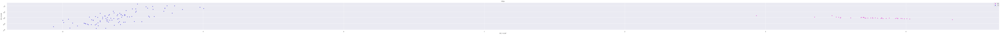

2 clusters -  silhoutte score: 0.8046101927757263 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.4112992286682129 - mutual information: 0.06254251971459499
4 clusters -  silhoutte score: 0.40559884905815125 - mutual information: 0.05589289781405046


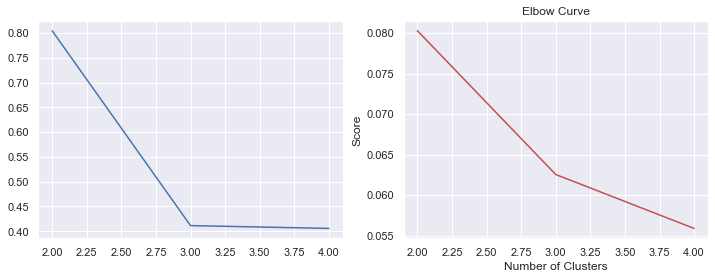

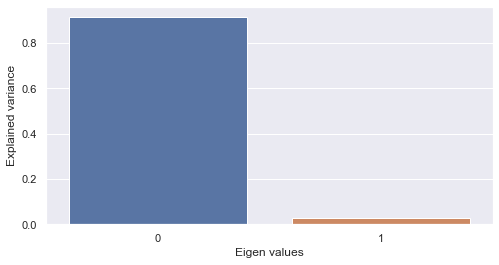

PCA on single-modal explained variance ratio: 0.9389022588729858


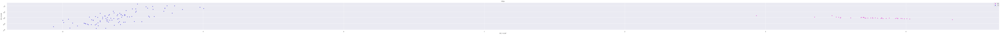

2 clusters -  silhoutte score: 0.8046101927757263 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.4269302189350128 - mutual information: 0.06200928089871952
4 clusters -  silhoutte score: 0.40928182005882263 - mutual information: 0.056316233101422794


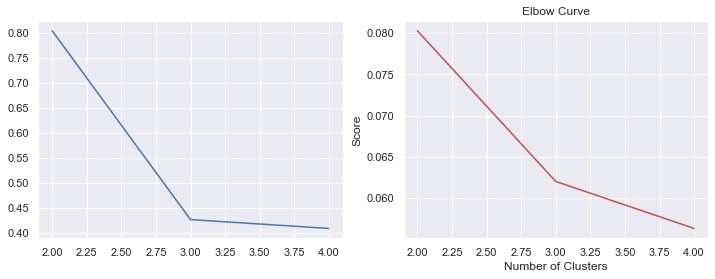

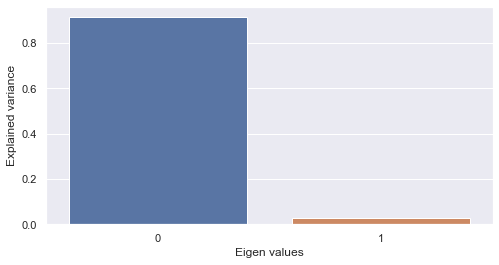

PCA on single-modal explained variance ratio: 0.9389022588729858


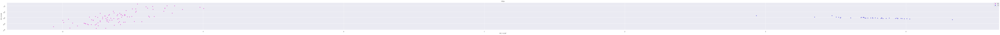

2 clusters -  silhoutte score: 0.8046101927757263 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.43510115146636963 - mutual information: 0.06823922654656392
4 clusters -  silhoutte score: 0.3988460898399353 - mutual information: 0.05558873071143417


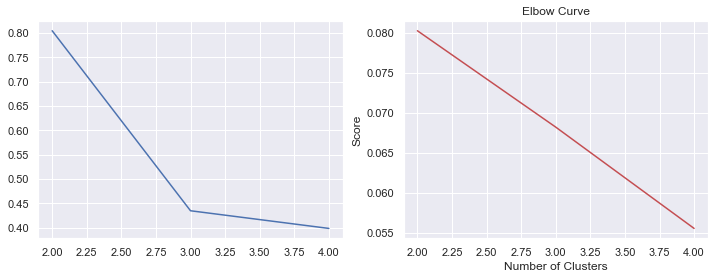

Compression: 86.93

Epoch 00038: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00043: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00043: early stopping


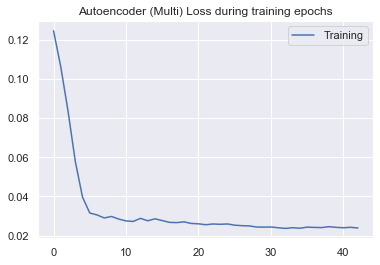

0.02389391752389761


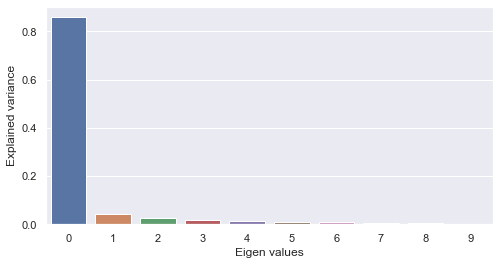

PCA on single-modal explained variance ratio: 0.9863336682319641


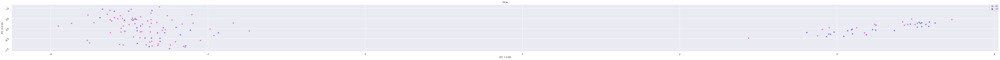

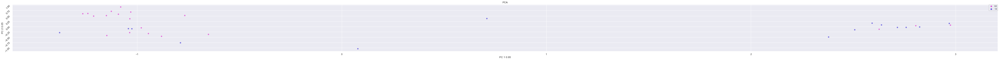

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



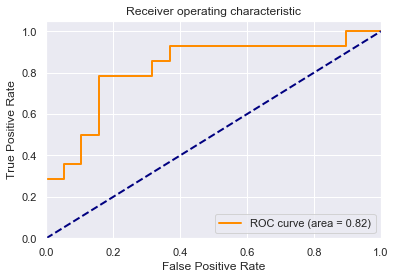

[[16  3]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.70      0.84      0.76        19
           1       0.70      0.50      0.58        14

    accuracy                           0.70        33
   macro avg       0.70      0.67      0.67        33
weighted avg       0.70      0.70      0.69        33

Training set score for Logistic Regression: 0.684615
Testing  set score for Logistic Regression: 0.696970
Best score for training data: 0.6846153846153846 

Best C: 1.0 

Best Gamma: 0.1 



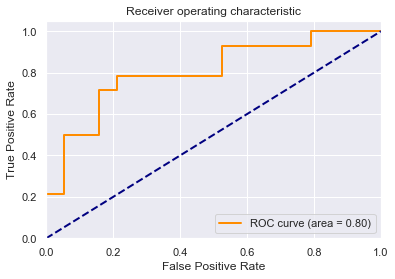

[[18  1]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.72      0.95      0.82        19
           1       0.88      0.50      0.64        14

    accuracy                           0.76        33
   macro avg       0.80      0.72      0.73        33
weighted avg       0.79      0.76      0.74        33

Training set score for SVM: 0.692308
Testing  set score for SVM: 0.757576
Best score for training data: 0.7 

Best #estimators: 100 

Best max depth: 12 



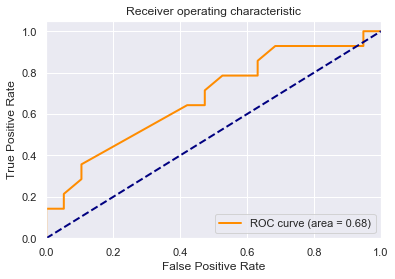

[[18  1]
 [12  2]]


              precision    recall  f1-score   support

           0       0.60      0.95      0.73        19
           1       0.67      0.14      0.24        14

    accuracy                           0.61        33
   macro avg       0.63      0.55      0.48        33
weighted avg       0.63      0.61      0.52        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.606061


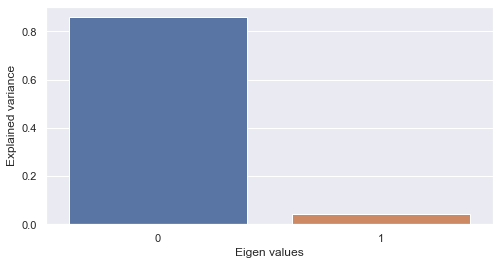

PCA on single-modal explained variance ratio: 0.9004231691360474


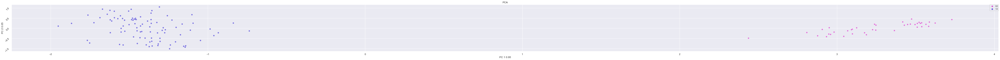

2 clusters -  silhoutte score: 0.7486832737922668 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.41853389143943787 - mutual information: 0.06580381661856816
4 clusters -  silhoutte score: 0.29894912242889404 - mutual information: 0.061297581625148256


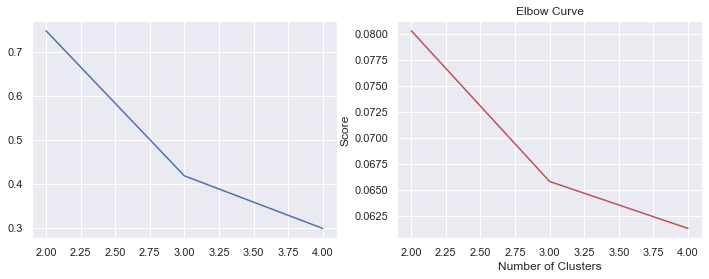

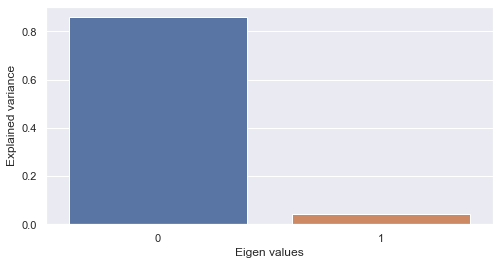

PCA on single-modal explained variance ratio: 0.9004231691360474


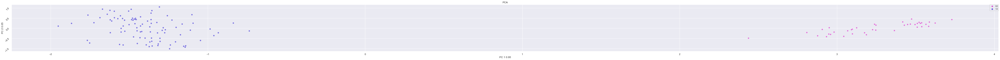

2 clusters -  silhoutte score: 0.7486832737922668 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.6201757788658142 - mutual information: 0.07229817317387624
4 clusters -  silhoutte score: 0.29894912242889404 - mutual information: 0.061297581625148256


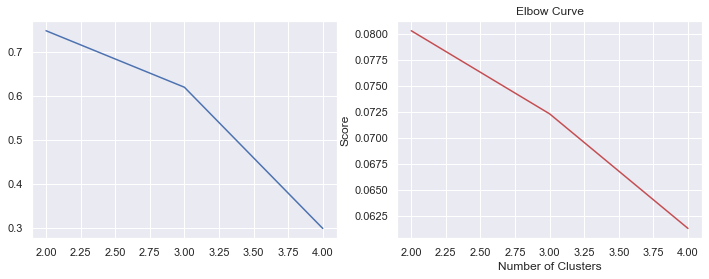

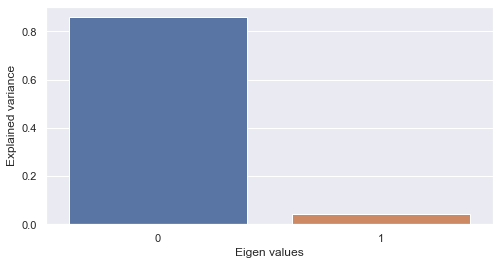

PCA on single-modal explained variance ratio: 0.9004231691360474


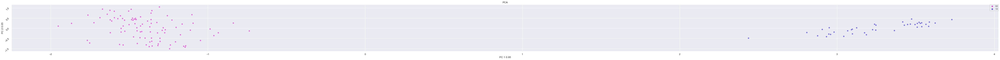

2 clusters -  silhoutte score: 0.7486832737922668 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.399759978055954 - mutual information: 0.06148451393702679
4 clusters -  silhoutte score: 0.2763670086860657 - mutual information: 0.06775785211183338


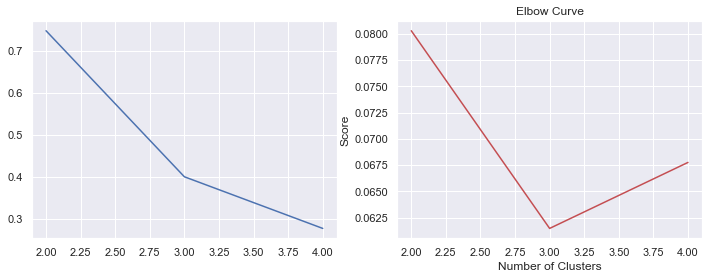

Compression: 86.93

Epoch 00028: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00034: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00043: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00048: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00052: early stopping


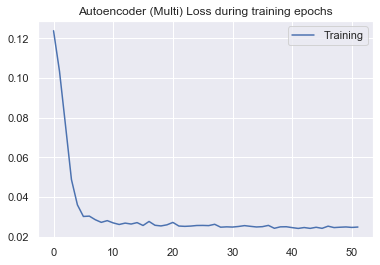

0.0248910105572297


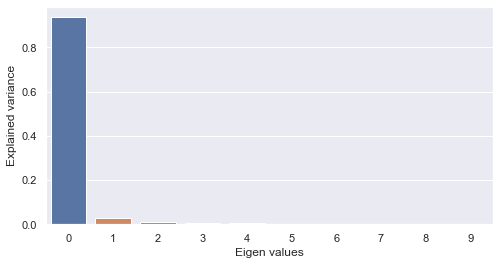

PCA on single-modal explained variance ratio: 0.9960902333259583


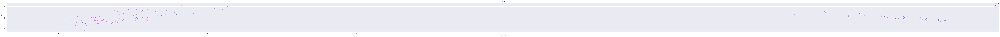

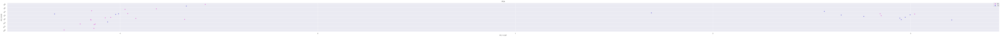

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



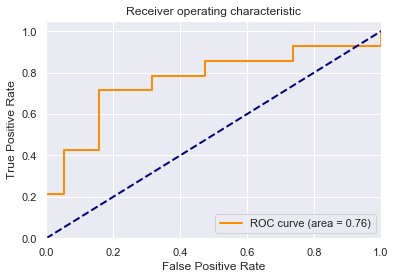

[[16  3]
 [ 5  9]]


              precision    recall  f1-score   support

           0       0.76      0.84      0.80        19
           1       0.75      0.64      0.69        14

    accuracy                           0.76        33
   macro avg       0.76      0.74      0.75        33
weighted avg       0.76      0.76      0.75        33

Training set score for Logistic Regression: 0.684615
Testing  set score for Logistic Regression: 0.757576
Best score for training data: 0.6923076923076923 

Best C: 0.1 

Best Gamma: scale 



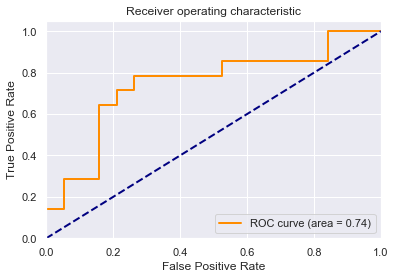

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for SVM: 0.684615
Testing  set score for SVM: 0.727273
Best score for training data: 0.7153846153846153 

Best #estimators: 140 

Best max depth: None 



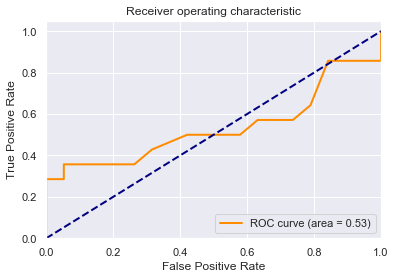

[[19  0]
 [11  3]]


              precision    recall  f1-score   support

           0       0.63      1.00      0.78        19
           1       1.00      0.21      0.35        14

    accuracy                           0.67        33
   macro avg       0.82      0.61      0.56        33
weighted avg       0.79      0.67      0.60        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.666667


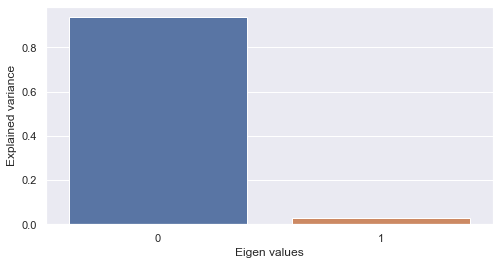

PCA on single-modal explained variance ratio: 0.9650167226791382


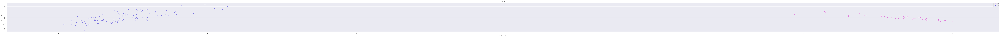

2 clusters -  silhoutte score: 0.8339083194732666 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.4865621030330658 - mutual information: 0.06555245117295233
4 clusters -  silhoutte score: 0.33233925700187683 - mutual information: 0.059882457547357014


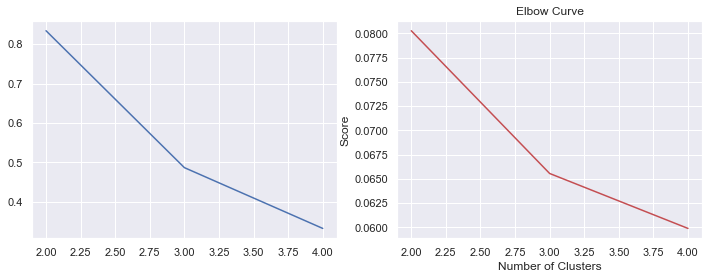

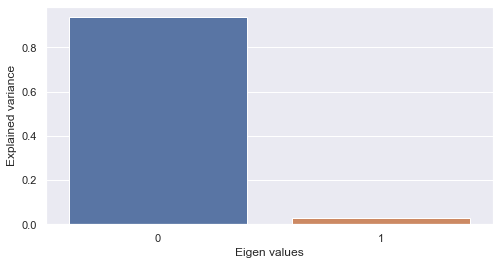

PCA on single-modal explained variance ratio: 0.9650167226791382


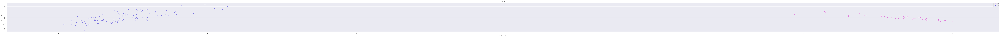

2 clusters -  silhoutte score: 0.8339083194732666 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.4892650544643402 - mutual information: 0.06391089692777463
4 clusters -  silhoutte score: 0.3554260730743408 - mutual information: 0.062214629779706584


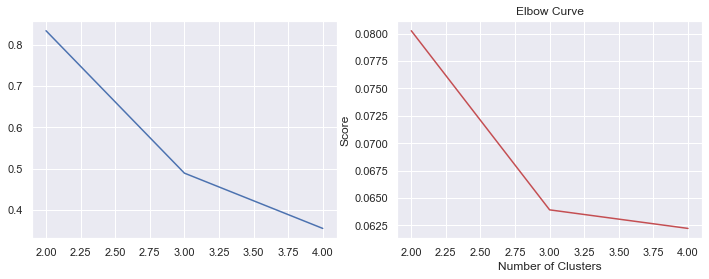

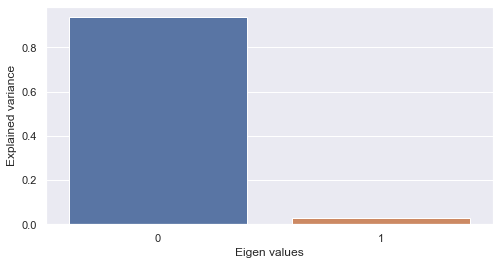

PCA on single-modal explained variance ratio: 0.9650167226791382


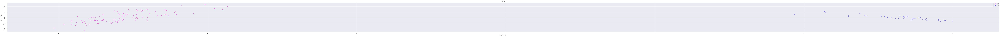

2 clusters -  silhoutte score: 0.8339083194732666 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.46922042965888977 - mutual information: 0.07055452343257894
4 clusters -  silhoutte score: 0.2992370128631592 - mutual information: 0.07729134336731588


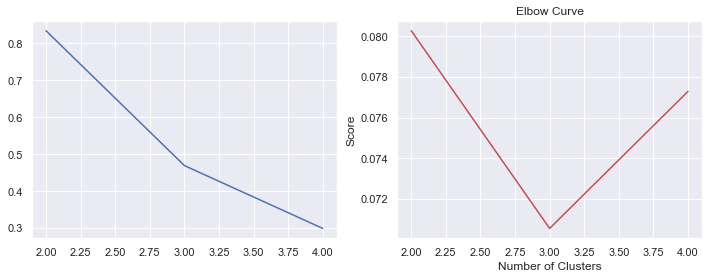

Compression: 86.93

Epoch 00031: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00041: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00046: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.
Epoch 00046: early stopping


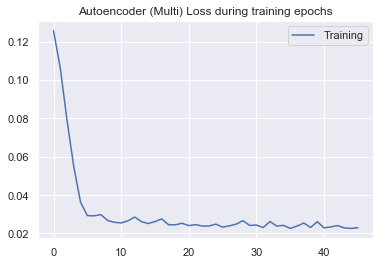

0.023016584492646732


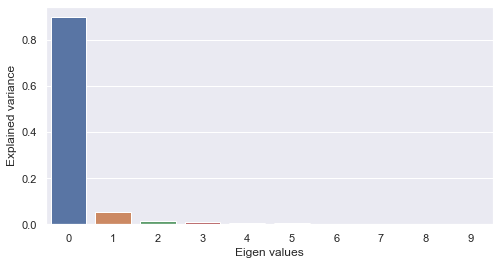

PCA on single-modal explained variance ratio: 0.9923378229141235


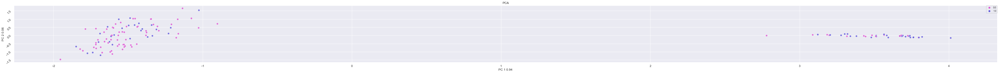

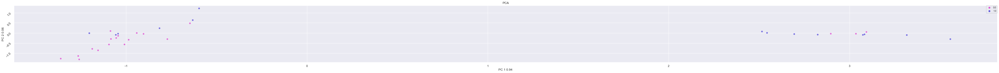

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



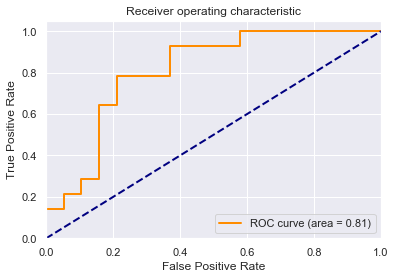

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for Logistic Regression: 0.684615
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6846153846153846 

Best C: 0.1 

Best Gamma: scale 



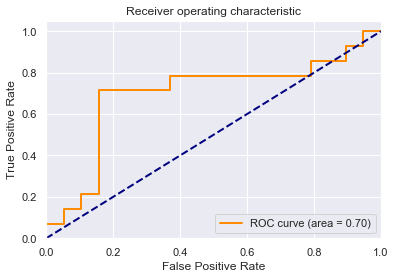

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for SVM: 0.684615
Testing  set score for SVM: 0.727273
Best score for training data: 0.676923076923077 

Best #estimators: 140 

Best max depth: None 



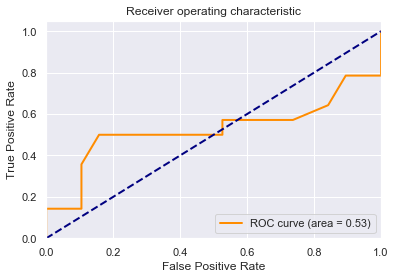

[[19  0]
 [13  1]]


              precision    recall  f1-score   support

           0       0.59      1.00      0.75        19
           1       1.00      0.07      0.13        14

    accuracy                           0.61        33
   macro avg       0.80      0.54      0.44        33
weighted avg       0.77      0.61      0.49        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.606061


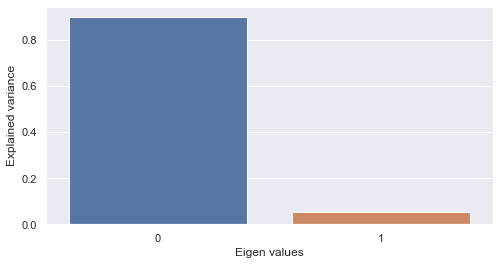

PCA on single-modal explained variance ratio: 0.9515351057052612


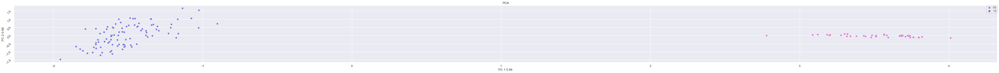

2 clusters -  silhoutte score: 0.7936474084854126 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5031630992889404 - mutual information: 0.06735040672337443
4 clusters -  silhoutte score: 0.4246411919593811 - mutual information: 0.05705397015745698


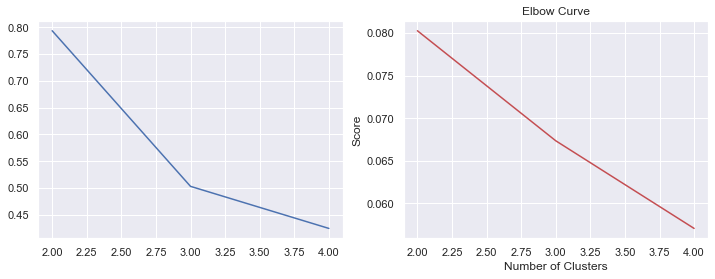

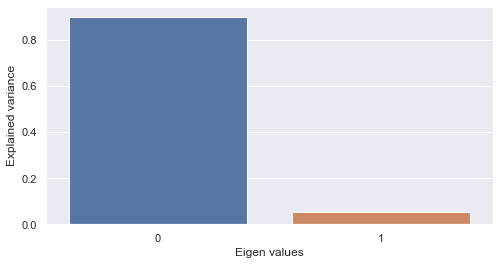

PCA on single-modal explained variance ratio: 0.9515351057052612


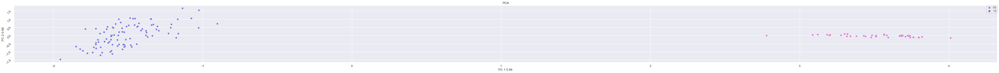

2 clusters -  silhoutte score: 0.7936474084854126 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5031630992889404 - mutual information: 0.06735040672337443
4 clusters -  silhoutte score: 0.3515801727771759 - mutual information: 0.06059648626150073


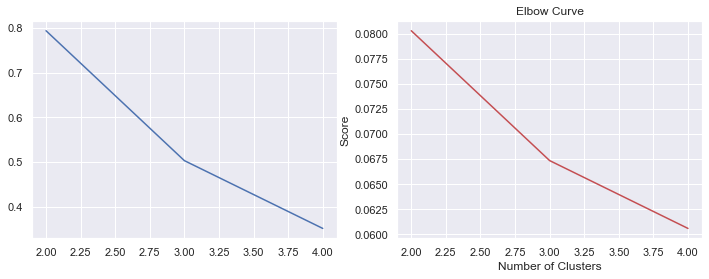

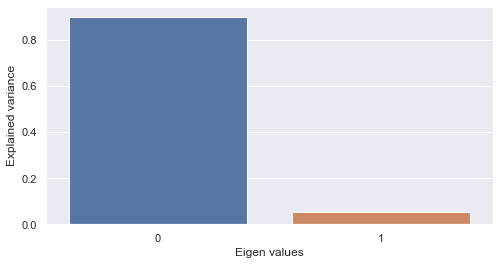

PCA on single-modal explained variance ratio: 0.9515351057052612


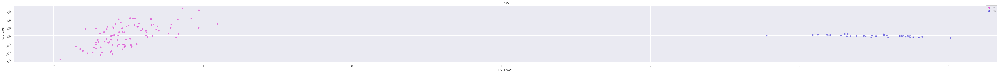

2 clusters -  silhoutte score: 0.7936474084854126 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5002990961074829 - mutual information: 0.07048454917901441
4 clusters -  silhoutte score: 0.4445914626121521 - mutual information: 0.06191547601997866


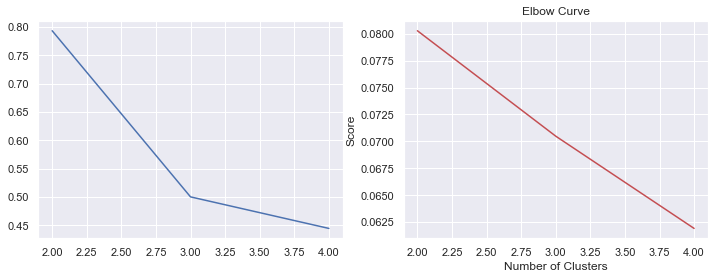

Compression: 86.93

Epoch 00035: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00044: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00052: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00057: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00057: early stopping


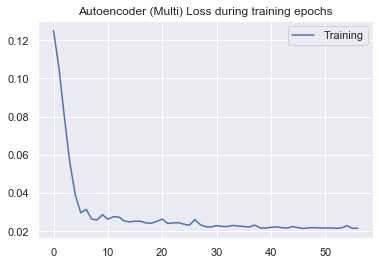

0.021575494712361924


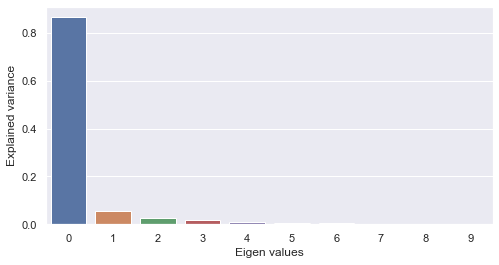

PCA on single-modal explained variance ratio: 0.9888966083526611


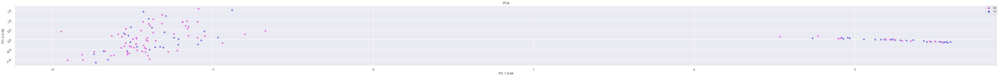

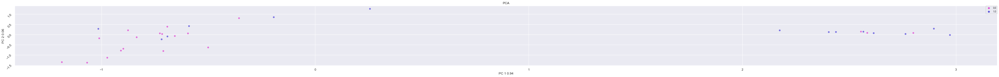

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



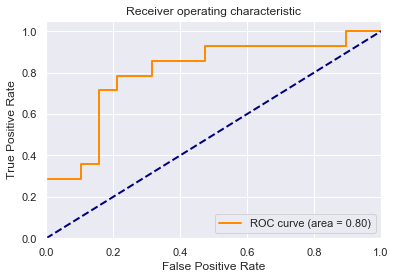

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for Logistic Regression: 0.684615
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6846153846153846 

Best C: 1.0 

Best Gamma: 0.1 



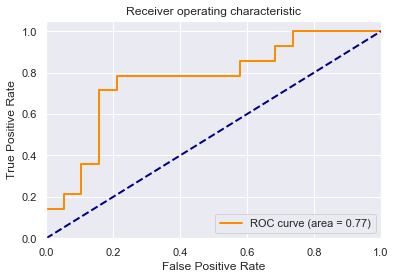

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for SVM: 0.684615
Testing  set score for SVM: 0.727273
Best score for training data: 0.7 

Best #estimators: 140 

Best max depth: None 



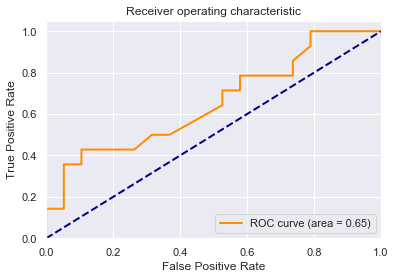

[[18  1]
 [10  4]]


              precision    recall  f1-score   support

           0       0.64      0.95      0.77        19
           1       0.80      0.29      0.42        14

    accuracy                           0.67        33
   macro avg       0.72      0.62      0.59        33
weighted avg       0.71      0.67      0.62        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.666667


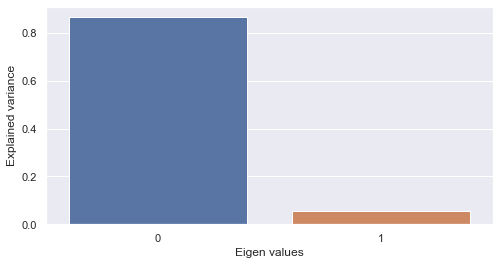

PCA on single-modal explained variance ratio: 0.9209960699081421


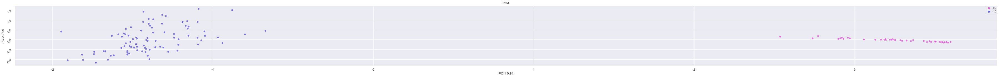

2 clusters -  silhoutte score: 0.756432056427002 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.44644492864608765 - mutual information: 0.05837367613152032
4 clusters -  silhoutte score: 0.33372780680656433 - mutual information: 0.058050364289779464


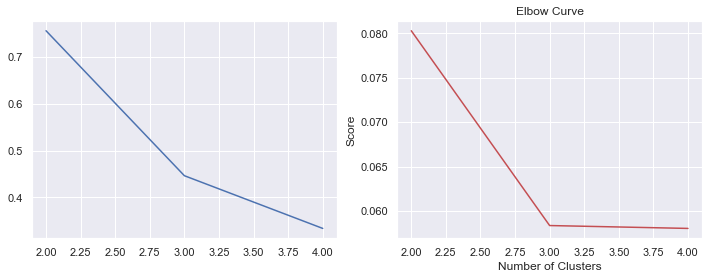

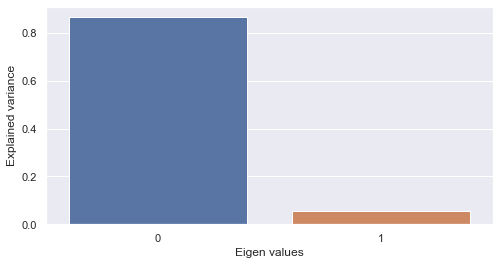

PCA on single-modal explained variance ratio: 0.9209960699081421


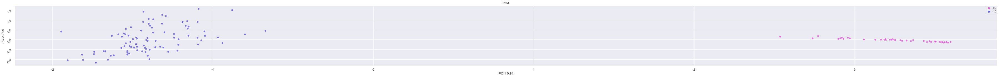

2 clusters -  silhoutte score: 0.756432056427002 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.6351514458656311 - mutual information: 0.07679603906401791
4 clusters -  silhoutte score: 0.33716535568237305 - mutual information: 0.059197738605970024


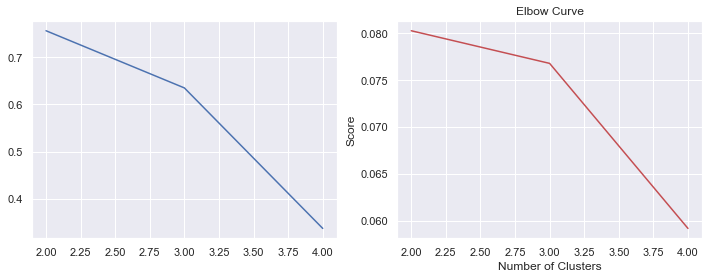

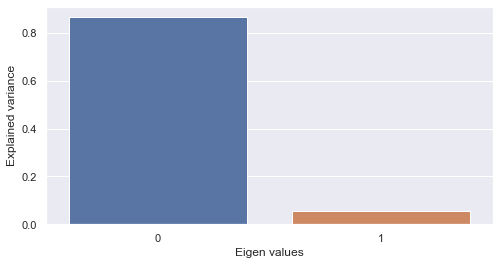

PCA on single-modal explained variance ratio: 0.9209960699081421


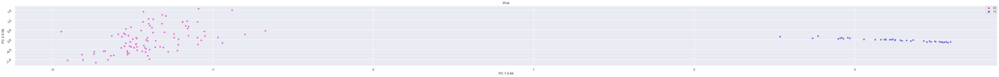

2 clusters -  silhoutte score: 0.756432056427002 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.43350765109062195 - mutual information: 0.059133413921273754
4 clusters -  silhoutte score: 0.3039052188396454 - mutual information: 0.07214203179546114


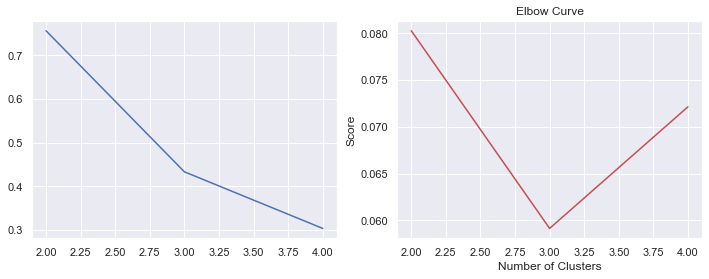

Compression: 86.93

Epoch 00035: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00047: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00057: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00062: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00062: early stopping


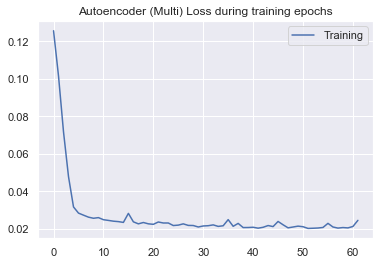

0.024568665027618408


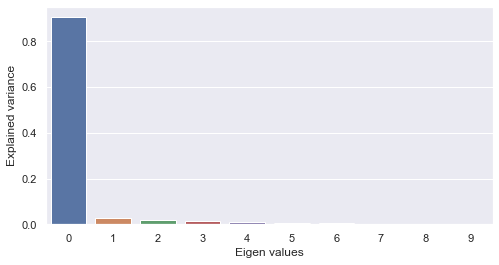

PCA on single-modal explained variance ratio: 0.9891339540481567


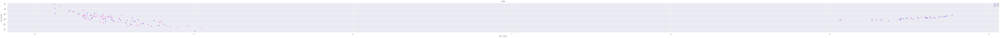

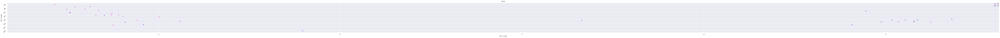

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



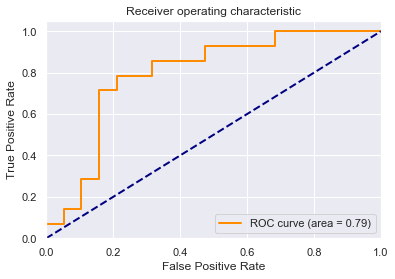

[[16  3]
 [ 5  9]]


              precision    recall  f1-score   support

           0       0.76      0.84      0.80        19
           1       0.75      0.64      0.69        14

    accuracy                           0.76        33
   macro avg       0.76      0.74      0.75        33
weighted avg       0.76      0.76      0.75        33

Training set score for Logistic Regression: 0.684615
Testing  set score for Logistic Regression: 0.757576
Best score for training data: 0.6846153846153846 

Best C: 1.0 

Best Gamma: 0.1 



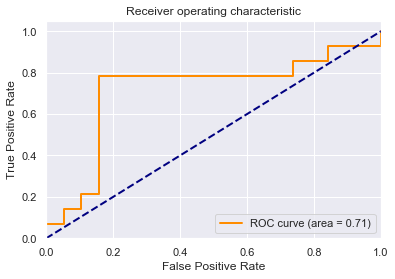

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for SVM: 0.684615
Testing  set score for SVM: 0.727273
Best score for training data: 0.6846153846153846 

Best #estimators: 100 

Best max depth: 12 



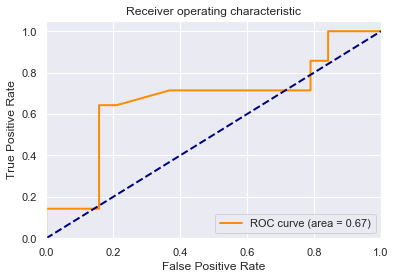

[[16  3]
 [11  3]]


              precision    recall  f1-score   support

           0       0.59      0.84      0.70        19
           1       0.50      0.21      0.30        14

    accuracy                           0.58        33
   macro avg       0.55      0.53      0.50        33
weighted avg       0.55      0.58      0.53        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.575758


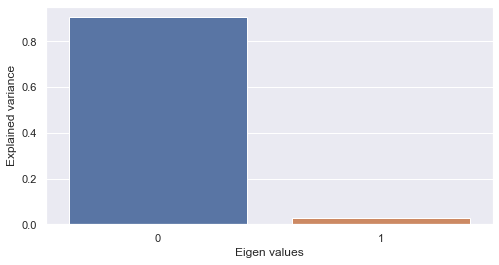

PCA on single-modal explained variance ratio: 0.9332260489463806


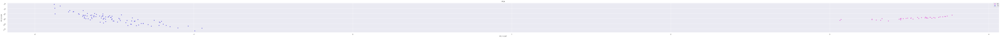

2 clusters -  silhoutte score: 0.7978640794754028 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.4014251232147217 - mutual information: 0.06400109001672674
4 clusters -  silhoutte score: 0.4019019603729248 - mutual information: 0.05753459018059688


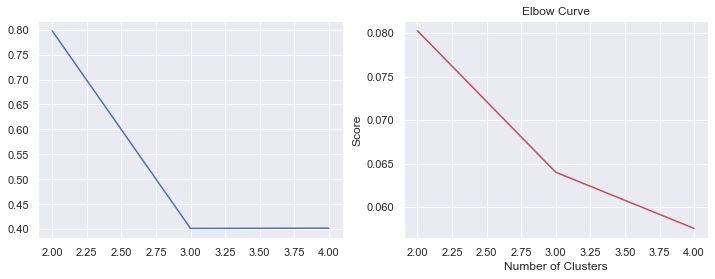

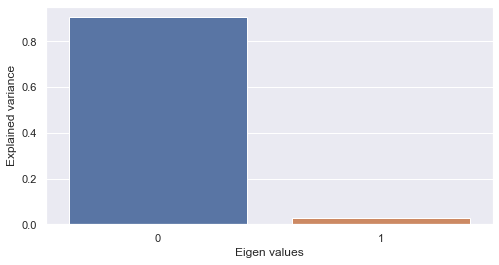

PCA on single-modal explained variance ratio: 0.9332260489463806


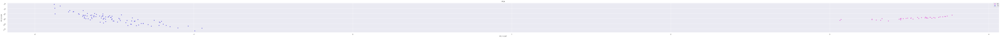

2 clusters -  silhoutte score: 0.7978640794754028 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.6391409039497375 - mutual information: 0.06916522876776254
4 clusters -  silhoutte score: 0.2532094120979309 - mutual information: 0.05507434085082036


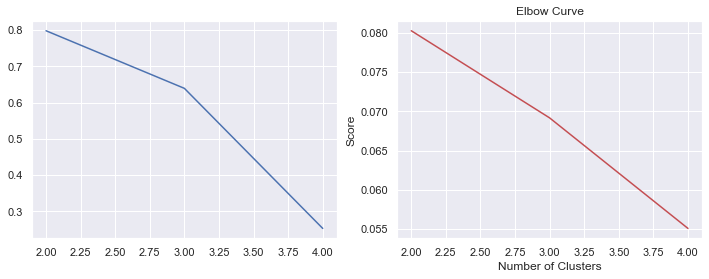

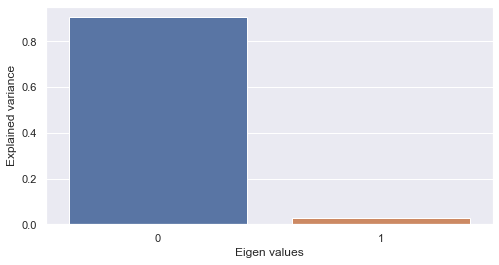

PCA on single-modal explained variance ratio: 0.9332260489463806


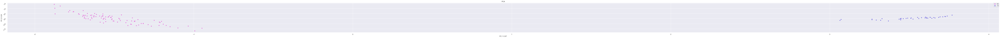

2 clusters -  silhoutte score: 0.7978640794754028 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.3853214979171753 - mutual information: 0.06281185760049893
4 clusters -  silhoutte score: 0.38914960622787476 - mutual information: 0.056227884661360465


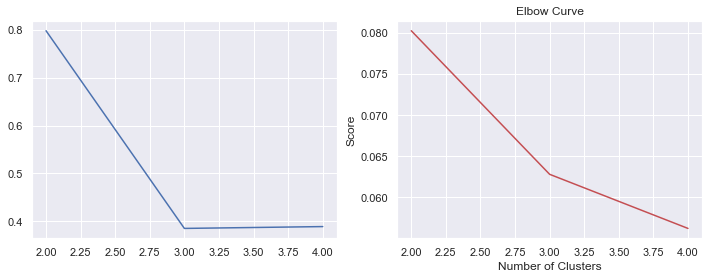

In [13]:
###  Hyperparameter tuning

encoding_dims=[100]
mus=[0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9,1]
dropouts = [0.25]
l1s = [0.0000001]
l2s = [0.0000005]
scores = []
for encoding_dim in encoding_dims:
    for mu in mus:
        for dropout in dropouts:
            for l1 in l1s:
                for l2 in l2s:
                    ## Build and Train Autoencoder
                    autoencoder, encoder, decoder, loss = Models.build_and_train_multi_autoencoder([X_train_first_norm,X_train_second_norm],
                                                                                  [X_train_first_norm,X_train_second_norm],
                                                                                  encoding_dim=encoding_dim, 
                                                                                  regularizer=tf.keras.regularizers.l1_l2(l1,l2),
                                                                                  dropout=dropout,
                                                                                  epochs=200,
                                                                                  mu=mu)
                    ## Encode datasets
                    X_latent_multi_ae = Models.encode_dataset([X_train_first_norm,X_train_second_norm], encoder)
                    X_latent_test_multi_ae = Models.encode_dataset([X_test_first_norm,X_test_second_norm], encoder)

                    ## PCA ON AUTOENCODER LATENT SPACE
                    X_latent_pca_ae, X_latent_test_pca_ae = Models.perform_PCA(X_latent_multi_ae,y_train, X_latent_test_multi_ae, y_test, n_components=10)

                    ### CLASSIFICATION ###
                    classify = Models.classify(X_latent_multi_ae, X_latent_test_multi_ae, np.ravel(y_train), np.ravel(y_test), model_type="AE")

                    ### CLUSTERING ###
                    clustering = Models.cluster(X_latent_multi_ae,np.ravel(y_train), model_type="Multi-AE")

                    scores.append([mu,dropout,l1,l2,loss] + classify + clustering)


In [14]:
scores = pd.DataFrame(scores,
                      columns=["mu","dropout","l1","l2","loss","LR accuracy","SVM accuracy", "RF accuracy", "LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC","KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette","KMeans MI","Spectral MI","Hierarchical MI"])    
display(scores)
print(f"Random classifier: {y_test.iloc[:,0].value_counts()[0]/len(y_test)}")

,mu,dropout,l1,l2,loss,LR accuracy,SVM accuracy,RF accuracy,LR ROC-AUC,SVM ROC-AUC,RF ROC-AUC,KMeans Silhouette,Spectral Silhouette,Hierarchical Silhouette,KMeans MI,Spectral MI,Hierarchical MI
0,0.0,0.25,1.000000e-07,5.000000e-07,0.021921,0.727273,0.727273,0.636364,0.804511,0.834586,0.742481,0.267881,0.286989,0.267881,0.046245,0.088076,0.045570
1,0.1,0.25,1.000000e-07,5.000000e-07,0.023097,0.757576,0.727273,0.696970,0.774436,0.883459,0.781955,0.569708,0.569708,0.569708,0.085643,0.056838,0.102002
2,0.2,0.25,1.000000e-07,5.000000e-07,0.023186,0.787879,0.727273,0.666667,0.789474,0.800752,0.780075,0.607465,0.607465,0.607465,0.051371,0.096610,0.051955
3,0.3,0.25,1.000000e-07,5.000000e-07,0.022584,0.696970,0.727273,0.727273,0.759398,0.706767,0.787594,0.562863,0.562863,0.562863,0.084103,0.092014,0.054493
4,0.4,0.25,1.000000e-07,5.000000e-07,0.025258,0.696970,0.575758,0.636364,0.714286,0.751880,0.398496,0.733294,0.733294,0.733294,0.087316,0.087316,0.092460
5,0.5,0.25,1.000000e-07,5.000000e-07,0.025885,0.696970,0.727273,0.636364,0.804511,0.714286,0.669173,0.804610,0.804610,0.804610,0.055893,0.056316,0.055589
6,0.6,0.25,1.000000e-07,5.000000e-07,0.023894,0.696970,0.757576,0.606061,0.823308,0.804511,0.678571,0.748683,0.748683,0.748683,0.061298,0.061298,0.067758
7,0.7,0.25,1.000000e-07,5.000000e-07,0.024891,0.757576,0.727273,0.666667,0.763158,0.744361,0.533835,0.833908,0.833908,0.833908,0.059882,0.062215,0.077291
8,0.8,0.25,1.000000e-07,5.000000e-07,0.023017,0.727273,0.727273,0.606061,0.808271,0.695489,0.526316,0.793647,0.793647,0.793647,0.057054,0.060596,0.061915
9,0.9,0.25,1.000000e-07,5.000000e-07,0.021575,0.727273,0.727273,0.666667,0.800752,0.766917,0.654135,0.756432,0.756432,0.756432,0.058050,0.059198,0.072142


Random classifier: 0.5757575757575758


C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:376: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(new_indexer, value)
C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the docume

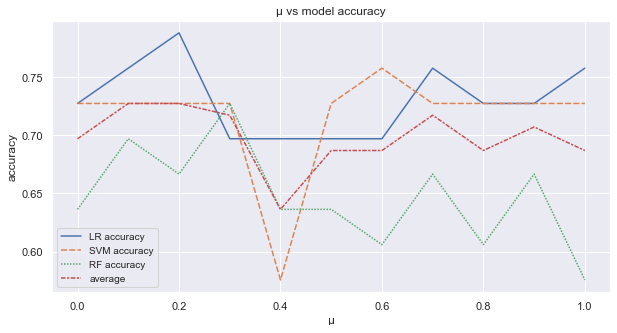

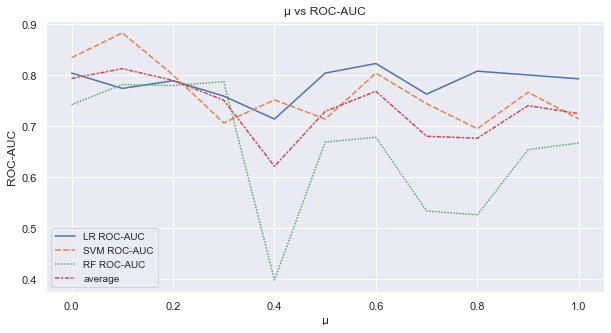

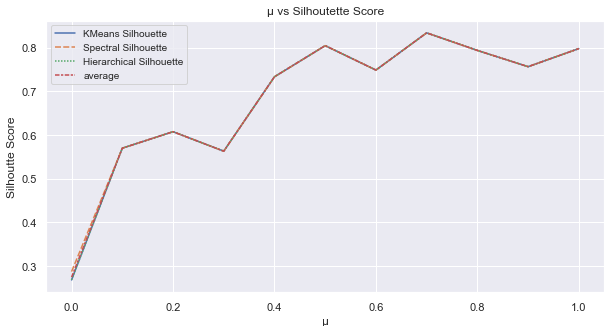

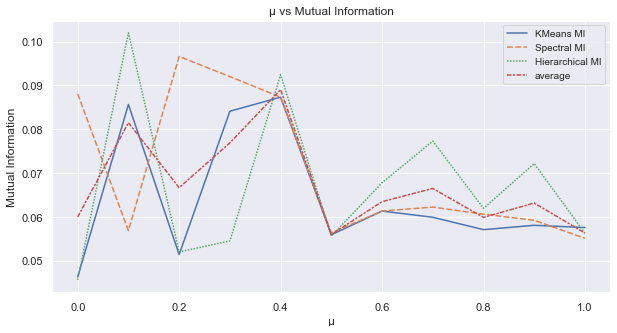

In [15]:
scores.index = mus

data_acc = scores[["LR accuracy","SVM accuracy","RF accuracy"]]
data_acc.loc[:,"average"] = data_acc.mean(axis=1)

data_auc = scores[["LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC"]]
data_auc.loc[:,"average"] = data_auc.mean(axis=1)

data_ss = scores[["KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette"]]
data_ss.loc[:,"average"] = data_ss.mean(axis=1)

data_mi = scores[["KMeans MI","Spectral MI","Hierarchical MI"]]
data_mi.loc[:,"average"] = data_mi.mean(axis=1)

sns.set()
hyperparam = "μ"

ax = sns.lineplot(data=data_acc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"accuracy")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs model accuracy")
plt.show()

ax = sns.lineplot(data=data_auc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"ROC-AUC")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs ROC-AUC")
plt.show()

ax = sns.lineplot(data=data_ss)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Silhoutte Score")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Silhoutette Score")
plt.show()

ax = sns.lineplot(data=data_mi)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Mutual Information")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Mutual Information")
plt.show()

Compression: 86.93

Epoch 00075: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00089: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00094: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.
Epoch 00094: early stopping


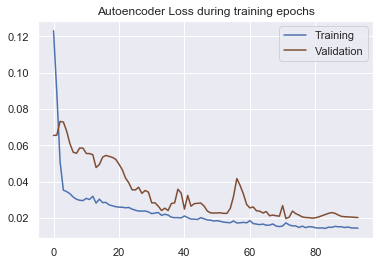

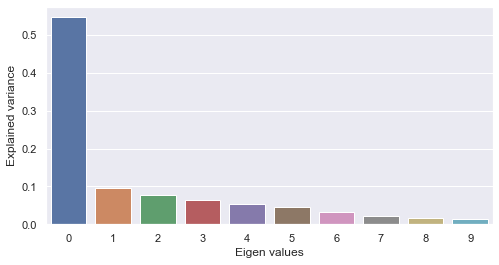

PCA on single-modal explained variance ratio: 0.9688135981559753


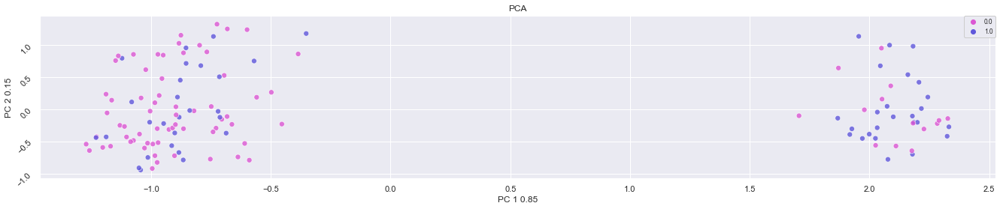

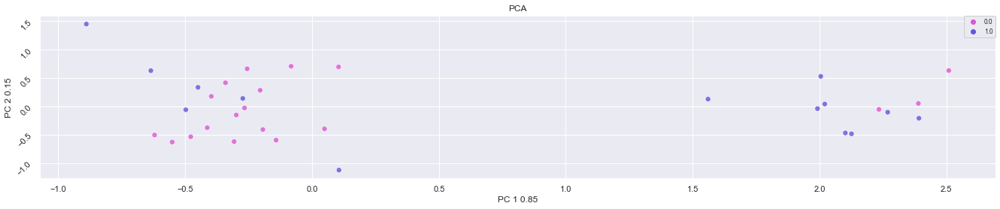

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



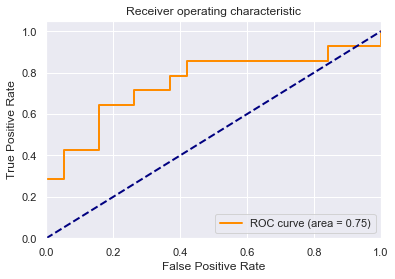

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for Logistic Regression: 0.700000
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6846153846153846 

Best C: 1.0 

Best Gamma: 0.1 



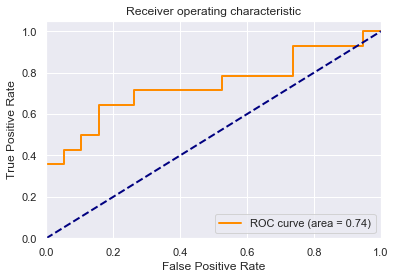

[[16  3]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.70      0.84      0.76        19
           1       0.70      0.50      0.58        14

    accuracy                           0.70        33
   macro avg       0.70      0.67      0.67        33
weighted avg       0.70      0.70      0.69        33

Training set score for SVM: 0.723077
Testing  set score for SVM: 0.696970
Best score for training data: 0.7 

Best #estimators: 100 

Best max depth: 12 



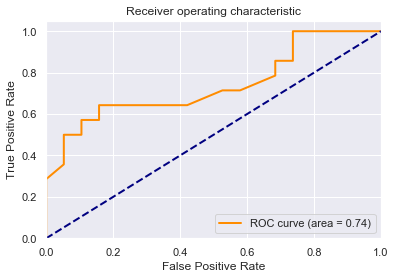

[[18  1]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.72      0.95      0.82        19
           1       0.88      0.50      0.64        14

    accuracy                           0.76        33
   macro avg       0.80      0.72      0.73        33
weighted avg       0.79      0.76      0.74        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.757576


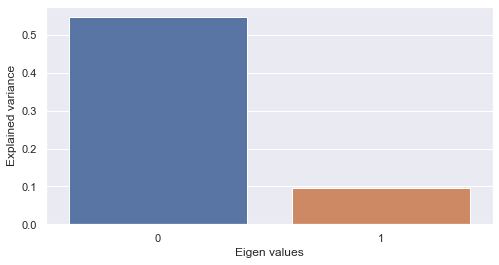

PCA on single-modal explained variance ratio: 0.6435188055038452


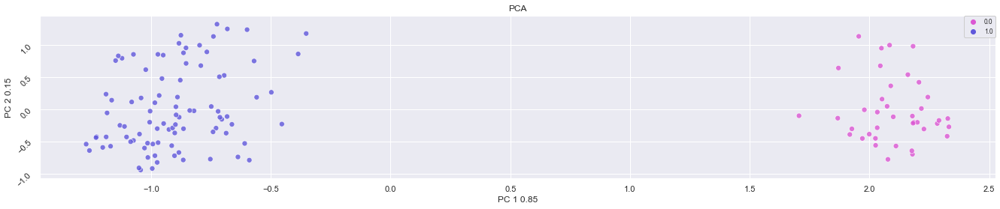

2 clusters -  silhoutte score: 0.5008593201637268 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.2871988117694855 - mutual information: 0.06242617831262613
4 clusters -  silhoutte score: 0.20873454213142395 - mutual information: 0.07660938109296958


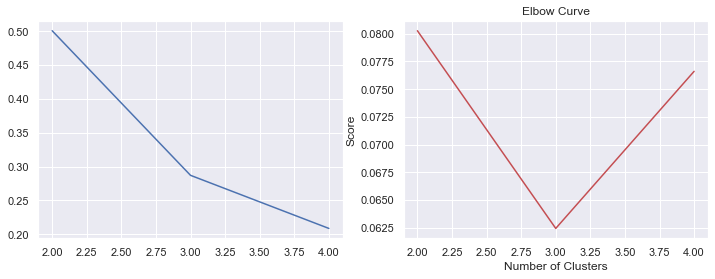

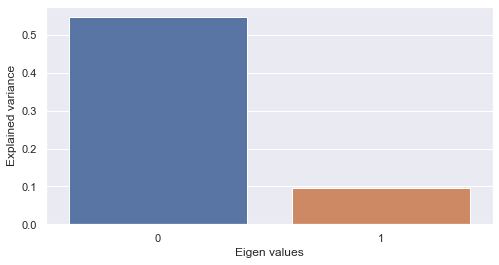

PCA on single-modal explained variance ratio: 0.6435188055038452


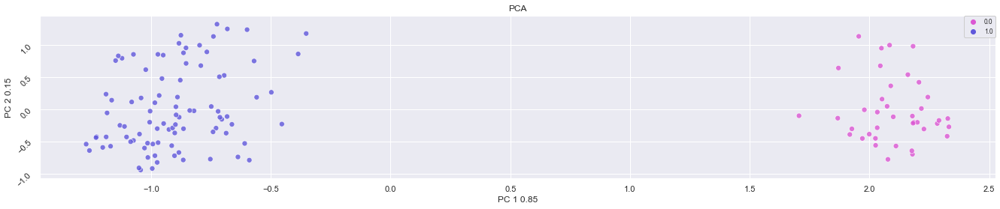

2 clusters -  silhoutte score: 0.5008593201637268 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.41209059953689575 - mutual information: 0.0928458932579023
4 clusters -  silhoutte score: 0.40481194853782654 - mutual information: 0.10024310025700219


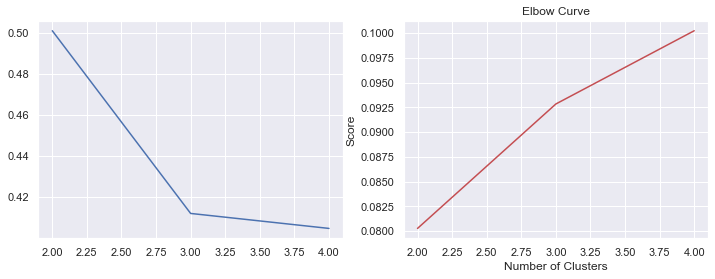

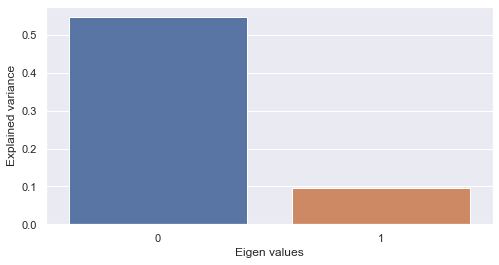

PCA on single-modal explained variance ratio: 0.6435188055038452


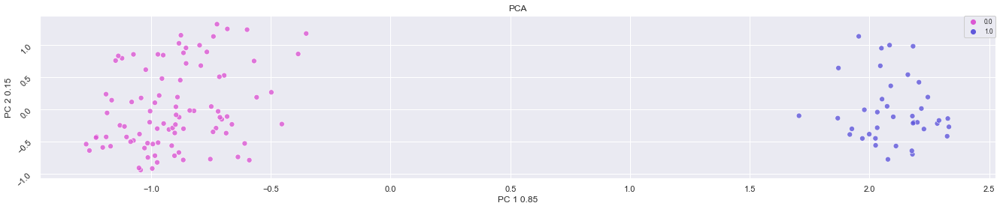

2 clusters -  silhoutte score: 0.5008593201637268 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.2782069742679596 - mutual information: 0.06204892368068429
4 clusters -  silhoutte score: 0.20054513216018677 - mutual information: 0.08923282945005845


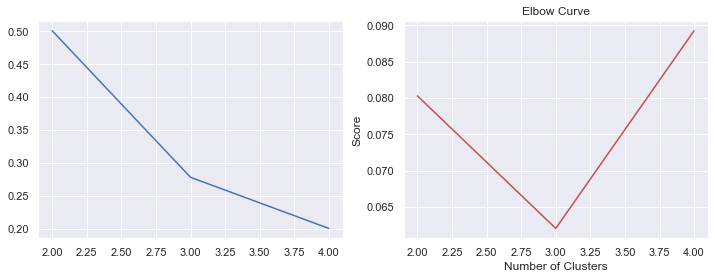

Compression: 86.93

Epoch 00053: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00067: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00075: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00080: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00080: early stopping


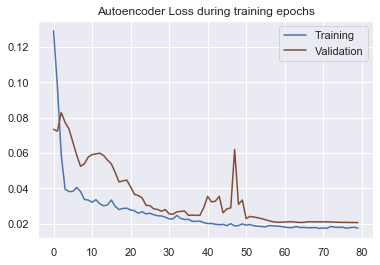

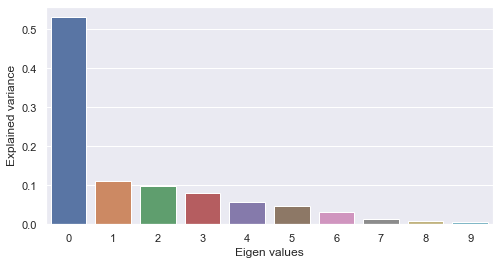

PCA on single-modal explained variance ratio: 0.9821585416793823


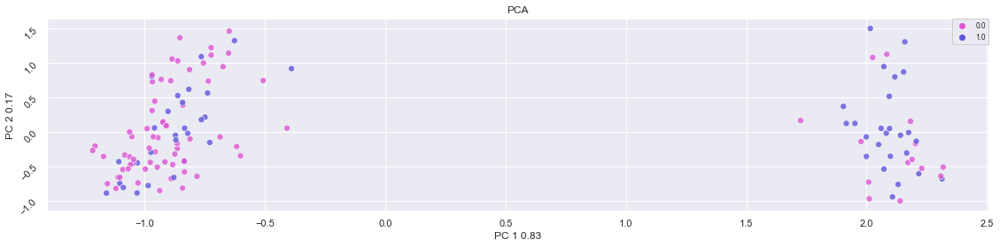

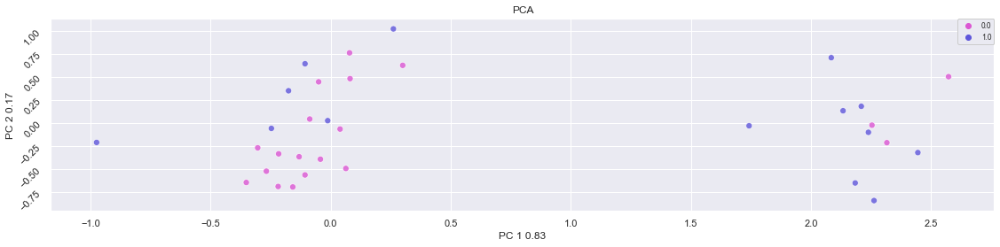

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



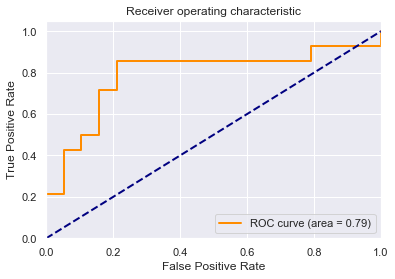

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for Logistic Regression: 0.692308
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6846153846153846 

Best C: 1.0 

Best Gamma: 0.1 



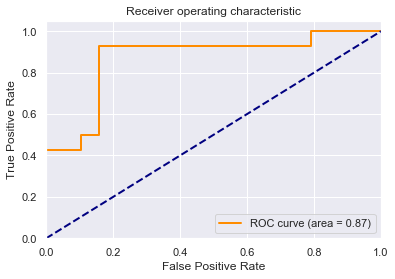

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for SVM: 0.700000
Testing  set score for SVM: 0.727273
Best score for training data: 0.6769230769230768 

Best #estimators: 140 

Best max depth: None 



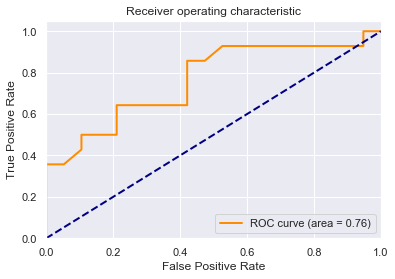

[[15  4]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.68      0.79      0.73        19
           1       0.64      0.50      0.56        14

    accuracy                           0.67        33
   macro avg       0.66      0.64      0.65        33
weighted avg       0.66      0.67      0.66        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.666667


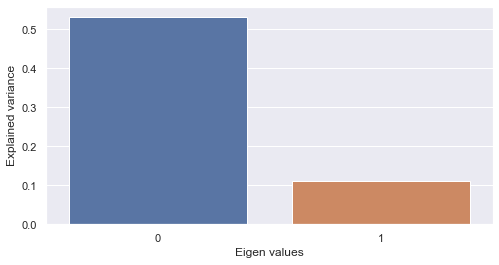

PCA on single-modal explained variance ratio: 0.6420279741287231


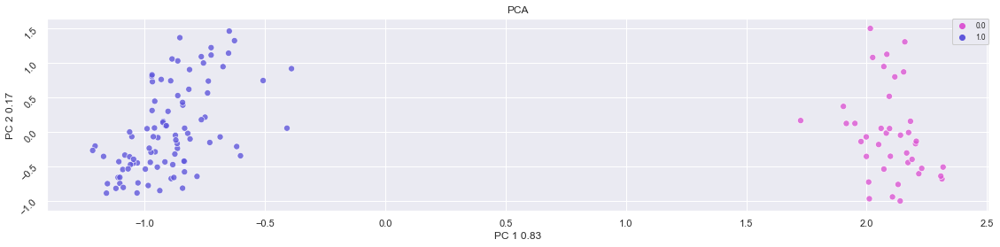

2 clusters -  silhoutte score: 0.4966221749782562 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.2877984046936035 - mutual information: 0.06119372019553096
4 clusters -  silhoutte score: 0.25212764739990234 - mutual information: 0.05126130965136144


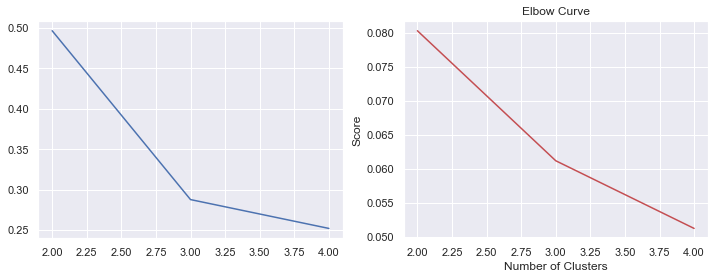

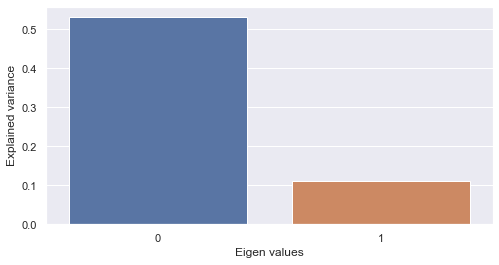

PCA on single-modal explained variance ratio: 0.6420279741287231


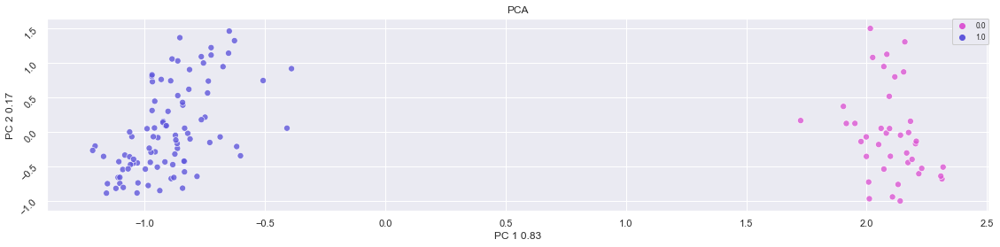

2 clusters -  silhoutte score: 0.4966221749782562 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.41386809945106506 - mutual information: 0.08399946935106288
4 clusters -  silhoutte score: 0.4013389050960541 - mutual information: 0.1106772251800331


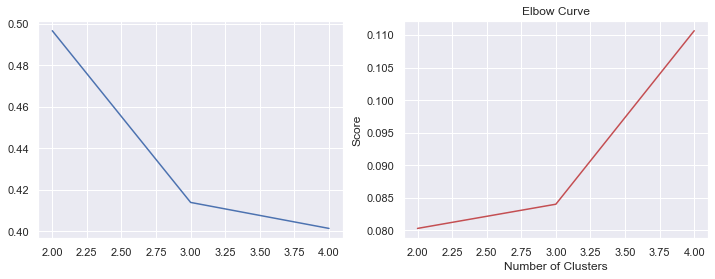

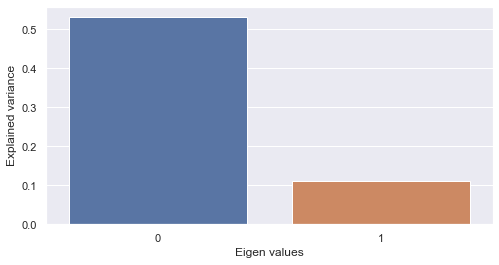

PCA on single-modal explained variance ratio: 0.6420279741287231


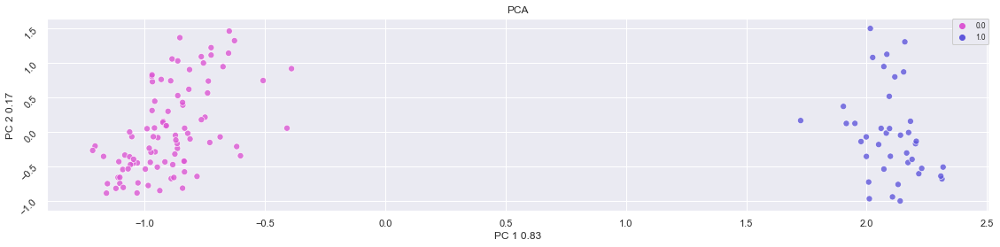

2 clusters -  silhoutte score: 0.4966221749782562 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.27075183391571045 - mutual information: 0.0619694529099769
4 clusters -  silhoutte score: 0.20090936124324799 - mutual information: 0.08407786520912888


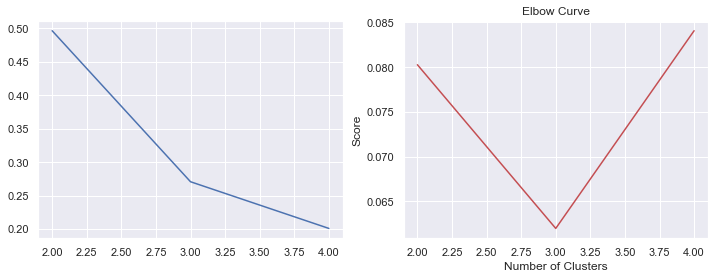

Compression: 86.93

Epoch 00078: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00100: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00110: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00115: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00115: early stopping


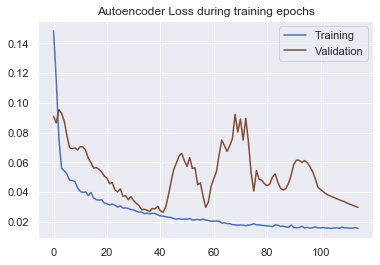

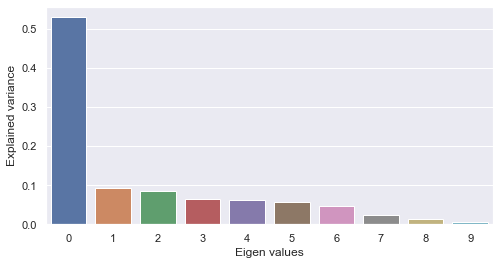

PCA on single-modal explained variance ratio: 0.9802735447883606


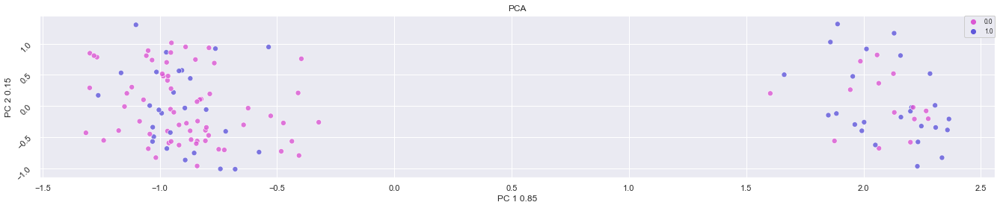

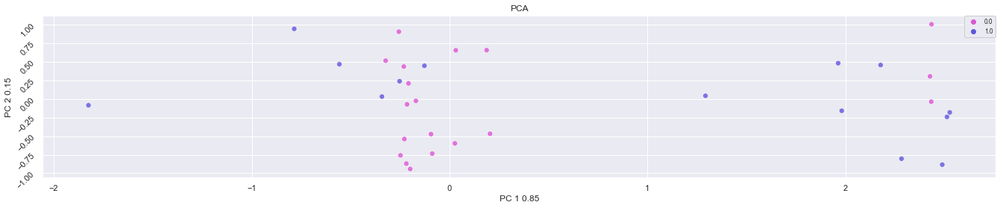

Results for AE: 

Best score for training data: 0.7076923076923077 

Best C: 0.08 



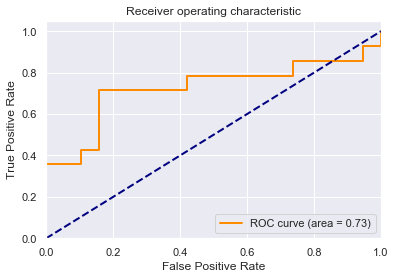

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for Logistic Regression: 0.707692
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6846153846153846 

Best C: 1.0 

Best Gamma: 0.1 



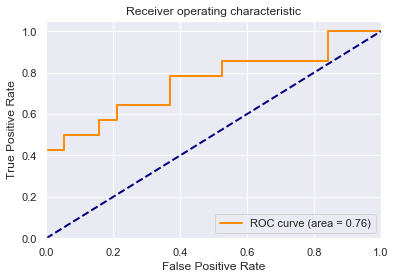

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for SVM: 0.730769
Testing  set score for SVM: 0.727273
Best score for training data: 0.6692307692307693 

Best #estimators: 140 

Best max depth: None 



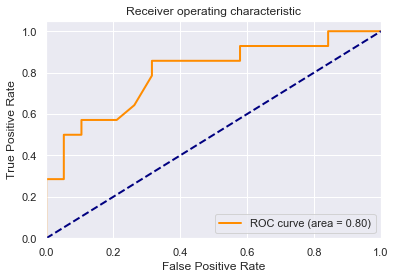

[[17  2]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.74      0.89      0.81        19
           1       0.80      0.57      0.67        14

    accuracy                           0.76        33
   macro avg       0.77      0.73      0.74        33
weighted avg       0.76      0.76      0.75        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.757576


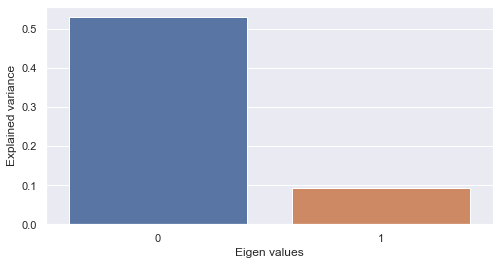

PCA on single-modal explained variance ratio: 0.6221318244934082


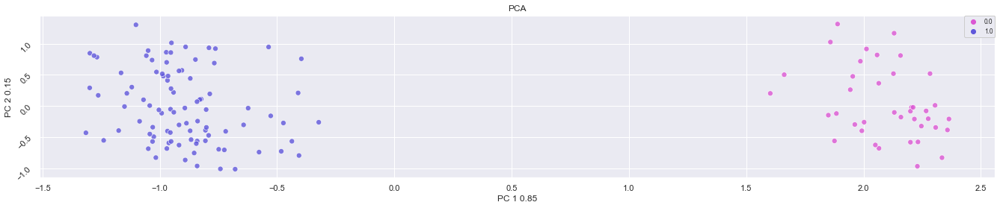

2 clusters -  silhoutte score: 0.48671430349349976 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.2404136061668396 - mutual information: 0.05866813143006241
4 clusters -  silhoutte score: 0.2202140837907791 - mutual information: 0.06038356982234369


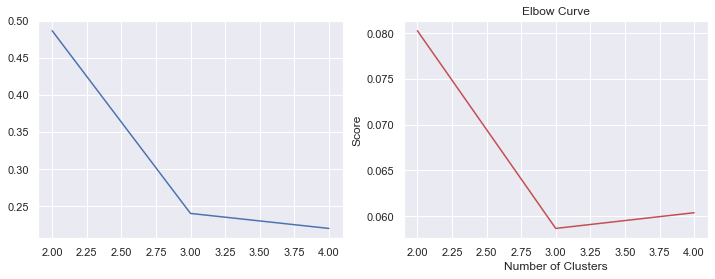

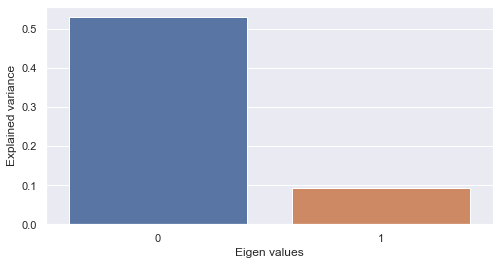

PCA on single-modal explained variance ratio: 0.6221318244934082


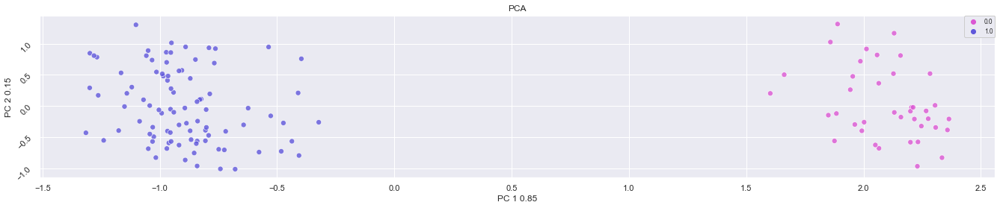

2 clusters -  silhoutte score: 0.48671430349349976 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.40505024790763855 - mutual information: 0.07467153217152572
4 clusters -  silhoutte score: 0.3884018659591675 - mutual information: 0.08728698312697909


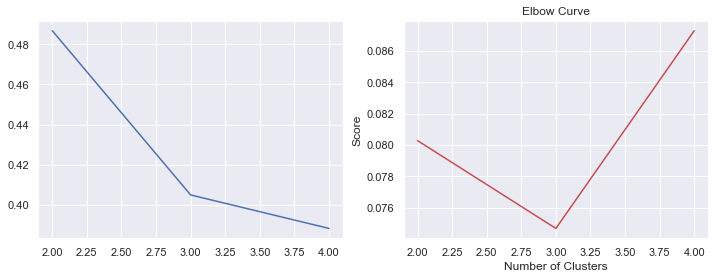

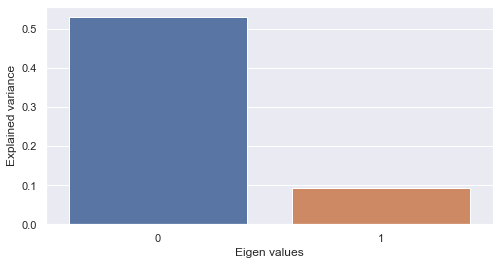

PCA on single-modal explained variance ratio: 0.6221318244934082


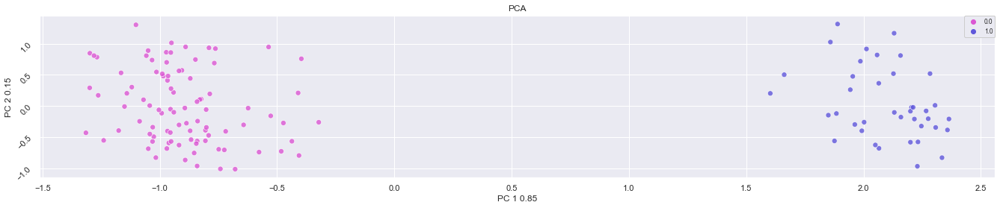

2 clusters -  silhoutte score: 0.48671430349349976 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.23027808964252472 - mutual information: 0.05837367613152032
4 clusters -  silhoutte score: 0.23158618807792664 - mutual information: 0.0544730221385718


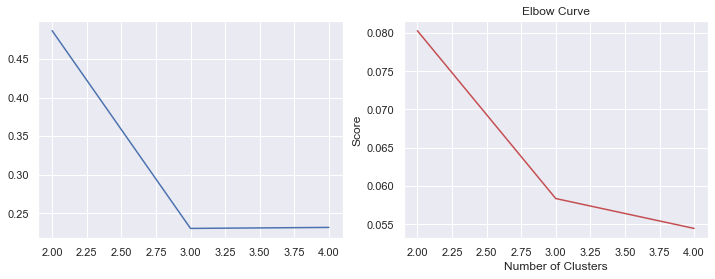

Compression: 86.93

Epoch 00054: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00059: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00059: early stopping


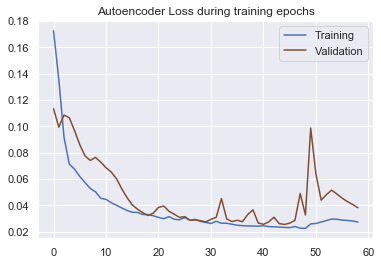

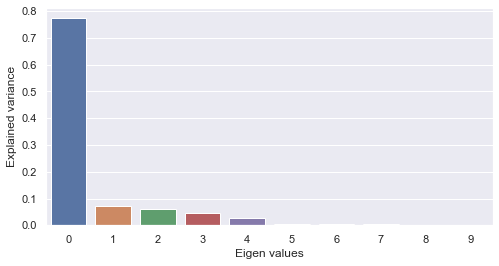

PCA on single-modal explained variance ratio: 0.9959885478019714


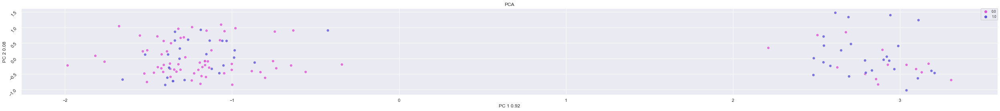

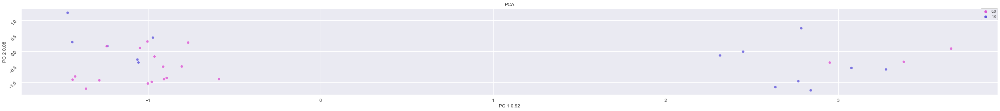

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



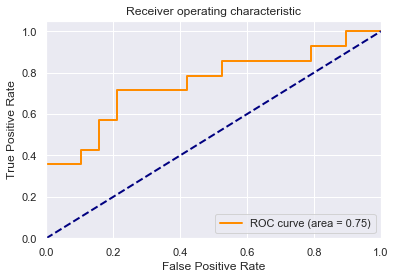

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for Logistic Regression: 0.684615
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6846153846153846 

Best C: 1.0 

Best Gamma: 0.1 



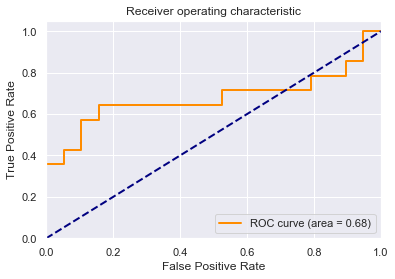

[[18  1]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.69      0.95      0.80        19
           1       0.86      0.43      0.57        14

    accuracy                           0.73        33
   macro avg       0.77      0.69      0.69        33
weighted avg       0.76      0.73      0.70        33

Training set score for SVM: 0.715385
Testing  set score for SVM: 0.727273
Best score for training data: 0.6538461538461539 

Best #estimators: 140 

Best max depth: None 



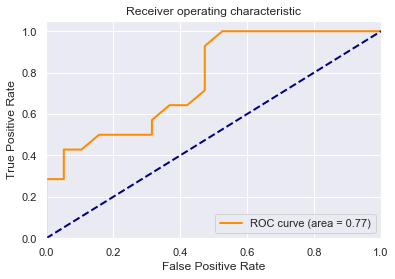

[[17  2]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.68      0.89      0.77        19
           1       0.75      0.43      0.55        14

    accuracy                           0.70        33
   macro avg       0.72      0.66      0.66        33
weighted avg       0.71      0.70      0.68        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.696970


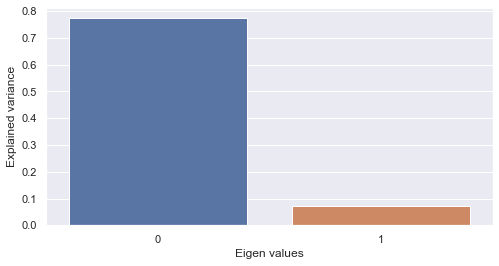

PCA on single-modal explained variance ratio: 0.8444458842277527


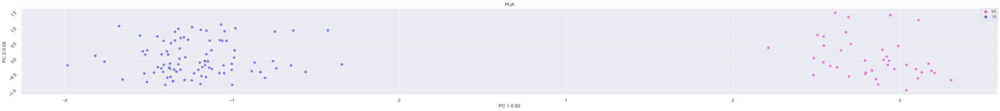

2 clusters -  silhoutte score: 0.674257218837738 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.3668891489505768 - mutual information: 0.06729022884816298
4 clusters -  silhoutte score: 0.25002172589302063 - mutual information: 0.07294080685102614


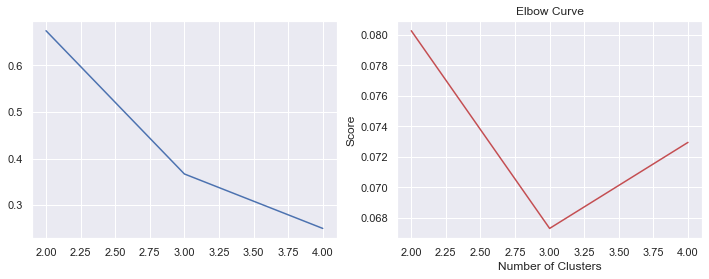

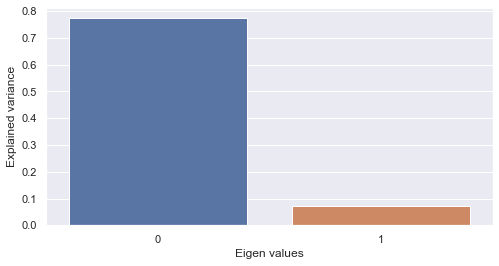

PCA on single-modal explained variance ratio: 0.8444458842277527


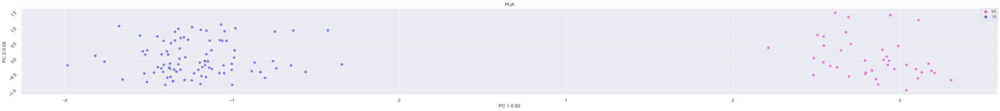

2 clusters -  silhoutte score: 0.674257218837738 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5720472931861877 - mutual information: 0.07306858784095262
4 clusters -  silhoutte score: 0.560651421546936 - mutual information: 0.1128437116770312


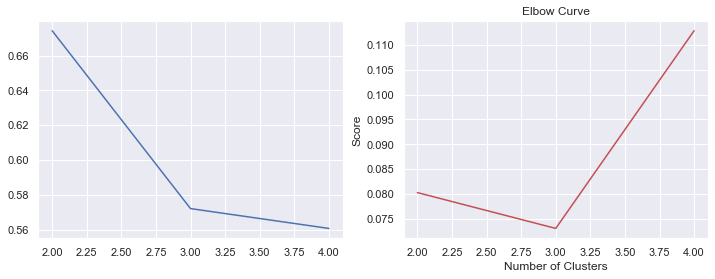

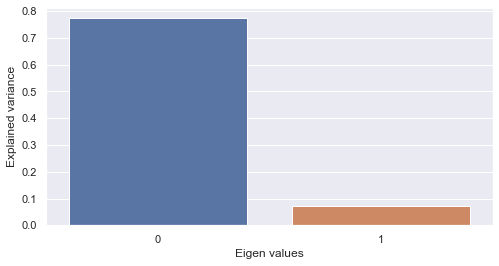

PCA on single-modal explained variance ratio: 0.8444458842277527


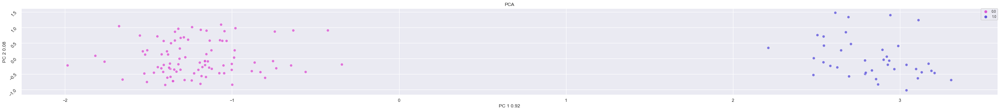

2 clusters -  silhoutte score: 0.674257218837738 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.30668267607688904 - mutual information: 0.05961898113826803
4 clusters -  silhoutte score: 0.3311825096607208 - mutual information: 0.05465092449776947


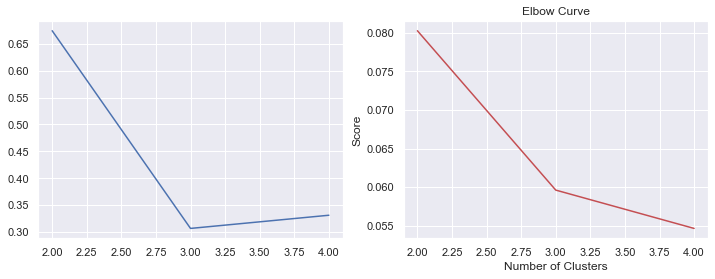

Compression: 86.93

Epoch 00022: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00051: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00056: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.
Epoch 00056: early stopping


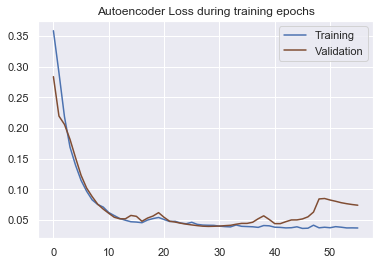

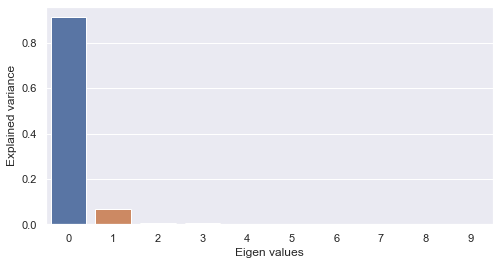

PCA on single-modal explained variance ratio: 0.9985325336456299


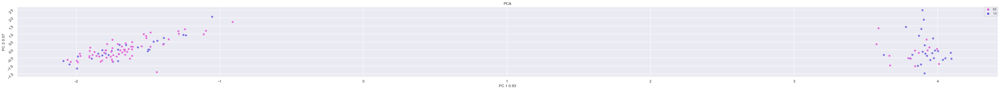

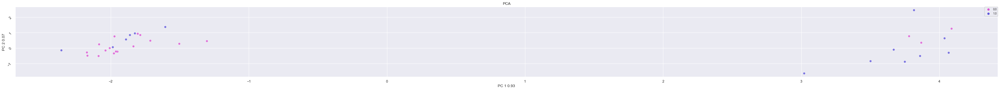

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



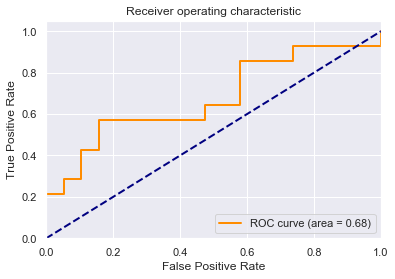

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for Logistic Regression: 0.684615
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6846153846153846 

Best C: 1.0 

Best Gamma: 0.1 



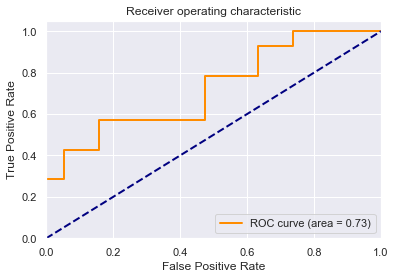

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for SVM: 0.684615
Testing  set score for SVM: 0.727273
Best score for training data: 0.6846153846153846 

Best #estimators: 100 

Best max depth: 12 



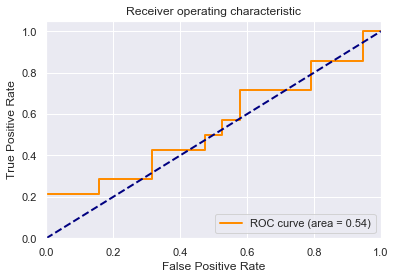

[[12  7]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.60      0.63      0.62        19
           1       0.46      0.43      0.44        14

    accuracy                           0.55        33
   macro avg       0.53      0.53      0.53        33
weighted avg       0.54      0.55      0.54        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.545455


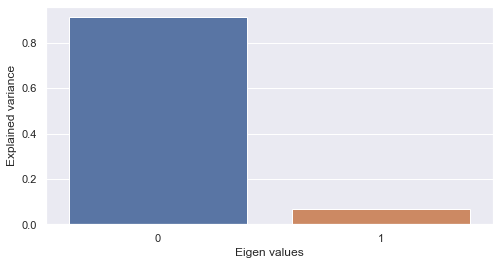

PCA on single-modal explained variance ratio: 0.9796435832977295


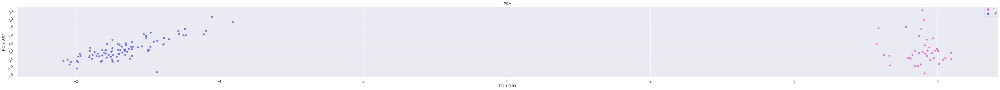

2 clusters -  silhoutte score: 0.8271268010139465 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5566864013671875 - mutual information: 0.06242617831262613
4 clusters -  silhoutte score: 0.4842115044593811 - mutual information: 0.057139770919438074


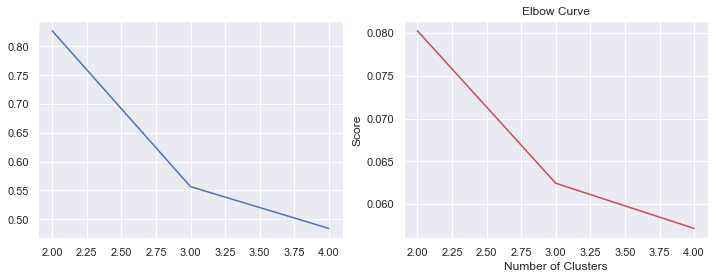

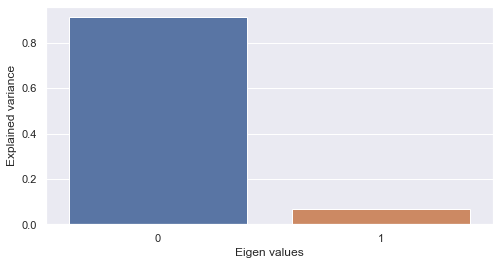

PCA on single-modal explained variance ratio: 0.9796435832977295


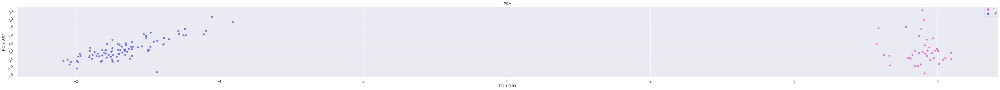

2 clusters -  silhoutte score: 0.8271268010139465 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.7634022235870361 - mutual information: 0.07743602126435377
4 clusters -  silhoutte score: 0.7298598289489746 - mutual information: 0.0830474661138792


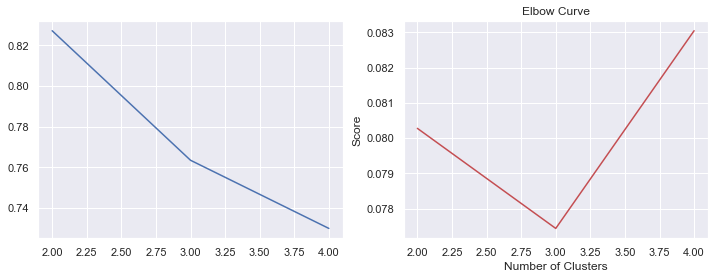

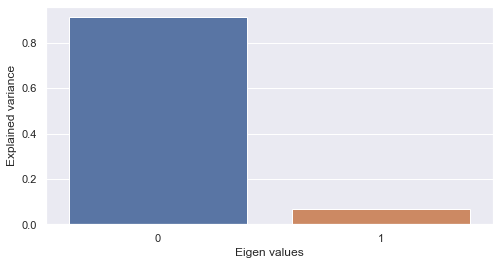

PCA on single-modal explained variance ratio: 0.9796435832977295


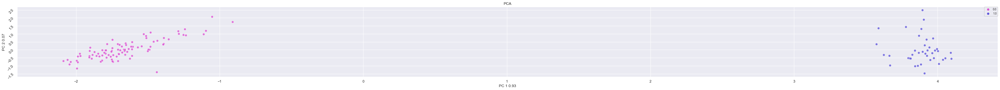

2 clusters -  silhoutte score: 0.8271268010139465 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5794724822044373 - mutual information: 0.06780464993172473
4 clusters -  silhoutte score: 0.5077357292175293 - mutual information: 0.06166118127846598


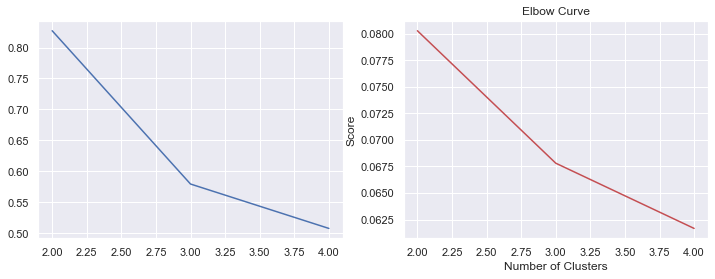

Compression: 86.93

Epoch 00028: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00059: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00070: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00079: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00087: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.

Epoch 00092: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-09.
Epoch 00092: early stopping


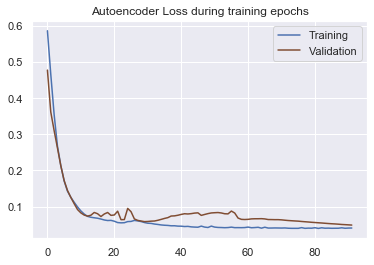

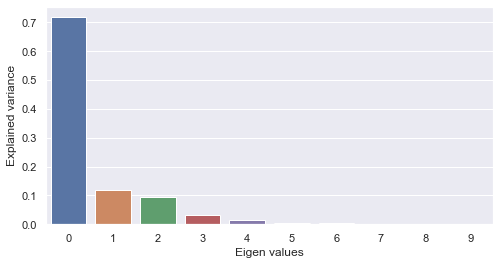

PCA on single-modal explained variance ratio: 0.9940657615661621


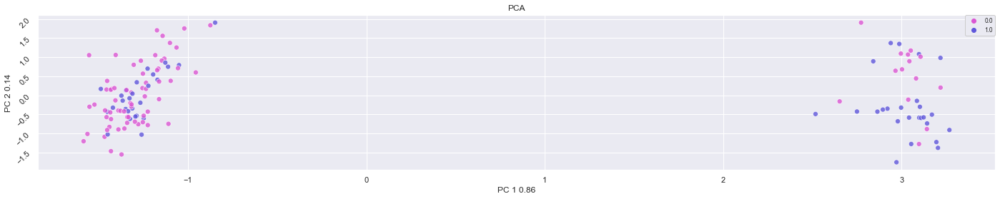

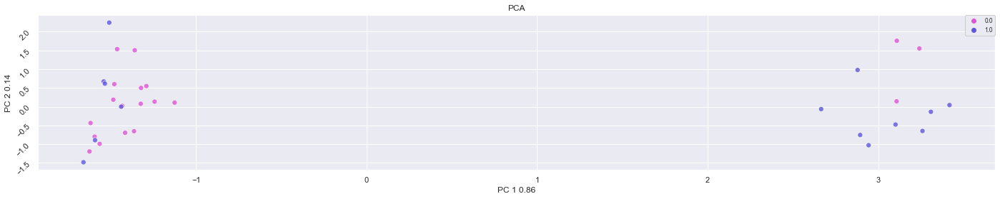

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



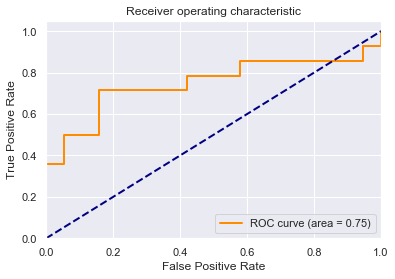

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for Logistic Regression: 0.692308
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.7076923076923076 

Best C: 1.0 

Best Gamma: 0.1 



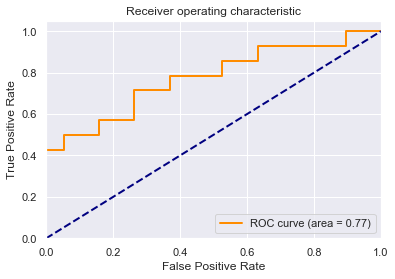

[[18  1]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.72      0.95      0.82        19
           1       0.88      0.50      0.64        14

    accuracy                           0.76        33
   macro avg       0.80      0.72      0.73        33
weighted avg       0.79      0.76      0.74        33

Training set score for SVM: 0.730769
Testing  set score for SVM: 0.757576
Best score for training data: 0.6384615384615383 

Best #estimators: 140 

Best max depth: None 



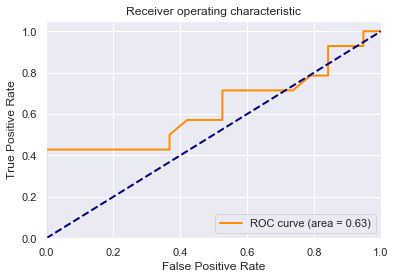

[[12  7]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.60      0.63      0.62        19
           1       0.46      0.43      0.44        14

    accuracy                           0.55        33
   macro avg       0.53      0.53      0.53        33
weighted avg       0.54      0.55      0.54        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.545455


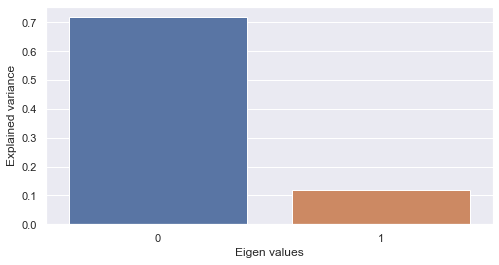

PCA on single-modal explained variance ratio: 0.838016152381897


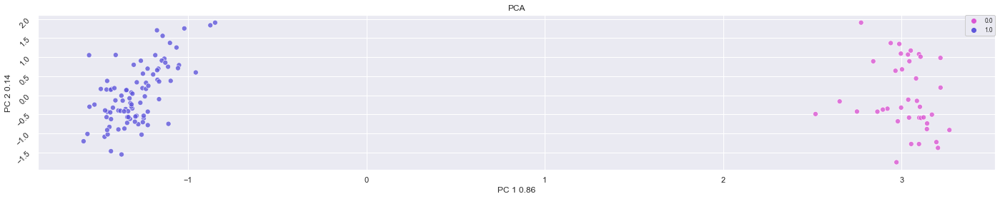

2 clusters -  silhoutte score: 0.6522519588470459 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.3942353427410126 - mutual information: 0.05955887799131616
4 clusters -  silhoutte score: 0.3302024006843567 - mutual information: 0.0938997461871545


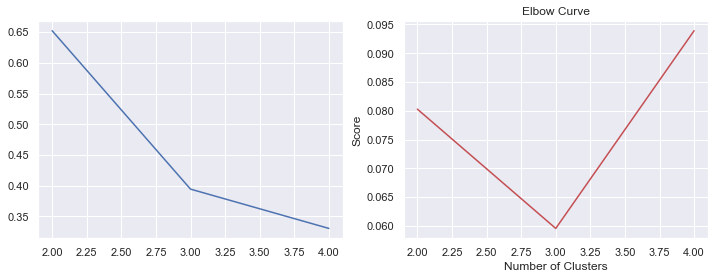

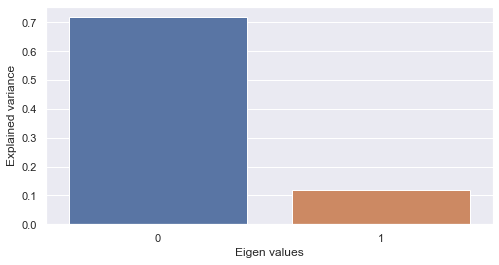

PCA on single-modal explained variance ratio: 0.838016152381897


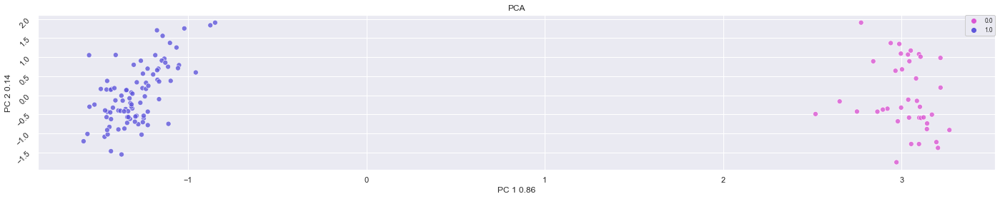

2 clusters -  silhoutte score: 0.6522519588470459 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5789476633071899 - mutual information: 0.1329966902448754
4 clusters -  silhoutte score: 0.5858325958251953 - mutual information: 0.13588004819058905


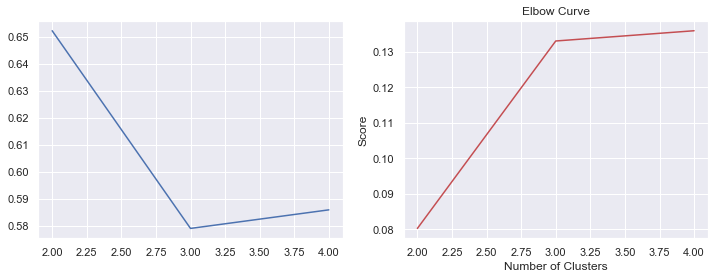

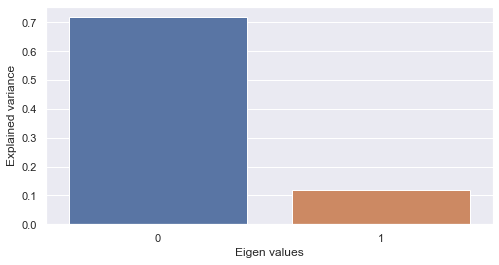

PCA on single-modal explained variance ratio: 0.838016152381897


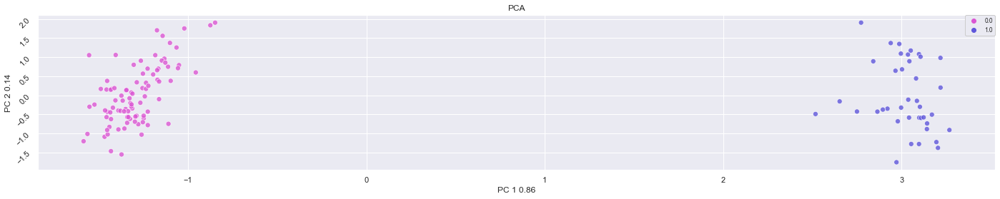

2 clusters -  silhoutte score: 0.6522519588470459 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.3974300026893616 - mutual information: 0.06052743034819677
4 clusters -  silhoutte score: 0.33189690113067627 - mutual information: 0.10309570850414267


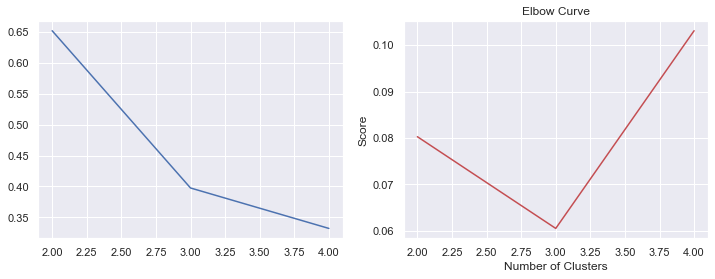

Compression: 86.93

Epoch 00066: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00115: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00125: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00136: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00141: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.
Epoch 00141: early stopping


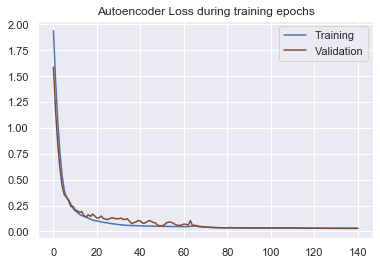

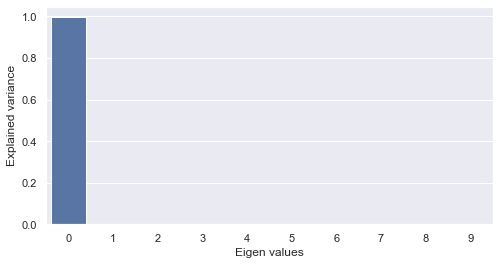

PCA on single-modal explained variance ratio: 0.9999997019767761


ValueError: Image size of 94405x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 94405.7x288 with 1 Axes>

ValueError: Image size of 94405x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 94405.7x288 with 1 Axes>

Results for AE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



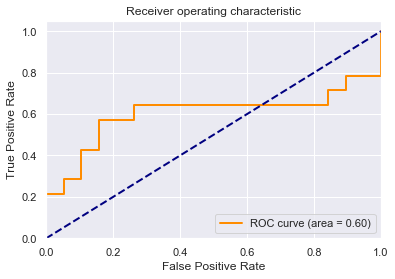

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for Logistic Regression: 0.684615
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6846153846153846 

Best C: 0.1 

Best Gamma: scale 



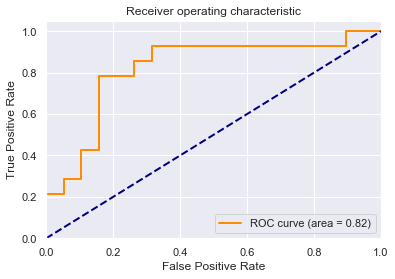

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for SVM: 0.684615
Testing  set score for SVM: 0.727273
Best score for training data: 0.6923076923076923 

Best #estimators: 140 

Best max depth: None 



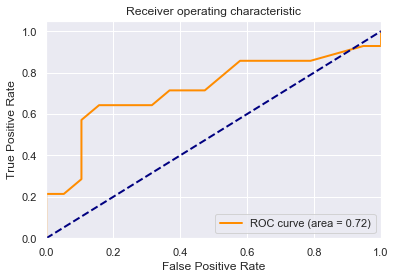

[[17  2]
 [ 9  5]]


              precision    recall  f1-score   support

           0       0.65      0.89      0.76        19
           1       0.71      0.36      0.48        14

    accuracy                           0.67        33
   macro avg       0.68      0.63      0.62        33
weighted avg       0.68      0.67      0.64        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.666667


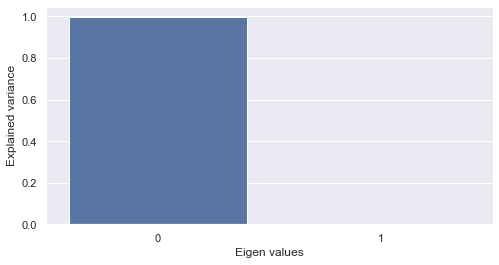

PCA on single-modal explained variance ratio: 0.9995998740196228


ValueError: Image size of 94405x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 94405.7x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9560656547546387 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.7000989317893982 - mutual information: 0.06309380008580194
4 clusters -  silhoutte score: 0.6422557234764099 - mutual information: 0.06871922811496001


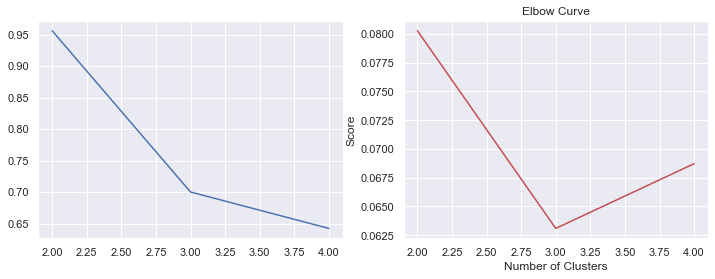

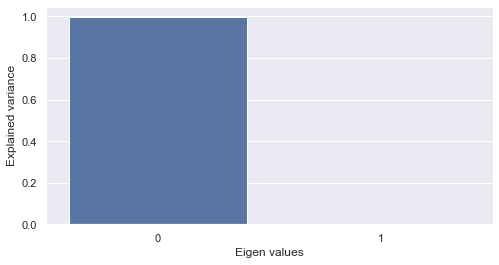

PCA on single-modal explained variance ratio: 0.9995998740196228


ValueError: Image size of 94405x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 94405.7x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9560656547546387 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.7070431113243103 - mutual information: 0.06281185760049893
4 clusters -  silhoutte score: 0.5241212248802185 - mutual information: 0.08483105153500611


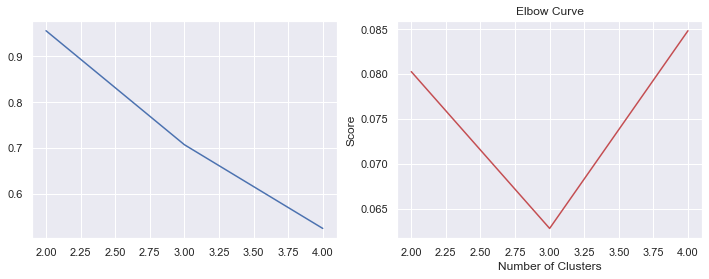

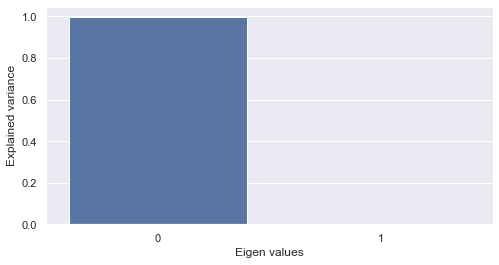

PCA on single-modal explained variance ratio: 0.9995998740196228


ValueError: Image size of 94405x288 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 94405.7x288 with 1 Axes>

2 clusters -  silhoutte score: 0.9560656547546387 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.7084494233131409 - mutual information: 0.06395708046967748
4 clusters -  silhoutte score: 0.5980181694030762 - mutual information: 0.06374513418316607


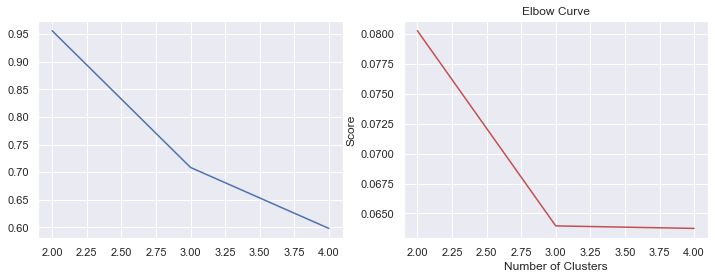

In [5]:
encoding_dims=[100]
mus=[0.5]
dropouts = [0]
l1s = [0.0000001]
l2s = [0.000005]
scores = []
for encoding_dim in encoding_dims:
    for mu in mus:
        for dropout in dropouts:
            for l1 in l1s:
                for l2 in l2s:
                    ## Build and Train Autoencoder
                    autoencoder, encoder, decoder, loss = Models.build_and_train_autoencoder(X_train_concat,
                                                                                  X_train_concat,
                                                                                  encoding_dim=encoding_dim, 
                                                                                  regularizer=tf.keras.regularizers.l1_l2(l1,l2),
                                                                                  dropout=dropout,
                                                                                  epochs=200,
                                                                                  )
                    ## Encode datasets
                    X_latent_ae = Models.encode_dataset(X_train_concat, encoder)
                    X_latent_test_ae = Models.encode_dataset(X_test_concat, encoder)

                    ## PCA ON AUTOENCODER LATENT SPACE
                    X_latent_pca_ae, X_latent_test_pca_ae = Models.perform_PCA(X_latent_ae, y_train, X_latent_test_ae, y_test, n_components=10)

                    ### CLASSIFICATION ###
                    classify = Models.classify(X_latent_ae, X_latent_test_ae, np.ravel(y_train), np.ravel(y_test), model_type="AE")

                    ### CLUSTERING ###
                    clustering = Models.cluster(X_latent_ae,np.ravel(y_train), model_type="AE")

                    scores.append([mu,dropout,l1,l2,loss] + classify + clustering)

In [6]:
scores = pd.DataFrame(scores,
                      columns=["mu","dropout","l1","l2","loss","LR accuracy","SVM accuracy", "RF accuracy", "LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC","KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette","KMeans MI","Spectral MI","Hierarchical MI"])    
display(scores)
print(f"Random classifier: {y_test.iloc[:,0].value_counts()[0]/len(y_test)}")

,mu,dropout,l1,l2,loss,LR accuracy,SVM accuracy,RF accuracy,LR ROC-AUC,SVM ROC-AUC,RF ROC-AUC,KMeans Silhouette,Spectral Silhouette,Hierarchical Silhouette,KMeans MI,Spectral MI,Hierarchical MI
0,0.5,0,0.000000e+00,0.000005,0.014355,0.727273,0.696970,0.757576,0.751880,0.736842,0.738722,0.500859,0.500859,0.500859,0.076609,0.100243,0.089233
1,0.5,0,1.000000e-07,0.000005,0.017517,0.727273,0.727273,0.666667,0.789474,0.868421,0.763158,0.496622,0.496622,0.496622,0.051261,0.110677,0.084078
2,0.5,0,5.000000e-07,0.000005,0.015636,0.727273,0.727273,0.757576,0.725564,0.759398,0.798872,0.486714,0.486714,0.486714,0.060384,0.087287,0.054473
3,0.5,0,1.000000e-06,0.000005,0.027369,0.727273,0.727273,0.696970,0.751880,0.676692,0.766917,0.674257,0.674257,0.674257,0.072941,0.112844,0.054651
4,0.5,0,5.000000e-06,0.000005,0.037084,0.727273,0.727273,0.545455,0.676692,0.725564,0.541353,0.827127,0.827127,0.827127,0.057140,0.083047,0.061661
5,0.5,0,1.000000e-05,0.000005,0.040670,0.727273,0.757576,0.545455,0.748120,0.774436,0.627820,0.652252,0.652252,0.652252,0.093900,0.135880,0.103096
6,0.5,0,4.000000e-05,0.000005,0.029753,0.727273,0.727273,0.666667,0.601504,0.819549,0.721805,0.956066,0.956066,0.956066,0.068719,0.084831,0.063745


Random classifier: 0.5757575757575758


C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:376: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(new_indexer, value)
C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the docume

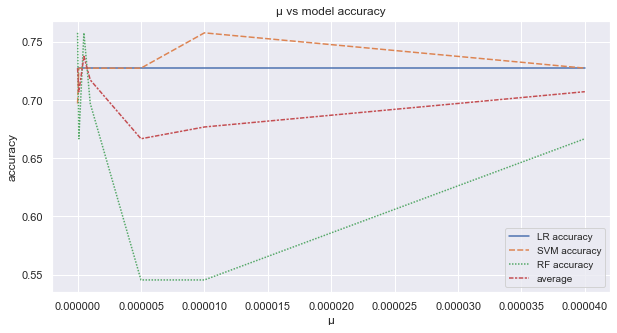

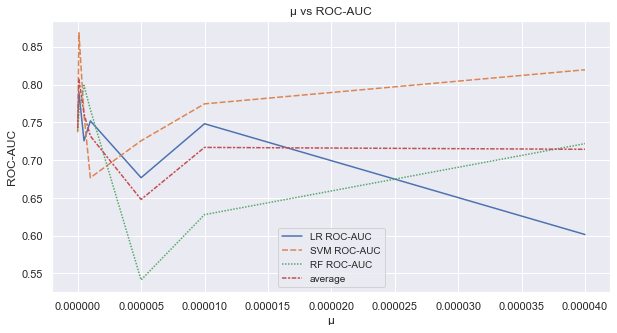

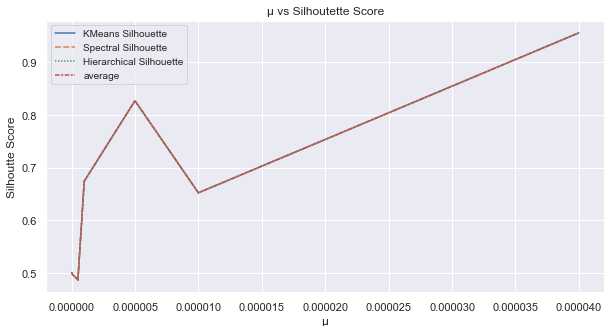

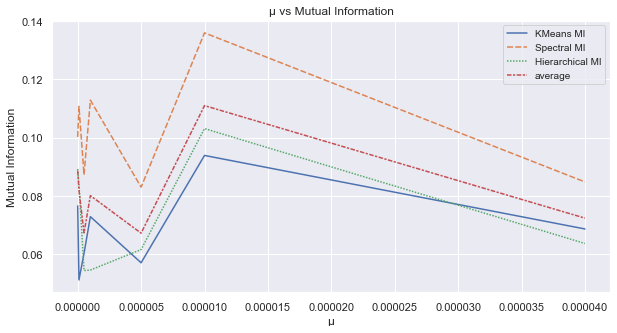

In [8]:
scores.index = l1s

data_acc = scores[["LR accuracy","SVM accuracy","RF accuracy"]]
data_acc.loc[:,"average"] = data_acc.mean(axis=1)

data_auc = scores[["LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC"]]
data_auc.loc[:,"average"] = data_auc.mean(axis=1)

data_ss = scores[["KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette"]]
data_ss.loc[:,"average"] = data_ss.mean(axis=1)

data_mi = scores[["KMeans MI","Spectral MI","Hierarchical MI"]]
data_mi.loc[:,"average"] = data_mi.mean(axis=1)

sns.set()
hyperparam = "μ"

ax = sns.lineplot(data=data_acc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"accuracy")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs model accuracy")
plt.show()

ax = sns.lineplot(data=data_auc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"ROC-AUC")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs ROC-AUC")
plt.show()

ax = sns.lineplot(data=data_ss)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Silhoutte Score")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Silhoutette Score")
plt.show()

ax = sns.lineplot(data=data_mi)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Mutual Information")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Mutual Information")
plt.show()

Compression: 86.93

Epoch 00105: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00122: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00128: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00137: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00142: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.
Epoch 00142: early stopping


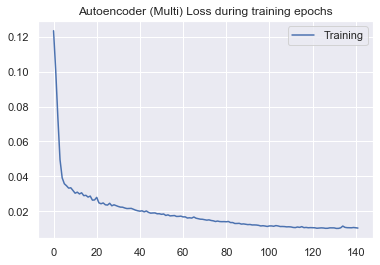

0.010382184902062783


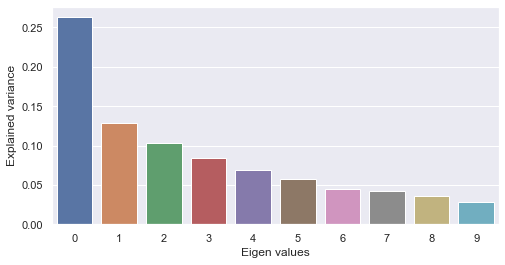

PCA on single-modal explained variance ratio: 0.8564998507499695


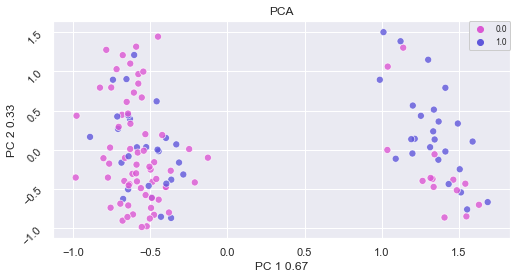

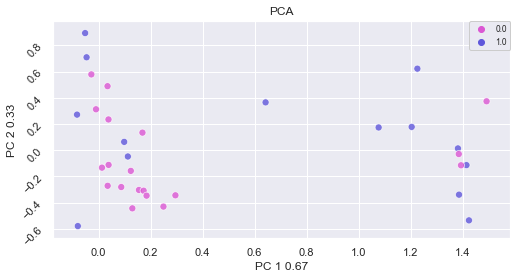

Results for DAE: 

Best score for training data: 0.7153846153846154 

Best C: 0.08 



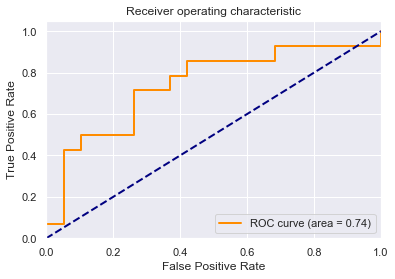

[[17  2]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.68      0.89      0.77        19
           1       0.75      0.43      0.55        14

    accuracy                           0.70        33
   macro avg       0.72      0.66      0.66        33
weighted avg       0.71      0.70      0.68        33

Training set score for Logistic Regression: 0.738462
Testing  set score for Logistic Regression: 0.696970
Best score for training data: 0.6923076923076923 

Best C: 1.0 

Best Gamma: 0.1 



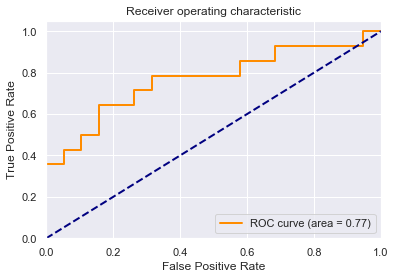

[[16  3]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.70      0.84      0.76        19
           1       0.70      0.50      0.58        14

    accuracy                           0.70        33
   macro avg       0.70      0.67      0.67        33
weighted avg       0.70      0.70      0.69        33

Training set score for SVM: 0.723077
Testing  set score for SVM: 0.696970
Best score for training data: 0.7076923076923076 

Best #estimators: 140 

Best max depth: None 



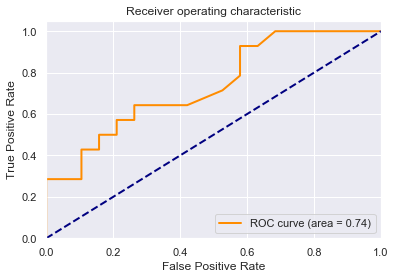

[[16  3]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.70      0.84      0.76        19
           1       0.70      0.50      0.58        14

    accuracy                           0.70        33
   macro avg       0.70      0.67      0.67        33
weighted avg       0.70      0.70      0.69        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.696970


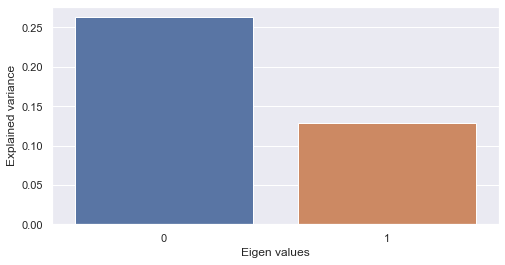

PCA on single-modal explained variance ratio: 0.3913344144821167


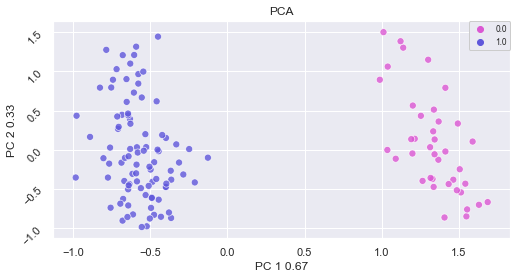

2 clusters -  silhoutte score: 0.27321934700012207 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.1821449249982834 - mutual information: 0.06200928089871952
4 clusters -  silhoutte score: 0.1421027034521103 - mutual information: 0.08058288684300964


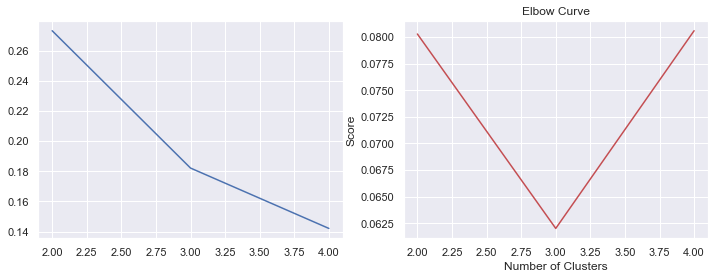

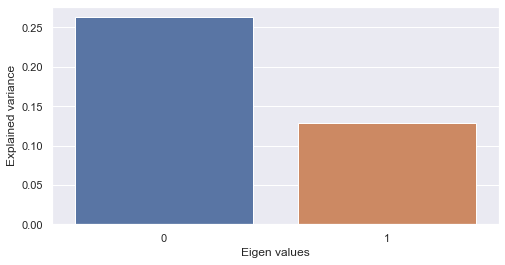

PCA on single-modal explained variance ratio: 0.3913344144821167


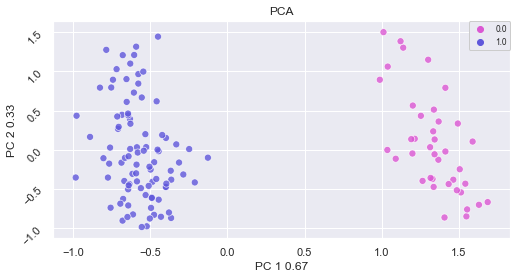

2 clusters -  silhoutte score: 0.27321934700012207 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.1856294572353363 - mutual information: 0.054950533391676035
4 clusters -  silhoutte score: 0.1619238555431366 - mutual information: 0.08784779793289645


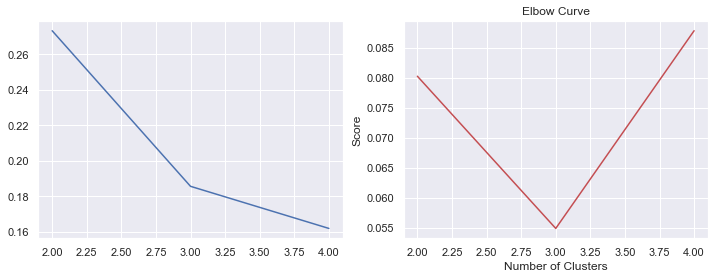

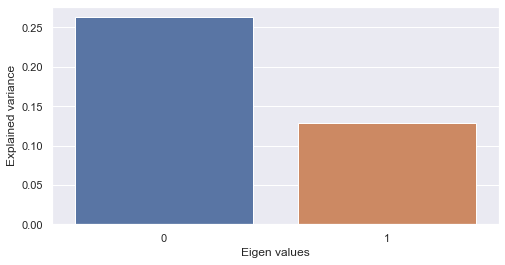

PCA on single-modal explained variance ratio: 0.3913344144821167


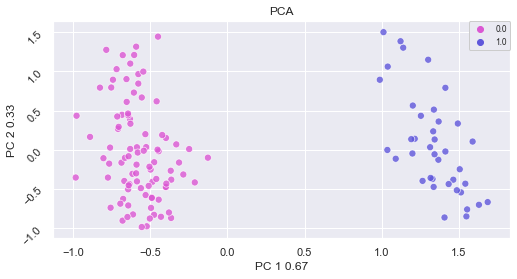

2 clusters -  silhoutte score: 0.27321934700012207 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.17077727615833282 - mutual information: 0.06204892368068429
4 clusters -  silhoutte score: 0.13288834691047668 - mutual information: 0.07287203883836224


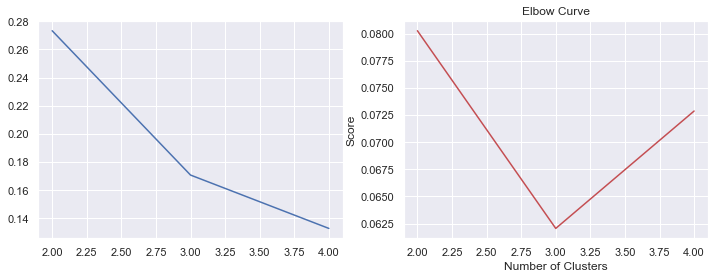

Compression: 86.93

Epoch 00082: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00092: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00099: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00104: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00104: early stopping


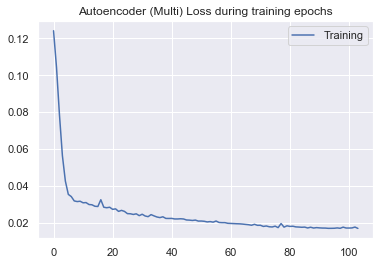

0.01709770425581015


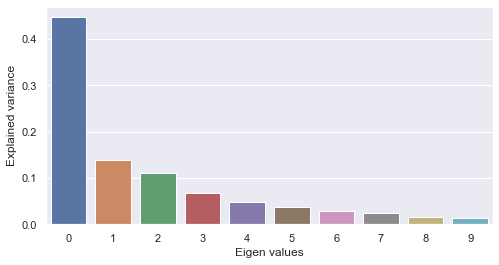

PCA on single-modal explained variance ratio: 0.9315512180328369


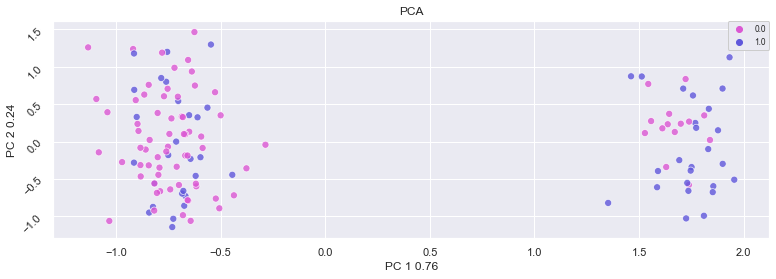

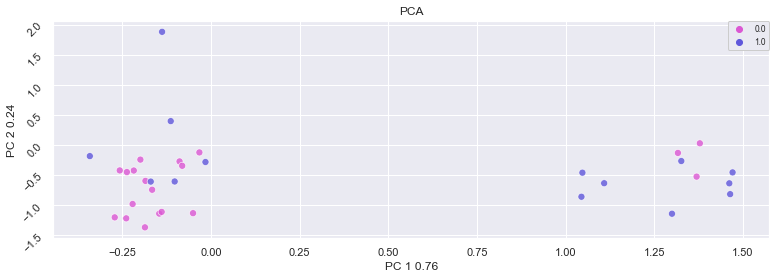

Results for DAE: 

Best score for training data: 0.7153846153846155 

Best C: 0.08 



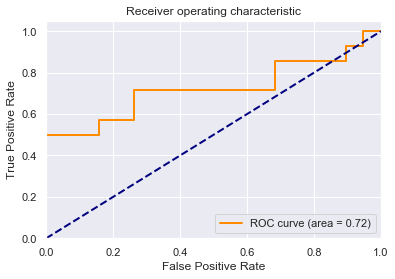

[[16  3]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.70      0.84      0.76        19
           1       0.70      0.50      0.58        14

    accuracy                           0.70        33
   macro avg       0.70      0.67      0.67        33
weighted avg       0.70      0.70      0.69        33

Training set score for Logistic Regression: 0.715385
Testing  set score for Logistic Regression: 0.696970
Best score for training data: 0.7 

Best C: 1.0 

Best Gamma: 0.1 



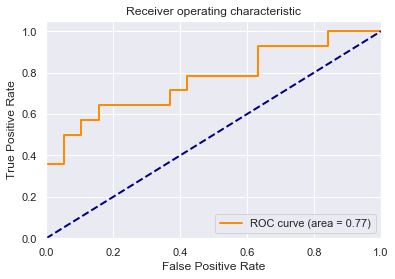

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for SVM: 0.730769
Testing  set score for SVM: 0.727273
Best score for training data: 0.7153846153846154 

Best #estimators: 140 

Best max depth: None 



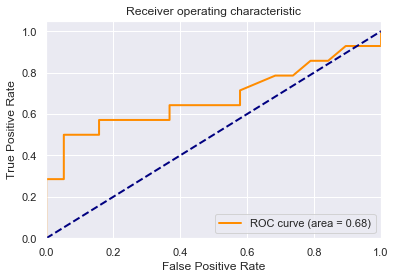

[[18  1]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.72      0.95      0.82        19
           1       0.88      0.50      0.64        14

    accuracy                           0.76        33
   macro avg       0.80      0.72      0.73        33
weighted avg       0.79      0.76      0.74        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.757576


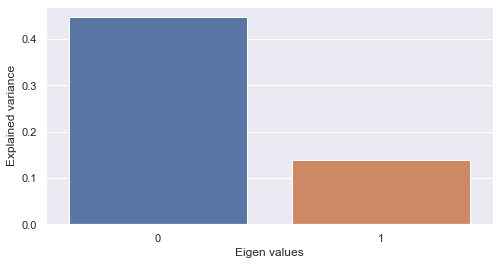

PCA on single-modal explained variance ratio: 0.5856767296791077


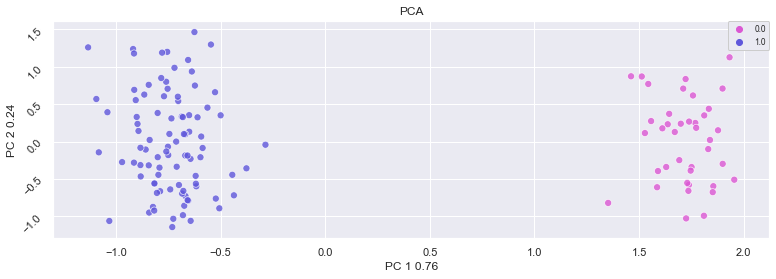

2 clusters -  silhoutte score: 0.4288369119167328 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.2559658885002136 - mutual information: 0.05864684340583092
4 clusters -  silhoutte score: 0.24866585433483124 - mutual information: 0.0799653267449568


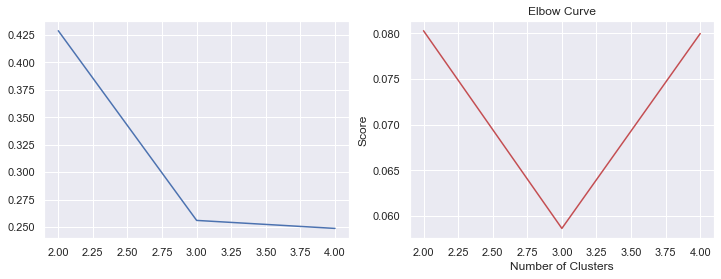

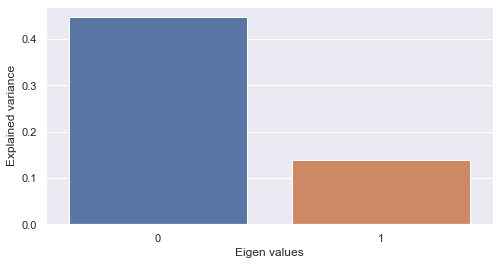

PCA on single-modal explained variance ratio: 0.5856767296791077


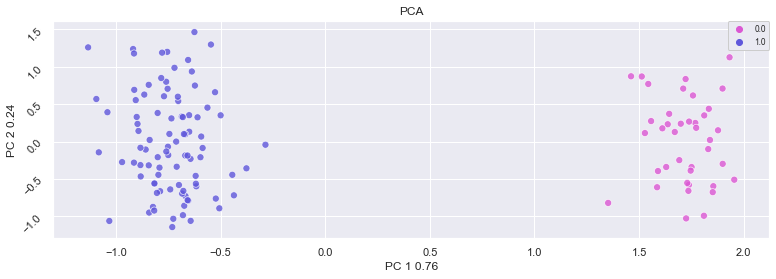

2 clusters -  silhoutte score: 0.4288369119167328 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.3557901084423065 - mutual information: 0.1329966902448754
4 clusters -  silhoutte score: 0.22547031939029694 - mutual information: 0.10496878988694033


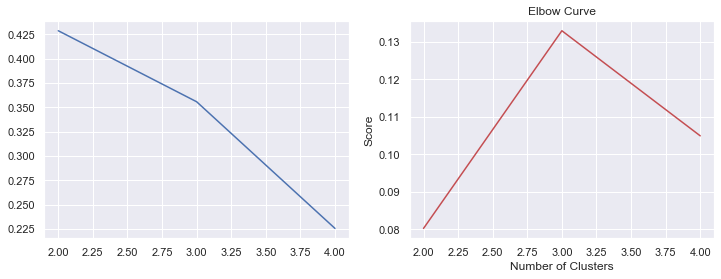

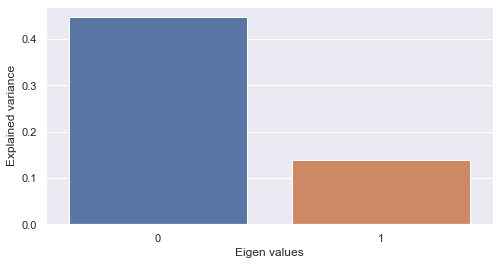

PCA on single-modal explained variance ratio: 0.5856767296791077


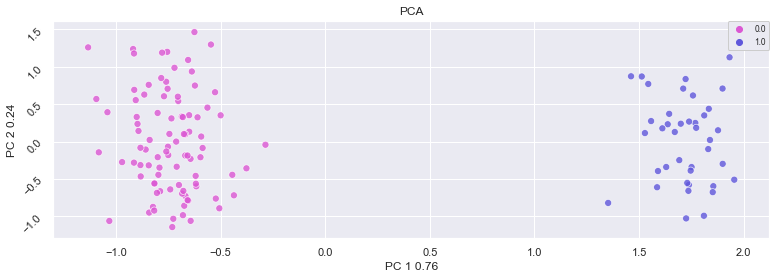

2 clusters -  silhoutte score: 0.4288369119167328 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.27352914214134216 - mutual information: 0.06119372019553096
4 clusters -  silhoutte score: 0.23735657334327698 - mutual information: 0.07230709256816385


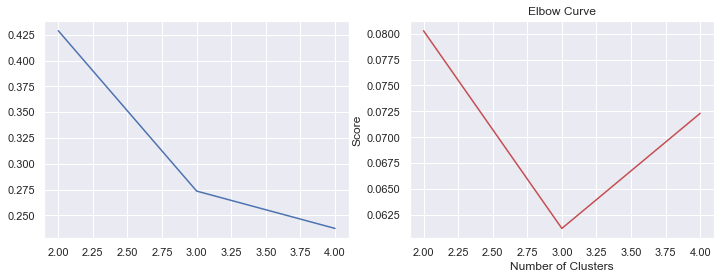

Compression: 86.93

Epoch 00089: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00106: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00111: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00116: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00119: early stopping


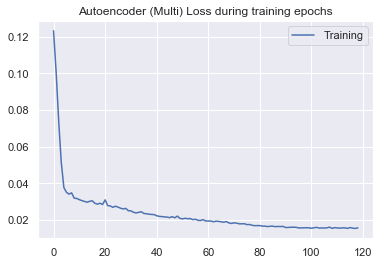

0.01569083906137026


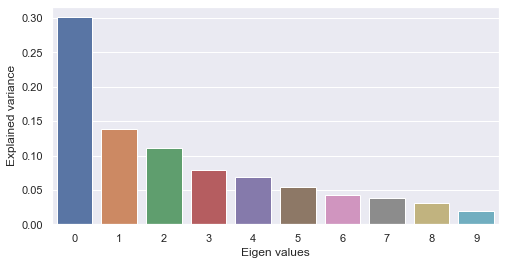

PCA on single-modal explained variance ratio: 0.8833049535751343


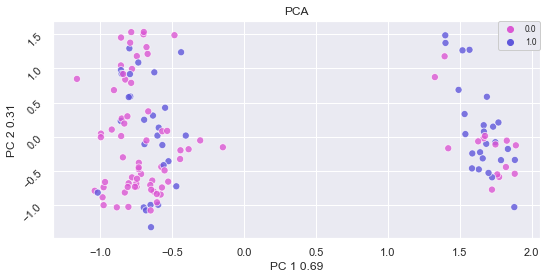

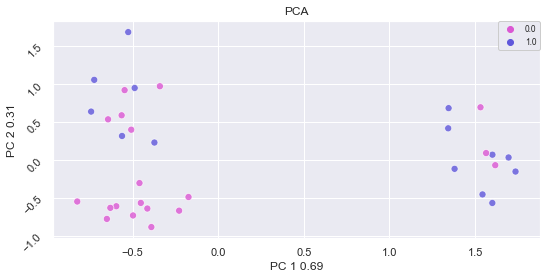

Results for DAE: 

Best score for training data: 0.7000000000000001 

Best C: 0.08 



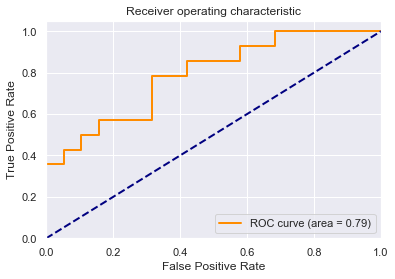

[[17  2]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.68      0.89      0.77        19
           1       0.75      0.43      0.55        14

    accuracy                           0.70        33
   macro avg       0.72      0.66      0.66        33
weighted avg       0.71      0.70      0.68        33

Training set score for Logistic Regression: 0.715385
Testing  set score for Logistic Regression: 0.696970
Best score for training data: 0.6846153846153846 

Best C: 1.0 

Best Gamma: 0.1 



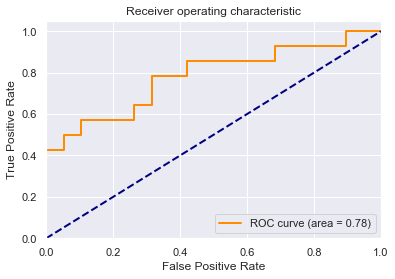

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for SVM: 0.746154
Testing  set score for SVM: 0.727273
Best score for training data: 0.7 

Best #estimators: 100 

Best max depth: 12 



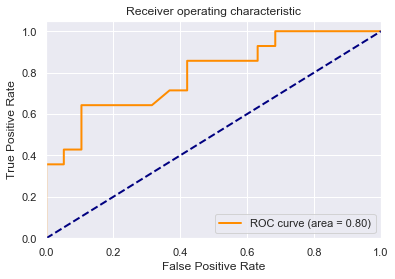

[[18  1]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.69      0.95      0.80        19
           1       0.86      0.43      0.57        14

    accuracy                           0.73        33
   macro avg       0.77      0.69      0.69        33
weighted avg       0.76      0.73      0.70        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.727273


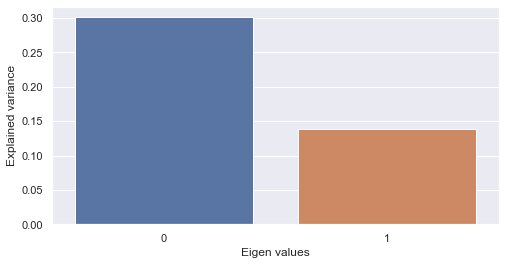

PCA on single-modal explained variance ratio: 0.4393044412136078


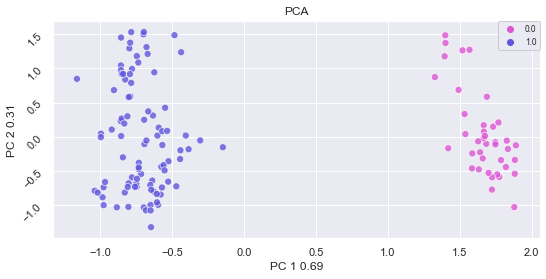

2 clusters -  silhoutte score: 0.2986869812011719 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.22351251542568207 - mutual information: 0.06242617831262613
4 clusters -  silhoutte score: 0.18215367197990417 - mutual information: 0.07456416517354067


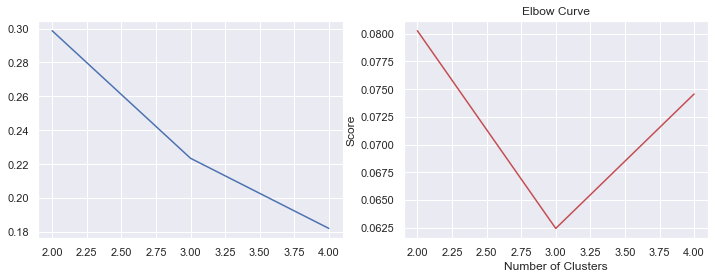

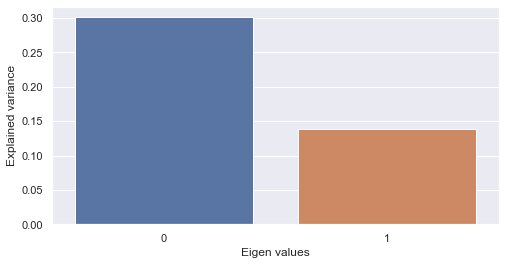

PCA on single-modal explained variance ratio: 0.4393044412136078


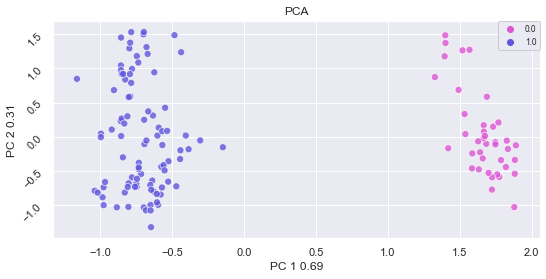

2 clusters -  silhoutte score: 0.2986869812011719 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.22245198488235474 - mutual information: 0.061085321523635716
4 clusters -  silhoutte score: 0.18804417550563812 - mutual information: 0.0772894017698419


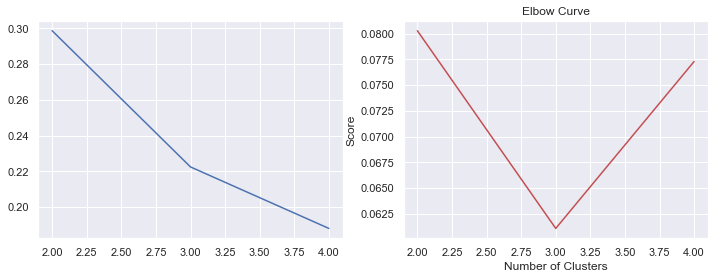

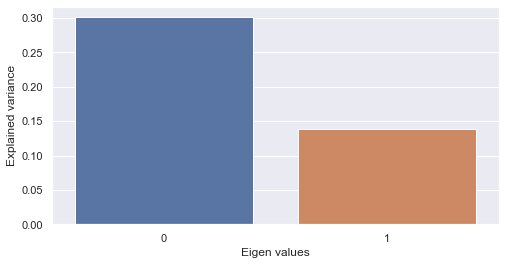

PCA on single-modal explained variance ratio: 0.4393044412136078


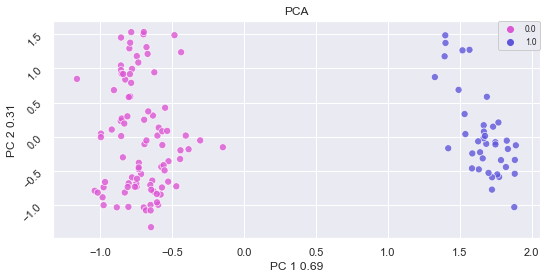

2 clusters -  silhoutte score: 0.2986869812011719 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.2211359143257141 - mutual information: 0.06062621100735738
4 clusters -  silhoutte score: 0.1857091188430786 - mutual information: 0.09579114888245242


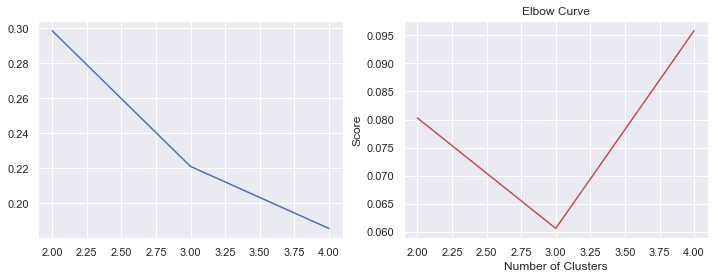

Compression: 86.93

Epoch 00061: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00077: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00086: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00091: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00091: early stopping


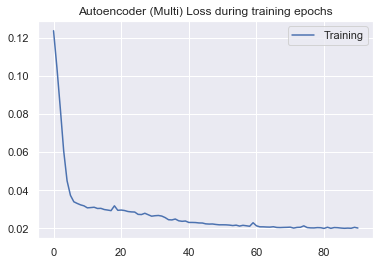

0.020148236447801955


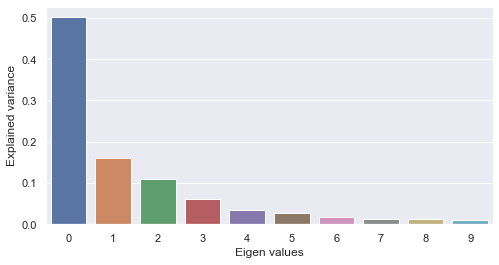

PCA on single-modal explained variance ratio: 0.9523500204086304


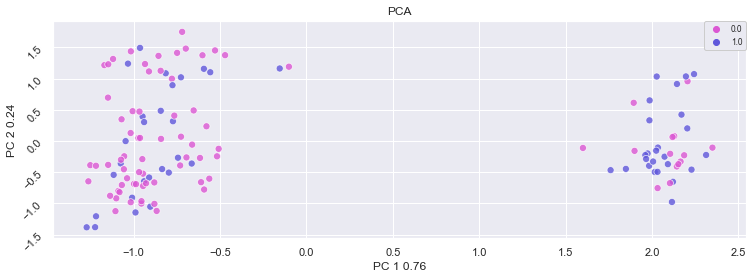

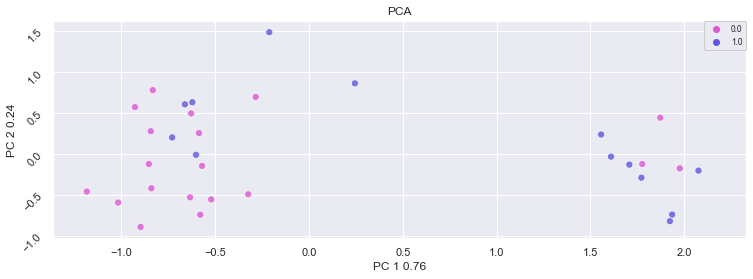

Results for DAE: 

Best score for training data: 0.7384615384615385 

Best C: 0.08 



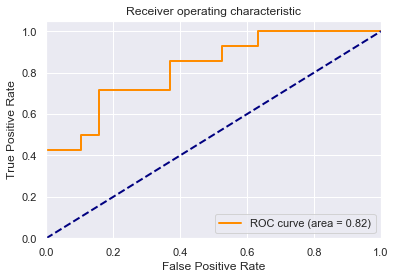

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for Logistic Regression: 0.730769
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6923076923076923 

Best C: 1.0 

Best Gamma: 0.1 



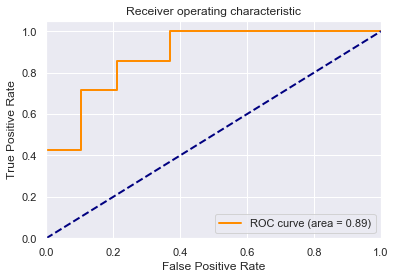

[[18  1]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.69      0.95      0.80        19
           1       0.86      0.43      0.57        14

    accuracy                           0.73        33
   macro avg       0.77      0.69      0.69        33
weighted avg       0.76      0.73      0.70        33

Training set score for SVM: 0.730769
Testing  set score for SVM: 0.727273
Best score for training data: 0.7076923076923076 

Best #estimators: 100 

Best max depth: 12 



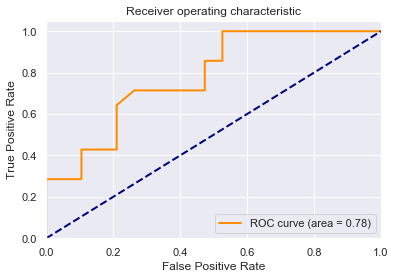

[[17  2]
 [10  4]]


              precision    recall  f1-score   support

           0       0.63      0.89      0.74        19
           1       0.67      0.29      0.40        14

    accuracy                           0.64        33
   macro avg       0.65      0.59      0.57        33
weighted avg       0.65      0.64      0.60        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.636364


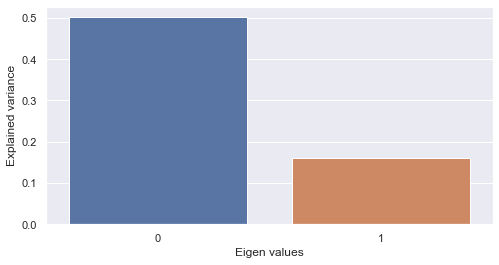

PCA on single-modal explained variance ratio: 0.6633142828941345


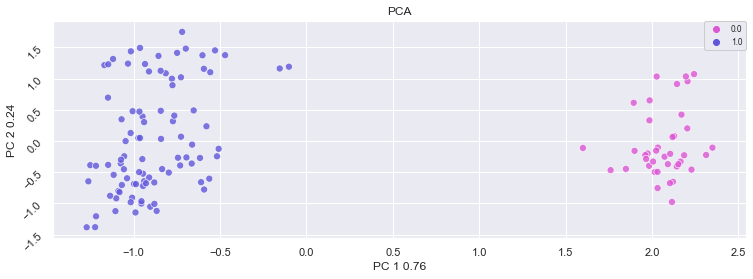

2 clusters -  silhoutte score: 0.47233104705810547 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.34718891978263855 - mutual information: 0.06141368889910484
4 clusters -  silhoutte score: 0.3073667585849762 - mutual information: 0.06609469258417434


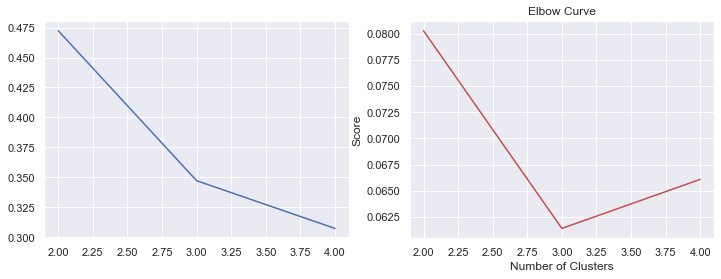

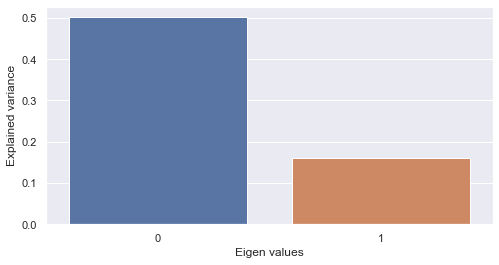

PCA on single-modal explained variance ratio: 0.6633142828941345


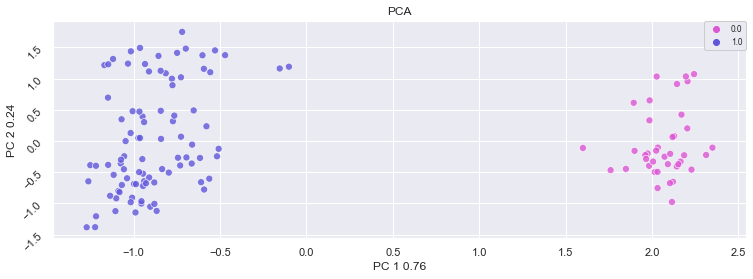

2 clusters -  silhoutte score: 0.47233104705810547 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.4210871756076813 - mutual information: 0.07743602126435377
4 clusters -  silhoutte score: 0.31936386227607727 - mutual information: 0.06021020696011586


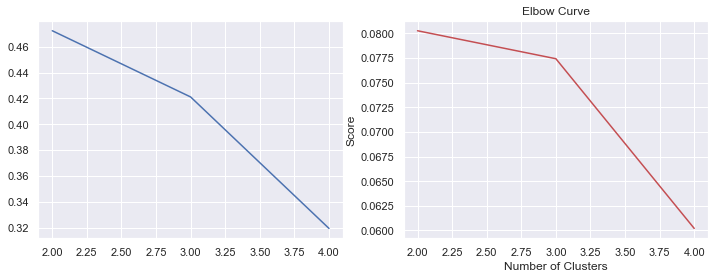

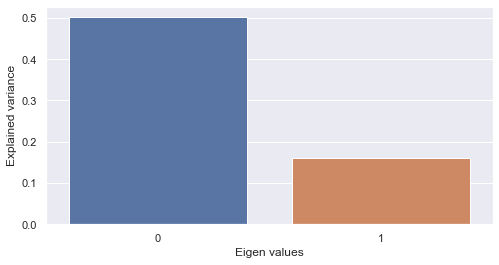

PCA on single-modal explained variance ratio: 0.6633142828941345


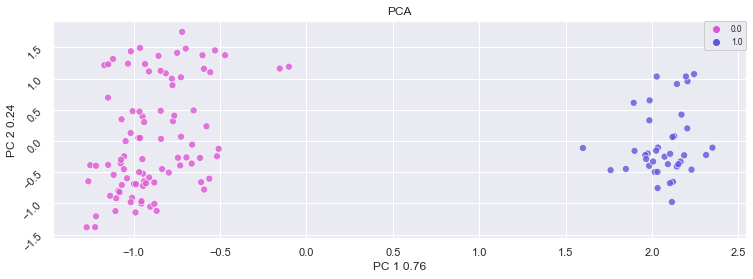

2 clusters -  silhoutte score: 0.47233104705810547 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.3421032428741455 - mutual information: 0.05955887799131616
4 clusters -  silhoutte score: 0.2942278981208801 - mutual information: 0.056968876589270946


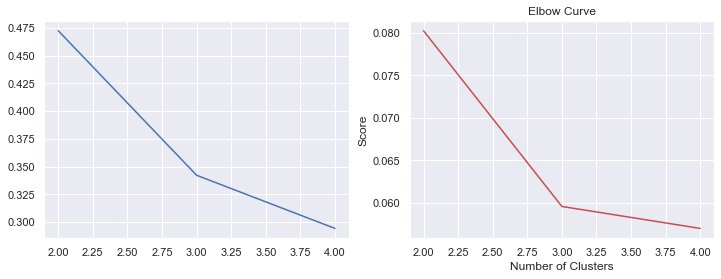

Compression: 86.93

Epoch 00026: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00043: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00049: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00054: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00054: early stopping


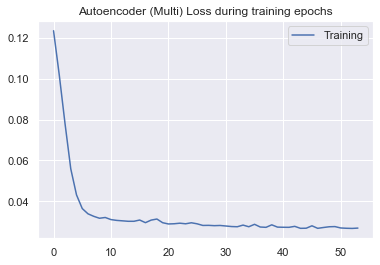

0.026902420159715872


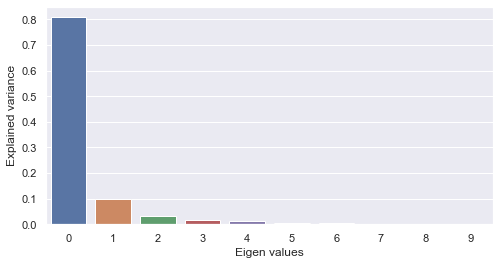

PCA on single-modal explained variance ratio: 0.9888279438018799


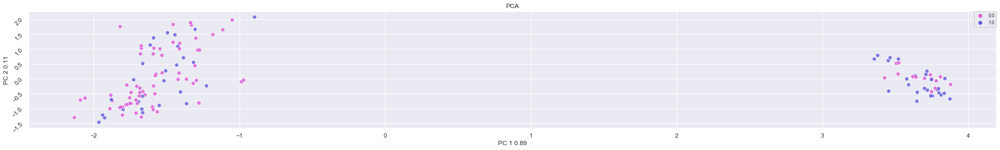

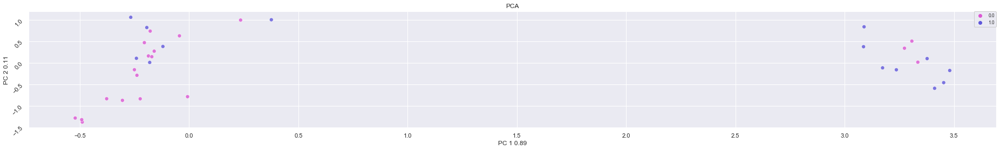

Results for DAE: 

Best score for training data: 0.6846153846153846 

Best C: 0.08 



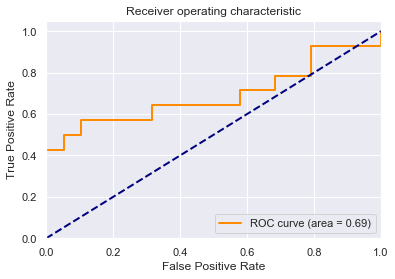

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for Logistic Regression: 0.692308
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.6923076923076923 

Best C: 1.0 

Best Gamma: 0.1 



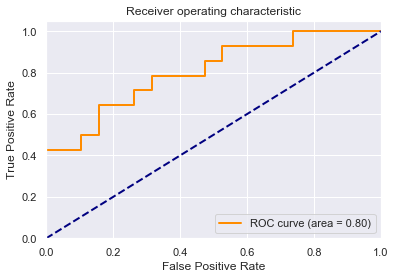

[[16  3]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.70      0.84      0.76        19
           1       0.70      0.50      0.58        14

    accuracy                           0.70        33
   macro avg       0.70      0.67      0.67        33
weighted avg       0.70      0.70      0.69        33

Training set score for SVM: 0.715385
Testing  set score for SVM: 0.696970
Best score for training data: 0.6923076923076923 

Best #estimators: 140 

Best max depth: None 



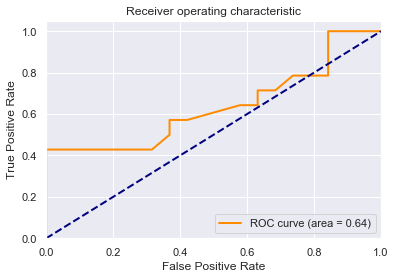

[[17  2]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.68      0.89      0.77        19
           1       0.75      0.43      0.55        14

    accuracy                           0.70        33
   macro avg       0.72      0.66      0.66        33
weighted avg       0.71      0.70      0.68        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.696970


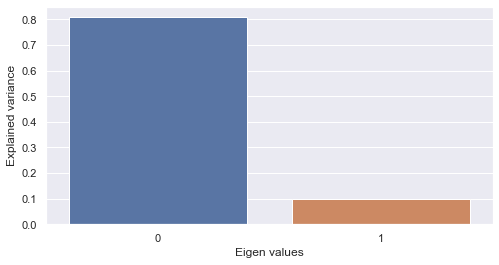

PCA on single-modal explained variance ratio: 0.9089135527610779


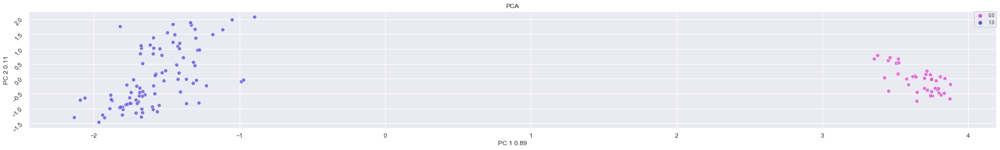

2 clusters -  silhoutte score: 0.7160478234291077 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5354661345481873 - mutual information: 0.061597789740810156
4 clusters -  silhoutte score: 0.47805628180503845 - mutual information: 0.05396496491472708


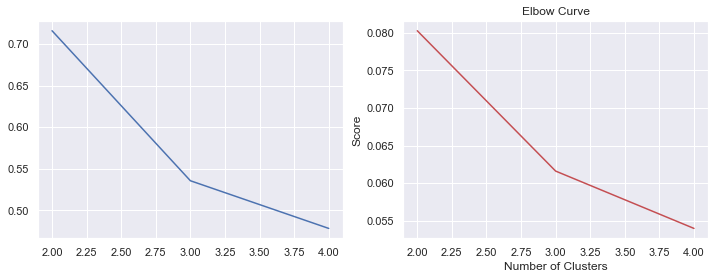

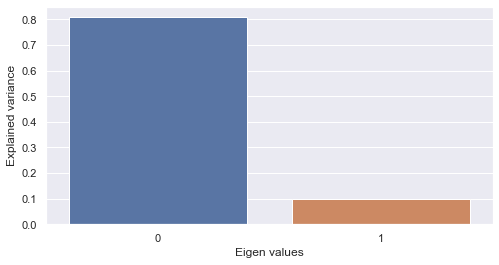

PCA on single-modal explained variance ratio: 0.9089135527610779


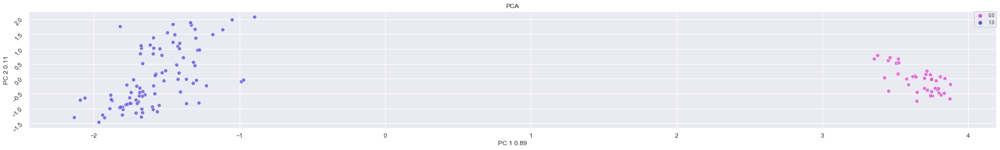

2 clusters -  silhoutte score: 0.7160478234291077 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5350770950317383 - mutual information: 0.06062621100735738
4 clusters -  silhoutte score: 0.42484527826309204 - mutual information: 0.0596824971910398


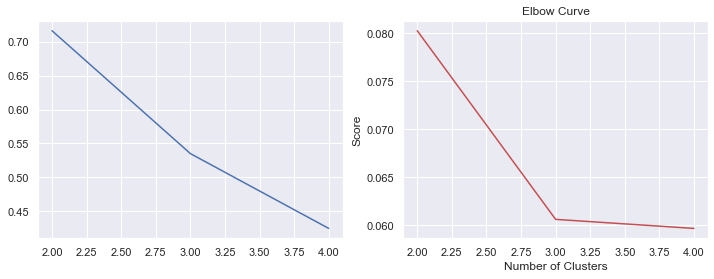

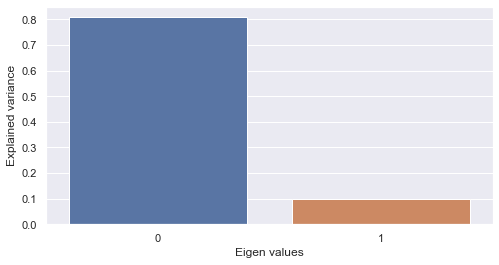

PCA on single-modal explained variance ratio: 0.9089135527610779


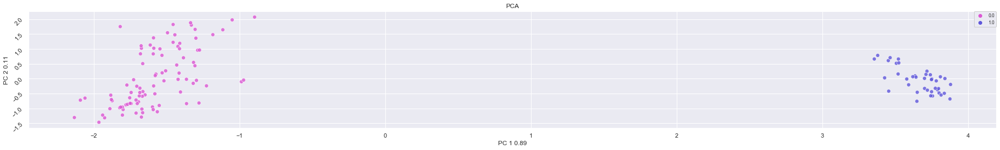

2 clusters -  silhoutte score: 0.7160478234291077 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5067042708396912 - mutual information: 0.05880334000893399
4 clusters -  silhoutte score: 0.47593045234680176 - mutual information: 0.056089618805012086


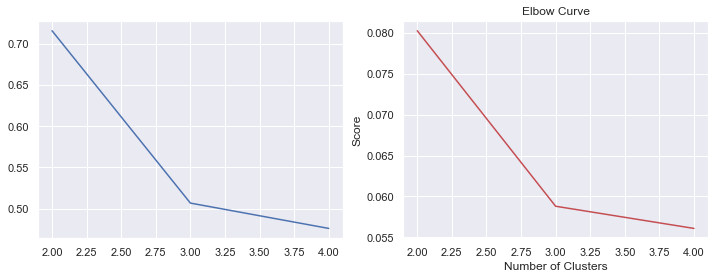

Compression: 86.93

Epoch 00080: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00088: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00097: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00102: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00102: early stopping


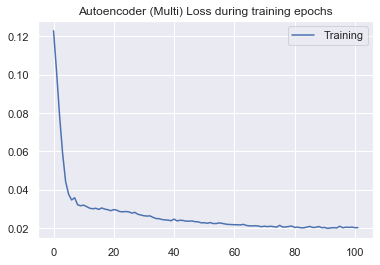

0.0202584437166269


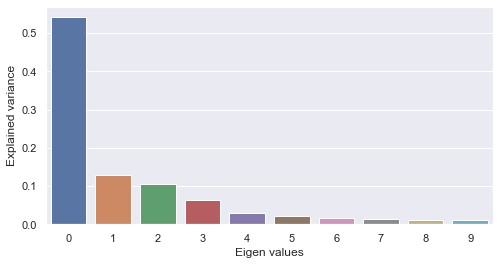

PCA on single-modal explained variance ratio: 0.9455143809318542


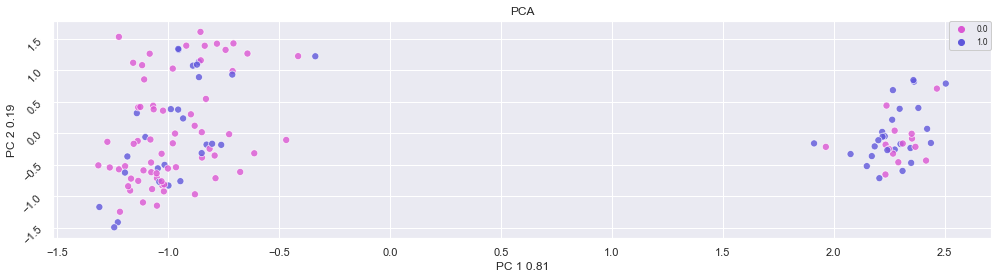

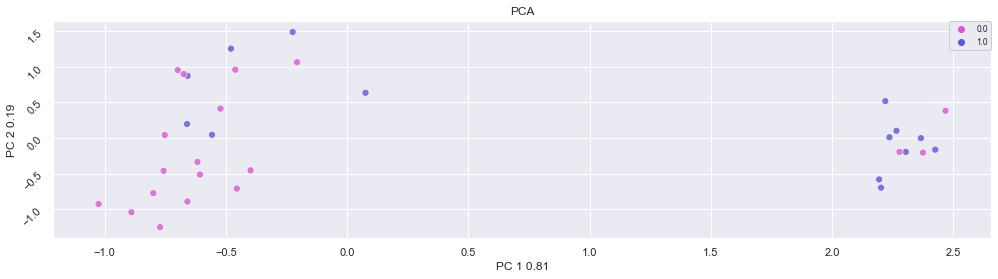

Results for DAE: 

Best score for training data: 0.6923076923076924 

Best C: 0.08 



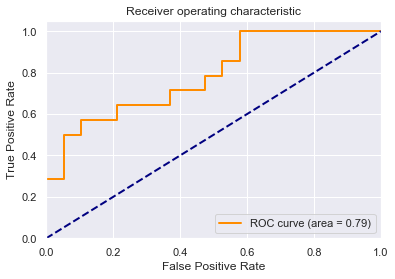

[[17  2]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.74      0.89      0.81        19
           1       0.80      0.57      0.67        14

    accuracy                           0.76        33
   macro avg       0.77      0.73      0.74        33
weighted avg       0.76      0.76      0.75        33

Training set score for Logistic Regression: 0.692308
Testing  set score for Logistic Regression: 0.757576
Best score for training data: 0.7 

Best C: 1.0 

Best Gamma: 0.1 



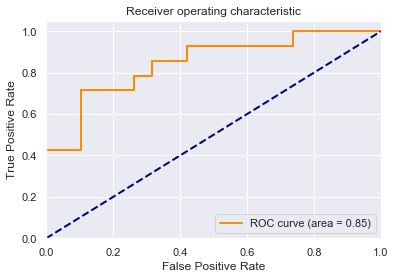

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for SVM: 0.723077
Testing  set score for SVM: 0.727273
Best score for training data: 0.7230769230769231 

Best #estimators: 140 

Best max depth: None 



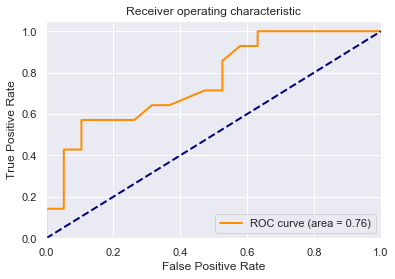

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.727273


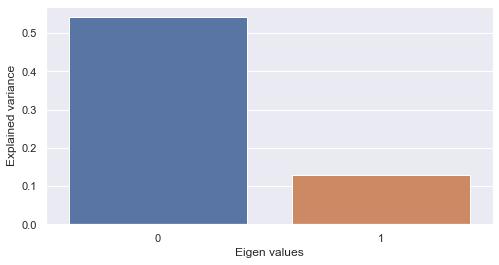

PCA on single-modal explained variance ratio: 0.6705537438392639


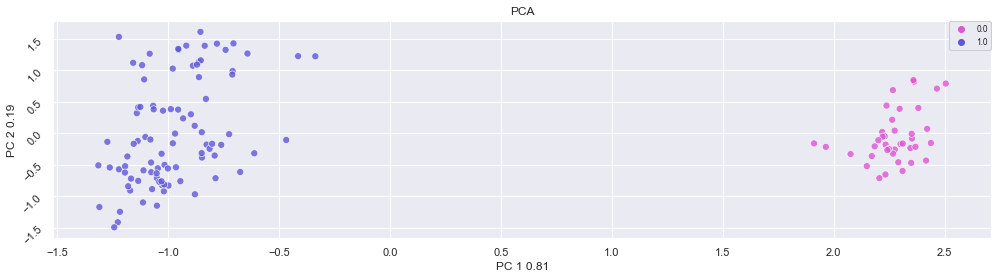

2 clusters -  silhoutte score: 0.49753183126449585 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.3346402645111084 - mutual information: 0.06141368889910484
4 clusters -  silhoutte score: 0.3216310739517212 - mutual information: 0.0939235573397944


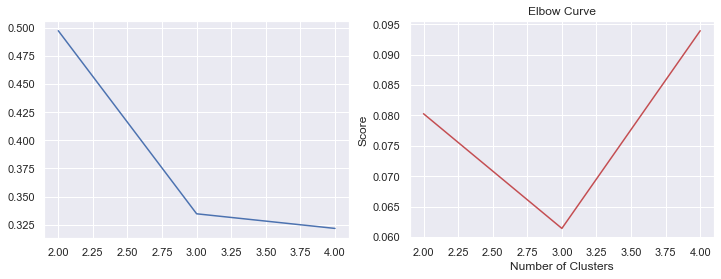

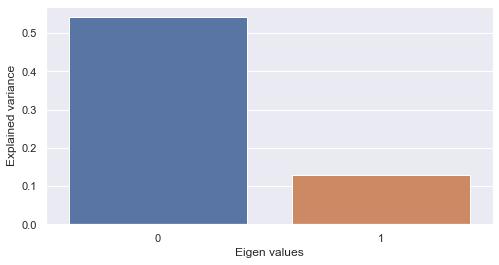

PCA on single-modal explained variance ratio: 0.6705537438392639


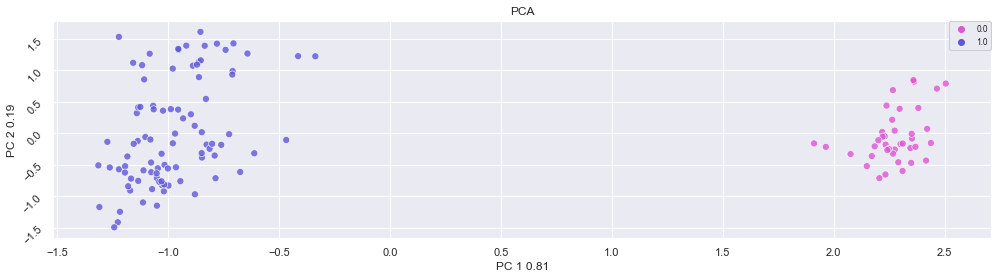

2 clusters -  silhoutte score: 0.49753183126449585 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.342649906873703 - mutual information: 0.06028928045196466
4 clusters -  silhoutte score: 0.25528159737586975 - mutual information: 0.05654033742942771


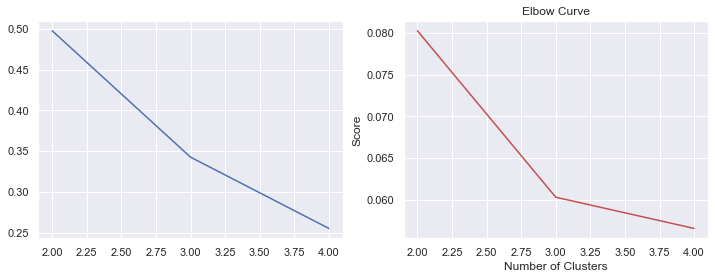

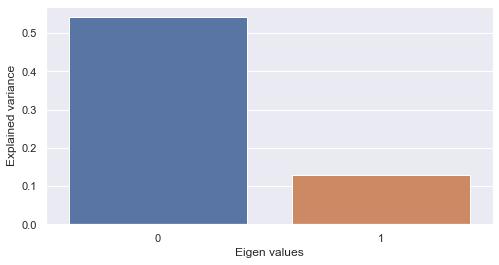

PCA on single-modal explained variance ratio: 0.6705537438392639


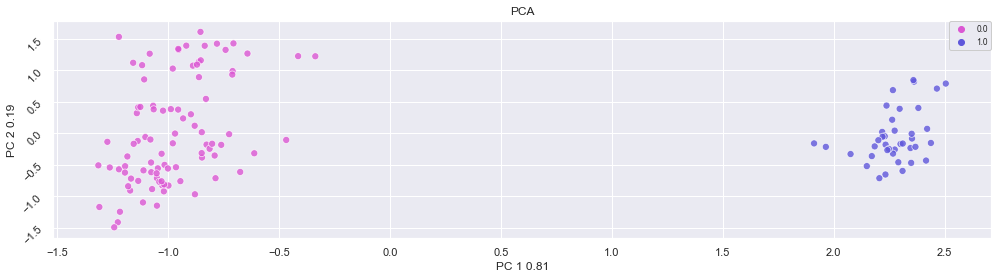

2 clusters -  silhoutte score: 0.49753183126449585 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.3381032645702362 - mutual information: 0.060139855778618655
4 clusters -  silhoutte score: 0.316092848777771 - mutual information: 0.08743860171723701


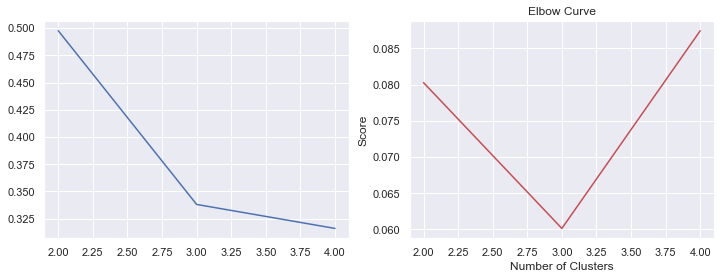

Compression: 86.93

Epoch 00064: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00073: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00082: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00087: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00087: early stopping


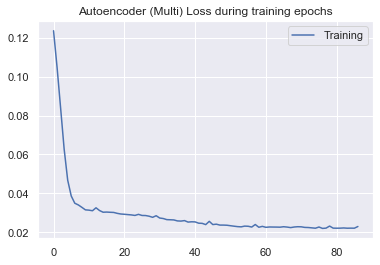

0.022926621712171115


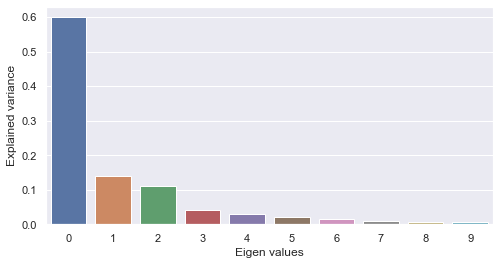

PCA on single-modal explained variance ratio: 0.9853744506835938


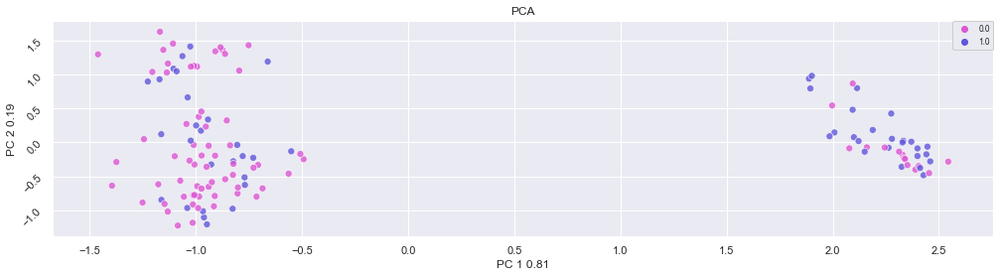

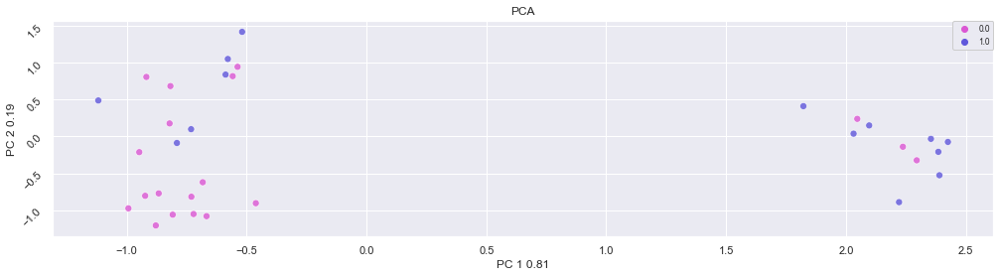

Results for DAE: 

Best score for training data: 0.7076923076923078 

Best C: 0.08 



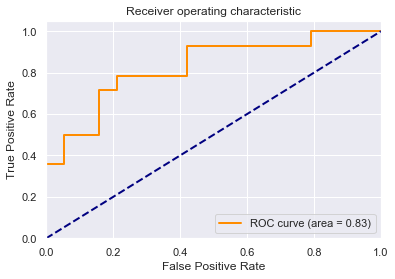

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for Logistic Regression: 0.700000
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.7076923076923076 

Best C: 1.0 

Best Gamma: 0.1 



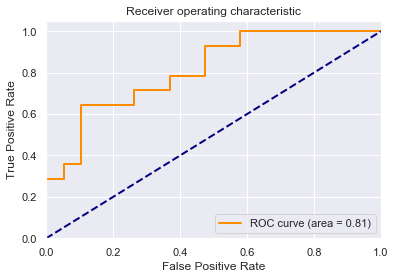

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for SVM: 0.723077
Testing  set score for SVM: 0.727273
Best score for training data: 0.7307692307692308 

Best #estimators: 140 

Best max depth: None 



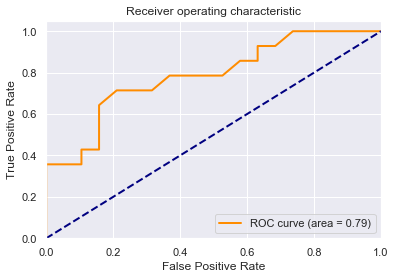

[[17  2]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.68      0.89      0.77        19
           1       0.75      0.43      0.55        14

    accuracy                           0.70        33
   macro avg       0.72      0.66      0.66        33
weighted avg       0.71      0.70      0.68        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.696970


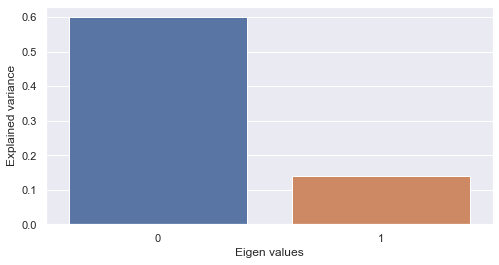

PCA on single-modal explained variance ratio: 0.7405238747596741


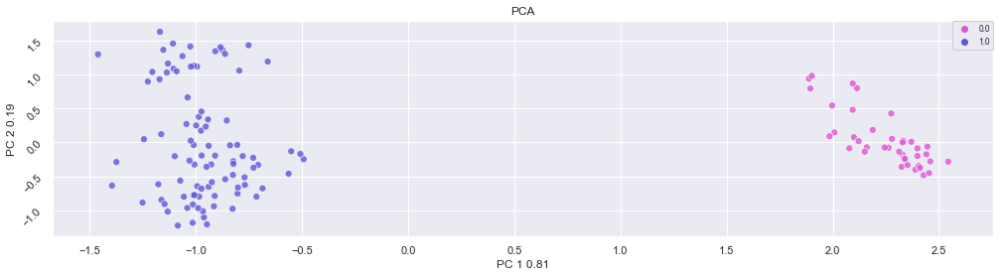

2 clusters -  silhoutte score: 0.5577152371406555 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.42999154329299927 - mutual information: 0.06119372019553096
4 clusters -  silhoutte score: 0.3709259033203125 - mutual information: 0.08744302269839044


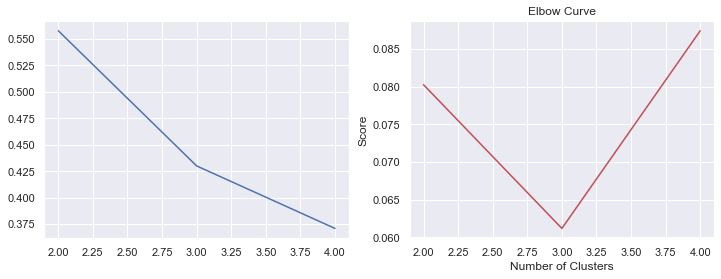

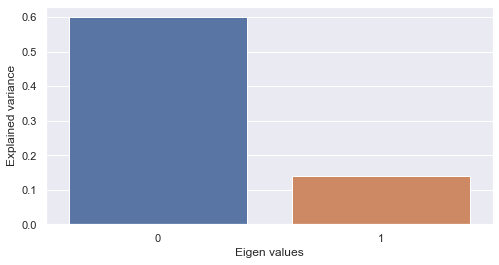

PCA on single-modal explained variance ratio: 0.7405238747596741


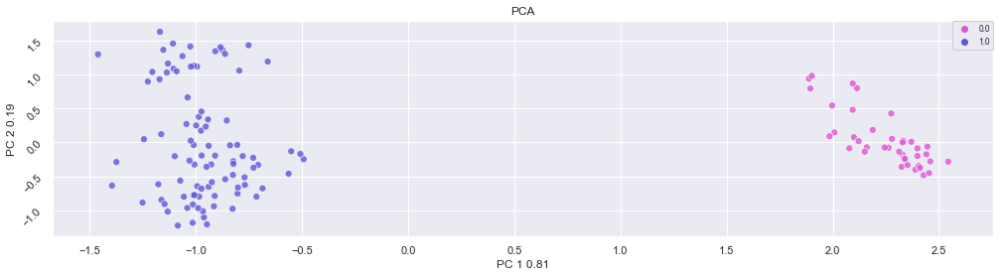

2 clusters -  silhoutte score: 0.5577152371406555 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.4907180368900299 - mutual information: 0.07743602126435377
4 clusters -  silhoutte score: 0.37549206614494324 - mutual information: 0.06096959754559556


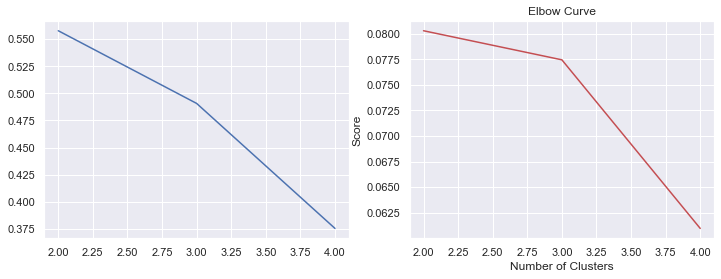

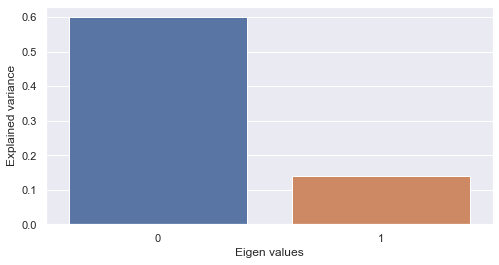

PCA on single-modal explained variance ratio: 0.7405238747596741


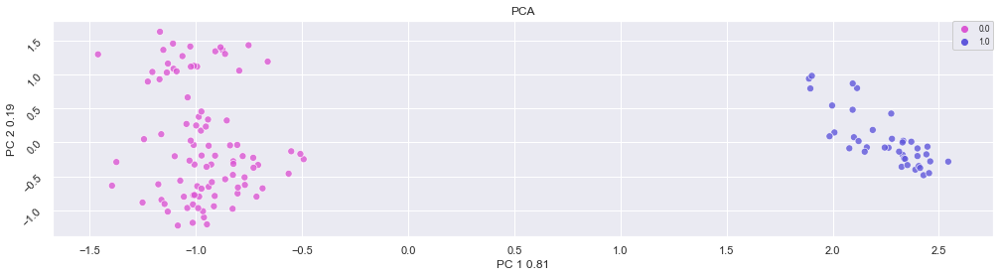

2 clusters -  silhoutte score: 0.5577152371406555 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.43182262778282166 - mutual information: 0.06140168518413852
4 clusters -  silhoutte score: 0.3726990222930908 - mutual information: 0.08784779793289645


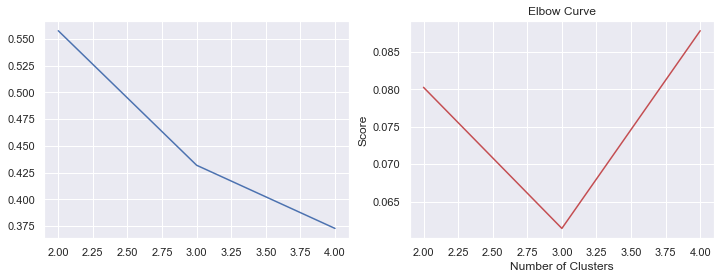

Compression: 86.93

Epoch 00069: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00078: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00085: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00090: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00095: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.
Epoch 00097: early stopping


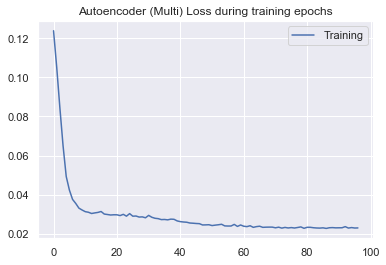

0.02298684260593011


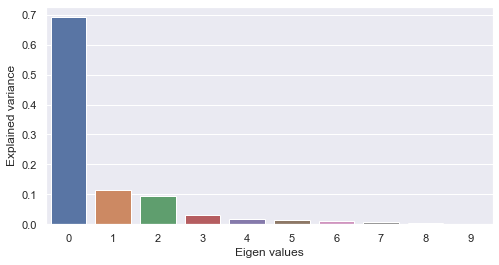

PCA on single-modal explained variance ratio: 0.9898523092269897


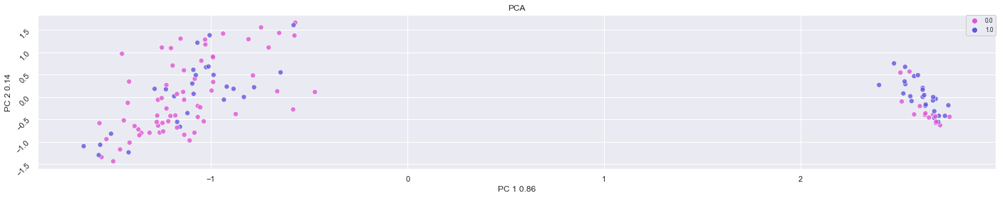

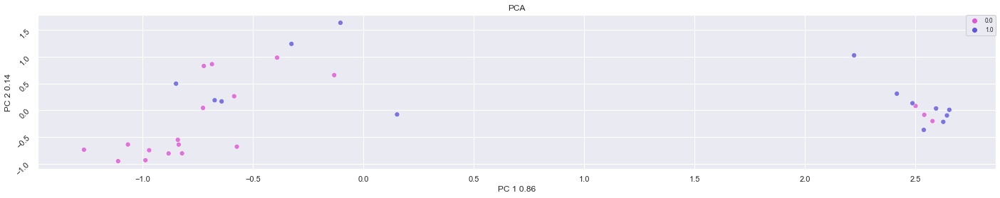

Results for DAE: 

Best score for training data: 0.7076923076923078 

Best C: 0.08 



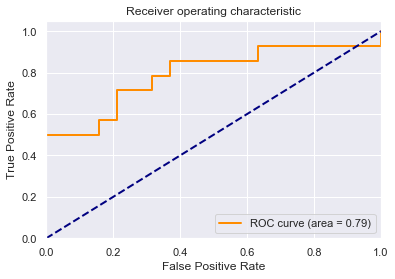

[[16  3]
 [ 6  8]]


              precision    recall  f1-score   support

           0       0.73      0.84      0.78        19
           1       0.73      0.57      0.64        14

    accuracy                           0.73        33
   macro avg       0.73      0.71      0.71        33
weighted avg       0.73      0.73      0.72        33

Training set score for Logistic Regression: 0.692308
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.7153846153846155 

Best C: 1.0 

Best Gamma: 0.1 



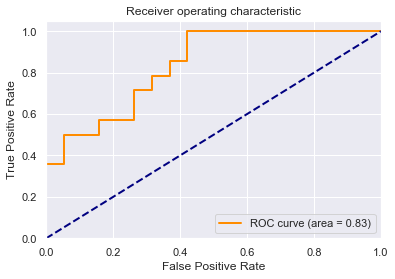

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for SVM: 0.730769
Testing  set score for SVM: 0.727273
Best score for training data: 0.6846153846153846 

Best #estimators: 140 

Best max depth: None 



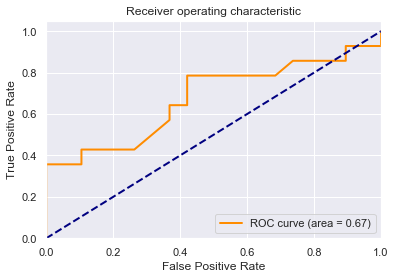

[[14  5]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.64      0.74      0.68        19
           1       0.55      0.43      0.48        14

    accuracy                           0.61        33
   macro avg       0.59      0.58      0.58        33
weighted avg       0.60      0.61      0.60        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.606061


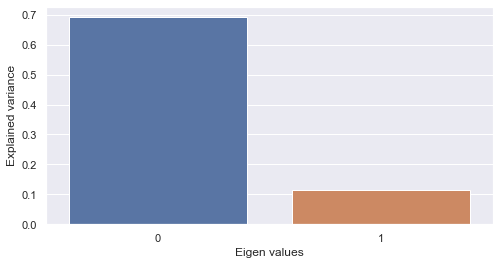

PCA on single-modal explained variance ratio: 0.806369423866272


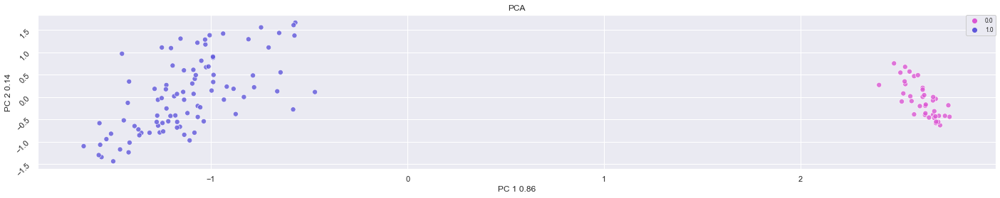

2 clusters -  silhoutte score: 0.6183772087097168 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.419325590133667 - mutual information: 0.05965980309830582
4 clusters -  silhoutte score: 0.4223918616771698 - mutual information: 0.05834621488735412


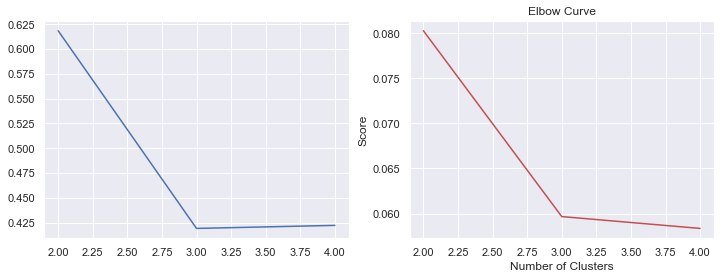

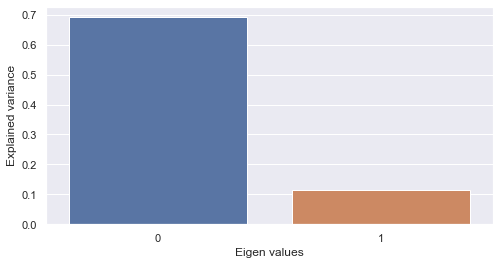

PCA on single-modal explained variance ratio: 0.806369423866272


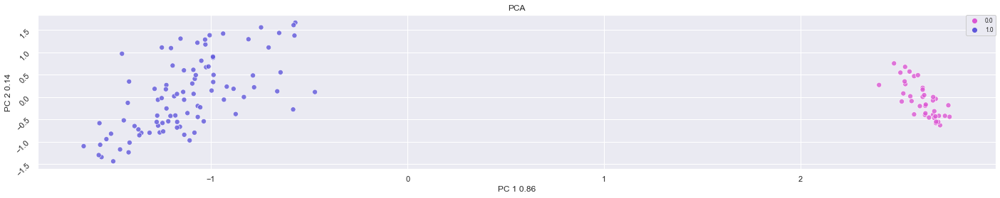

2 clusters -  silhoutte score: 0.6183772087097168 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.425822377204895 - mutual information: 0.06028928045196466
4 clusters -  silhoutte score: 0.3550642728805542 - mutual information: 0.09246129194291874


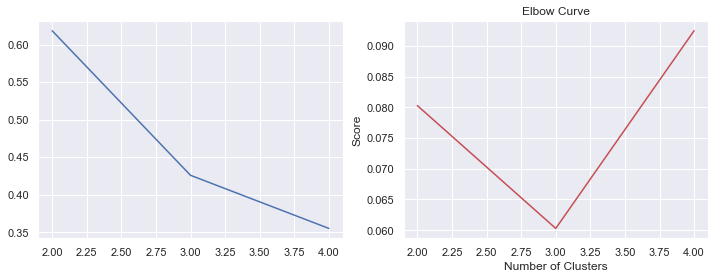

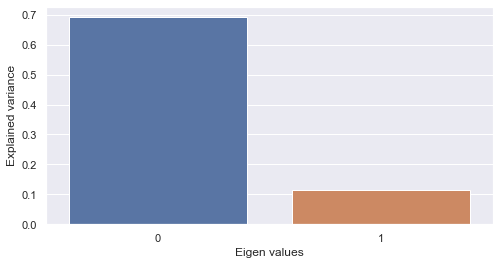

PCA on single-modal explained variance ratio: 0.806369423866272


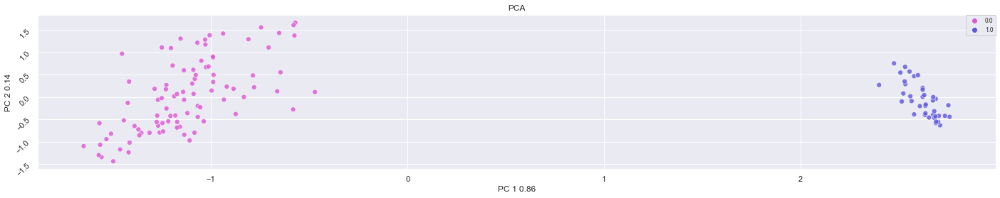

2 clusters -  silhoutte score: 0.6183772087097168 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.38743507862091064 - mutual information: 0.06083403098465118
4 clusters -  silhoutte score: 0.3890576660633087 - mutual information: 0.05980293308037401


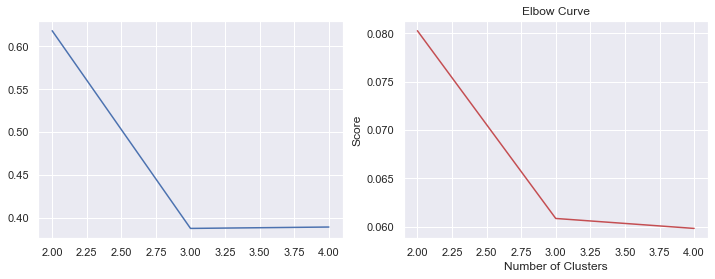

Compression: 86.93

Epoch 00066: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00075: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00080: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.
Epoch 00080: early stopping


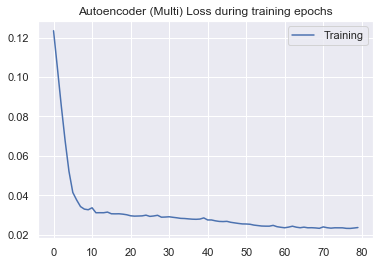

0.023563295889359254


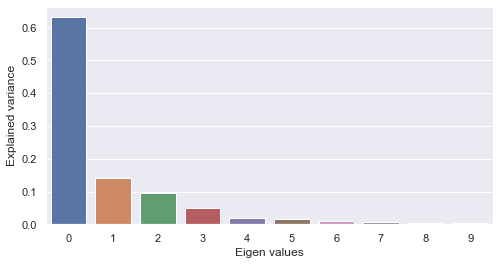

PCA on single-modal explained variance ratio: 0.9812508225440979


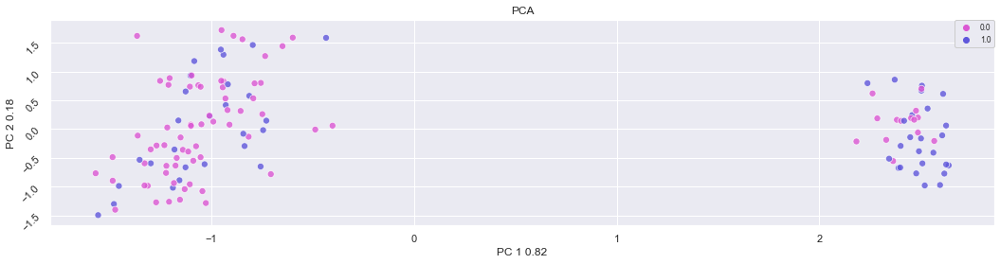

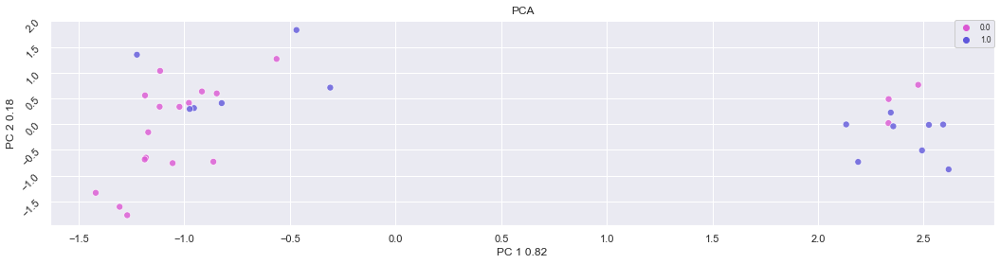

Results for DAE: 

Best score for training data: 0.7000000000000001 

Best C: 0.08 



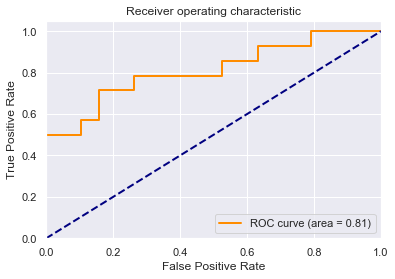

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for Logistic Regression: 0.707692
Testing  set score for Logistic Regression: 0.727273
Best score for training data: 0.7153846153846153 

Best C: 1.0 

Best Gamma: 0.1 



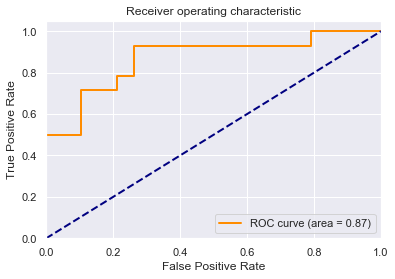

[[18  1]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.72      0.95      0.82        19
           1       0.88      0.50      0.64        14

    accuracy                           0.76        33
   macro avg       0.80      0.72      0.73        33
weighted avg       0.79      0.76      0.74        33

Training set score for SVM: 0.723077
Testing  set score for SVM: 0.757576
Best score for training data: 0.6538461538461539 

Best #estimators: 140 

Best max depth: None 



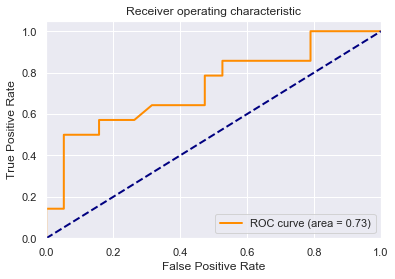

[[16  3]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.70      0.84      0.76        19
           1       0.70      0.50      0.58        14

    accuracy                           0.70        33
   macro avg       0.70      0.67      0.67        33
weighted avg       0.70      0.70      0.69        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.696970


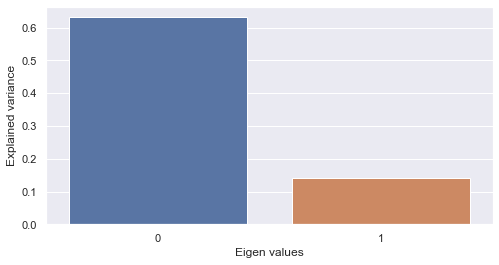

PCA on single-modal explained variance ratio: 0.7730492353439331


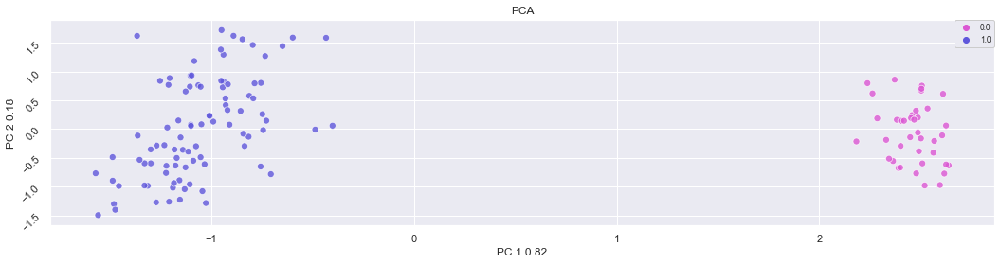

2 clusters -  silhoutte score: 0.5770623087882996 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.3973204493522644 - mutual information: 0.06040346123238548
4 clusters -  silhoutte score: 0.3413660526275635 - mutual information: 0.0942361840602757


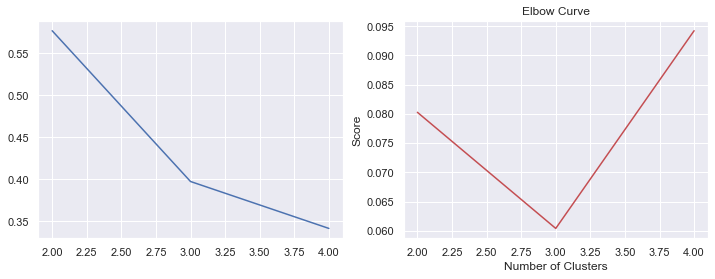

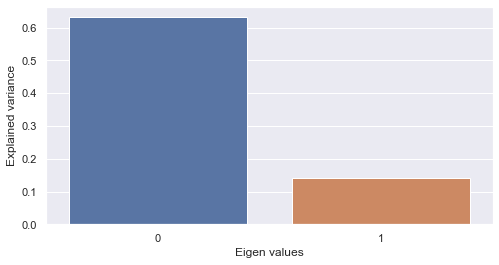

PCA on single-modal explained variance ratio: 0.7730492353439331


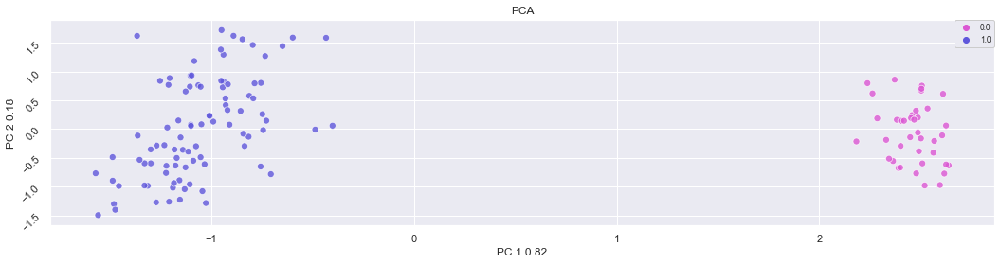

2 clusters -  silhoutte score: 0.5770623087882996 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.5137549638748169 - mutual information: 0.1329966902448754
4 clusters -  silhoutte score: 0.361036092042923 - mutual information: 0.10532546636930304


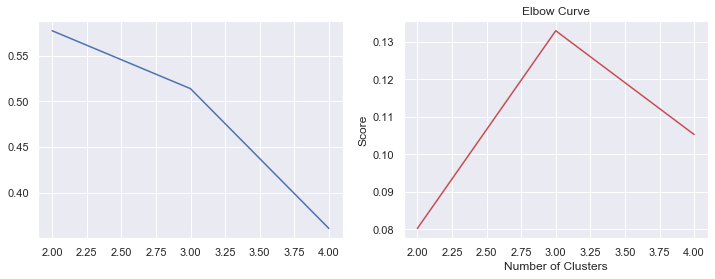

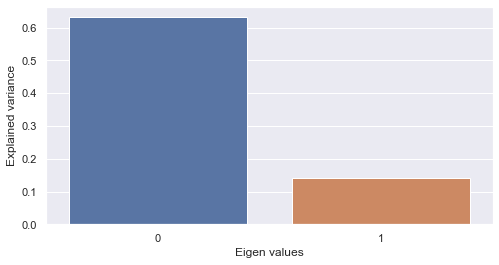

PCA on single-modal explained variance ratio: 0.7730492353439331


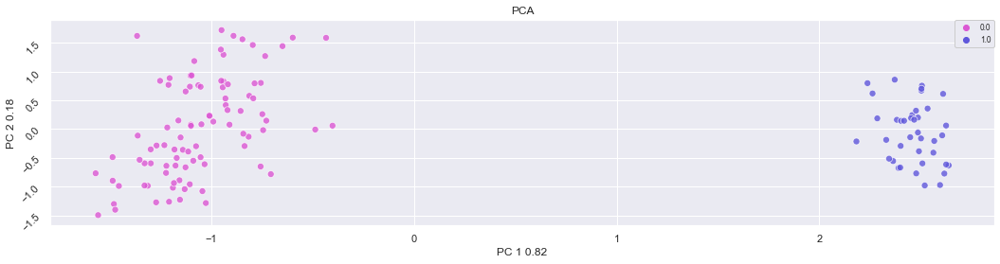

2 clusters -  silhoutte score: 0.5770623087882996 - mutual information: 0.08027624683129161
3 clusters -  silhoutte score: 0.41155147552490234 - mutual information: 0.061085321523635716
4 clusters -  silhoutte score: 0.36573198437690735 - mutual information: 0.05104075678180625


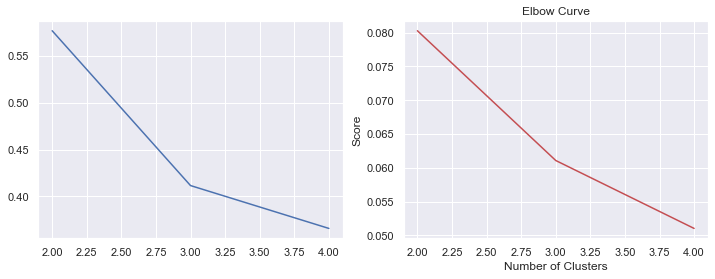

In [12]:
###  Hyperparameter tuning

encoding_dims=[100]
mus=[0.2]
dropouts = [0.25]
l1s = [0.0000001]
l2s = [0.0000005]
scores = []
for encoding_dim in encoding_dims:
    for mu in mus:
        for dropout in dropouts:
            for l1 in l1s:
                for l2 in l2s:
                    ## Build and Train Autoencoder
                    autoencoder, encoder, decoder, loss = Models.build_and_train_multi_autoencoder([X_swapped_first_norm,X_swapped_second_norm],
                                                                                  [X_train_first_norm,X_train_second_norm],
                                                                                  encoding_dim=encoding_dim, 
                                                                                  regularizer=tf.keras.regularizers.l1_l2(l1,l2),
                                                                                  dropout=dropout,
                                                                                  epochs=200,
                                                                                  mu=mu)
                    ## Encode datasets
                    X_latent_multi_ae = Models.encode_dataset([X_train_first_norm,X_train_second_norm], encoder)
                    X_latent_test_multi_ae = Models.encode_dataset([X_test_first_norm,X_test_second_norm], encoder)

                    ## PCA ON AUTOENCODER LATENT SPACE
                    X_latent_pca_ae, X_latent_test_pca_ae = Models.perform_PCA(X_latent_multi_ae,y_train, X_latent_test_multi_ae, y_test, n_components=10)

                    ### CLASSIFICATION ###
                    classify = Models.classify(X_latent_multi_ae, X_latent_test_multi_ae, np.ravel(y_train), np.ravel(y_test), model_type="DAE")

                    ### CLUSTERING ###
                    clustering = Models.cluster(X_latent_multi_ae,np.ravel(y_train), model_type="Multi-DAE")

                    scores.append([mu,dropout,l1,l2,loss] + classify + clustering)

In [13]:
scores = pd.DataFrame(scores,
                      columns=["mu","dropout","l1","l2","loss","LR accuracy","SVM accuracy", "RF accuracy", "LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC","KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette","KMeans MI","Spectral MI","Hierarchical MI"])    
display(scores)
print(f"Random classifier: {y_test.iloc[:,0].value_counts()[0]/len(y_test)}")

,mu,dropout,l1,l2,loss,LR accuracy,SVM accuracy,RF accuracy,LR ROC-AUC,SVM ROC-AUC,RF ROC-AUC,KMeans Silhouette,Spectral Silhouette,Hierarchical Silhouette,KMeans MI,Spectral MI,Hierarchical MI
0,0.2,0.00,1.000000e-07,5.000000e-07,0.010382,0.696970,0.696970,0.696970,0.740602,0.766917,0.736842,0.273219,0.273219,0.273219,0.080583,0.087848,0.072872
1,0.2,0.05,1.000000e-07,5.000000e-07,0.017098,0.696970,0.727273,0.757576,0.721805,0.766917,0.676692,0.428837,0.428837,0.428837,0.079965,0.104969,0.072307
2,0.2,0.10,1.000000e-07,5.000000e-07,0.015691,0.696970,0.727273,0.727273,0.789474,0.781955,0.795113,0.298687,0.298687,0.298687,0.074564,0.077289,0.095791
3,0.2,0.15,1.000000e-07,5.000000e-07,0.020148,0.727273,0.727273,0.636364,0.823308,0.887218,0.780075,0.472331,0.472331,0.472331,0.066095,0.060210,0.056969
4,0.2,0.20,1.000000e-07,5.000000e-07,0.026902,0.727273,0.696970,0.696970,0.691729,0.804511,0.637218,0.716048,0.716048,0.716048,0.053965,0.059682,0.056090
5,0.2,0.25,1.000000e-07,5.000000e-07,0.020258,0.757576,0.727273,0.727273,0.785714,0.845865,0.759398,0.497532,0.497532,0.497532,0.093924,0.056540,0.087439
6,0.2,0.30,1.000000e-07,5.000000e-07,0.022927,0.727273,0.727273,0.696970,0.827068,0.812030,0.785714,0.557715,0.557715,0.557715,0.087443,0.060970,0.087848
7,0.2,0.35,1.000000e-07,5.000000e-07,0.022987,0.727273,0.727273,0.606061,0.793233,0.834586,0.674812,0.618377,0.618377,0.618377,0.058346,0.092461,0.059803
8,0.2,0.40,1.000000e-07,5.000000e-07,0.023563,0.727273,0.757576,0.696970,0.812030,0.868421,0.731203,0.577062,0.577062,0.577062,0.094236,0.105325,0.051041


Random classifier: 0.5757575757575758


C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:376: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(new_indexer, value)
C:\Users\Tomas\Anaconda3\envs\tensorflow_2\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the docume

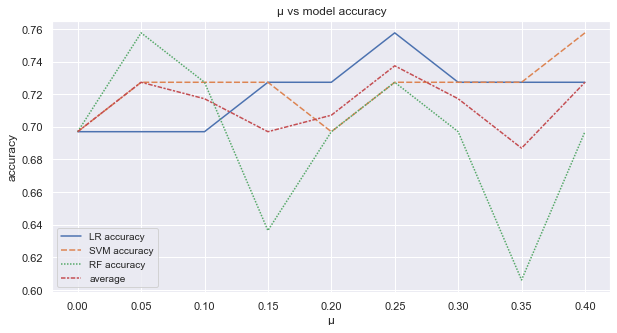

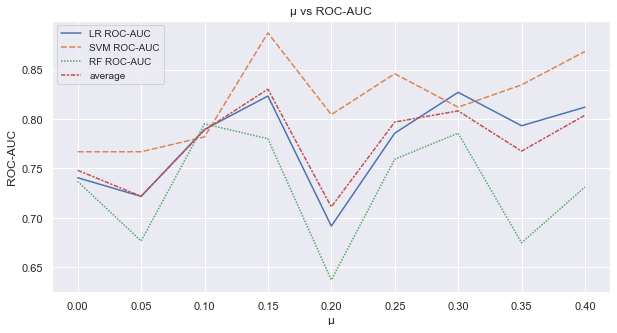

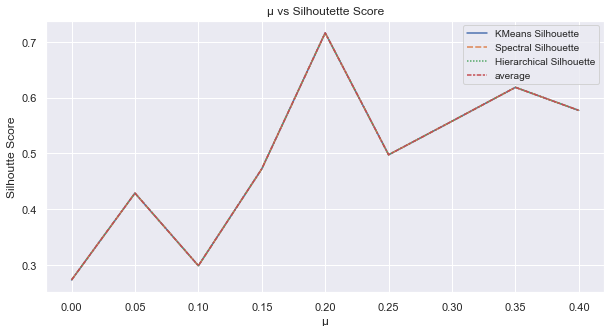

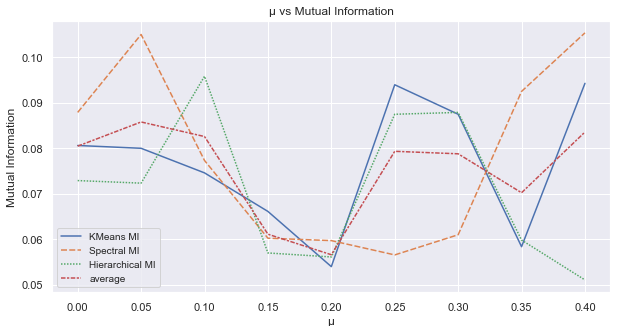

In [15]:
scores.index = dropouts

data_acc = scores[["LR accuracy","SVM accuracy","RF accuracy"]]
data_acc.loc[:,"average"] = data_acc.mean(axis=1)

data_auc = scores[["LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC"]]
data_auc.loc[:,"average"] = data_auc.mean(axis=1)

data_ss = scores[["KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette"]]
data_ss.loc[:,"average"] = data_ss.mean(axis=1)

data_mi = scores[["KMeans MI","Spectral MI","Hierarchical MI"]]
data_mi.loc[:,"average"] = data_mi.mean(axis=1)

sns.set()
hyperparam = "μ"

ax = sns.lineplot(data=data_acc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"accuracy")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs model accuracy")
plt.show()

ax = sns.lineplot(data=data_auc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"ROC-AUC")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs ROC-AUC")
plt.show()

ax = sns.lineplot(data=data_ss)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Silhoutte Score")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Silhoutette Score")
plt.show()

ax = sns.lineplot(data=data_mi)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Mutual Information")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Mutual Information")
plt.show()

Compression: 51.18

Epoch 00036: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00044: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00053: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00059: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00064: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.
Epoch 00064: early stopping


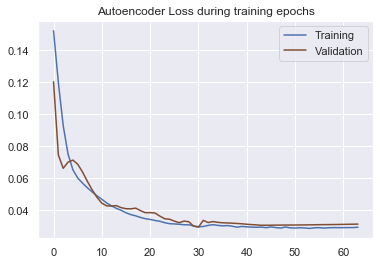

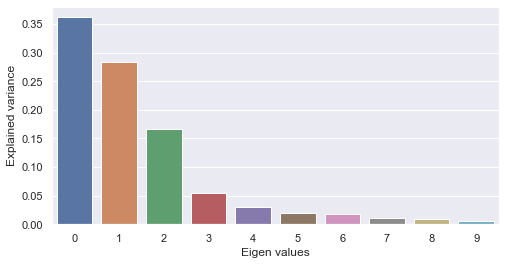

PCA on single-modal explained variance ratio: 0.9618922472000122


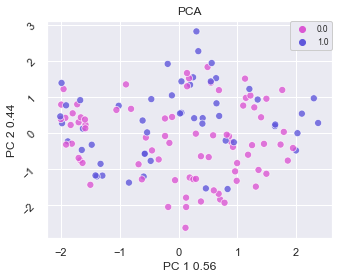

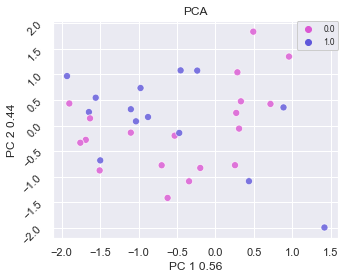

Results for AE: 

Best score for training data: 0.6538461538461539 

Best C: 0.08 



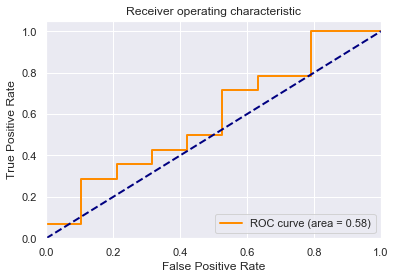

[[17  2]
 [13  1]]


              precision    recall  f1-score   support

           0       0.57      0.89      0.69        19
           1       0.33      0.07      0.12        14

    accuracy                           0.55        33
   macro avg       0.45      0.48      0.41        33
weighted avg       0.47      0.55      0.45        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.545455
Best score for training data: 0.6153846153846153 

Best C: 1.0 

Best Gamma: 0.1 



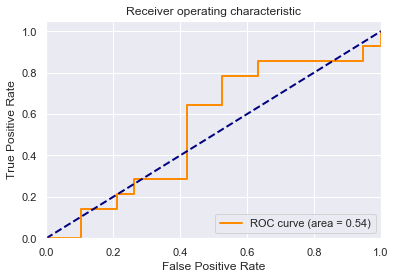

[[17  2]
 [13  1]]


              precision    recall  f1-score   support

           0       0.57      0.89      0.69        19
           1       0.33      0.07      0.12        14

    accuracy                           0.55        33
   macro avg       0.45      0.48      0.41        33
weighted avg       0.47      0.55      0.45        33

Training set score for SVM: 0.684615
Testing  set score for SVM: 0.545455
Best score for training data: 0.623076923076923 

Best #estimators: 100 

Best max depth: 12 



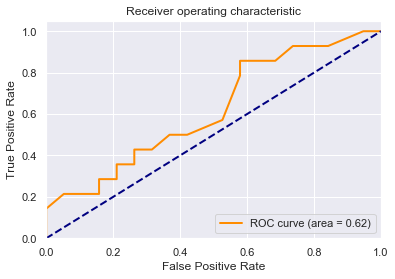

[[14  5]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.64      0.74      0.68        19
           1       0.55      0.43      0.48        14

    accuracy                           0.61        33
   macro avg       0.59      0.58      0.58        33
weighted avg       0.60      0.61      0.60        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.606061


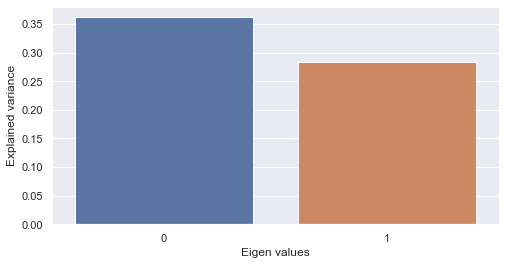

PCA on single-modal explained variance ratio: 0.6449639201164246


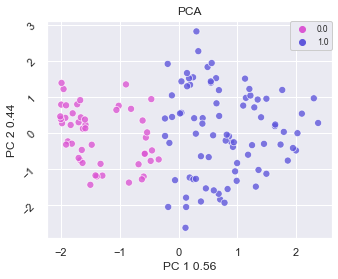

2 clusters -  silhoutte score: 0.2517337203025818 - mutual information: 0.006203597272968524
3 clusters -  silhoutte score: 0.2692885994911194 - mutual information: 0.04268343112143932
4 clusters -  silhoutte score: 0.275930792093277 - mutual information: 0.03319826775571358


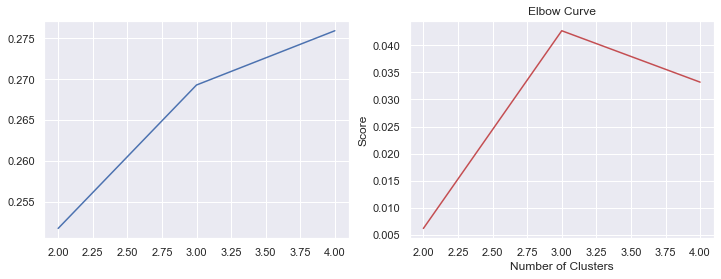

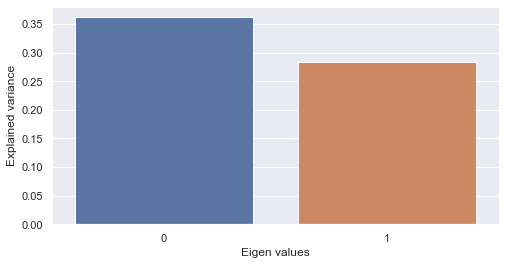

PCA on single-modal explained variance ratio: 0.6449639201164246


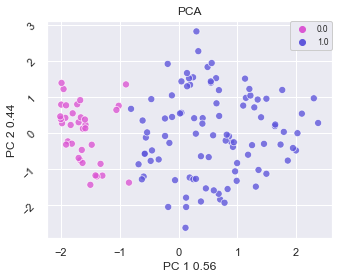

2 clusters -  silhoutte score: 0.25850221514701843 - mutual information: 0.0009936031808598022
3 clusters -  silhoutte score: 0.25980958342552185 - mutual information: 0.045251584208318436
4 clusters -  silhoutte score: 0.2562200129032135 - mutual information: 0.0572364928934097


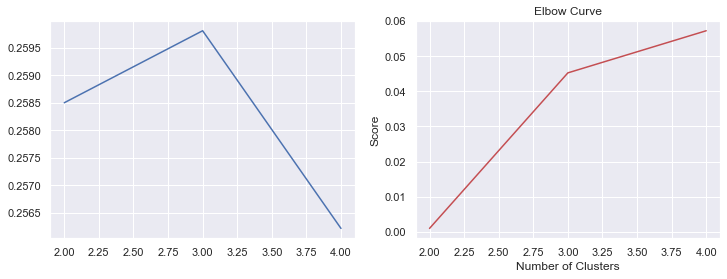

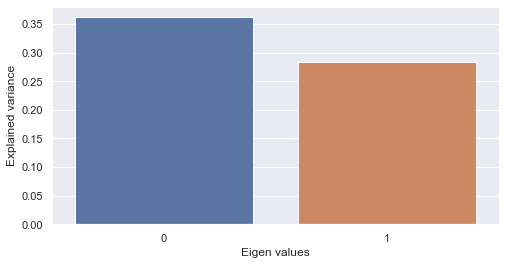

PCA on single-modal explained variance ratio: 0.6449639201164246


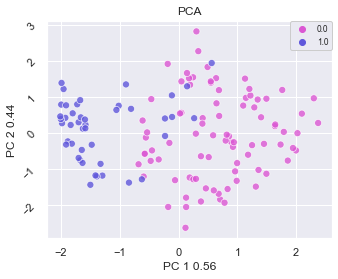

2 clusters -  silhoutte score: 0.23928962647914886 - mutual information: 0.0001340206025120392
3 clusters -  silhoutte score: 0.241177037358284 - mutual information: 0.03206159879613505
4 clusters -  silhoutte score: 0.25519847869873047 - mutual information: 0.03066442532658766


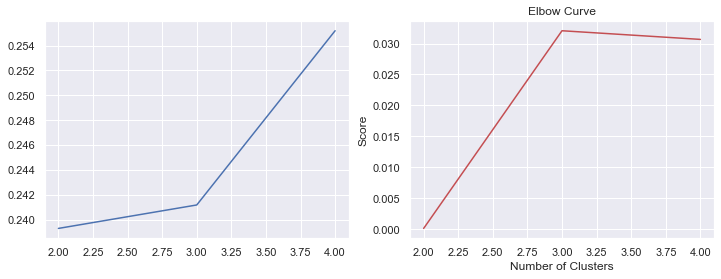

Compression: 51.18

Epoch 00065: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00070: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00071: early stopping


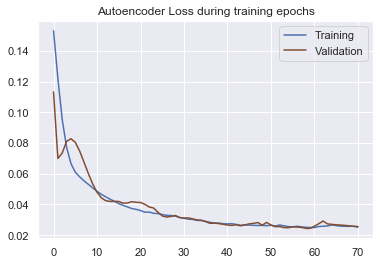

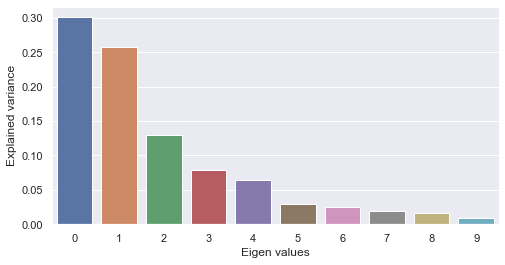

PCA on single-modal explained variance ratio: 0.9320865273475647


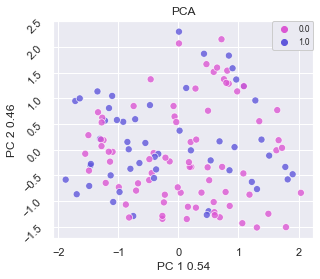

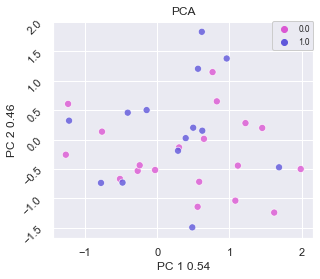

Results for AE: 

Best score for training data: 0.5923076923076922 

Best C: 0.08 



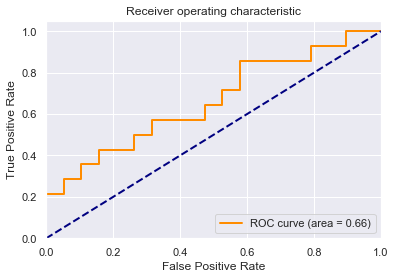

[[19  0]
 [13  1]]


              precision    recall  f1-score   support

           0       0.59      1.00      0.75        19
           1       1.00      0.07      0.13        14

    accuracy                           0.61        33
   macro avg       0.80      0.54      0.44        33
weighted avg       0.77      0.61      0.49        33

Training set score for Logistic Regression: 0.638462
Testing  set score for Logistic Regression: 0.606061
Best score for training data: 0.6 

Best C: 0.1 

Best Gamma: scale 



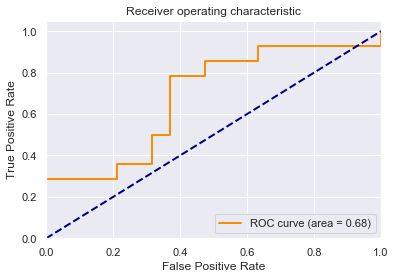

[[19  0]
 [14  0]]


              precision    recall  f1-score   support

           0       0.58      1.00      0.73        19
           1       0.00      0.00      0.00        14

    accuracy                           0.58        33
   macro avg       0.29      0.50      0.37        33
weighted avg       0.33      0.58      0.42        33

Training set score for SVM: 0.600000
Testing  set score for SVM: 0.575758


F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Best score for training data: 0.6153846153846153 

Best #estimators: 140 

Best max depth: None 



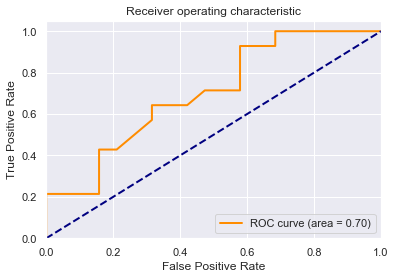

[[16  3]
 [11  3]]


              precision    recall  f1-score   support

           0       0.59      0.84      0.70        19
           1       0.50      0.21      0.30        14

    accuracy                           0.58        33
   macro avg       0.55      0.53      0.50        33
weighted avg       0.55      0.58      0.53        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.575758


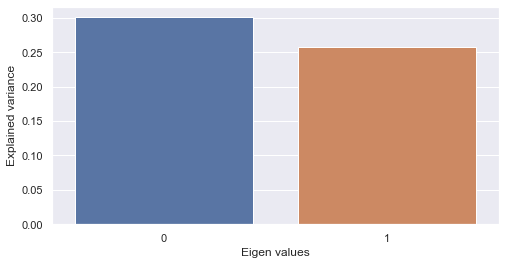

PCA on single-modal explained variance ratio: 0.5589019060134888


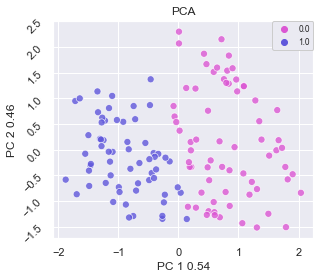

2 clusters -  silhoutte score: 0.20713770389556885 - mutual information: 0.01279335968804061
3 clusters -  silhoutte score: 0.24017024040222168 - mutual information: 0.01942570590598024
4 clusters -  silhoutte score: 0.2139609456062317 - mutual information: 0.00668822931269494


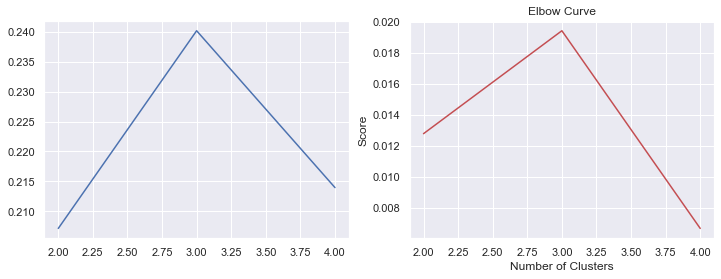

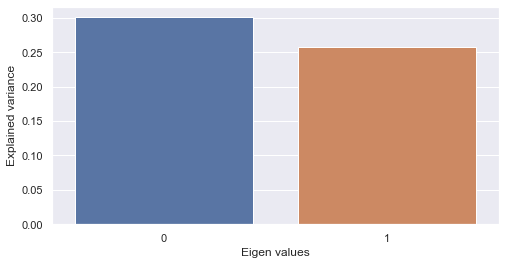

PCA on single-modal explained variance ratio: 0.5589019060134888


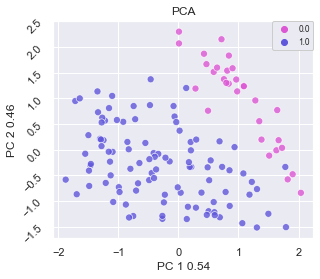

2 clusters -  silhoutte score: 0.24384914338588715 - mutual information: 0.0011530600305743753
3 clusters -  silhoutte score: 0.23612436652183533 - mutual information: 0.01974046520635263
4 clusters -  silhoutte score: 0.19485388696193695 - mutual information: 0.04173462951562452


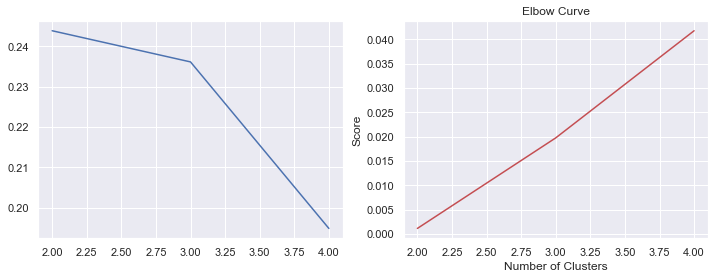

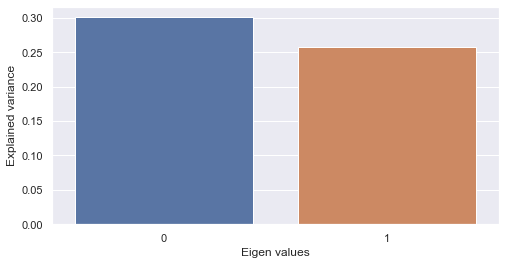

PCA on single-modal explained variance ratio: 0.5589019060134888


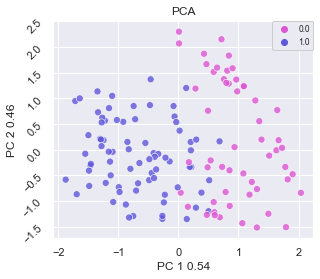

2 clusters -  silhoutte score: 0.19802266359329224 - mutual information: 0.00981504539085138
3 clusters -  silhoutte score: 0.21662132441997528 - mutual information: 0.008349146418638102
4 clusters -  silhoutte score: 0.1837221086025238 - mutual information: 0.017669153806462733


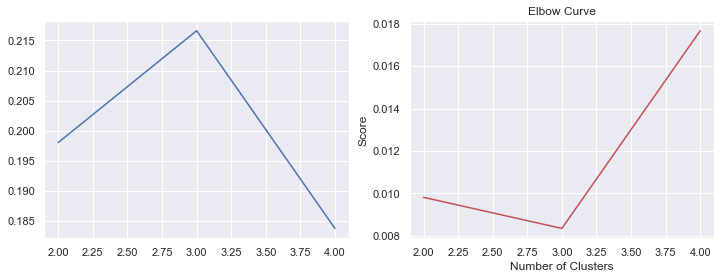

Compression: 51.18

Epoch 00070: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00075: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00075: early stopping


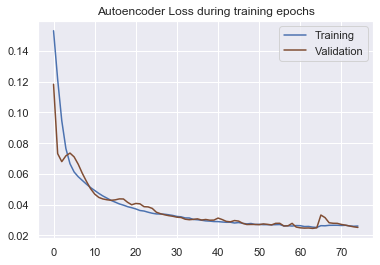

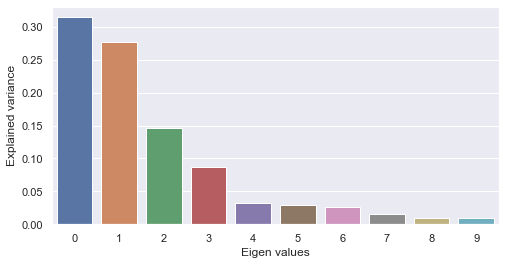

PCA on single-modal explained variance ratio: 0.9459911584854126


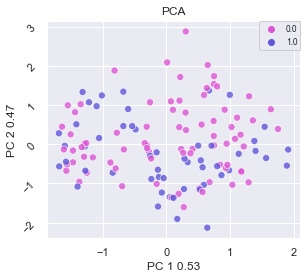

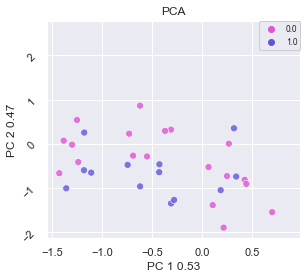

Results for AE: 

Best score for training data: 0.6384615384615385 

Best C: 0.08 



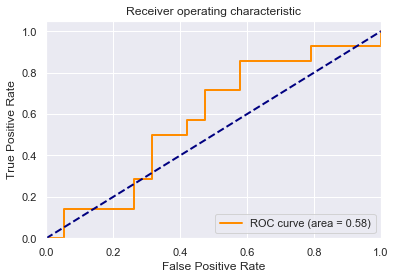

[[15  4]
 [12  2]]


              precision    recall  f1-score   support

           0       0.56      0.79      0.65        19
           1       0.33      0.14      0.20        14

    accuracy                           0.52        33
   macro avg       0.44      0.47      0.43        33
weighted avg       0.46      0.52      0.46        33

Training set score for Logistic Regression: 0.661538
Testing  set score for Logistic Regression: 0.515152
Best score for training data: 0.6153846153846154 

Best C: 1.0 

Best Gamma: 0.1 



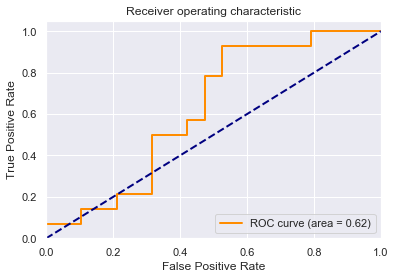

[[16  3]
 [12  2]]


              precision    recall  f1-score   support

           0       0.57      0.84      0.68        19
           1       0.40      0.14      0.21        14

    accuracy                           0.55        33
   macro avg       0.49      0.49      0.45        33
weighted avg       0.50      0.55      0.48        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.545455
Best score for training data: 0.5846153846153846 

Best #estimators: 140 

Best max depth: None 



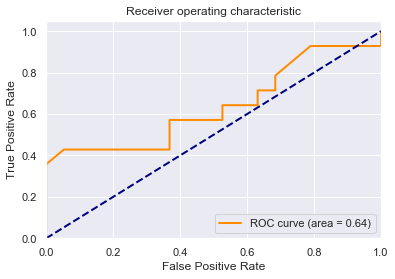

[[16  3]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.67      0.84      0.74        19
           1       0.67      0.43      0.52        14

    accuracy                           0.67        33
   macro avg       0.67      0.64      0.63        33
weighted avg       0.67      0.67      0.65        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.666667


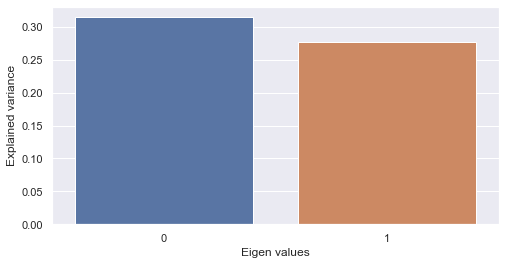

PCA on single-modal explained variance ratio: 0.5913074016571045


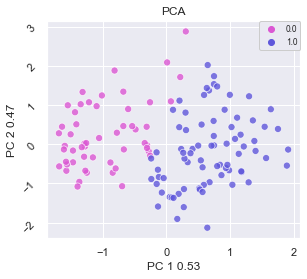

2 clusters -  silhoutte score: 0.22481749951839447 - mutual information: 0.0010923461256207375
3 clusters -  silhoutte score: 0.23861125111579895 - mutual information: 0.0769565827930995
4 clusters -  silhoutte score: 0.22753503918647766 - mutual information: 0.05569469297310203


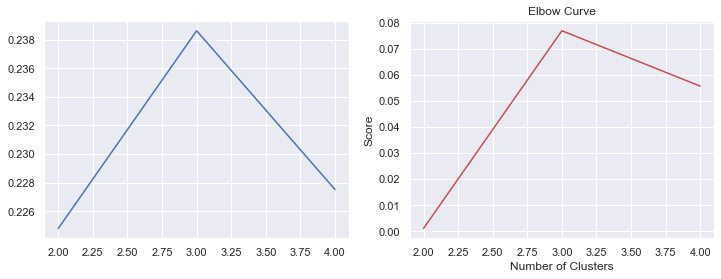

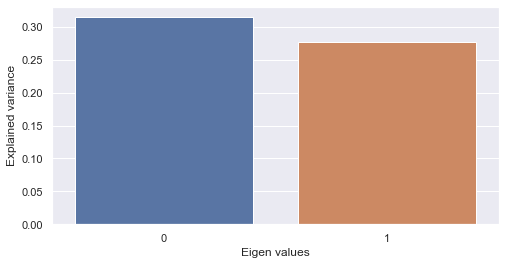

PCA on single-modal explained variance ratio: 0.5913074016571045


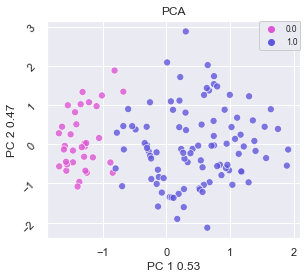

2 clusters -  silhoutte score: 0.2341437190771103 - mutual information: 0.0019926109904302865
3 clusters -  silhoutte score: 0.22423654794692993 - mutual information: 0.04745297502129918
4 clusters -  silhoutte score: 0.23340389132499695 - mutual information: 0.060128054493615


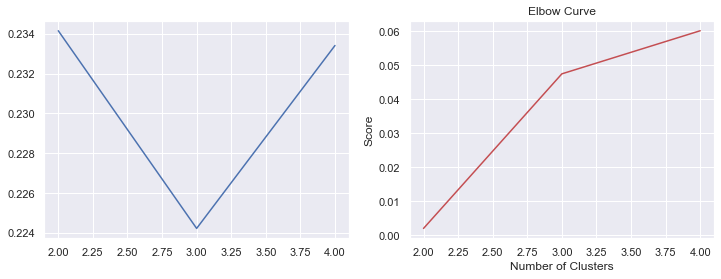

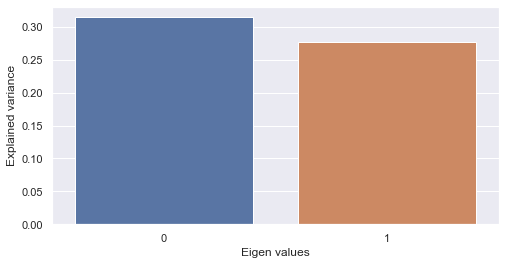

PCA on single-modal explained variance ratio: 0.5913074016571045


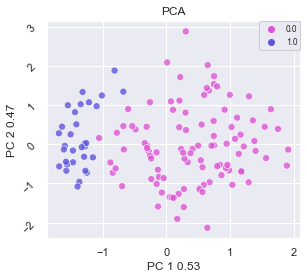

2 clusters -  silhoutte score: 0.23343032598495483 - mutual information: 0.0003984811252230495
3 clusters -  silhoutte score: 0.21467839181423187 - mutual information: 0.03717693071853378
4 clusters -  silhoutte score: 0.21704034507274628 - mutual information: 0.051242423596156064


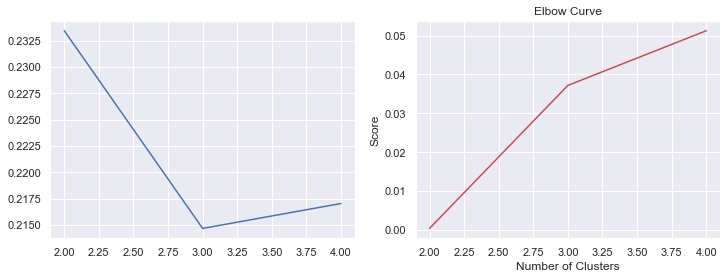

Compression: 51.18

Epoch 00041: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00046: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00046: early stopping


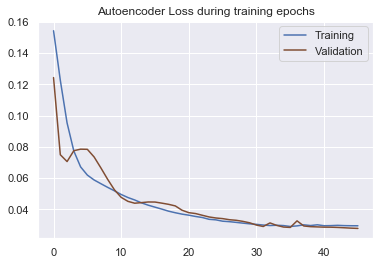

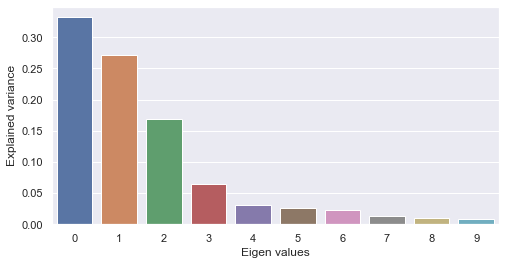

PCA on single-modal explained variance ratio: 0.9491596817970276


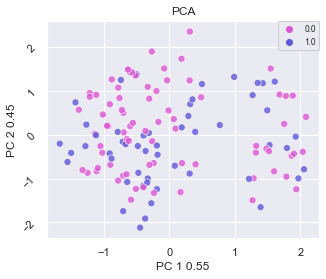

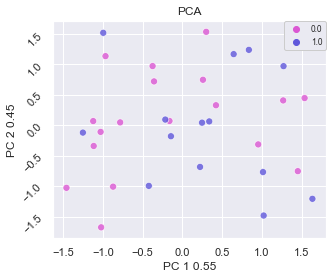

Results for AE: 

Best score for training data: 0.5923076923076922 

Best C: 0.08 



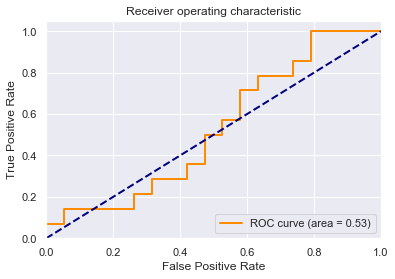

[[18  1]
 [12  2]]


              precision    recall  f1-score   support

           0       0.60      0.95      0.73        19
           1       0.67      0.14      0.24        14

    accuracy                           0.61        33
   macro avg       0.63      0.55      0.48        33
weighted avg       0.63      0.61      0.52        33

Training set score for Logistic Regression: 0.623077
Testing  set score for Logistic Regression: 0.606061
Best score for training data: 0.6 

Best C: 0.1 

Best Gamma: scale 



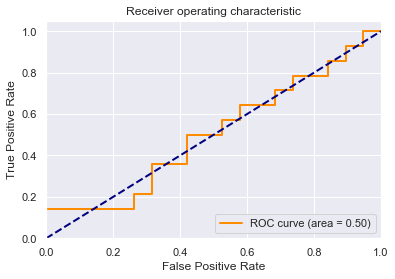

[[19  0]
 [14  0]]


              precision    recall  f1-score   support

           0       0.58      1.00      0.73        19
           1       0.00      0.00      0.00        14

    accuracy                           0.58        33
   macro avg       0.29      0.50      0.37        33
weighted avg       0.33      0.58      0.42        33

Training set score for SVM: 0.600000
Testing  set score for SVM: 0.575758


F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Best score for training data: 0.6384615384615385 

Best #estimators: 140 

Best max depth: None 



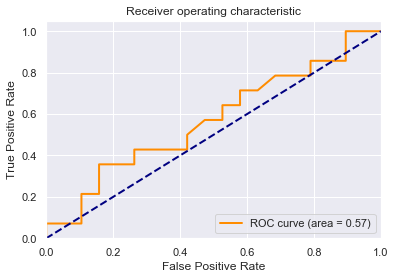

[[13  6]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.62      0.68      0.65        19
           1       0.50      0.43      0.46        14

    accuracy                           0.58        33
   macro avg       0.56      0.56      0.56        33
weighted avg       0.57      0.58      0.57        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.575758


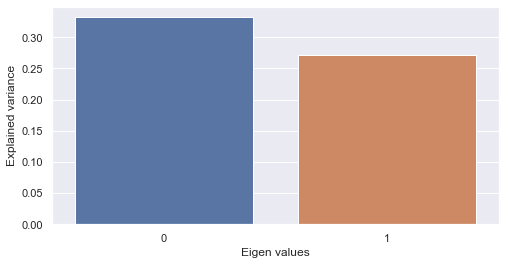

PCA on single-modal explained variance ratio: 0.6038275957107544


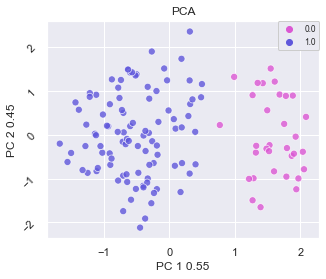

2 clusters -  silhoutte score: 0.29908111691474915 - mutual information: 0.0015445698868918648
3 clusters -  silhoutte score: 0.2405383437871933 - mutual information: 0.04456848892995527
4 clusters -  silhoutte score: 0.24942515790462494 - mutual information: 0.06041072029207903


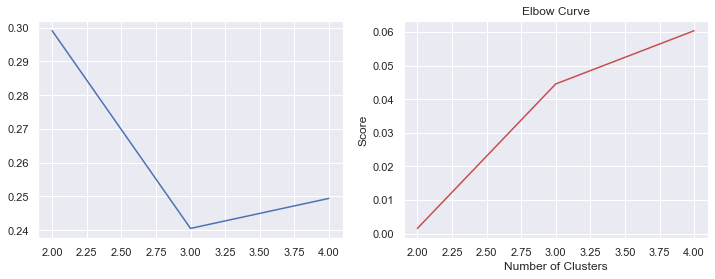

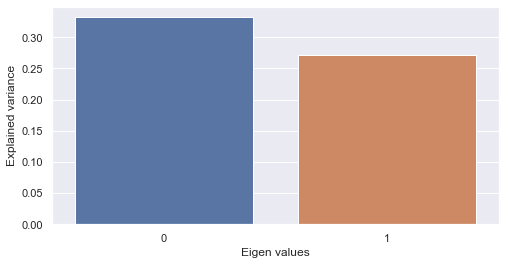

PCA on single-modal explained variance ratio: 0.6038275957107544


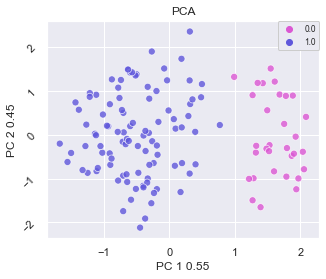

2 clusters -  silhoutte score: 0.30255126953125 - mutual information: 0.0003984811252230495
3 clusters -  silhoutte score: 0.26300957798957825 - mutual information: 0.0032559949799473805
4 clusters -  silhoutte score: 0.237812802195549 - mutual information: 0.049499240351944446


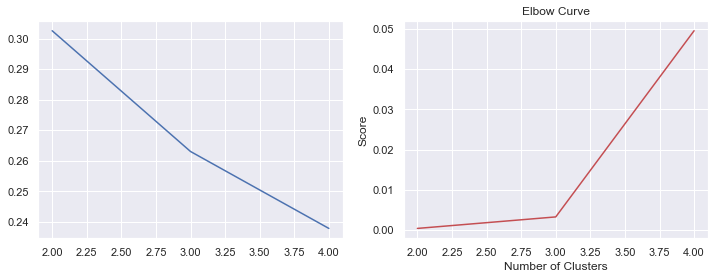

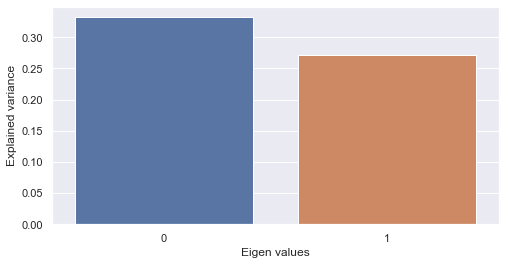

PCA on single-modal explained variance ratio: 0.6038275957107544


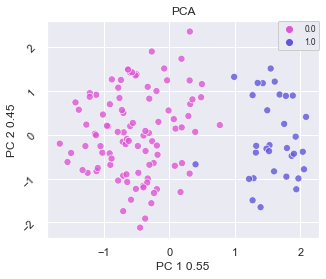

2 clusters -  silhoutte score: 0.29779675602912903 - mutual information: 4.3120955937184825e-05
3 clusters -  silhoutte score: 0.21775630116462708 - mutual information: 0.011644542980029881
4 clusters -  silhoutte score: 0.21327412128448486 - mutual information: 0.011455337518575566


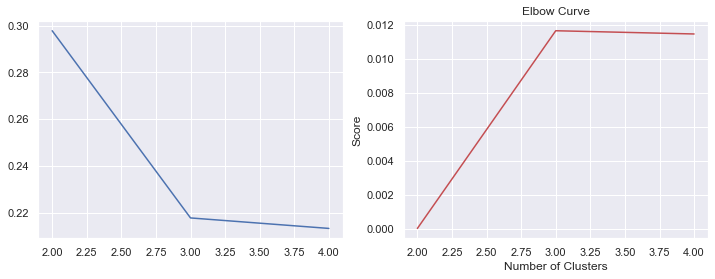

Compression: 51.18

Epoch 00041: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00065: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00072: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00077: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00082: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.
Epoch 00086: early stopping


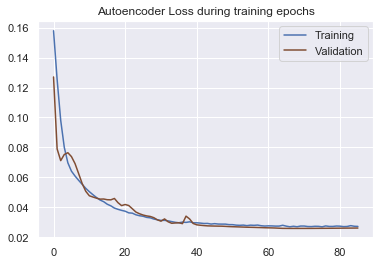

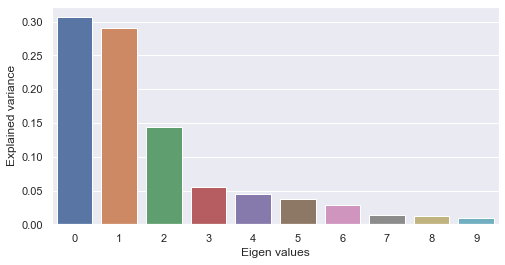

PCA on single-modal explained variance ratio: 0.9414499998092651


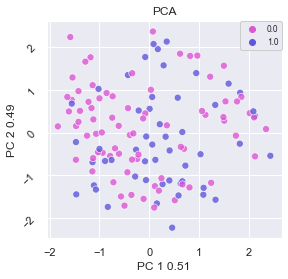

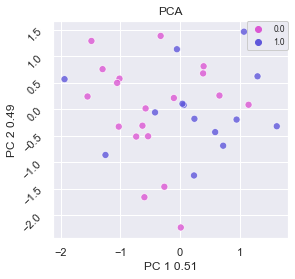

Results for AE: 

Best score for training data: 0.6230769230769231 

Best C: 0.08 



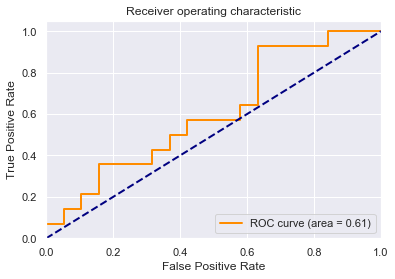

[[19  0]
 [13  1]]


              precision    recall  f1-score   support

           0       0.59      1.00      0.75        19
           1       1.00      0.07      0.13        14

    accuracy                           0.61        33
   macro avg       0.80      0.54      0.44        33
weighted avg       0.77      0.61      0.49        33

Training set score for Logistic Regression: 0.646154
Testing  set score for Logistic Regression: 0.606061
Best score for training data: 0.6461538461538462 

Best C: 1.0 

Best Gamma: 0.1 



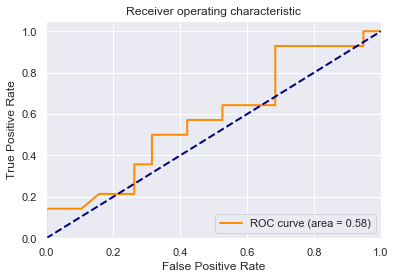

[[19  0]
 [12  2]]


              precision    recall  f1-score   support

           0       0.61      1.00      0.76        19
           1       1.00      0.14      0.25        14

    accuracy                           0.64        33
   macro avg       0.81      0.57      0.51        33
weighted avg       0.78      0.64      0.54        33

Training set score for SVM: 0.692308
Testing  set score for SVM: 0.636364
Best score for training data: 0.5923076923076922 

Best #estimators: 140 

Best max depth: None 



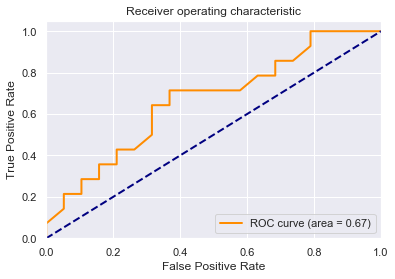

[[14  5]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.64      0.74      0.68        19
           1       0.55      0.43      0.48        14

    accuracy                           0.61        33
   macro avg       0.59      0.58      0.58        33
weighted avg       0.60      0.61      0.60        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.606061


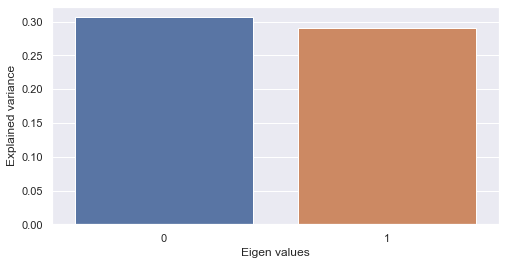

PCA on single-modal explained variance ratio: 0.5975298881530762


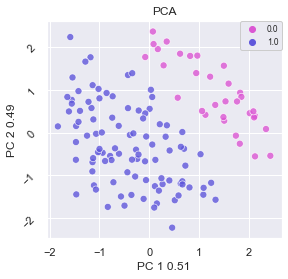

2 clusters -  silhoutte score: 0.26369190216064453 - mutual information: 0.0015445698868918648
3 clusters -  silhoutte score: 0.23663009703159332 - mutual information: 0.021678444511881376
4 clusters -  silhoutte score: 0.235416442155838 - mutual information: 0.038831579697584884


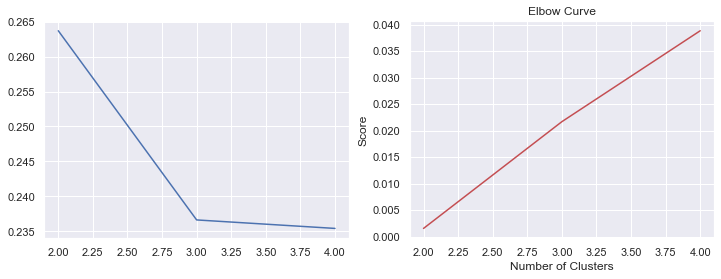

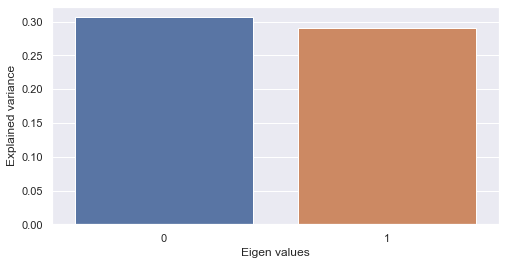

PCA on single-modal explained variance ratio: 0.5975298881530762


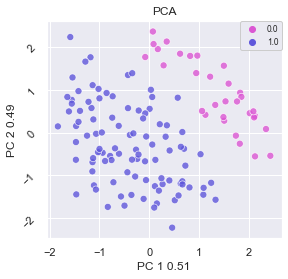

2 clusters -  silhoutte score: 0.2647562623023987 - mutual information: 0.0003984811252230495
3 clusters -  silhoutte score: 0.22802235186100006 - mutual information: 0.022518136848902786
4 clusters -  silhoutte score: 0.23033703863620758 - mutual information: 0.04567832260799855


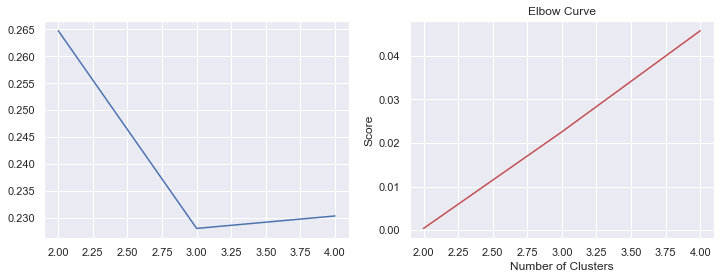

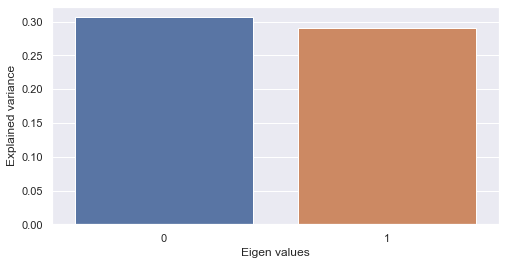

PCA on single-modal explained variance ratio: 0.5975298881530762


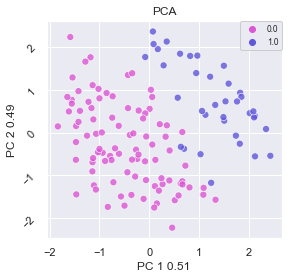

2 clusters -  silhoutte score: 0.25277507305145264 - mutual information: 0.0003500070750432931
3 clusters -  silhoutte score: 0.23026594519615173 - mutual information: 0.06944438957142997
4 clusters -  silhoutte score: 0.2234468162059784 - mutual information: 0.0675868834557332


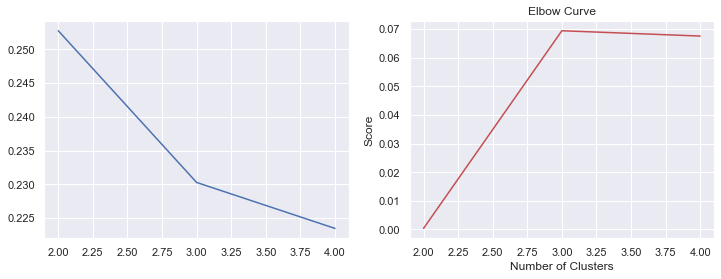

Compression: 51.18

Epoch 00044: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00088: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00094: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00099: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00104: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.

Epoch 00111: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-09.

Epoch 00116: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-10.
Epoch 00116: early stopping


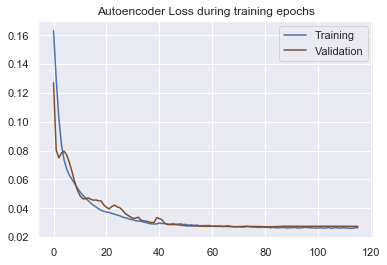

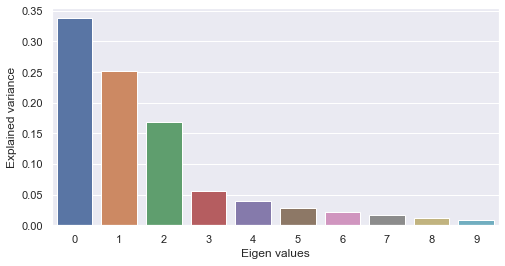

PCA on single-modal explained variance ratio: 0.9403005242347717


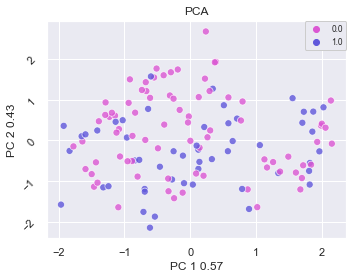

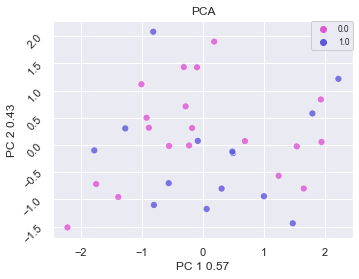

Results for AE: 

Best score for training data: 0.6153846153846153 

Best C: 0.08 



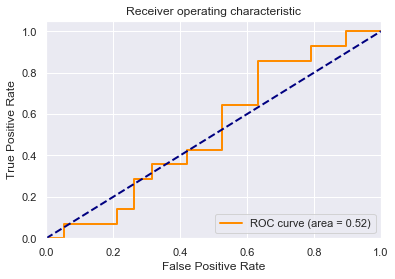

[[18  1]
 [13  1]]


              precision    recall  f1-score   support

           0       0.58      0.95      0.72        19
           1       0.50      0.07      0.12        14

    accuracy                           0.58        33
   macro avg       0.54      0.51      0.42        33
weighted avg       0.55      0.58      0.47        33

Training set score for Logistic Regression: 0.638462
Testing  set score for Logistic Regression: 0.575758
Best score for training data: 0.6307692307692307 

Best C: 1.0 

Best Gamma: 0.1 



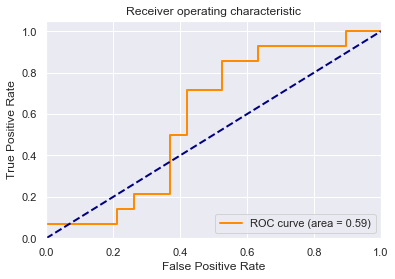

[[15  4]
 [13  1]]


              precision    recall  f1-score   support

           0       0.54      0.79      0.64        19
           1       0.20      0.07      0.11        14

    accuracy                           0.48        33
   macro avg       0.37      0.43      0.37        33
weighted avg       0.39      0.48      0.41        33

Training set score for SVM: 0.700000
Testing  set score for SVM: 0.484848
Best score for training data: 0.5692307692307692 

Best #estimators: 100 

Best max depth: 12 



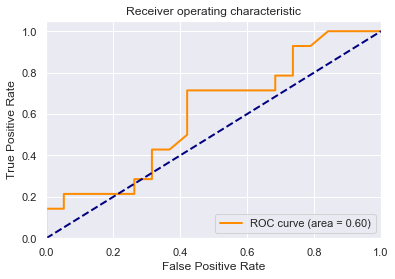

[[13  6]
 [10  4]]


              precision    recall  f1-score   support

           0       0.57      0.68      0.62        19
           1       0.40      0.29      0.33        14

    accuracy                           0.52        33
   macro avg       0.48      0.48      0.48        33
weighted avg       0.50      0.52      0.50        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.515152


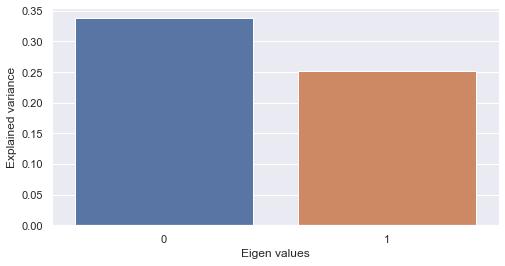

PCA on single-modal explained variance ratio: 0.5893743634223938


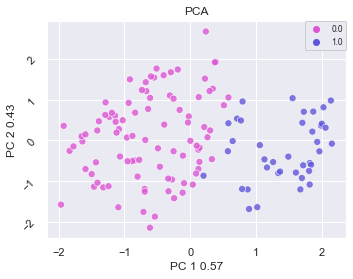

2 clusters -  silhoutte score: 0.24501334130764008 - mutual information: 0.005227444292690468
3 clusters -  silhoutte score: 0.2487056404352188 - mutual information: 0.07086014093075353
4 clusters -  silhoutte score: 0.25842350721359253 - mutual information: 0.06551166799069066


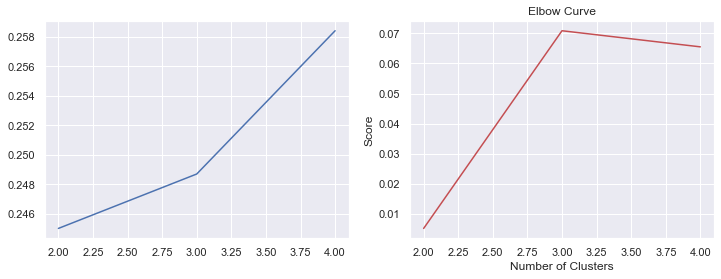

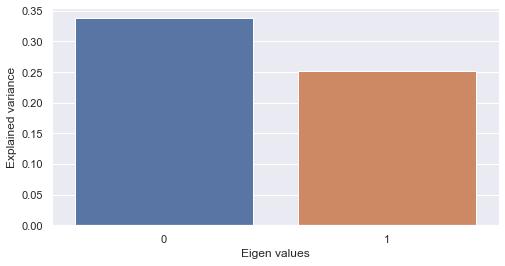

PCA on single-modal explained variance ratio: 0.5893743634223938


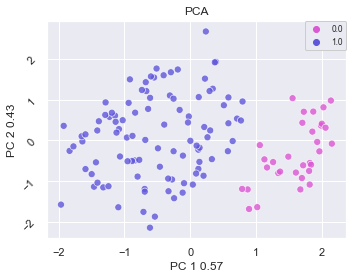

2 clusters -  silhoutte score: 0.2643192708492279 - mutual information: 0.0015445698868918648
3 clusters -  silhoutte score: 0.23672981560230255 - mutual information: 0.0590859151866716
4 clusters -  silhoutte score: 0.2529938519001007 - mutual information: 0.06049287149033143


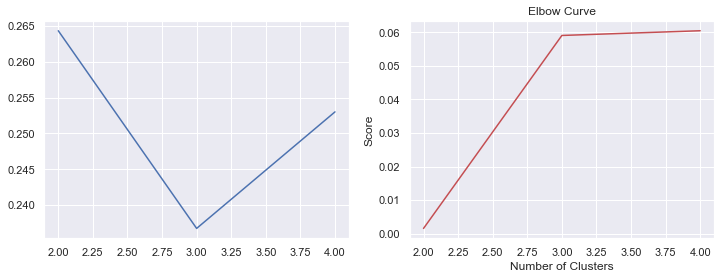

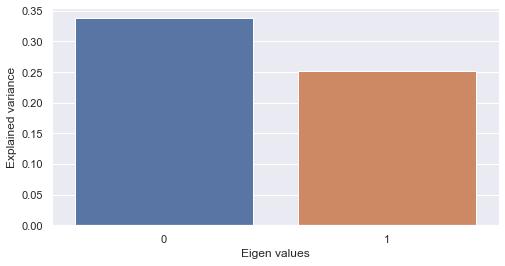

PCA on single-modal explained variance ratio: 0.5893743634223938


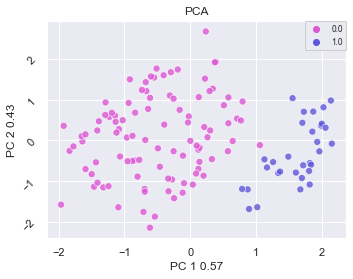

2 clusters -  silhoutte score: 0.26336178183555603 - mutual information: 0.0003984811252230495
3 clusters -  silhoutte score: 0.22348839044570923 - mutual information: 0.02965399657469239
4 clusters -  silhoutte score: 0.2392687052488327 - mutual information: 0.043582093493427725


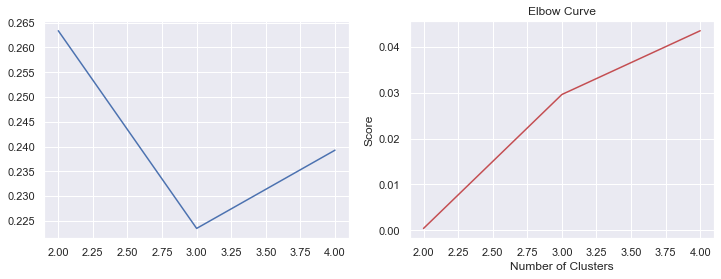

Compression: 51.18

Epoch 00052: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00057: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00057: early stopping


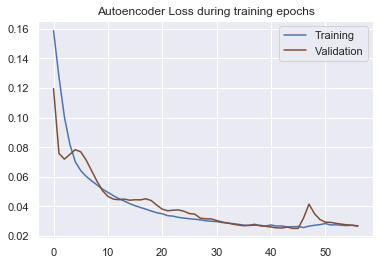

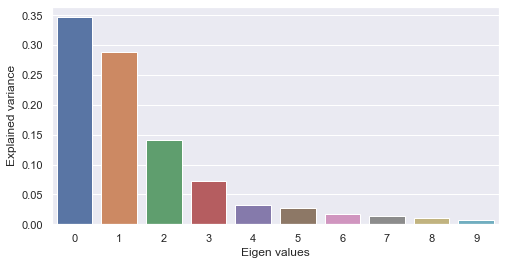

PCA on single-modal explained variance ratio: 0.957059383392334


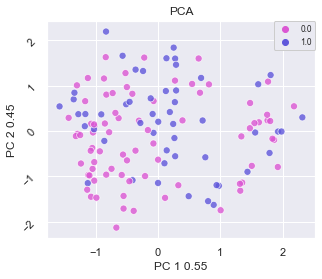

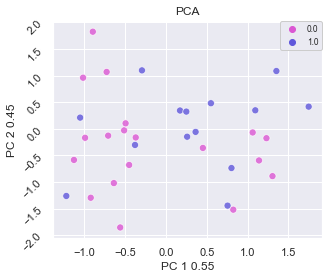

Results for AE: 

Best score for training data: 0.6076923076923076 

Best C: 0.08 



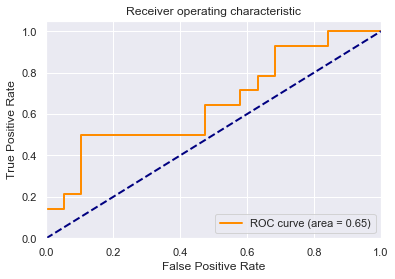

[[19  0]
 [14  0]]


              precision    recall  f1-score   support

           0       0.58      1.00      0.73        19
           1       0.00      0.00      0.00        14

    accuracy                           0.58        33
   macro avg       0.29      0.50      0.37        33
weighted avg       0.33      0.58      0.42        33

Training set score for Logistic Regression: 0.638462
Testing  set score for Logistic Regression: 0.575758
Best score for training data: 0.6153846153846153 

Best C: 1.0 

Best Gamma: 0.1 



F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


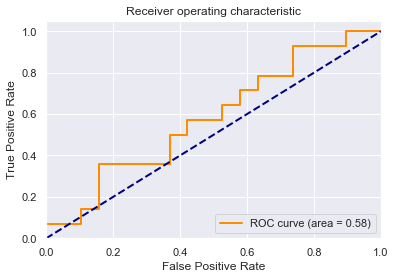

[[19  0]
 [13  1]]


              precision    recall  f1-score   support

           0       0.59      1.00      0.75        19
           1       1.00      0.07      0.13        14

    accuracy                           0.61        33
   macro avg       0.80      0.54      0.44        33
weighted avg       0.77      0.61      0.49        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.606061
Best score for training data: 0.6230769230769231 

Best #estimators: 140 

Best max depth: None 



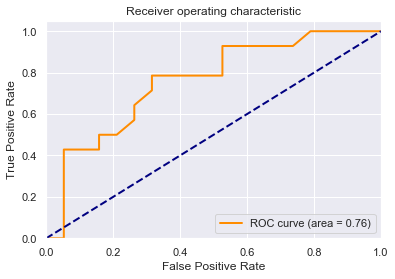

[[16  3]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.67      0.84      0.74        19
           1       0.67      0.43      0.52        14

    accuracy                           0.67        33
   macro avg       0.67      0.64      0.63        33
weighted avg       0.67      0.67      0.65        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.666667


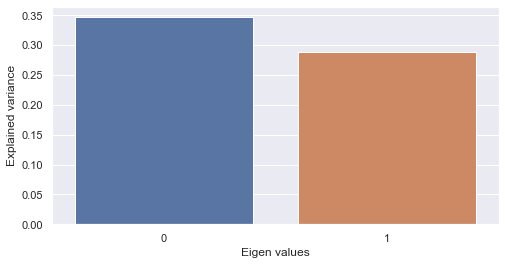

PCA on single-modal explained variance ratio: 0.6345446109771729


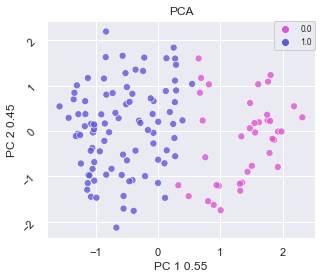

2 clusters -  silhoutte score: 0.28052544593811035 - mutual information: 0.0005953275414684495
3 clusters -  silhoutte score: 0.2643117904663086 - mutual information: 0.053408722941667194
4 clusters -  silhoutte score: 0.2663360834121704 - mutual information: 0.029505426406464787


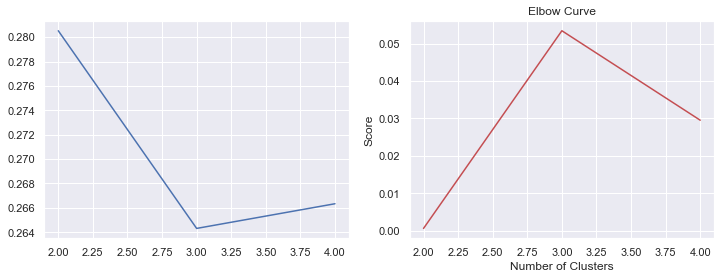

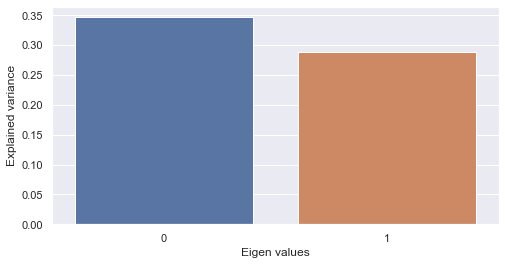

PCA on single-modal explained variance ratio: 0.6345446109771729


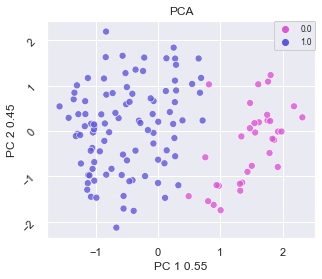

2 clusters -  silhoutte score: 0.285776823759079 - mutual information: 0.0006693432727331925
3 clusters -  silhoutte score: 0.25253963470458984 - mutual information: 0.01487744532129989
4 clusters -  silhoutte score: 0.24742913246154785 - mutual information: 0.06829160323139753


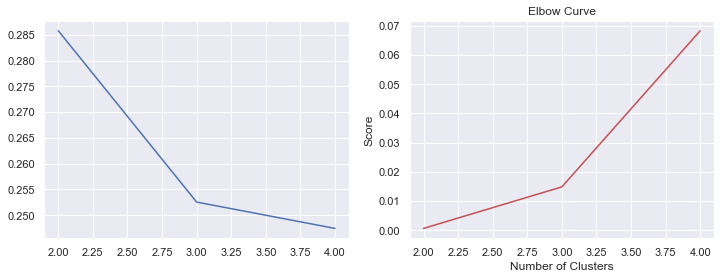

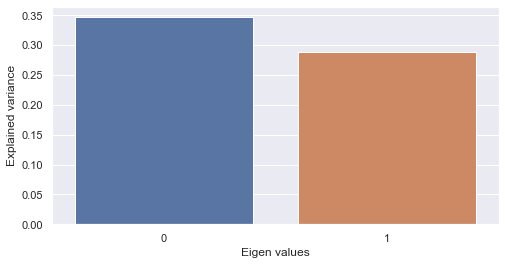

PCA on single-modal explained variance ratio: 0.6345446109771729


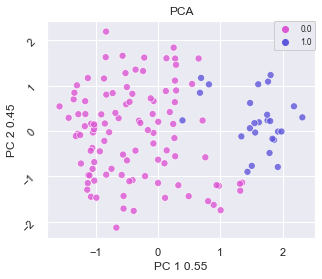

2 clusters -  silhoutte score: 0.2532944977283478 - mutual information: 0.0026079316876898005
3 clusters -  silhoutte score: 0.2294917106628418 - mutual information: 0.014329838941760657
4 clusters -  silhoutte score: 0.21988435089588165 - mutual information: 0.02009097649511277


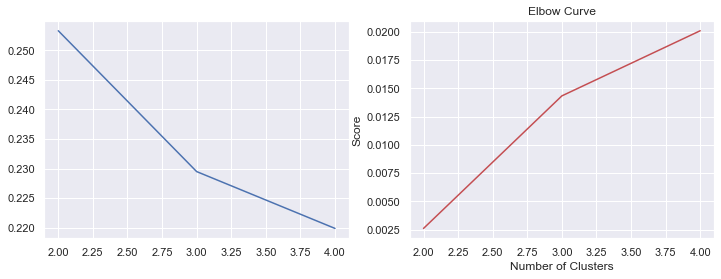

Compression: 51.18

Epoch 00048: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00069: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00076: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00081: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00081: early stopping


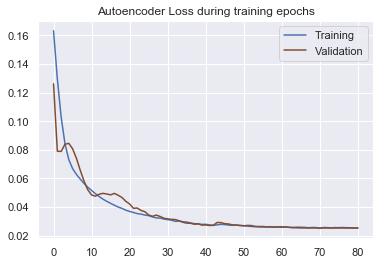

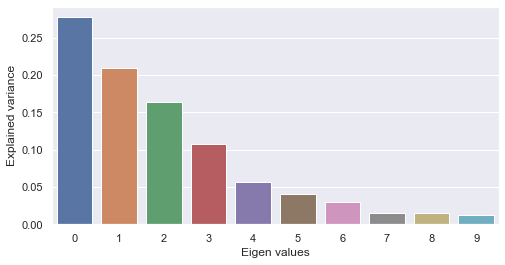

PCA on single-modal explained variance ratio: 0.9271586537361145


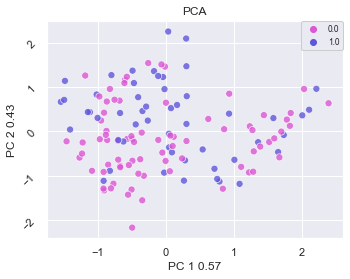

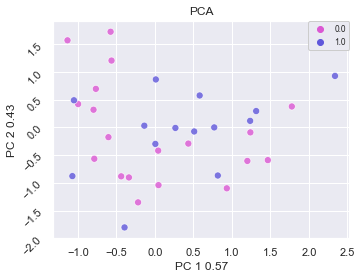

Results for AE: 

Best score for training data: 0.6615384615384615 

Best C: 0.08 



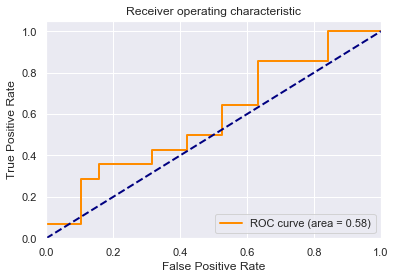

[[18  1]
 [13  1]]


              precision    recall  f1-score   support

           0       0.58      0.95      0.72        19
           1       0.50      0.07      0.12        14

    accuracy                           0.58        33
   macro avg       0.54      0.51      0.42        33
weighted avg       0.55      0.58      0.47        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.575758
Best score for training data: 0.6153846153846153 

Best C: 1.0 

Best Gamma: 0.1 



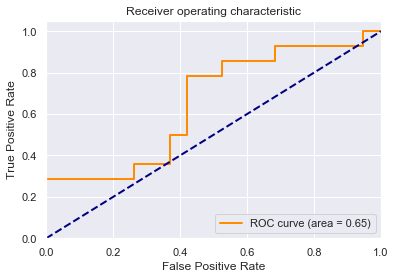

[[19  0]
 [11  3]]


              precision    recall  f1-score   support

           0       0.63      1.00      0.78        19
           1       1.00      0.21      0.35        14

    accuracy                           0.67        33
   macro avg       0.82      0.61      0.56        33
weighted avg       0.79      0.67      0.60        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.666667
Best score for training data: 0.6076923076923076 

Best #estimators: 140 

Best max depth: None 



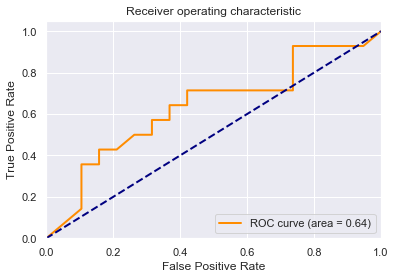

[[14  5]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.67      0.74      0.70        19
           1       0.58      0.50      0.54        14

    accuracy                           0.64        33
   macro avg       0.62      0.62      0.62        33
weighted avg       0.63      0.64      0.63        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.636364


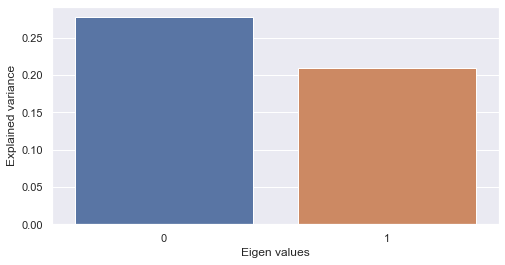

PCA on single-modal explained variance ratio: 0.48686879873275757


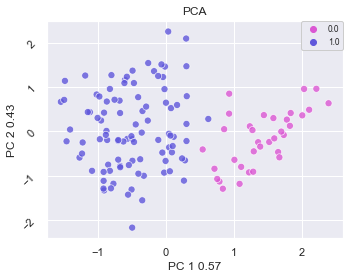

2 clusters -  silhoutte score: 0.24033969640731812 - mutual information: 0.00016337213291564725
3 clusters -  silhoutte score: 0.21824395656585693 - mutual information: 0.07368804047933113
4 clusters -  silhoutte score: 0.22588782012462616 - mutual information: 0.06733883151393008


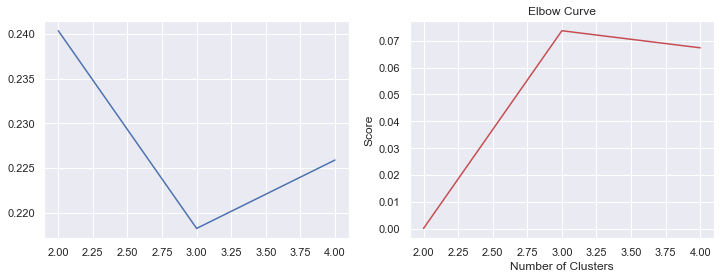

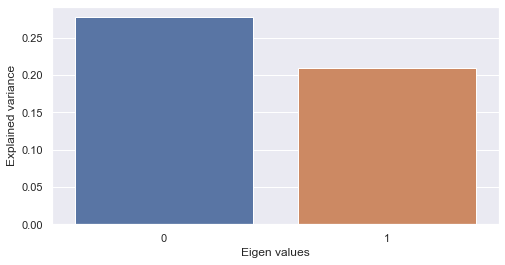

PCA on single-modal explained variance ratio: 0.48686879873275757


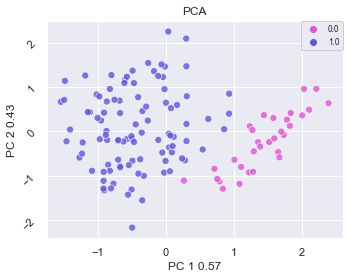

2 clusters -  silhoutte score: 0.2452041655778885 - mutual information: 0.0003984811252230495
3 clusters -  silhoutte score: 0.21097716689109802 - mutual information: 0.04595192176070735
4 clusters -  silhoutte score: 0.1991143673658371 - mutual information: 0.046668801888252336


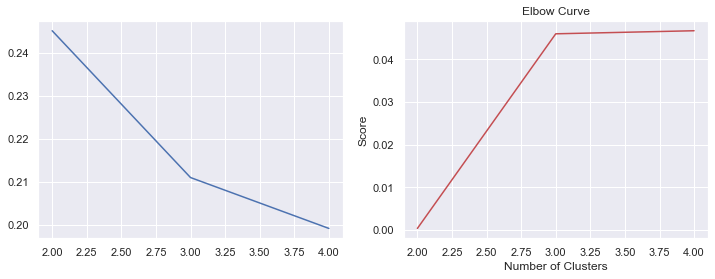

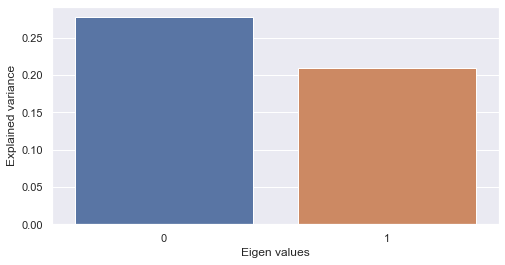

PCA on single-modal explained variance ratio: 0.48686879873275757


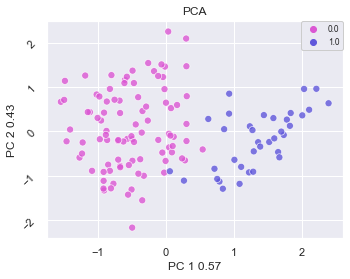

2 clusters -  silhoutte score: 0.23221585154533386 - mutual information: 0.00015628689812826783
3 clusters -  silhoutte score: 0.20488402247428894 - mutual information: 0.02118631020390771
4 clusters -  silhoutte score: 0.19718797504901886 - mutual information: 0.042399813456622165


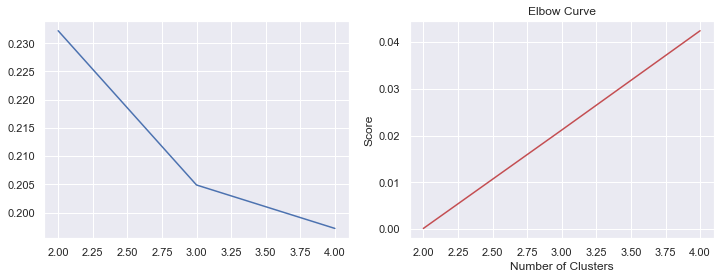

In [11]:
encoding_dims=[100]
mus=[0.5]
dropouts = [0.5]
l1s = [0.000001]
l2s = [0.000005]
scores = []
for encoding_dim in encoding_dims:
    for mu in mus:
        for dropout in dropouts:
            for l1 in l1s:
                for l2 in l2s:
                    ## Build and Train Autoencoder
                    autoencoder, encoder, decoder, loss = Models.build_and_train_autoencoder(X_train_second_norm,
                                                                                  X_train_second_norm,
                                                                                  encoding_dim=encoding_dim, 
                                                                                  regularizer=tf.keras.regularizers.l1_l2(l1,l2),
                                                                                  dropout=dropout,
                                                                                  epochs=200,
                                                                                 )
                    ## Encode datasets
                    X_latent_ae = Models.encode_dataset(X_train_second_norm, encoder)
                    X_latent_test_ae = Models.encode_dataset(X_test_second_norm, encoder)

                    ## PCA ON AUTOENCODER LATENT SPACE
                    X_latent_pca_ae, X_latent_test_pca_ae = Models.perform_PCA(X_latent_ae, y_train, X_latent_test_ae, y_test, n_components=10)

                    ### CLASSIFICATION ###
                    classify = Models.classify(X_latent_ae, X_latent_test_ae, np.ravel(y_train), np.ravel(y_test), model_type="AE")

                    ### CLUSTERING ###
                    clustering = Models.cluster(X_latent_ae,np.ravel(y_train), model_type="AE")

                    scores.append([mu,dropout,l1,l2,loss] + classify + clustering)




In [12]:
scores = pd.DataFrame(scores,
                      columns=["mu","dropout","l1","l2","loss","LR accuracy","SVM accuracy", "RF accuracy", "LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC","KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette","KMeans MI","Spectral MI","Hierarchical MI"])    
display(scores)
print(f"Random classifier: {y_test.iloc[:,0].value_counts()[0]/len(y_test)}")

,mu,dropout,l1,l2,loss,LR accuracy,SVM accuracy,RF accuracy,LR ROC-AUC,SVM ROC-AUC,RF ROC-AUC,KMeans Silhouette,Spectral Silhouette,Hierarchical Silhouette,KMeans MI,Spectral MI,Hierarchical MI
0,0.5,0.5,0.000001,0.000000e+00,0.029424,0.545455,0.545455,0.606061,0.582707,0.541353,0.620301,0.251734,0.258502,0.239290,0.006204,0.000994,0.000134
1,0.5,0.5,0.000001,1.000000e-07,0.025220,0.606061,0.575758,0.575758,0.661654,0.684211,0.701128,0.207138,0.243849,0.198023,0.012793,0.001153,0.009815
2,0.5,0.5,0.000001,5.000000e-07,0.026001,0.515152,0.545455,0.666667,0.578947,0.624060,0.637218,0.224817,0.234144,0.233430,0.001092,0.001993,0.000398
3,0.5,0.5,0.000001,1.000000e-06,0.029344,0.606061,0.575758,0.575758,0.526316,0.503759,0.571429,0.299081,0.302551,0.297797,0.001545,0.000398,0.000043
4,0.5,0.5,0.000001,5.000000e-06,0.027209,0.606061,0.636364,0.606061,0.605263,0.577068,0.665414,0.263692,0.264756,0.252775,0.001545,0.000398,0.000350
5,0.5,0.5,0.000001,1.000000e-05,0.026437,0.575758,0.484848,0.515152,0.522556,0.586466,0.601504,0.245013,0.264319,0.263362,0.005227,0.001545,0.000398
6,0.5,0.5,0.000001,5.000000e-06,0.026663,0.575758,0.606061,0.666667,0.654135,0.582707,0.757519,0.280525,0.285777,0.253294,0.000595,0.000669,0.002608
7,0.5,0.5,0.000001,1.000000e-05,0.025301,0.575758,0.666667,0.636364,0.582707,0.654135,0.635338,0.240340,0.245204,0.232216,0.000163,0.000398,0.000156


Random classifier: 0.5757575757575758


F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\pandas\core\indexing.py:376: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\pandas\core\indexing.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(new_indexer, value)
F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

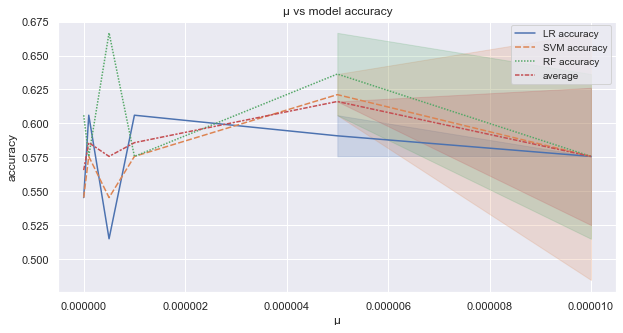

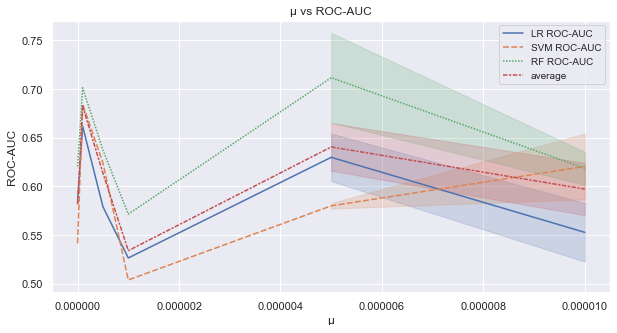

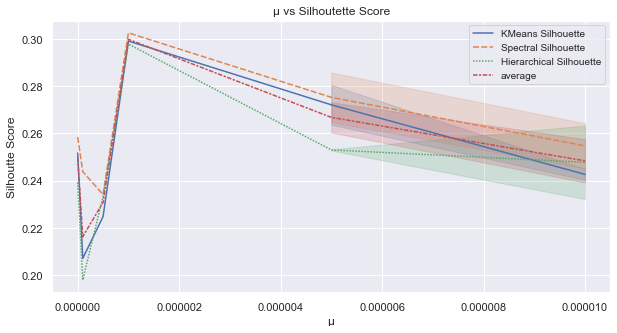

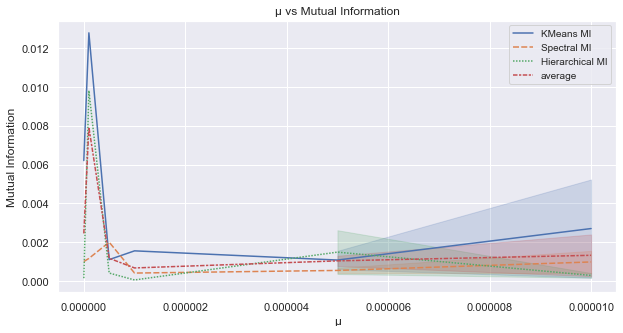

In [13]:
scores.index = l2s

data_acc = scores[["LR accuracy","SVM accuracy","RF accuracy"]]
data_acc.loc[:,"average"] = data_acc.mean(axis=1)

data_auc = scores[["LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC"]]
data_auc.loc[:,"average"] = data_auc.mean(axis=1)

data_ss = scores[["KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette"]]
data_ss.loc[:,"average"] = data_ss.mean(axis=1)

data_mi = scores[["KMeans MI","Spectral MI","Hierarchical MI"]]
data_mi.loc[:,"average"] = data_mi.mean(axis=1)

sns.set()
hyperparam = "μ"

ax = sns.lineplot(data=data_acc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"accuracy")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs model accuracy")
plt.show()

ax = sns.lineplot(data=data_auc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"ROC-AUC")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs ROC-AUC")
plt.show()

ax = sns.lineplot(data=data_ss)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Silhoutte Score")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Silhoutette Score")
plt.show()

ax = sns.lineplot(data=data_mi)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Mutual Information")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Mutual Information")
plt.show()

Compression: 51.18

Epoch 00053: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00058: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00068: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00073: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00073: early stopping


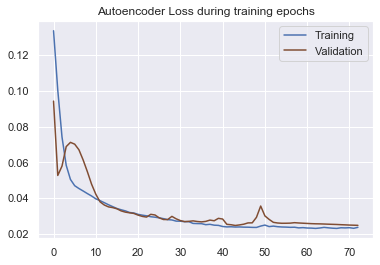

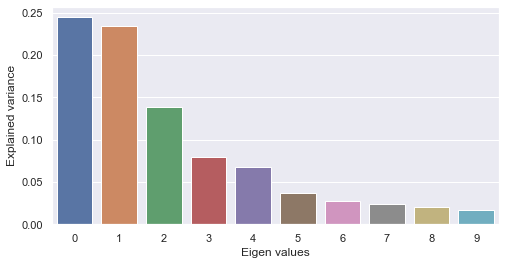

PCA on single-modal explained variance ratio: 0.8905123472213745


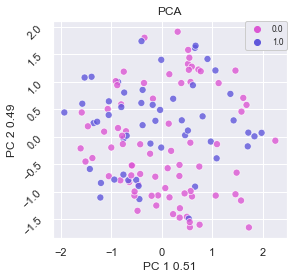

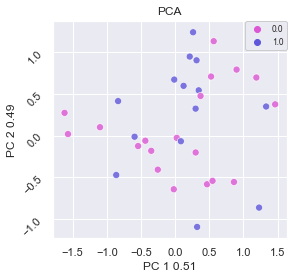

Results for AE: 

Best score for training data: 0.6 

Best C: 0.08 



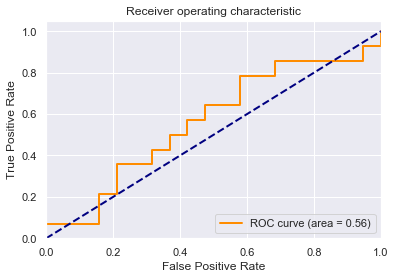

[[18  1]
 [13  1]]


              precision    recall  f1-score   support

           0       0.58      0.95      0.72        19
           1       0.50      0.07      0.12        14

    accuracy                           0.58        33
   macro avg       0.54      0.51      0.42        33
weighted avg       0.55      0.58      0.47        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.575758
Best score for training data: 0.6 

Best C: 0.1 

Best Gamma: scale 



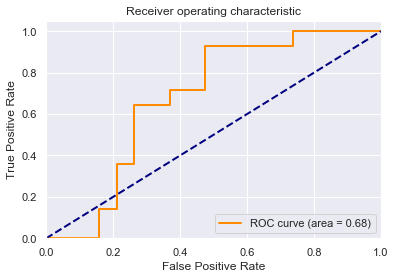

[[19  0]
 [14  0]]


              precision    recall  f1-score   support

           0       0.58      1.00      0.73        19
           1       0.00      0.00      0.00        14

    accuracy                           0.58        33
   macro avg       0.29      0.50      0.37        33
weighted avg       0.33      0.58      0.42        33

Training set score for SVM: 0.600000
Testing  set score for SVM: 0.575758


F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Best score for training data: 0.6076923076923076 

Best #estimators: 140 

Best max depth: None 



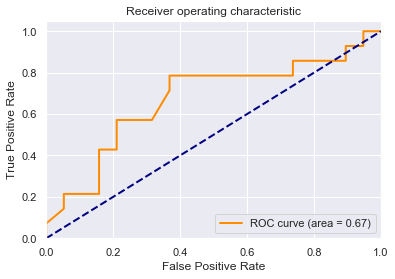

[[15  4]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.65      0.79      0.71        19
           1       0.60      0.43      0.50        14

    accuracy                           0.64        33
   macro avg       0.63      0.61      0.61        33
weighted avg       0.63      0.64      0.62        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.636364


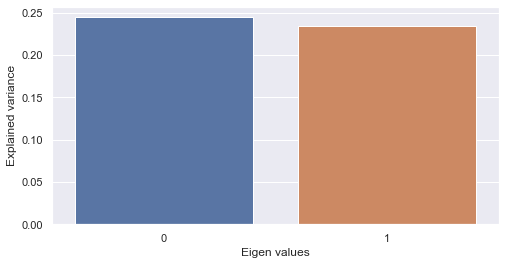

PCA on single-modal explained variance ratio: 0.47867029905319214


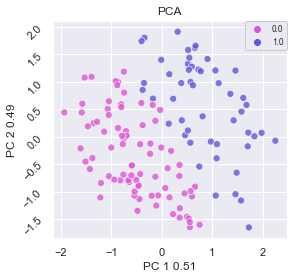

2 clusters -  silhoutte score: 0.1850357949733734 - mutual information: 0.0007763455450109926
3 clusters -  silhoutte score: 0.1801004558801651 - mutual information: 0.02810972535957077
4 clusters -  silhoutte score: 0.19008390605449677 - mutual information: 0.035422561238291336


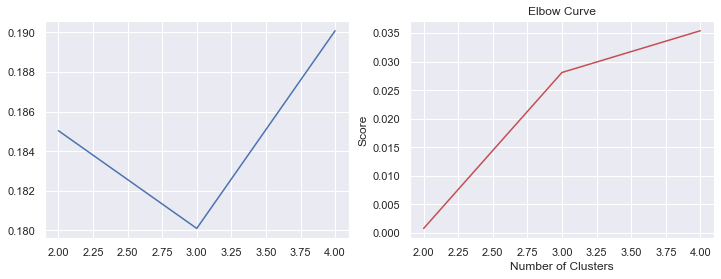

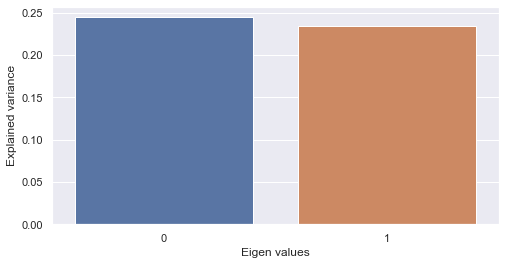

PCA on single-modal explained variance ratio: 0.47867029905319214


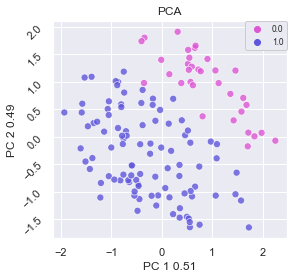

2 clusters -  silhoutte score: 0.19695302844047546 - mutual information: 0.0006693432727331925
3 clusters -  silhoutte score: 0.16619814932346344 - mutual information: 0.019676836911442966
4 clusters -  silhoutte score: 0.1647348701953888 - mutual information: 0.06416948776795581


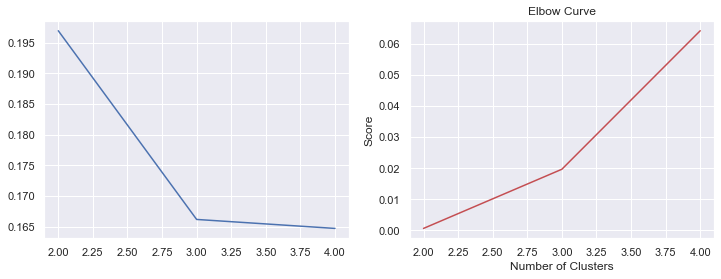

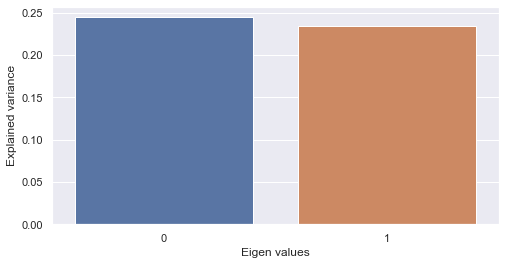

PCA on single-modal explained variance ratio: 0.47867029905319214


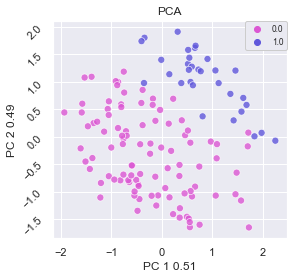

2 clusters -  silhoutte score: 0.1923423707485199 - mutual information: 0.00017817392730610387
3 clusters -  silhoutte score: 0.162710040807724 - mutual information: 0.03222318143493574
4 clusters -  silhoutte score: 0.15547628700733185 - mutual information: 0.03893180002547997


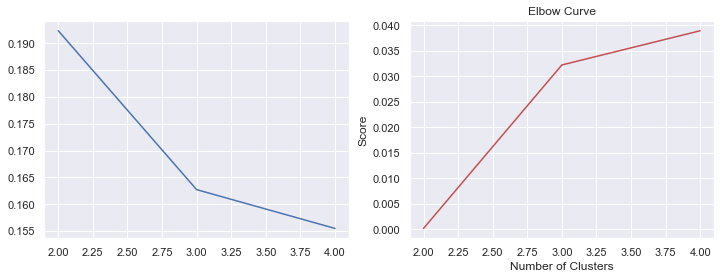

Compression: 51.18

Epoch 00046: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00051: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00051: early stopping


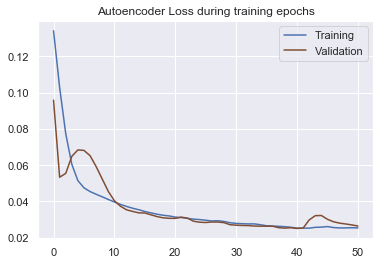

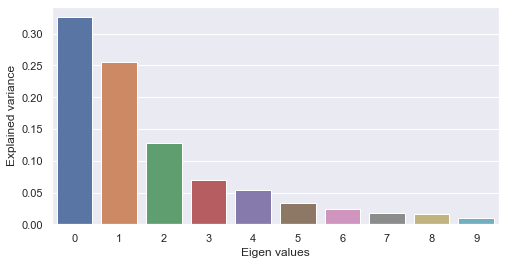

PCA on single-modal explained variance ratio: 0.9353517293930054


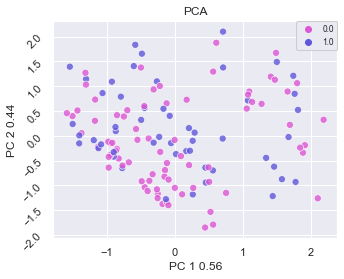

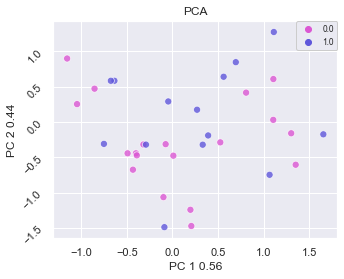

Results for AE: 

Best score for training data: 0.6153846153846154 

Best C: 0.08 



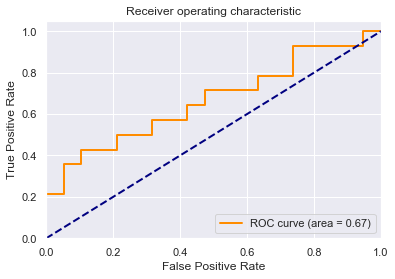

[[19  0]
 [14  0]]


              precision    recall  f1-score   support

           0       0.58      1.00      0.73        19
           1       0.00      0.00      0.00        14

    accuracy                           0.58        33
   macro avg       0.29      0.50      0.37        33
weighted avg       0.33      0.58      0.42        33

Training set score for Logistic Regression: 0.646154
Testing  set score for Logistic Regression: 0.575758
Best score for training data: 0.6153846153846154 

Best C: 1.0 

Best Gamma: 0.1 



F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


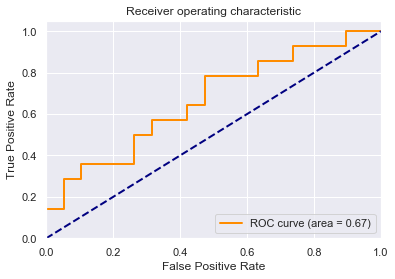

[[19  0]
 [14  0]]


              precision    recall  f1-score   support

           0       0.58      1.00      0.73        19
           1       0.00      0.00      0.00        14

    accuracy                           0.58        33
   macro avg       0.29      0.50      0.37        33
weighted avg       0.33      0.58      0.42        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.575758


F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Best score for training data: 0.6230769230769231 

Best #estimators: 140 

Best max depth: None 



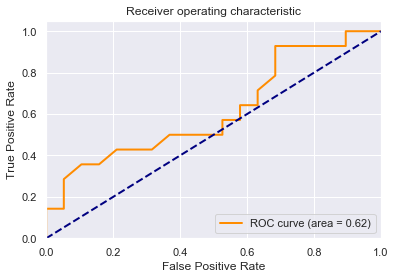

[[15  4]
 [ 8  6]]


              precision    recall  f1-score   support

           0       0.65      0.79      0.71        19
           1       0.60      0.43      0.50        14

    accuracy                           0.64        33
   macro avg       0.63      0.61      0.61        33
weighted avg       0.63      0.64      0.62        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.636364


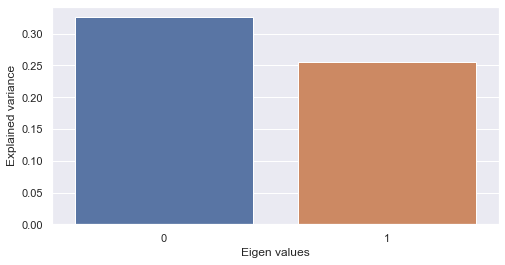

PCA on single-modal explained variance ratio: 0.5819046497344971


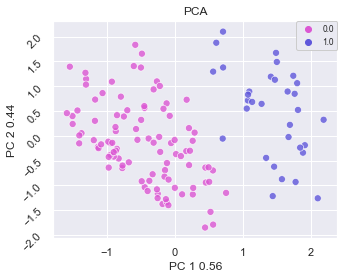

2 clusters -  silhoutte score: 0.29414477944374084 - mutual information: 0.0015445698868918648
3 clusters -  silhoutte score: 0.23790401220321655 - mutual information: 0.007805100612958974
4 clusters -  silhoutte score: 0.23734666407108307 - mutual information: 0.041360173674595026


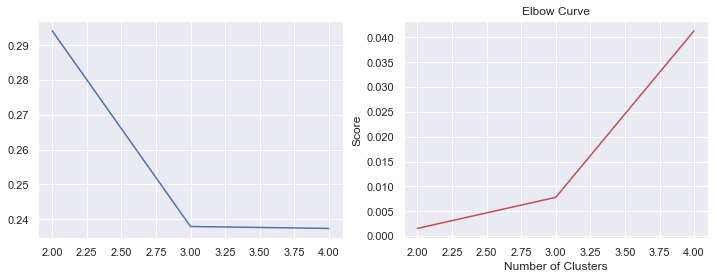

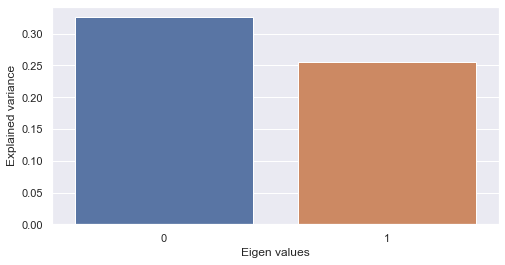

PCA on single-modal explained variance ratio: 0.5819046497344971


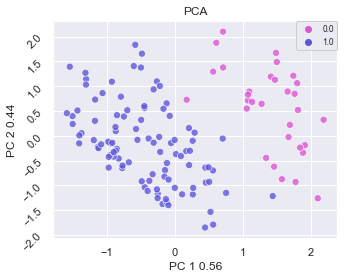

2 clusters -  silhoutte score: 0.2946421802043915 - mutual information: 0.00017817392730610387
3 clusters -  silhoutte score: 0.2683597803115845 - mutual information: 0.001780215264184624
4 clusters -  silhoutte score: 0.21820855140686035 - mutual information: 0.004749284668807546


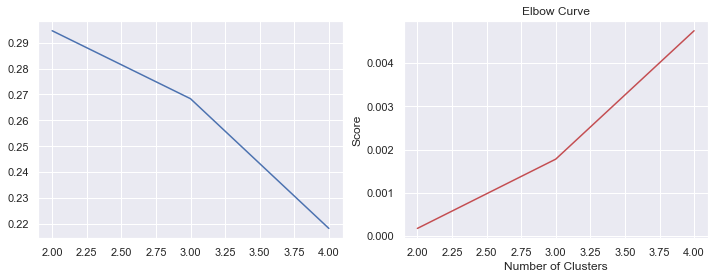

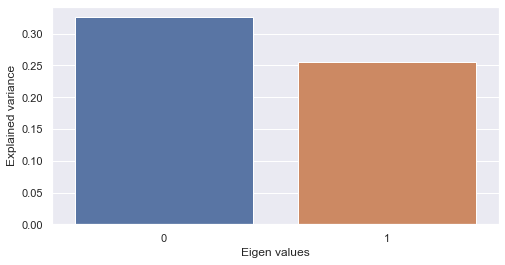

PCA on single-modal explained variance ratio: 0.5819046497344971


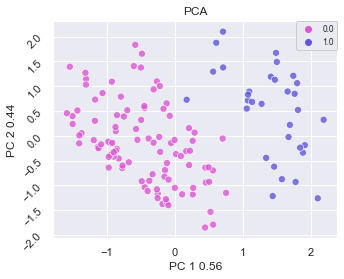

2 clusters -  silhoutte score: 0.2954896092414856 - mutual information: 4.3120955937184825e-05
3 clusters -  silhoutte score: 0.21545663475990295 - mutual information: 0.027339123808074187
4 clusters -  silhoutte score: 0.20678214728832245 - mutual information: 0.050865121115862125


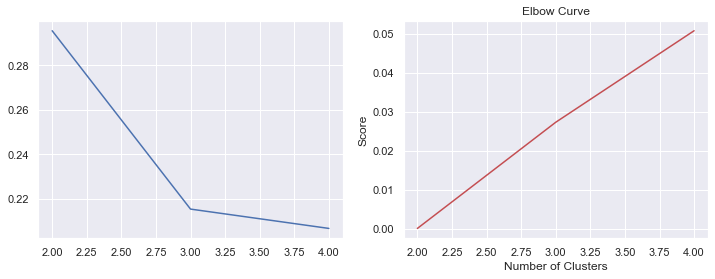

Compression: 51.18

Epoch 00059: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00070: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00079: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00087: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00092: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.
Epoch 00092: early stopping


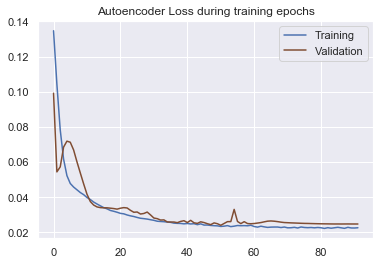

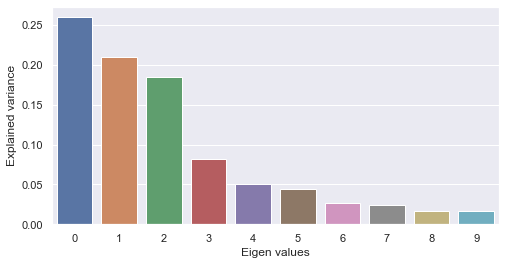

PCA on single-modal explained variance ratio: 0.9166766405105591


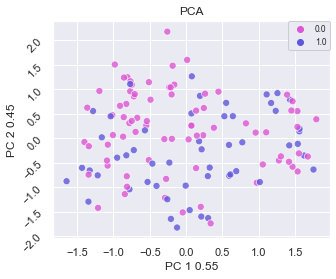

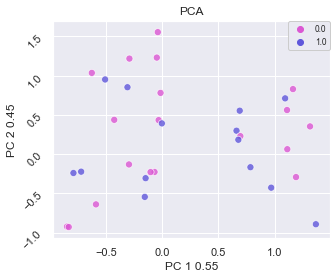

Results for AE: 

Best score for training data: 0.6076923076923076 

Best C: 0.08 



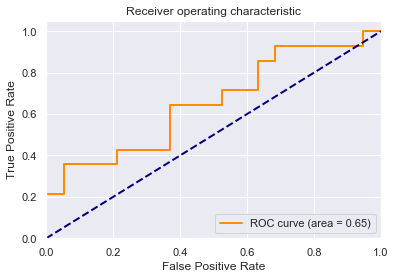

[[19  0]
 [14  0]]


              precision    recall  f1-score   support

           0       0.58      1.00      0.73        19
           1       0.00      0.00      0.00        14

    accuracy                           0.58        33
   macro avg       0.29      0.50      0.37        33
weighted avg       0.33      0.58      0.42        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.575758
Best score for training data: 0.6230769230769231 

Best C: 1.0 

Best Gamma: 0.1 



F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


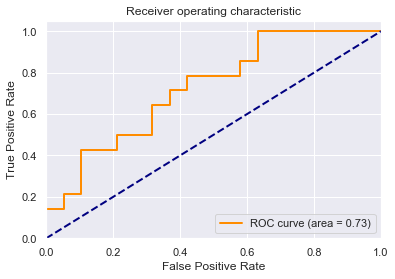

[[19  0]
 [12  2]]


              precision    recall  f1-score   support

           0       0.61      1.00      0.76        19
           1       1.00      0.14      0.25        14

    accuracy                           0.64        33
   macro avg       0.81      0.57      0.51        33
weighted avg       0.78      0.64      0.54        33

Training set score for SVM: 0.669231
Testing  set score for SVM: 0.636364
Best score for training data: 0.5769230769230769 

Best #estimators: 140 

Best max depth: None 



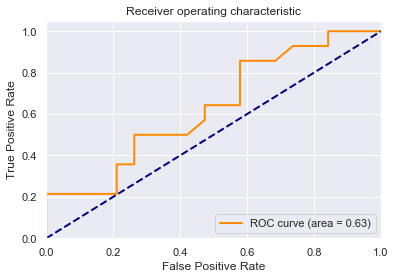

[[15  4]
 [ 9  5]]


              precision    recall  f1-score   support

           0       0.62      0.79      0.70        19
           1       0.56      0.36      0.43        14

    accuracy                           0.61        33
   macro avg       0.59      0.57      0.57        33
weighted avg       0.60      0.61      0.59        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.606061


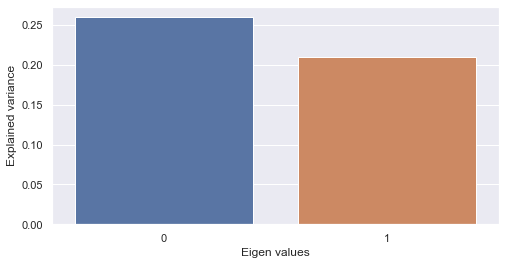

PCA on single-modal explained variance ratio: 0.4697110652923584


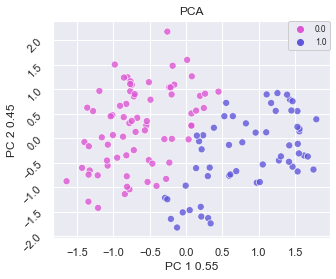

2 clusters -  silhoutte score: 0.18682359158992767 - mutual information: 0.049801541616907315
3 clusters -  silhoutte score: 0.20396213233470917 - mutual information: 0.06437318666051445
4 clusters -  silhoutte score: 0.20245233178138733 - mutual information: 0.042150862055227986


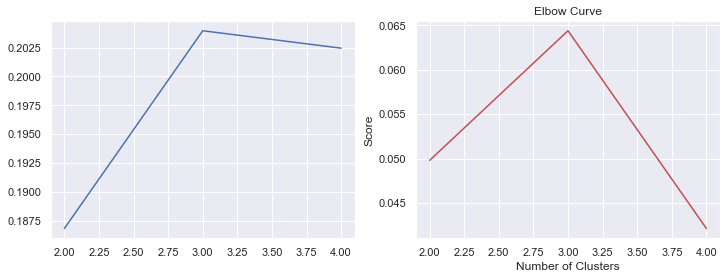

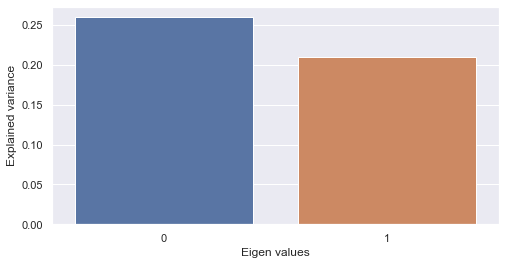

PCA on single-modal explained variance ratio: 0.4697110652923584


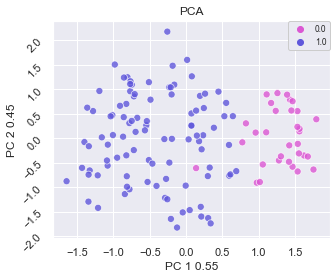

2 clusters -  silhoutte score: 0.19629184901714325 - mutual information: 4.3120955937184825e-05
3 clusters -  silhoutte score: 0.19489531219005585 - mutual information: 0.0321843904384904
4 clusters -  silhoutte score: 0.19005414843559265 - mutual information: 0.028566905613754964


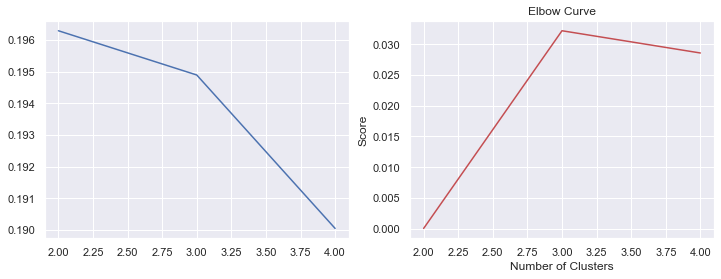

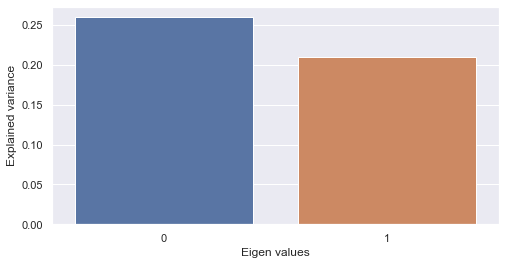

PCA on single-modal explained variance ratio: 0.4697110652923584


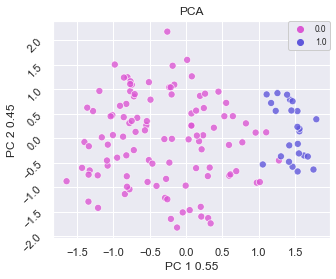

2 clusters -  silhoutte score: 0.16583290696144104 - mutual information: 0.0027593154807849605
3 clusters -  silhoutte score: 0.16380485892295837 - mutual information: 0.031866061309276376
4 clusters -  silhoutte score: 0.1712266206741333 - mutual information: 0.027408218676655185


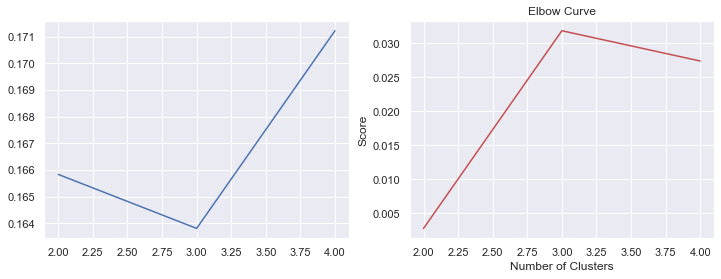

Compression: 51.18

Epoch 00053: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00058: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.
Epoch 00058: early stopping


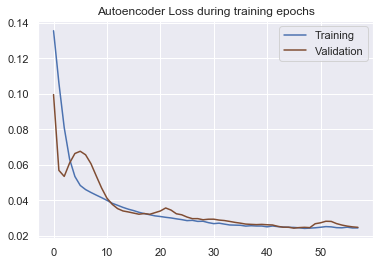

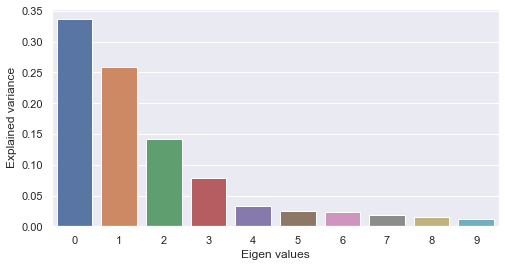

PCA on single-modal explained variance ratio: 0.9408279657363892


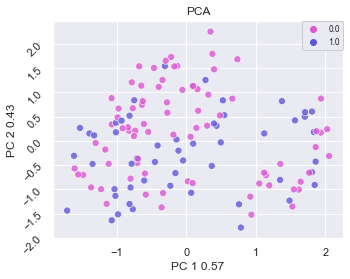

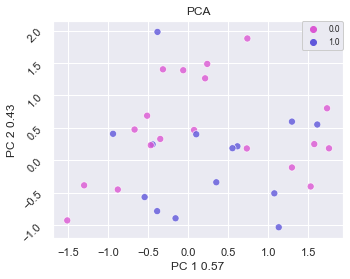

Results for AE: 

Best score for training data: 0.6076923076923076 

Best C: 0.08 



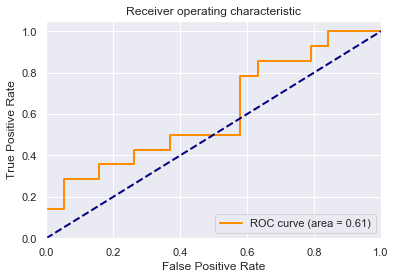

[[19  0]
 [12  2]]


              precision    recall  f1-score   support

           0       0.61      1.00      0.76        19
           1       1.00      0.14      0.25        14

    accuracy                           0.64        33
   macro avg       0.81      0.57      0.51        33
weighted avg       0.78      0.64      0.54        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.636364
Best score for training data: 0.6153846153846153 

Best C: 1.0 

Best Gamma: 0.1 



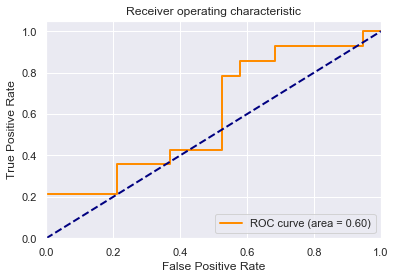

[[19  0]
 [13  1]]


              precision    recall  f1-score   support

           0       0.59      1.00      0.75        19
           1       1.00      0.07      0.13        14

    accuracy                           0.61        33
   macro avg       0.80      0.54      0.44        33
weighted avg       0.77      0.61      0.49        33

Training set score for SVM: 0.684615
Testing  set score for SVM: 0.606061
Best score for training data: 0.5615384615384615 

Best #estimators: 140 

Best max depth: None 



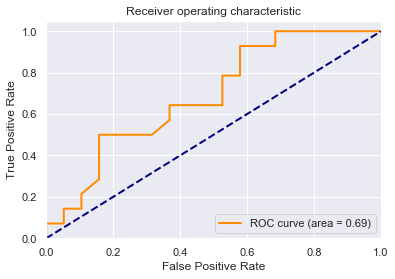

[[17  2]
 [11  3]]


              precision    recall  f1-score   support

           0       0.61      0.89      0.72        19
           1       0.60      0.21      0.32        14

    accuracy                           0.61        33
   macro avg       0.60      0.55      0.52        33
weighted avg       0.60      0.61      0.55        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.606061


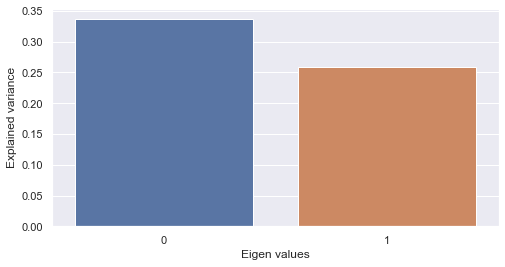

PCA on single-modal explained variance ratio: 0.5954869389533997


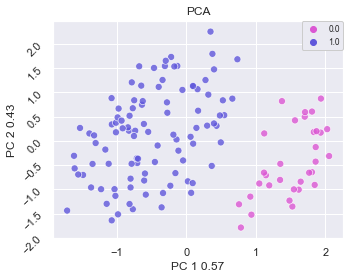

2 clusters -  silhoutte score: 0.28180408477783203 - mutual information: 0.0015445698868918648
3 clusters -  silhoutte score: 0.2526887059211731 - mutual information: 0.05564087897555915
4 clusters -  silhoutte score: 0.24658845365047455 - mutual information: 0.05091703493269599


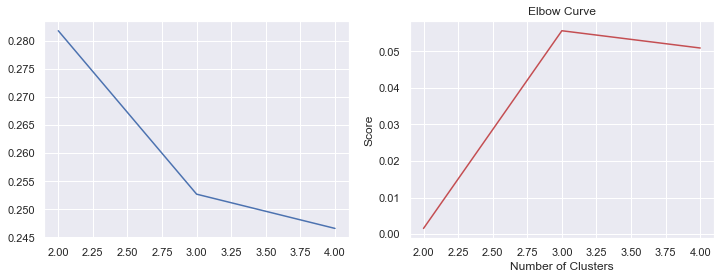

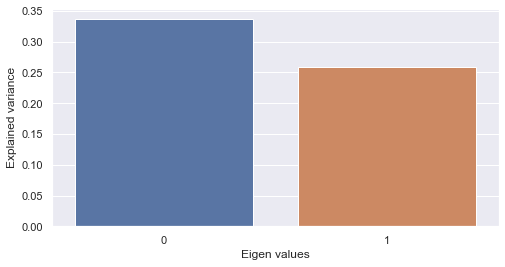

PCA on single-modal explained variance ratio: 0.5954869389533997


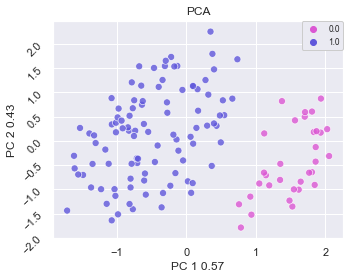

2 clusters -  silhoutte score: 0.28180408477783203 - mutual information: 0.0015445698868918648
3 clusters -  silhoutte score: 0.2538816034793854 - mutual information: 0.06624241537741966
4 clusters -  silhoutte score: 0.20849443972110748 - mutual information: 0.04240100221495621


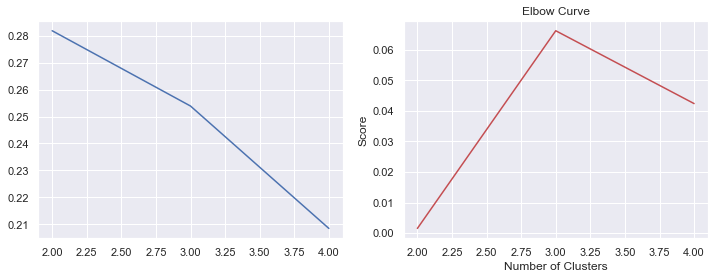

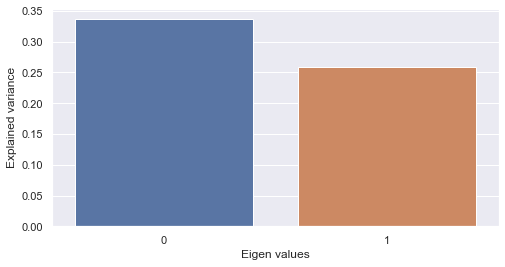

PCA on single-modal explained variance ratio: 0.5954869389533997


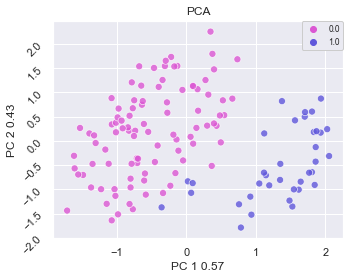

2 clusters -  silhoutte score: 0.2656974494457245 - mutual information: 0.0003500070750432931
3 clusters -  silhoutte score: 0.22787357866764069 - mutual information: 0.02252761458544459
4 clusters -  silhoutte score: 0.22308704257011414 - mutual information: 0.05942934574954101


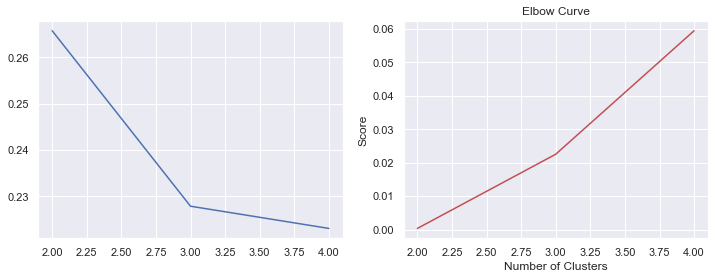

Compression: 51.18

Epoch 00061: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00080: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00085: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00094: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00100: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.

Epoch 00105: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-09.
Epoch 00105: early stopping


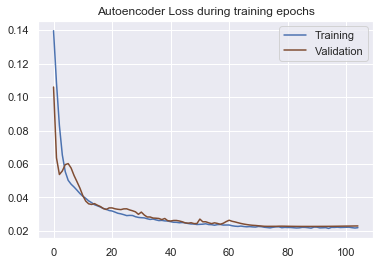

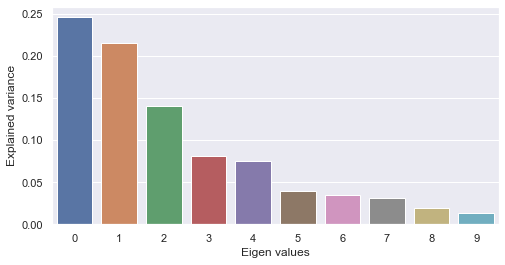

PCA on single-modal explained variance ratio: 0.8984845876693726


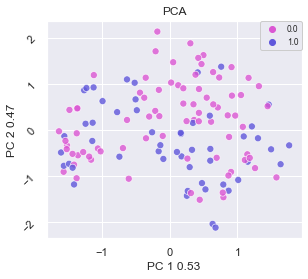

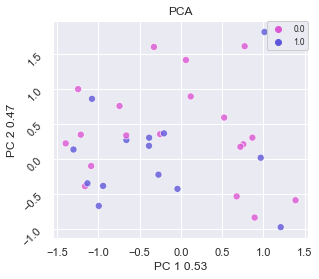

Results for AE: 

Best score for training data: 0.6153846153846153 

Best C: 0.08 



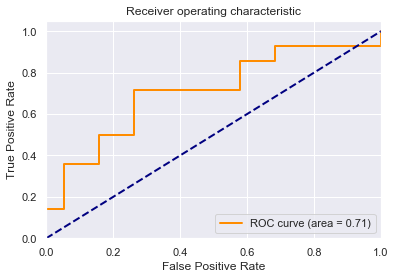

[[19  0]
 [12  2]]


              precision    recall  f1-score   support

           0       0.61      1.00      0.76        19
           1       1.00      0.14      0.25        14

    accuracy                           0.64        33
   macro avg       0.81      0.57      0.51        33
weighted avg       0.78      0.64      0.54        33

Training set score for Logistic Regression: 0.653846
Testing  set score for Logistic Regression: 0.636364
Best score for training data: 0.6 

Best C: 0.1 

Best Gamma: scale 



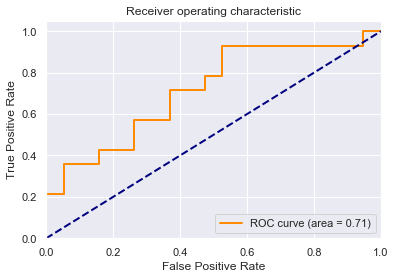

[[19  0]
 [14  0]]


              precision    recall  f1-score   support

           0       0.58      1.00      0.73        19
           1       0.00      0.00      0.00        14

    accuracy                           0.58        33
   macro avg       0.29      0.50      0.37        33
weighted avg       0.33      0.58      0.42        33

Training set score for SVM: 0.600000
Testing  set score for SVM: 0.575758


F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\sklearn\metrics\_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


Best score for training data: 0.5692307692307692 

Best #estimators: 140 

Best max depth: None 



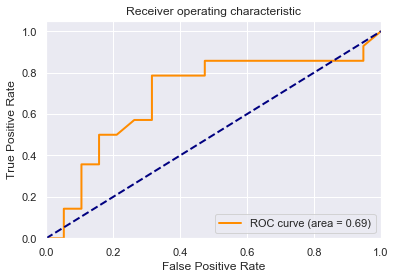

[[17  2]
 [ 9  5]]


              precision    recall  f1-score   support

           0       0.65      0.89      0.76        19
           1       0.71      0.36      0.48        14

    accuracy                           0.67        33
   macro avg       0.68      0.63      0.62        33
weighted avg       0.68      0.67      0.64        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.666667


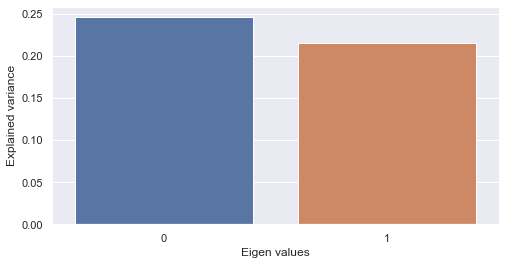

PCA on single-modal explained variance ratio: 0.4615917205810547


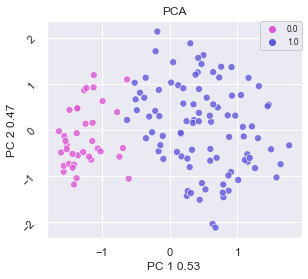

2 clusters -  silhoutte score: 0.18620158731937408 - mutual information: 0.0013661027416828658
3 clusters -  silhoutte score: 0.20244577527046204 - mutual information: 0.06651065121027112
4 clusters -  silhoutte score: 0.18911238014698029 - mutual information: 0.06404403530348697


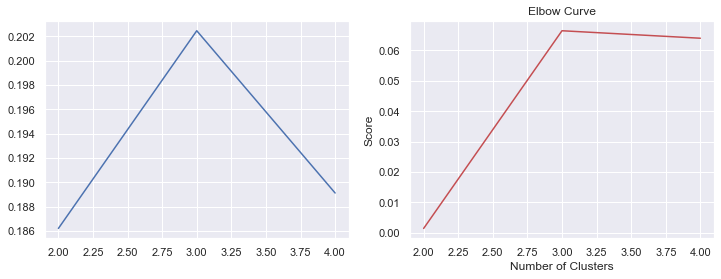

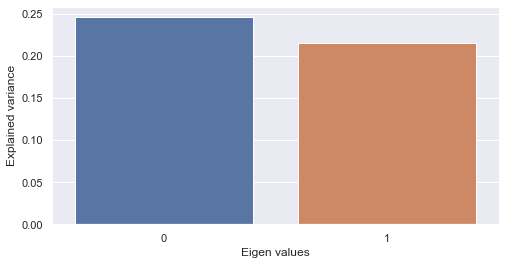

PCA on single-modal explained variance ratio: 0.4615917205810547


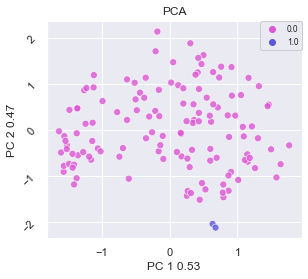

2 clusters -  silhoutte score: 0.3223115801811218 - mutual information: 0.03794704753767243
3 clusters -  silhoutte score: 0.19192172586917877 - mutual information: 0.02216686036452126
4 clusters -  silhoutte score: 0.1982874870300293 - mutual information: 0.05350020610083286


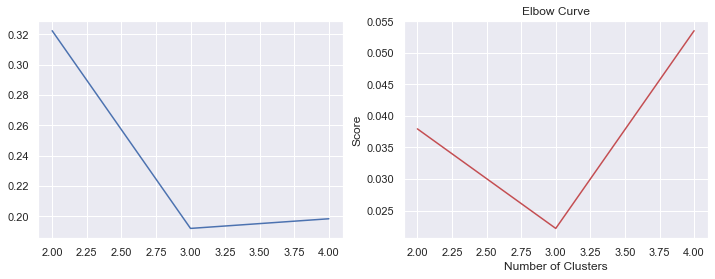

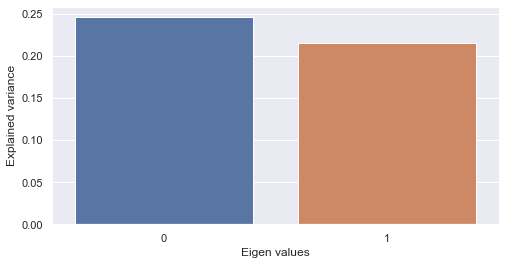

PCA on single-modal explained variance ratio: 0.4615917205810547


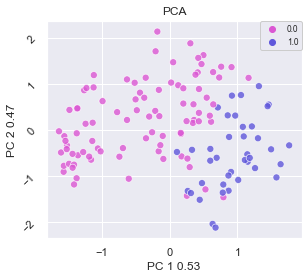

2 clusters -  silhoutte score: 0.17002341151237488 - mutual information: 0.010471028660298845
3 clusters -  silhoutte score: 0.1557103991508484 - mutual information: 0.008138281385238944
4 clusters -  silhoutte score: 0.16117219626903534 - mutual information: 0.009239055965804288


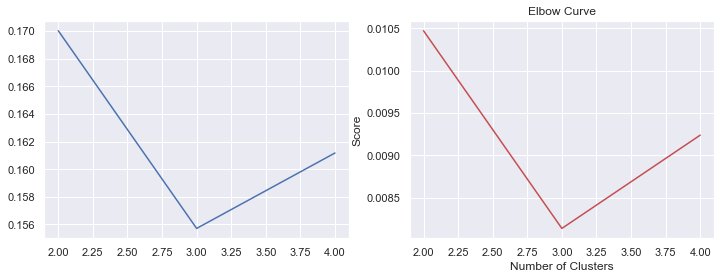

Compression: 51.18

Epoch 00065: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00081: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00087: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00096: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.

Epoch 00101: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-08.

Epoch 00106: ReduceLROnPlateau reducing learning rate to 1.000000082740371e-09.
Epoch 00107: early stopping


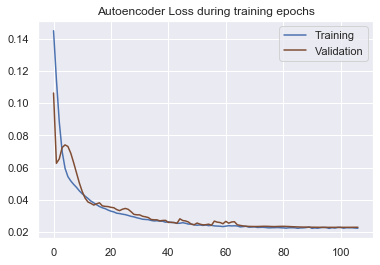

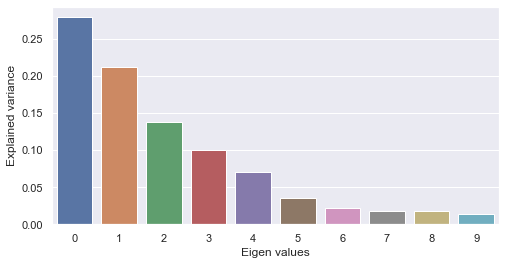

PCA on single-modal explained variance ratio: 0.9045996069908142


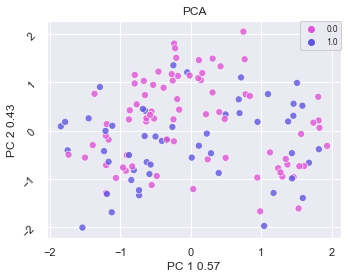

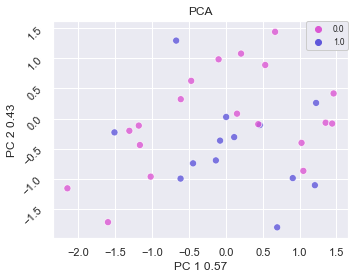

Results for AE: 

Best score for training data: 0.6230769230769231 

Best C: 0.08 



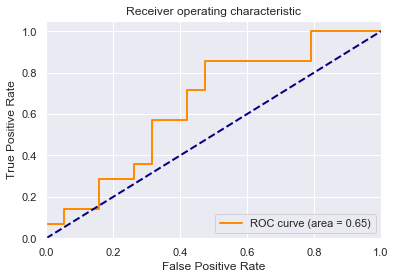

[[16  3]
 [11  3]]


              precision    recall  f1-score   support

           0       0.59      0.84      0.70        19
           1       0.50      0.21      0.30        14

    accuracy                           0.58        33
   macro avg       0.55      0.53      0.50        33
weighted avg       0.55      0.58      0.53        33

Training set score for Logistic Regression: 0.669231
Testing  set score for Logistic Regression: 0.575758
Best score for training data: 0.623076923076923 

Best C: 1.0 

Best Gamma: 0.1 



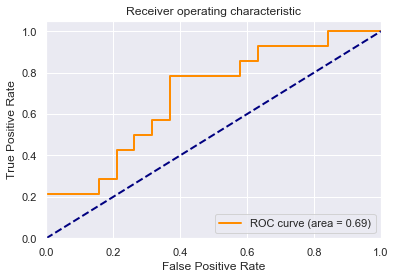

[[17  2]
 [11  3]]


              precision    recall  f1-score   support

           0       0.61      0.89      0.72        19
           1       0.60      0.21      0.32        14

    accuracy                           0.61        33
   macro avg       0.60      0.55      0.52        33
weighted avg       0.60      0.61      0.55        33

Training set score for SVM: 0.746154
Testing  set score for SVM: 0.606061
Best score for training data: 0.5846153846153845 

Best #estimators: 140 

Best max depth: None 



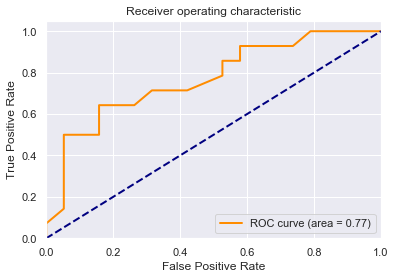

[[17  2]
 [ 7  7]]


              precision    recall  f1-score   support

           0       0.71      0.89      0.79        19
           1       0.78      0.50      0.61        14

    accuracy                           0.73        33
   macro avg       0.74      0.70      0.70        33
weighted avg       0.74      0.73      0.71        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.727273


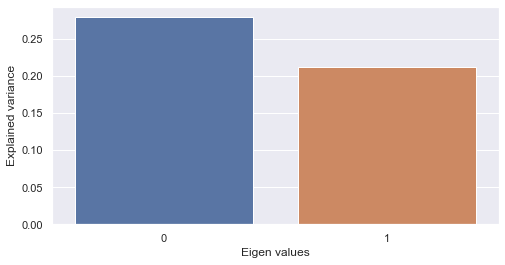

PCA on single-modal explained variance ratio: 0.49022701382637024


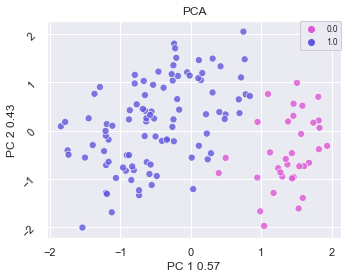

2 clusters -  silhoutte score: 0.22863930463790894 - mutual information: 0.0019926109904302865
3 clusters -  silhoutte score: 0.21047651767730713 - mutual information: 0.055446826722745556
4 clusters -  silhoutte score: 0.2057473063468933 - mutual information: 0.03476532004626837


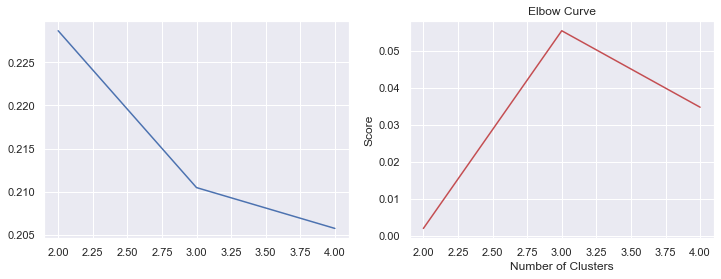

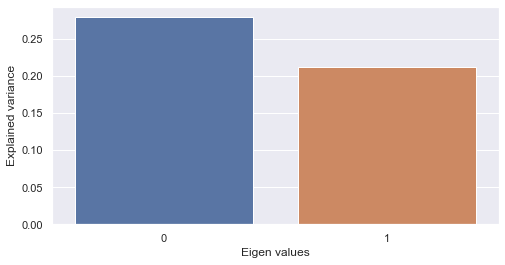

PCA on single-modal explained variance ratio: 0.49022701382637024


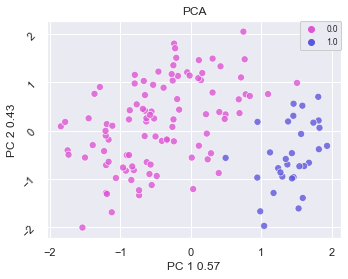

2 clusters -  silhoutte score: 0.22952555119991302 - mutual information: 0.00017817392730610387
3 clusters -  silhoutte score: 0.19313600659370422 - mutual information: 0.04587310122317704
4 clusters -  silhoutte score: 0.17557840049266815 - mutual information: 0.05545384441596351


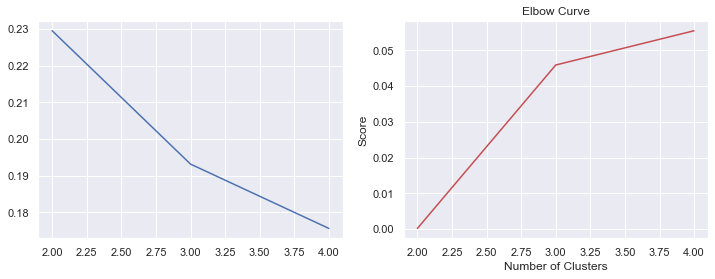

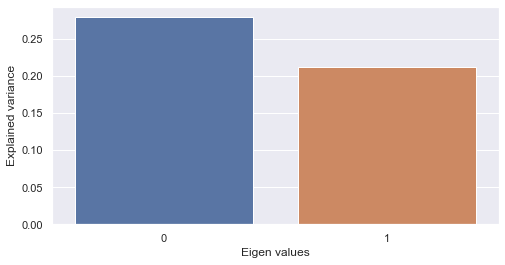

PCA on single-modal explained variance ratio: 0.49022701382637024


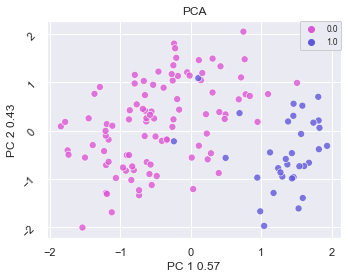

2 clusters -  silhoutte score: 0.2129412144422531 - mutual information: 0.0015235725035612358
3 clusters -  silhoutte score: 0.18760913610458374 - mutual information: 0.03259388649185308
4 clusters -  silhoutte score: 0.18031321465969086 - mutual information: 0.04979902525775964


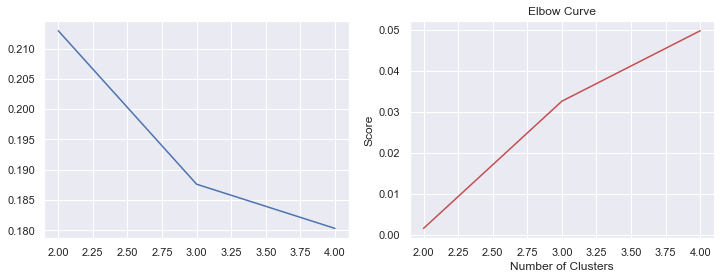

Compression: 51.18

Epoch 00083: ReduceLROnPlateau reducing learning rate to 0.00010000000474974513.

Epoch 00110: ReduceLROnPlateau reducing learning rate to 1.0000000474974514e-05.

Epoch 00116: ReduceLROnPlateau reducing learning rate to 1.0000000656873453e-06.

Epoch 00121: ReduceLROnPlateau reducing learning rate to 1.0000001111620805e-07.
Epoch 00121: early stopping


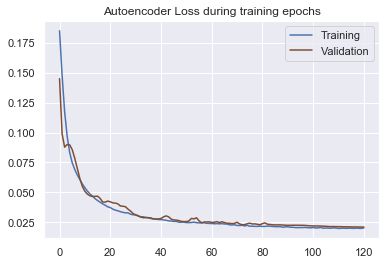

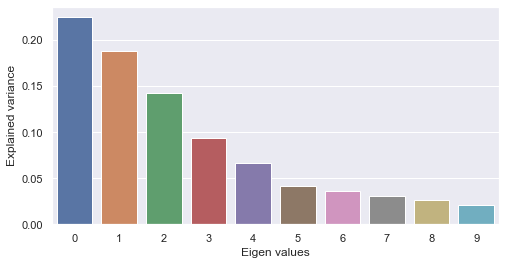

PCA on single-modal explained variance ratio: 0.8712568879127502


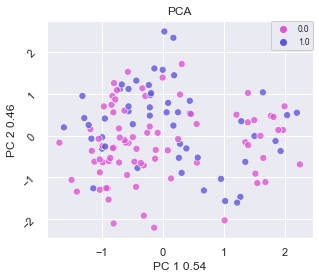

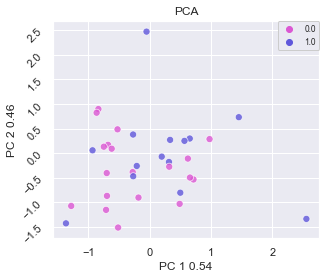

Results for AE: 

Best score for training data: 0.6307692307692307 

Best C: 0.08 



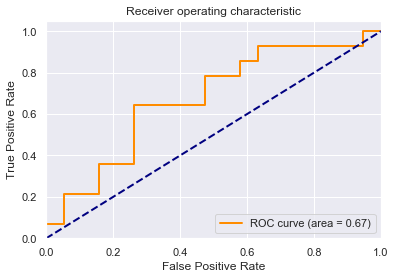

[[19  0]
 [13  1]]


              precision    recall  f1-score   support

           0       0.59      1.00      0.75        19
           1       1.00      0.07      0.13        14

    accuracy                           0.61        33
   macro avg       0.80      0.54      0.44        33
weighted avg       0.77      0.61      0.49        33

Training set score for Logistic Regression: 0.638462
Testing  set score for Logistic Regression: 0.606061
Best score for training data: 0.6307692307692307 

Best C: 1.0 

Best Gamma: 0.1 



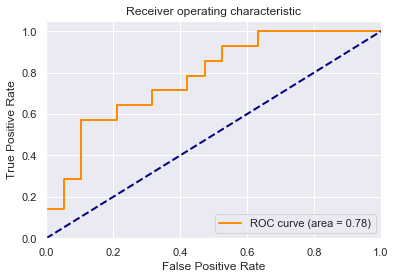

[[19  0]
 [13  1]]


              precision    recall  f1-score   support

           0       0.59      1.00      0.75        19
           1       1.00      0.07      0.13        14

    accuracy                           0.61        33
   macro avg       0.80      0.54      0.44        33
weighted avg       0.77      0.61      0.49        33

Training set score for SVM: 0.723077
Testing  set score for SVM: 0.606061
Best score for training data: 0.5846153846153845 

Best #estimators: 100 

Best max depth: 12 



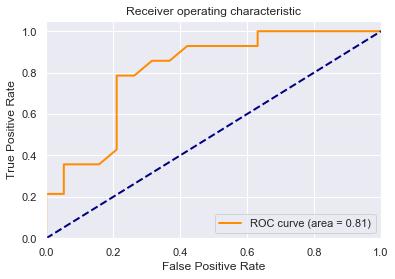

[[18  1]
 [11  3]]


              precision    recall  f1-score   support

           0       0.62      0.95      0.75        19
           1       0.75      0.21      0.33        14

    accuracy                           0.64        33
   macro avg       0.69      0.58      0.54        33
weighted avg       0.68      0.64      0.57        33

Training set score for RFC: 1.000000
Testing  set score for RFC: 0.636364


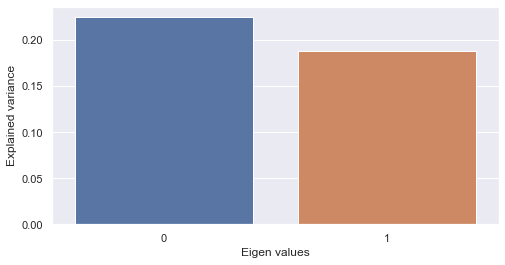

PCA on single-modal explained variance ratio: 0.413408100605011


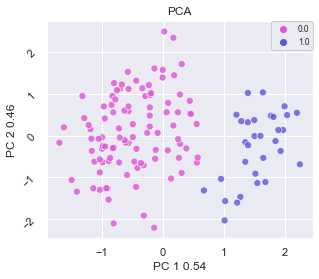

2 clusters -  silhoutte score: 0.21501067280769348 - mutual information: 0.0003984811252230495
3 clusters -  silhoutte score: 0.17821036279201508 - mutual information: 0.03822037326388806
4 clusters -  silhoutte score: 0.16783428192138672 - mutual information: 0.04492880593120943


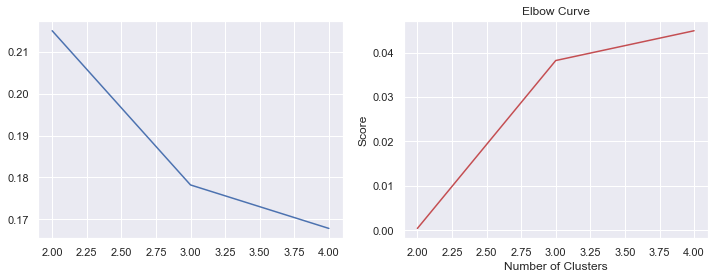

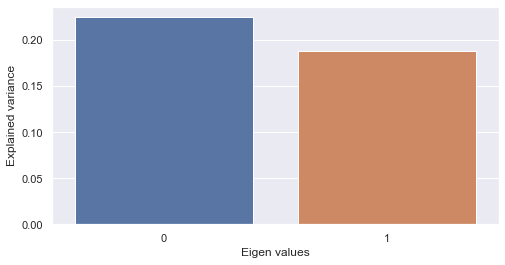

PCA on single-modal explained variance ratio: 0.413408100605011


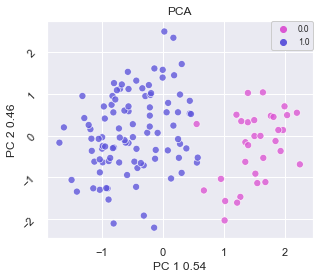

2 clusters -  silhoutte score: 0.21270766854286194 - mutual information: 4.3120955937184825e-05
3 clusters -  silhoutte score: 0.2097778022289276 - mutual information: 0.02211842694347442
4 clusters -  silhoutte score: 0.167422816157341 - mutual information: 0.03955097784875472


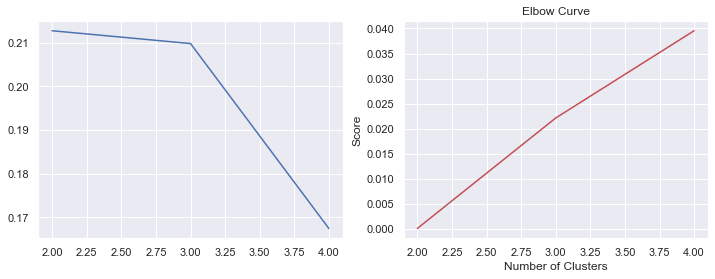

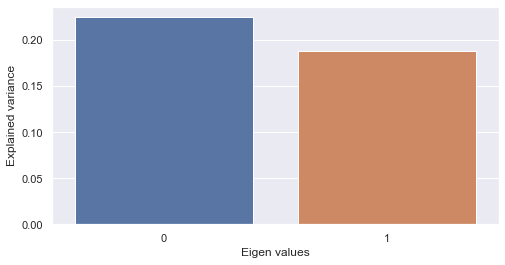

PCA on single-modal explained variance ratio: 0.413408100605011


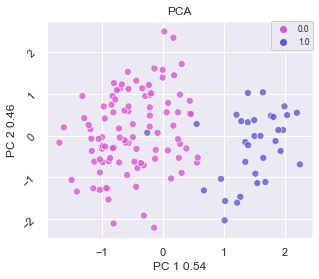

2 clusters -  silhoutte score: 0.20701241493225098 - mutual information: 4.205302136382425e-05
3 clusters -  silhoutte score: 0.15644878149032593 - mutual information: 0.03465474585598296
4 clusters -  silhoutte score: 0.14946837723255157 - mutual information: 0.04669539294944987


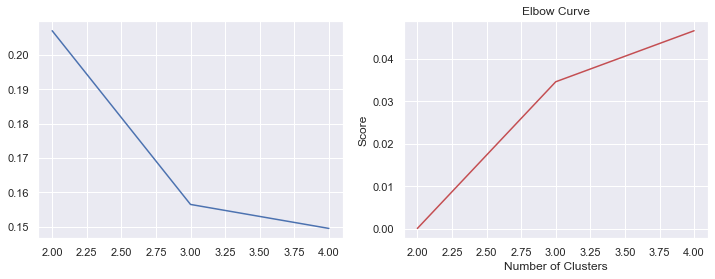

In [21]:
##### HYPERPARAM TUNING DAE ON mRNA
encoding_dims=[100]
mus=[0.5]
dropouts = [0.4]
l1s = [0.0000005]
l2s = [0.0000005]
scores = []
for encoding_dim in encoding_dims:
    for mu in mus:
        for dropout in dropouts:
            for l1 in l1s:
                for l2 in l2s:
                    ## Build and Train Autoencoder
                    autoencoder, encoder, decoder, loss = Models.build_and_train_autoencoder(X_swapped_second_norm,
                                                                                  X_train_second_norm,
                                                                                  encoding_dim=encoding_dim, 
                                                                                  regularizer=tf.keras.regularizers.l1_l2(l1,l2),
                                                                                  dropout=dropout,
                                                                                  epochs=200,
                                                                                 )
                    ## Encode datasets
                    X_latent_ae = Models.encode_dataset(X_train_second_norm, encoder)
                    X_latent_test_ae = Models.encode_dataset(X_test_second_norm, encoder)

                    ## PCA ON AUTOENCODER LATENT SPACE
                    X_latent_pca_ae, X_latent_test_pca_ae = Models.perform_PCA(X_latent_ae, y_train, X_latent_test_ae, y_test, n_components=10)

                    ### CLASSIFICATION ###
                    classify = Models.classify(X_latent_ae, X_latent_test_ae, np.ravel(y_train), np.ravel(y_test), model_type="AE")

                    ### CLUSTERING ###
                    clustering = Models.cluster(X_latent_ae,np.ravel(y_train), model_type="AE")

                    scores.append([mu,dropout,l1,l2,loss] + classify + clustering)




In [23]:
scores = pd.DataFrame(scores,
                      columns=["mu","dropout","l1","l2","loss","LR accuracy","SVM accuracy", "RF accuracy", "LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC","KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette","KMeans MI","Spectral MI","Hierarchical MI"])    
display(scores)
print(f"Random classifier: {y_test.iloc[:,0].value_counts()[0]/len(y_test)}")

,mu,dropout,l1,l2,loss,LR accuracy,SVM accuracy,RF accuracy,LR ROC-AUC,SVM ROC-AUC,RF ROC-AUC,KMeans Silhouette,Spectral Silhouette,Hierarchical Silhouette,KMeans MI,Spectral MI,Hierarchical MI
0,0.5,0.4,5.000000e-07,0.000000e+00,0.023615,0.575758,0.575758,0.636364,0.563910,0.676692,0.671053,0.185036,0.196953,0.192342,0.000776,0.000669,0.000178
1,0.5,0.4,5.000000e-07,1.000000e-07,0.025424,0.575758,0.575758,0.636364,0.665414,0.665414,0.616541,0.294145,0.294642,0.295490,0.001545,0.000178,0.000043
2,0.5,0.4,5.000000e-07,5.000000e-07,0.022686,0.575758,0.636364,0.606061,0.654135,0.725564,0.631579,0.186824,0.196292,0.165833,0.049802,0.000043,0.002759
3,0.5,0.4,5.000000e-07,1.000000e-06,0.024358,0.636364,0.606061,0.606061,0.609023,0.597744,0.687970,0.281804,0.281804,0.265697,0.001545,0.001545,0.000350
4,0.5,0.4,5.000000e-07,5.000000e-06,0.021939,0.636364,0.575758,0.666667,0.706767,0.714286,0.691729,0.186202,0.322312,0.170023,0.001366,0.037947,0.010471
5,0.5,0.4,5.000000e-07,1.000000e-05,0.022385,0.575758,0.606061,0.727273,0.646617,0.691729,0.768797,0.228639,0.229526,0.212941,0.001993,0.000178,0.001524
6,0.5,0.4,5.000000e-07,5.000000e-05,0.020267,0.606061,0.606061,0.636364,0.672932,0.778195,0.810150,0.215011,0.212708,0.207012,0.000398,0.000043,0.000042


Random classifier: 0.5757575757575758


F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\pandas\core\indexing.py:376: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\pandas\core\indexing.py:381: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_with_indexer(new_indexer, value)
F:\Documentacion\Desarrollo\Python\Anaconda\envs\tf_2\lib\site-packages\pandas\core\indexing.py:205: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFra

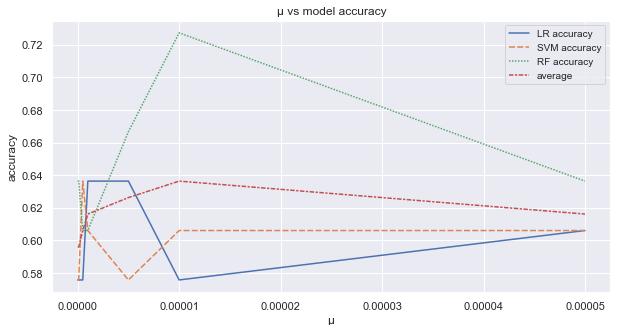

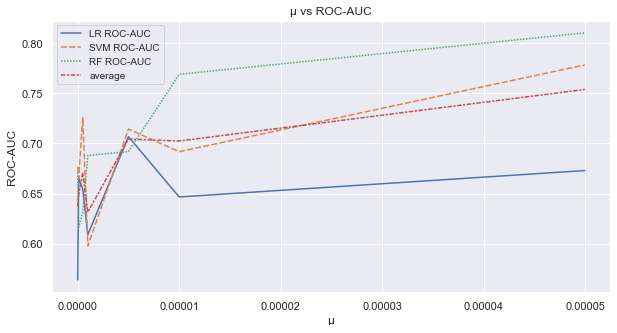

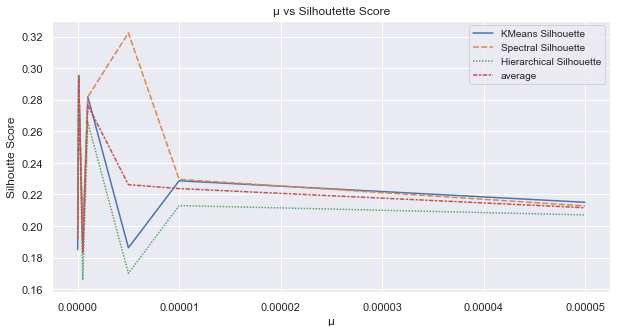

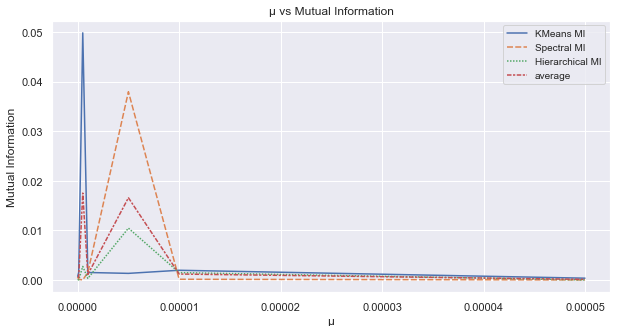

In [24]:
scores.index = l2s

data_acc = scores[["LR accuracy","SVM accuracy","RF accuracy"]]
data_acc.loc[:,"average"] = data_acc.mean(axis=1)

data_auc = scores[["LR ROC-AUC", "SVM ROC-AUC", "RF ROC-AUC"]]
data_auc.loc[:,"average"] = data_auc.mean(axis=1)

data_ss = scores[["KMeans Silhouette","Spectral Silhouette","Hierarchical Silhouette"]]
data_ss.loc[:,"average"] = data_ss.mean(axis=1)

data_mi = scores[["KMeans MI","Spectral MI","Hierarchical MI"]]
data_mi.loc[:,"average"] = data_mi.mean(axis=1)

sns.set()
hyperparam = "μ"

ax = sns.lineplot(data=data_acc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"accuracy")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs model accuracy")
plt.show()

ax = sns.lineplot(data=data_auc)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"ROC-AUC")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs ROC-AUC")
plt.show()

ax = sns.lineplot(data=data_ss)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Silhoutte Score")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Silhoutette Score")
plt.show()

ax = sns.lineplot(data=data_mi)
plt.legend(fontsize='small')
ax.set_xlabel(hyperparam)
ax.set_ylabel(f"Mutual Information")
ax.figure.set_size_inches(10 , 5)
ax.set_title(f"{hyperparam} vs Mutual Information")
plt.show()